__author__ = 'Armando Collado-Villaverde'  
__email__ = 'armando.collado@uah.es'




# IDENTFICICATION OF STORMS FOR THE ASY-H INDEX OF EACH INTENSITY CLASS

Identifies, classifies and plots the storms using the thresholds calculated in the distribution notebook. The selected bounds for each storms is 2 complete days before the first value in the low-intensity range until 4 complete days after.

* [ASY-H STORMS](#section_1)
* [STORMS PLOTS](#section_2)
  * [Low intensity storms](#section_2_1)
  * [Moderate storms](#section_2_2)
  * [Intense storms](#section_2_3)
  * [Super-intense storms](#section_2_4)

In [1]:
import pandas as pd
import utils
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Set seaborn styles for the plots
sns.set_style('whitegrid')
sns.set_context("paper")

In [2]:
print('Finding storms based on the findings of the distribution of the maximum (minimum) of the ASY-H (SYM-H) index when grouping in 27 days to avoid persistence\n')

# Print threshold information for classification
print(f'Times when the ASY-H is below {utils.ASY_H_THRESHOLD_LOW} (percentile 60) will be ignored')
print(f'Times when the ASY-H is between {utils.ASY_H_THRESHOLD_LOW} and {utils.ASY_H_THRESHOLD_MODERATE} (percentile 80) will be classified as "LOW"')
print(f'Times when the ASY-H is between {utils.ASY_H_THRESHOLD_MODERATE} and {utils.ASY_H_THRESHOLD_INTENSE} (percentile 95) will be classified as "MODERATE"')
print(f'Times when the ASY-H is between {utils.ASY_H_THRESHOLD_INTENSE} and {utils.ASY_H_THRESHOLD_SUPERINTENSE} (percentile 99) will be classified as "INTENSE"')
print(f'Times when the ASY-H is above {utils.ASY_H_THRESHOLD_SUPERINTENSE} will be classified as "SUPERINTENSE"')

Finding storms based on the findings of the distribution of the maximum (minimum) of the ASY-H (SYM-H) index when grouping in 27 days to avoid persistence

Times when the ASY-H is below 130 (percentile 60) will be ignored
Times when the ASY-H is between 130 and 170 (percentile 80) will be classified as "LOW"
Times when the ASY-H is between 170 and 290 (percentile 95) will be classified as "MODERATE"
Times when the ASY-H is between 290 and 540 (percentile 99) will be classified as "INTENSE"
Times when the ASY-H is above 540 will be classified as "SUPERINTENSE"


In [3]:
# Read data from pickle file
dfx = pd.read_pickle('./data/sym_asy_indices.pkl', compression = 'gzip')

# Extract dates with ASY-H index values above or equal to the low threshold
dates_asy = dfx['ASY_H'].reset_index().copy()
dates_asy = dates_asy.loc[dates_asy['ASY_H'] >= utils.ASY_H_THRESHOLD_LOW]

# Set the last valid year for storm classification
last_valid_year = 2022

# Initialize empty list to store storm data
storms_asy = []

## ASY-H STORMS <a class="anchor" id="section_1"></a>

Iterate over the dates with ASY-H values above the low intensity threhold.

* Calculate the start and end dates for the storm period based on the current date using one day as the offset.
* Find the maximum ASY-H value within the storm period.
* Find the index of the storm center (first occurrence of the maximum ASY-H value).
* Calculates the extended start and end dates for the storm period, considering 2 additional days before and 4 days after for the storm, the number of days before and after are estimated using the superposed epoch analysis.
* Checks if the end date exceeds the last valid year for classification and skips the current date if it does.
* Extracts the storm data within the extended period.
* Checks if there are more storms within the extended period with higher ASY-H values and updates the storm data accordingly.
* Checks if the new storm period overlaps with the previous storm and merges them if it does.
* Adds the new storm data to the list.

In [4]:
# Iterate over dates with ASY-H index values above the low intensity threshold
for i in range(len(dates_asy)):
    st = dates_asy.iloc[i]['datetime'] - utils.MINIMUM_DAYS_BEFORE
    nd = dates_asy.iloc[i]['datetime'] + utils.MINIMUM_DAYS_AFTER
    
    # Find the last and first values over the low threshold within a minimum offset of one day before and after
    last_low_value = dfx[st:nd].loc[dfx[st:nd]['ASY_H'] >= utils.ASY_H_THRESHOLD_LOW].last_valid_index()
    first_low_value = dfx[st:nd].loc[dfx[st:nd]['ASY_H'] >= utils.ASY_H_THRESHOLD_LOW].first_valid_index()
    
    # Adjust the start and end dates of the storm period determined with the superposed epoch analysis
    newst = first_low_value - utils.STORM_DAYS_BEFORE_OFFSET
    newst = newst.floor('D')
    newnd = last_low_value + utils.STORM_DAYS_AFTER_OFFSET
    newnd = newnd.ceil('D')
    
    # If the end year exceeds the last valid year, continue to the next date
    if (newnd.year > last_valid_year):
        continue
    
    # Create a new DataFrame to store the storm data within the adjusted storm period
    new_df = dfx[newst:newnd].copy()
    
    # Extend the storm period if there are additional last low values beyond the initial range
    while dfx[newst:newnd].loc[dfx[newst:newnd]['ASY_H'] >= utils.ASY_H_THRESHOLD_LOW].last_valid_index() > last_low_value:
        last_low_value = dfx[newst:newnd].loc[dfx[newst:newnd]['ASY_H'] >= utils.ASY_H_THRESHOLD_LOW].last_valid_index()
        newnd = last_low_value + utils.STORM_DAYS_AFTER_OFFSET
        newnd = newnd.ceil('D')
        new_df = dfx[newst:newnd].copy()        
    
    # Check if there is already a storm in the list and its end date is greater than or equal to the adjusted start date
    if (len(storms_asy) >= 1):
        if storms_asy[-1].index[-1] >= newst:
            # Concatenate the new storm data with the previous storm data
            new_df = pd.concat([storms_asy[-1], new_df])            
            new_df = new_df[~new_df.index.duplicated(keep='first')]
            storms_asy[-1] = new_df            
            continue
    
    # Append the new storm data to the list
    storms_asy.append(new_df)
    
# Print the total number of storms
print(f"Total storms: {len(storms_asy)}")

Total storms: 284


In [5]:
# Create a summary dataframe with the start and end dates, the duration, the maximum ASY-H value 
# of the storm and the corresponding class of the storm
summary_df_asy = utils.get_summary_df_asy(storms_asy)
summary_df_asy['classification'] = 'LOW'
summary_df_asy.loc[(summary_df_asy['Max ASY-H'] >= utils.ASY_H_THRESHOLD_MODERATE) & (summary_df_asy['Max ASY-H'] < utils.ASY_H_THRESHOLD_INTENSE), 'classification'] = 'MODERATE'
summary_df_asy.loc[(summary_df_asy['Max ASY-H'] >= utils.ASY_H_THRESHOLD_INTENSE) & (summary_df_asy['Max ASY-H'] < utils.ASY_H_THRESHOLD_SUPERINTENSE), 'classification'] = 'INTENSE'
summary_df_asy.loc[summary_df_asy['Max ASY-H'] >= utils.ASY_H_THRESHOLD_SUPERINTENSE, 'classification'] = 'SUPERINTENSE'

In [6]:
# Display all the identified storms
with pd.option_context('display.max_rows', 400, 'display.max_columns', 20):
    display(summary_df_asy) 
print(f'Total storms shown: {len(summary_df_asy)}')

,Start date,End date,TD,Max ASY-H,classification
0,1981-03-03,1981-03-10,7 days,132,LOW
1,1981-04-11,1981-04-18,7 days,267,MODERATE
2,1981-05-08,1981-05-23,15 days,173,MODERATE
3,1981-07-23,1981-07-31,8 days,287,MODERATE
4,1981-10-12,1981-10-19,7 days,245,MODERATE
5,1982-01-31,1982-02-07,7 days,142,LOW
6,1982-02-27,1982-03-07,8 days,193,MODERATE
7,1982-07-11,1982-07-19,8 days,604,SUPERINTENSE
8,1982-08-05,1982-08-12,7 days,147,LOW
9,1982-09-04,1982-09-12,8 days,376,INTENSE


Total storms shown: 284


classification
LOW             164
MODERATE         91
INTENSE          23
SUPERINTENSE      6
Name: count, dtype: int64
Total number of storms: 284


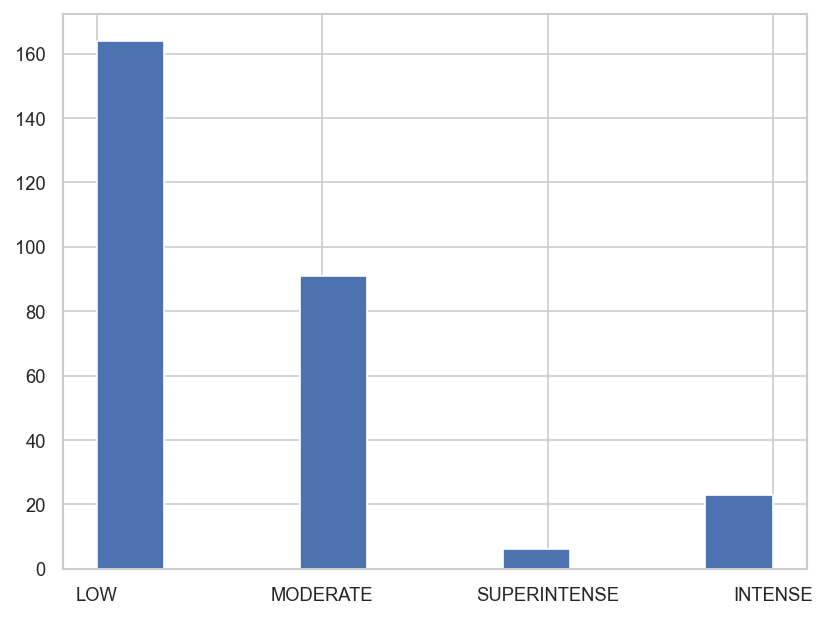

In [7]:
# Plot a histogram of the storm classifications
plt.hist(summary_df_asy['classification'], align='mid')
# Print the count of each storm classification
print(summary_df_asy['classification'].value_counts())
# Print the total number of storms
print('Total number of storms:', len(summary_df_asy))
plt.show();

In [8]:
# Get the indices of storms classified as 'LOW'
low_indices = summary_df_asy.loc[(summary_df_asy['Max ASY-H'] > utils.ASY_H_THRESHOLD_LOW ) & 
                                ((summary_df_asy['Max ASY-H'] < utils.ASY_H_THRESHOLD_MODERATE ))].index

# Get the indices of storms classified as 'MODERATE'
moderate_indices = summary_df_asy.loc[(summary_df_asy['Max ASY-H'] > utils.ASY_H_THRESHOLD_MODERATE ) & 
                                ((summary_df_asy['Max ASY-H'] < utils.ASY_H_THRESHOLD_INTENSE ))].index

# Get the indices of storms classified as 'INTENSE'
intense_indices  = summary_df_asy.loc[(summary_df_asy['Max ASY-H'] > utils.ASY_H_THRESHOLD_INTENSE ) & 
                                ((summary_df_asy['Max ASY-H'] < utils.ASY_H_THRESHOLD_SUPERINTENSE ))].index

# Get the indices of storms classified as 'SUPERINTENSE'
superintense_indices  = summary_df_asy.loc[summary_df_asy['Max ASY-H'] > utils.ASY_H_THRESHOLD_SUPERINTENSE].index

## STORMS PLOTS <a class="anchor" id="section_2"></a>

### Low intensity storms <a class="anchor" id="section_2_1"></a>

158 storms of low intensity
Plotting storm 0
Start date        1981-03-03 00:00:00
End date          1981-03-10 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         132
classification                    LOW
Name: 0, dtype: object
Maximum ASY-H value 132 at: 1981-03-05 11:50:00


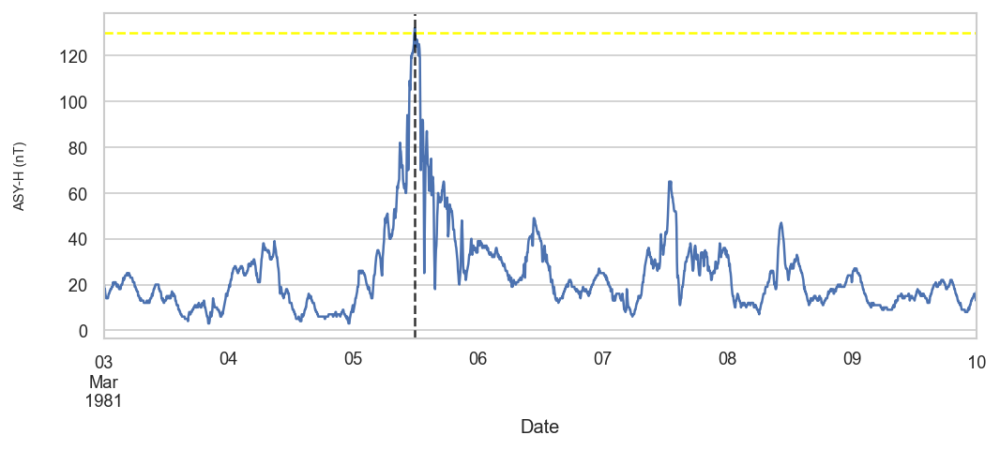

Plotting storm 5
Start date        1982-01-31 00:00:00
End date          1982-02-07 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         142
classification                    LOW
Name: 5, dtype: object
Maximum ASY-H value 142 at: 1982-02-02 11:30:00


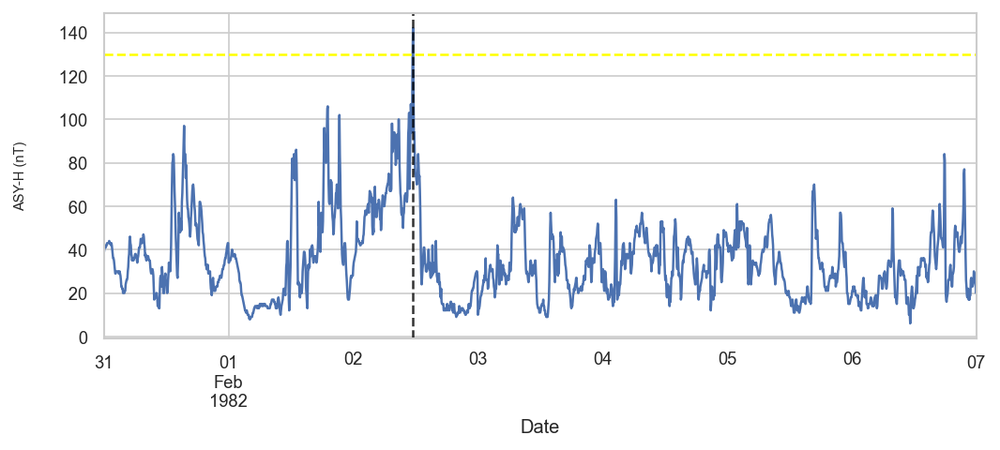

Plotting storm 8
Start date        1982-08-05 00:00:00
End date          1982-08-12 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         147
classification                    LOW
Name: 8, dtype: object
Maximum ASY-H value 147 at: 1982-08-07 06:00:00


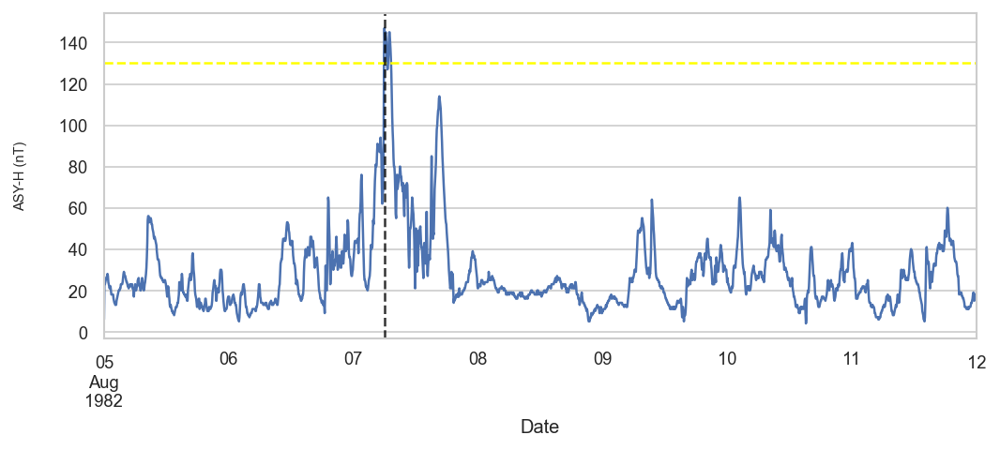

Plotting storm 11
Start date        1982-10-29 00:00:00
End date          1982-11-05 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         142
classification                    LOW
Name: 11, dtype: object
Maximum ASY-H value 142 at: 1982-10-31 19:00:00


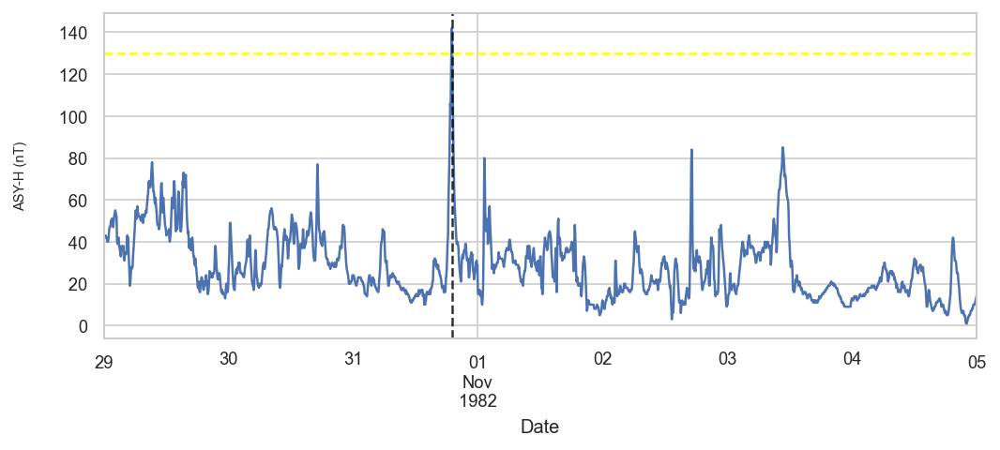

Plotting storm 13
Start date        1982-12-15 00:00:00
End date          1982-12-27 00:00:00
TD                   12 days 00:00:00
Max ASY-H                         135
classification                    LOW
Name: 13, dtype: object
Maximum ASY-H value 135 at: 1982-12-22 03:10:00


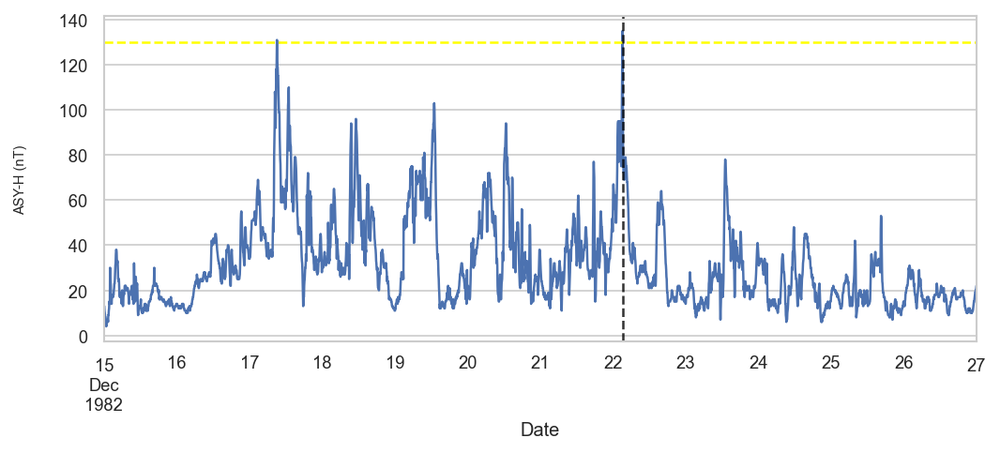

Plotting storm 16
Start date        1983-05-09 00:00:00
End date          1983-05-16 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         152
classification                    LOW
Name: 16, dtype: object
Maximum ASY-H value 152 at: 1983-05-11 17:55:00


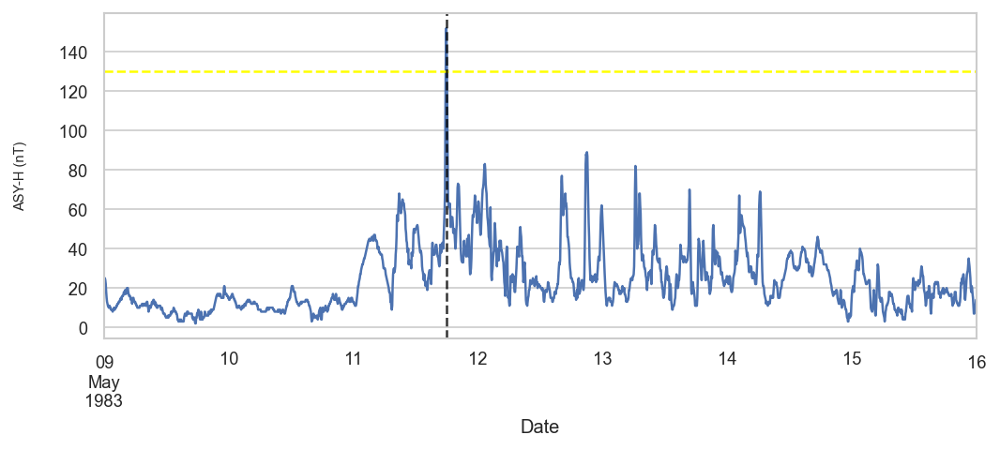

Plotting storm 18
Start date        1983-06-11 00:00:00
End date          1983-06-18 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         136
classification                    LOW
Name: 18, dtype: object
Maximum ASY-H value 136 at: 1983-06-13 04:20:00


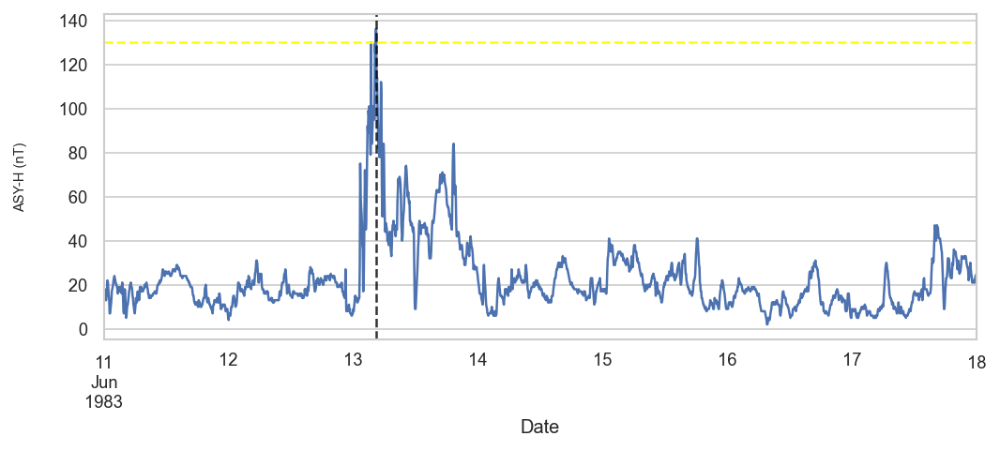

Plotting storm 19
Start date        1983-08-06 00:00:00
End date          1983-08-13 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         144
classification                    LOW
Name: 19, dtype: object
Maximum ASY-H value 144 at: 1983-08-08 04:20:00


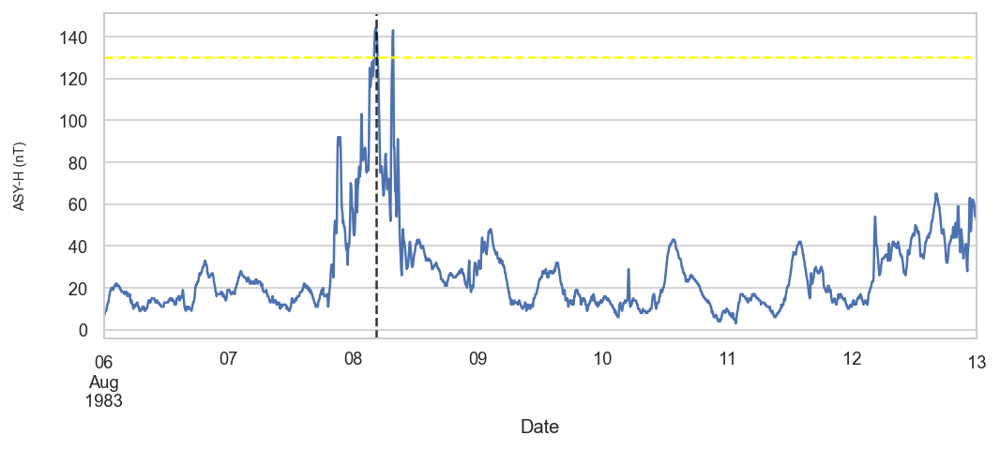

Plotting storm 20
Start date        1983-10-02 00:00:00
End date          1983-10-09 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         152
classification                    LOW
Name: 20, dtype: object
Maximum ASY-H value 152 at: 1983-10-04 15:00:00


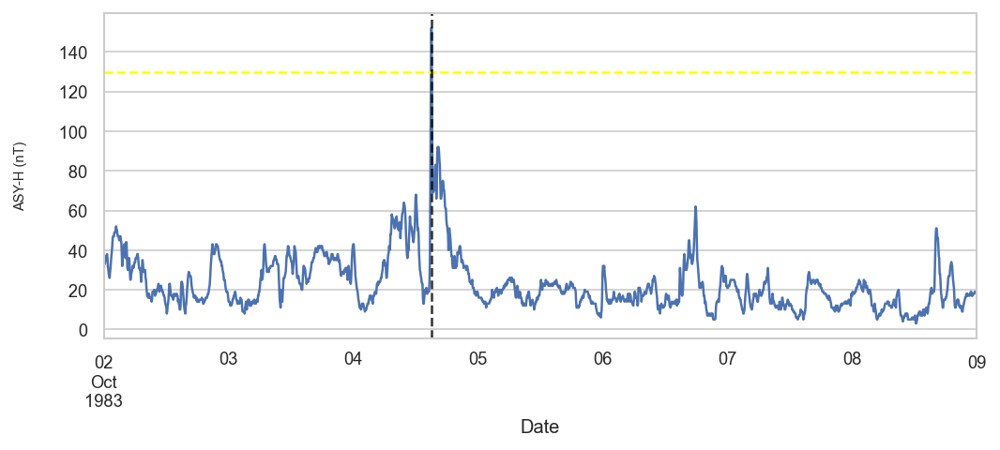

Plotting storm 21
Start date        1983-11-09 00:00:00
End date          1983-11-16 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         149
classification                    LOW
Name: 21, dtype: object
Maximum ASY-H value 149 at: 1983-11-11 20:30:00


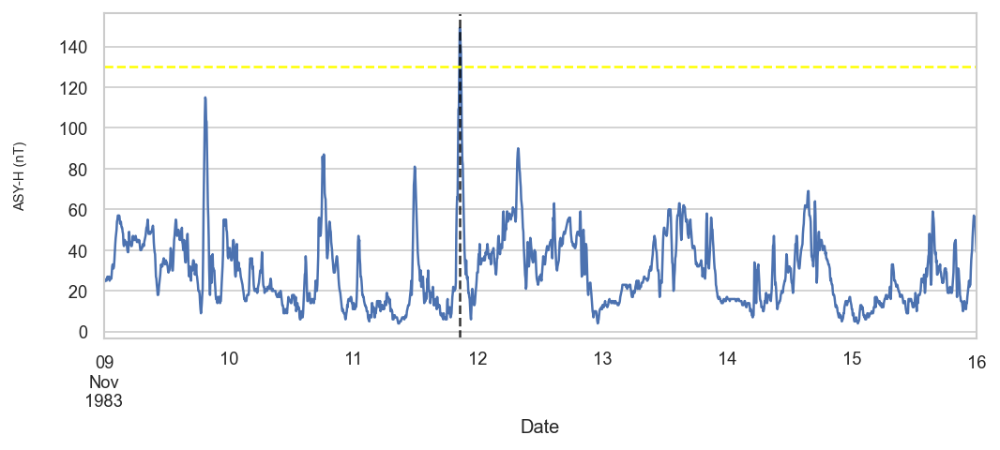

Plotting storm 23
Start date        1984-04-24 00:00:00
End date          1984-05-01 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         144
classification                    LOW
Name: 23, dtype: object
Maximum ASY-H value 144 at: 1984-04-26 15:35:00


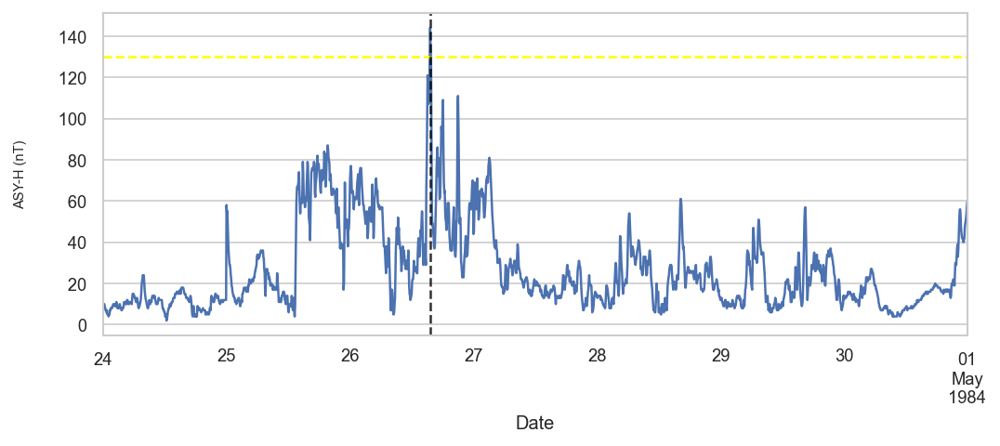

Plotting storm 24
Start date        1984-07-11 00:00:00
End date          1984-07-18 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 24, dtype: object
Maximum ASY-H value 143 at: 1984-07-13 07:00:00


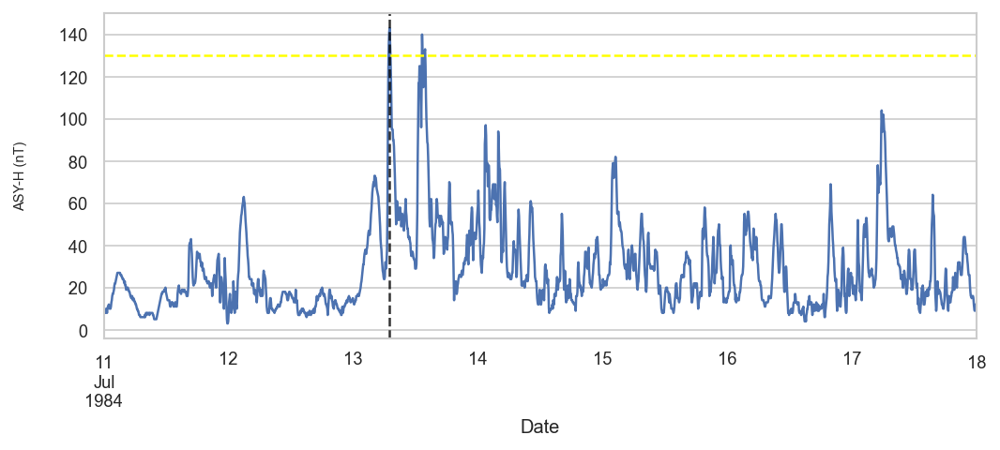

Plotting storm 25
Start date        1984-09-02 00:00:00
End date          1984-09-10 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         159
classification                    LOW
Name: 25, dtype: object
Maximum ASY-H value 159 at: 1984-09-04 15:30:00


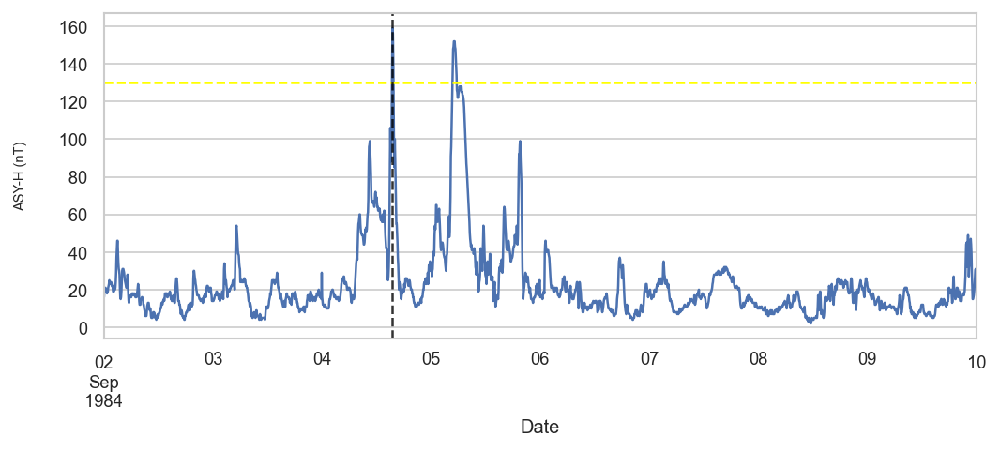

Plotting storm 26
Start date        1984-09-17 00:00:00
End date          1984-09-28 00:00:00
TD                   11 days 00:00:00
Max ASY-H                         145
classification                    LOW
Name: 26, dtype: object
Maximum ASY-H value 145 at: 1984-09-19 12:30:00


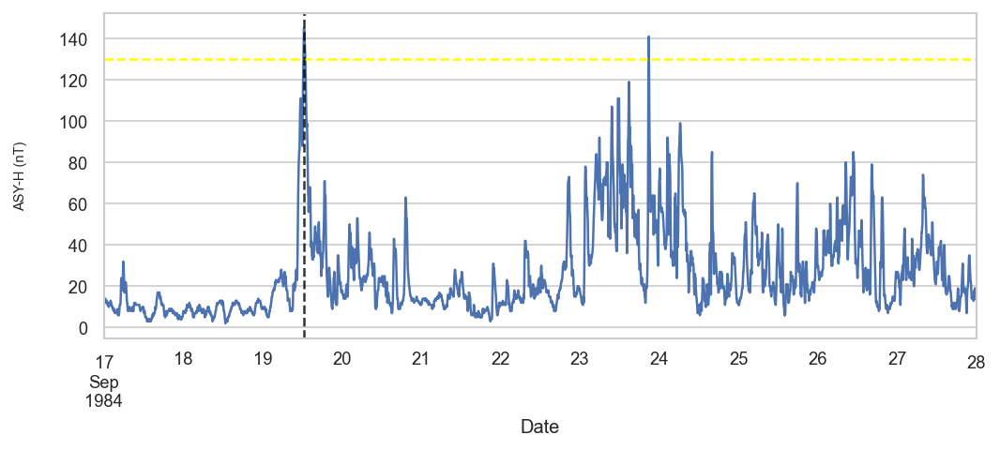

Plotting storm 27
Start date        1984-11-14 00:00:00
End date          1984-11-21 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         142
classification                    LOW
Name: 27, dtype: object
Maximum ASY-H value 142 at: 1984-11-16 03:10:00


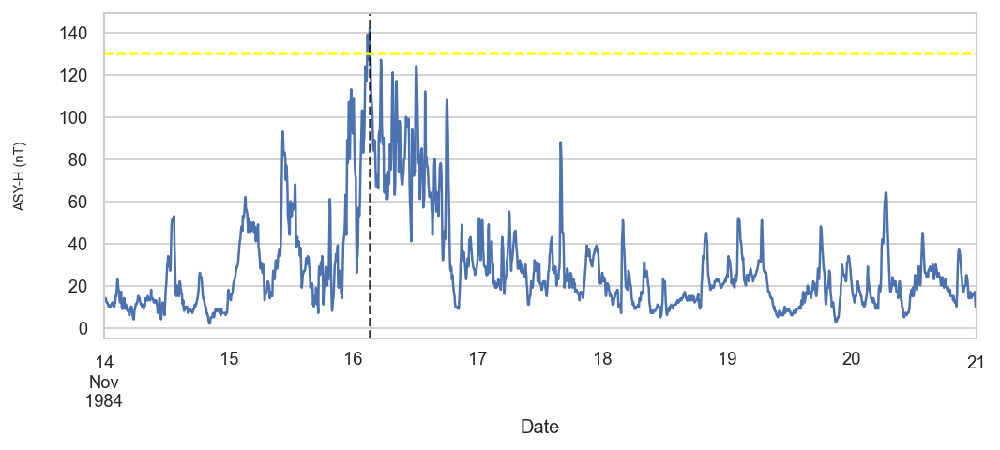

Plotting storm 28
Start date        1985-02-26 00:00:00
End date          1985-03-05 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         141
classification                    LOW
Name: 28, dtype: object
Maximum ASY-H value 141 at: 1985-02-28 03:00:00


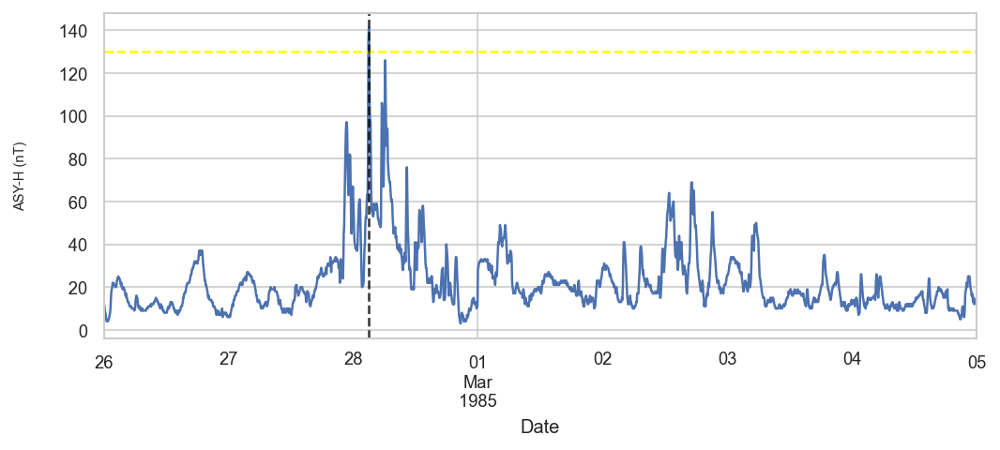

Plotting storm 29
Start date        1985-04-07 00:00:00
End date          1985-04-14 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         132
classification                    LOW
Name: 29, dtype: object
Maximum ASY-H value 132 at: 1985-04-09 14:15:00


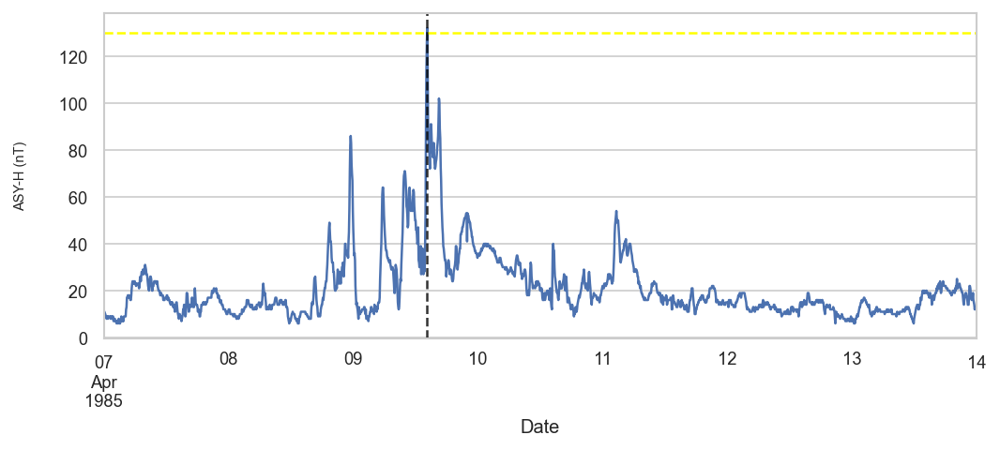

Plotting storm 31
Start date        1985-06-07 00:00:00
End date          1985-06-14 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         154
classification                    LOW
Name: 31, dtype: object
Maximum ASY-H value 154 at: 1985-06-09 22:20:00


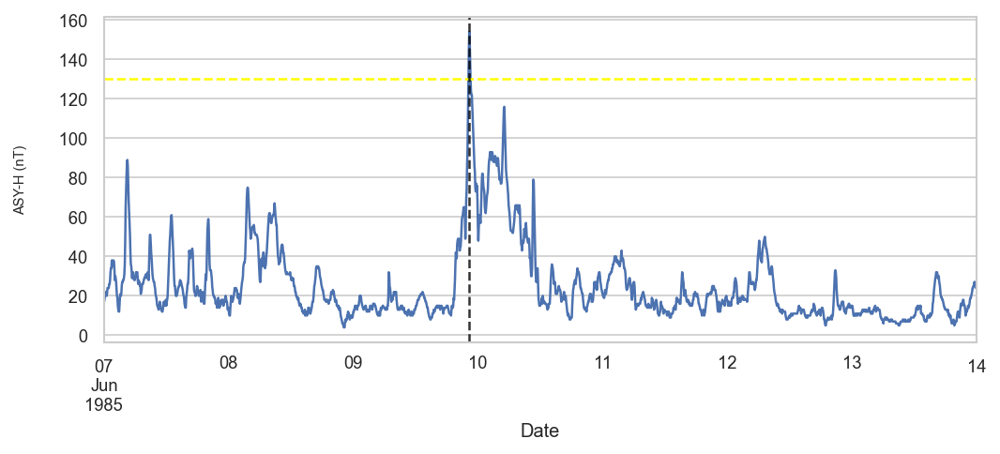

Plotting storm 32
Start date        1985-09-17 00:00:00
End date          1985-09-24 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         142
classification                    LOW
Name: 32, dtype: object
Maximum ASY-H value 142 at: 1985-09-19 10:15:00


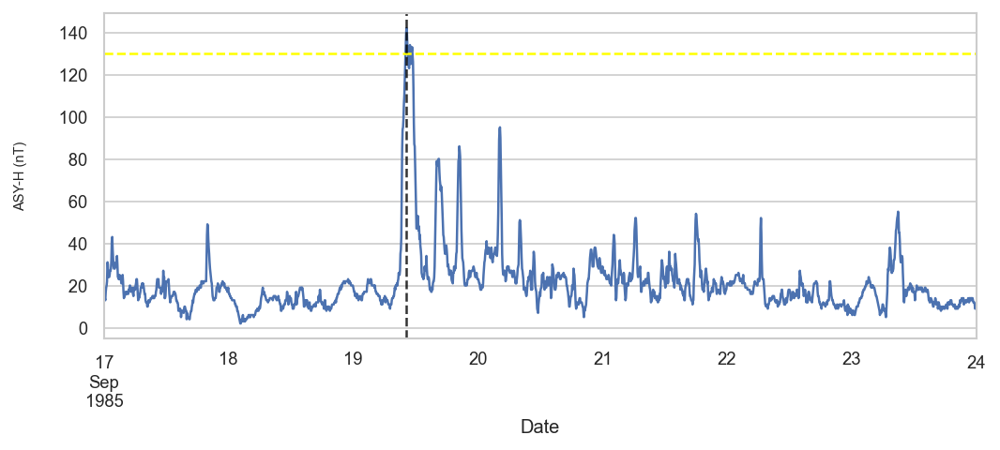

Plotting storm 33
Start date        1985-10-03 00:00:00
End date          1985-10-10 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         165
classification                    LOW
Name: 33, dtype: object
Maximum ASY-H value 165 at: 1985-10-05 20:10:00


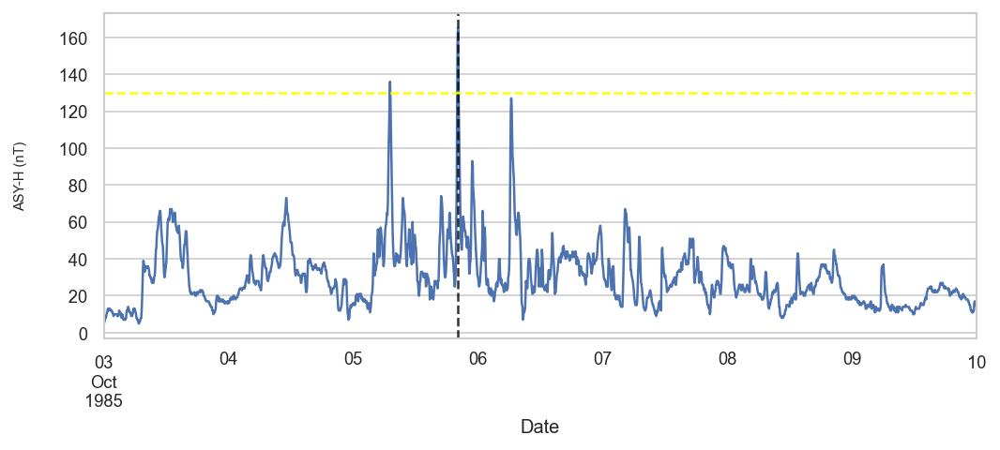

Plotting storm 34
Start date        1985-11-27 00:00:00
End date          1985-12-05 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         164
classification                    LOW
Name: 34, dtype: object
Maximum ASY-H value 164 at: 1985-11-30 01:35:00


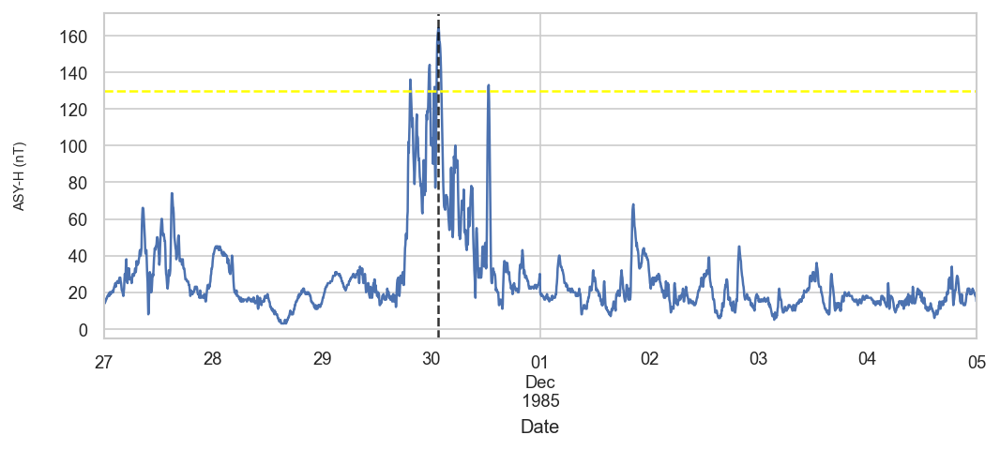

Plotting storm 35
Start date        1985-12-11 00:00:00
End date          1985-12-24 00:00:00
TD                   13 days 00:00:00
Max ASY-H                         141
classification                    LOW
Name: 35, dtype: object
Maximum ASY-H value 141 at: 1985-12-13 11:20:00


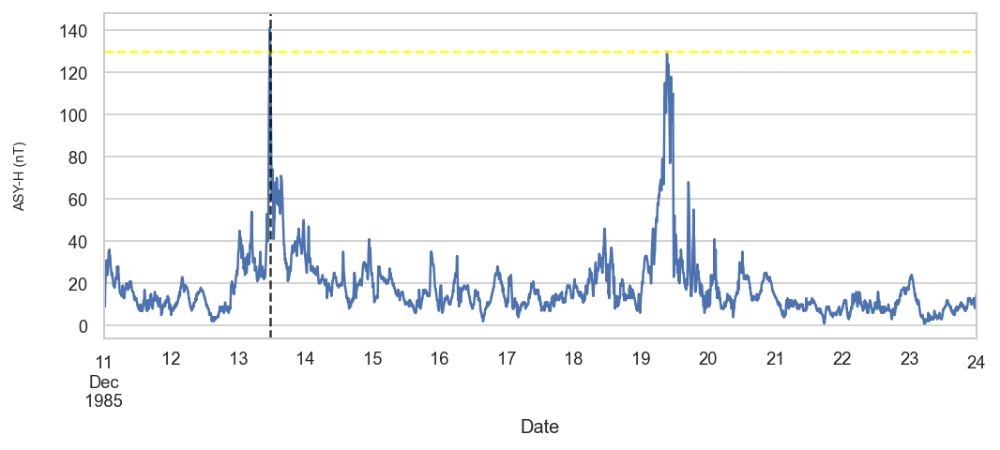

Plotting storm 38
Start date        1986-10-11 00:00:00
End date          1986-10-18 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         142
classification                    LOW
Name: 38, dtype: object
Maximum ASY-H value 142 at: 1986-10-13 20:35:00


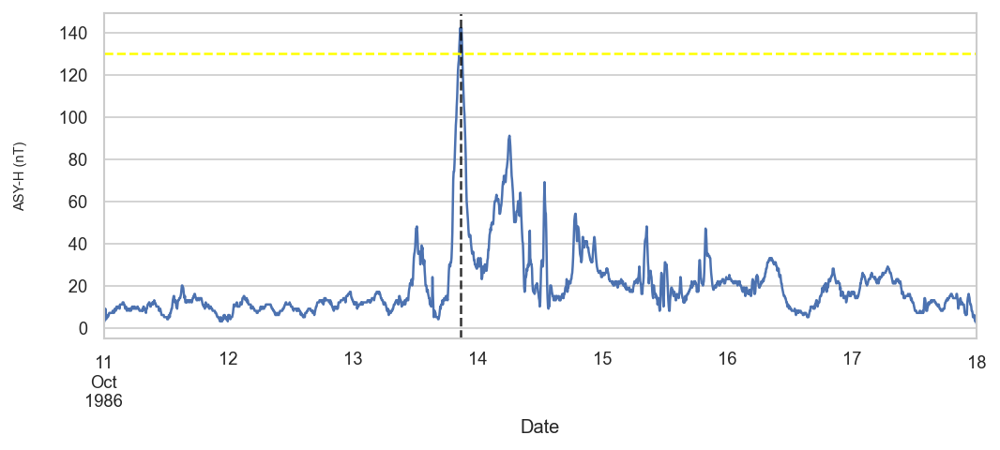

Plotting storm 39
Start date        1986-11-02 00:00:00
End date          1986-11-09 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         138
classification                    LOW
Name: 39, dtype: object
Maximum ASY-H value 138 at: 1986-11-04 00:55:00


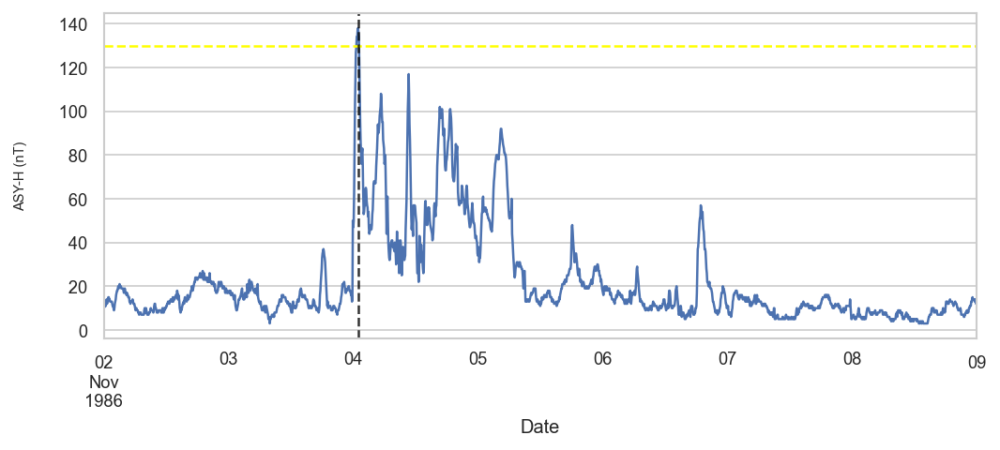

Plotting storm 42
Start date        1987-09-20 00:00:00
End date          1987-09-27 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         131
classification                    LOW
Name: 42, dtype: object
Maximum ASY-H value 131 at: 1987-09-22 23:10:00


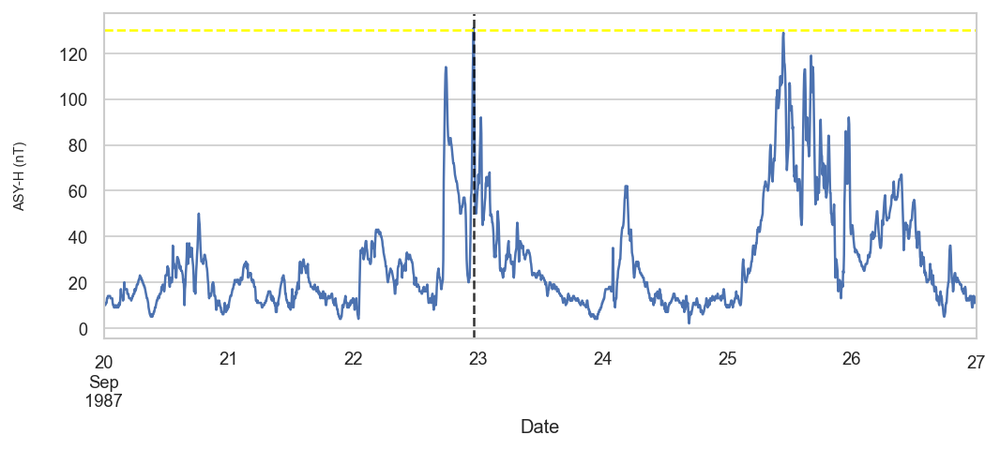

Plotting storm 43
Start date        1987-10-09 00:00:00
End date          1987-10-16 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         166
classification                    LOW
Name: 43, dtype: object
Maximum ASY-H value 166 at: 1987-10-11 15:25:00


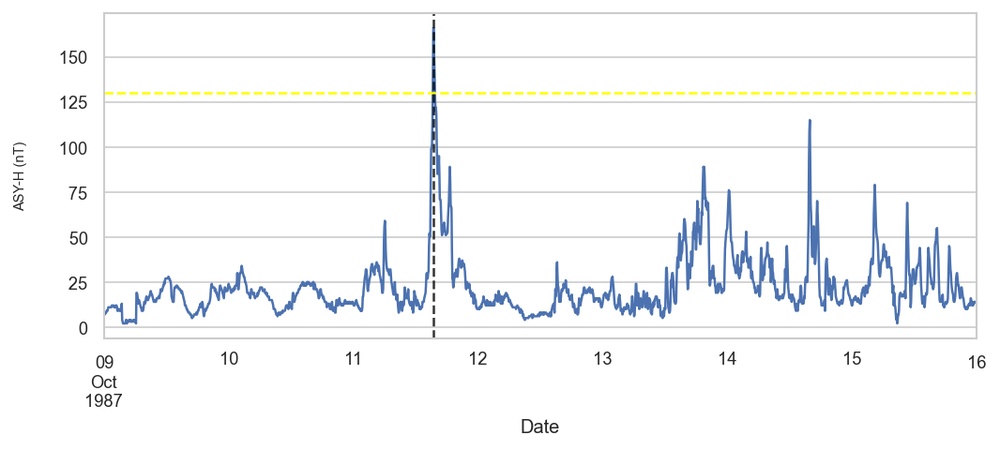

Plotting storm 44
Start date        1987-10-26 00:00:00
End date          1987-11-08 00:00:00
TD                   13 days 00:00:00
Max ASY-H                         148
classification                    LOW
Name: 44, dtype: object
Maximum ASY-H value 148 at: 1987-10-28 00:15:00


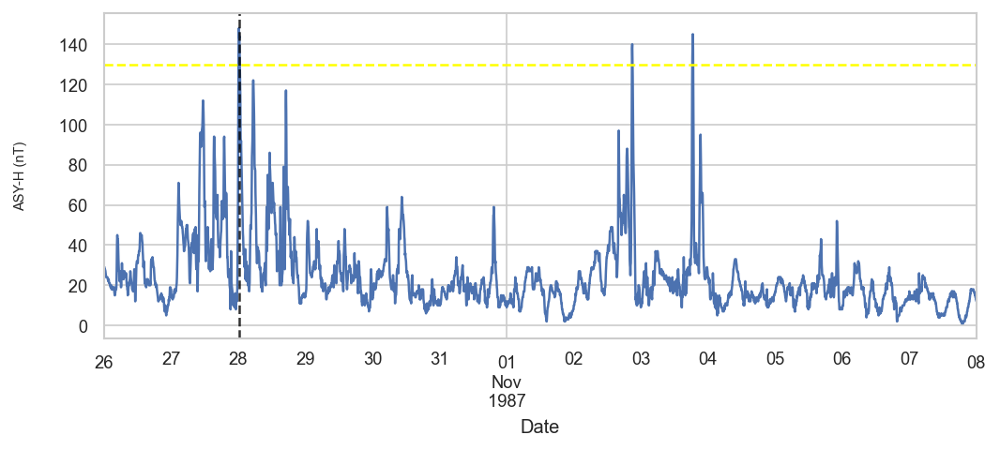

Plotting storm 46
Start date        1988-01-04 00:00:00
End date          1988-01-11 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         132
classification                    LOW
Name: 46, dtype: object
Maximum ASY-H value 132 at: 1988-01-06 17:40:00


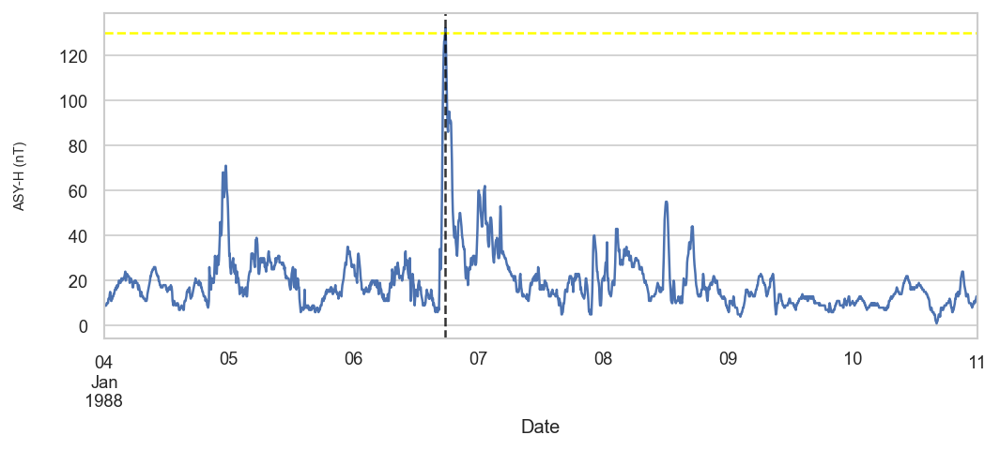

Plotting storm 47
Start date        1988-01-12 00:00:00
End date          1988-01-20 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         136
classification                    LOW
Name: 47, dtype: object
Maximum ASY-H value 136 at: 1988-01-14 19:25:00


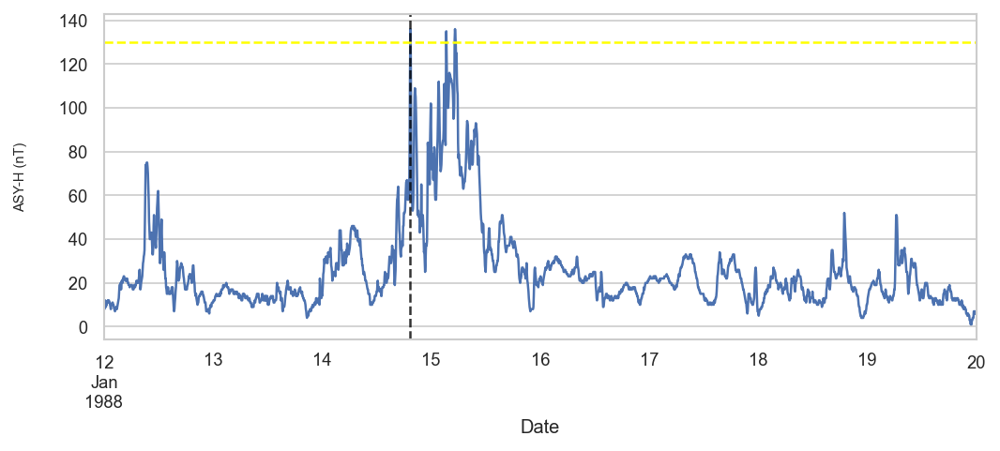

Plotting storm 49
Start date        1988-03-24 00:00:00
End date          1988-03-31 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         155
classification                    LOW
Name: 49, dtype: object
Maximum ASY-H value 155 at: 1988-03-26 21:05:00


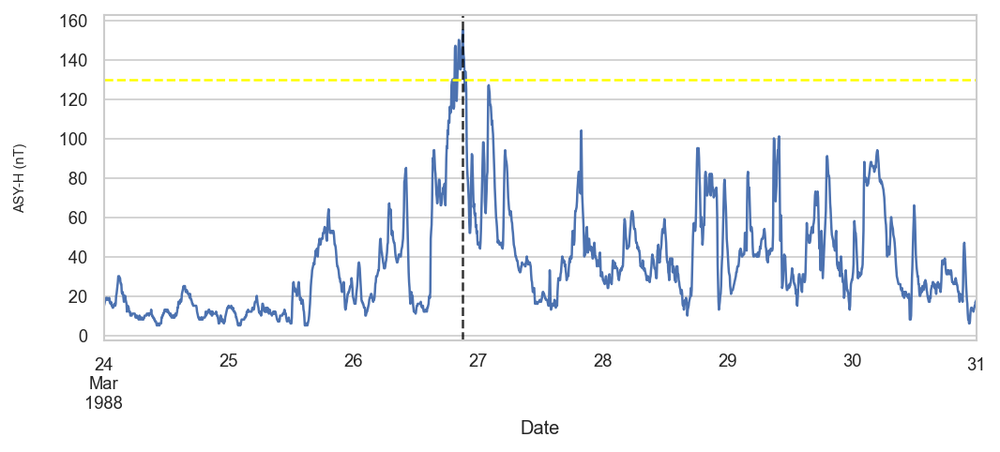

Plotting storm 51
Start date        1988-05-04 00:00:00
End date          1988-05-11 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         166
classification                    LOW
Name: 51, dtype: object
Maximum ASY-H value 166 at: 1988-05-06 08:50:00


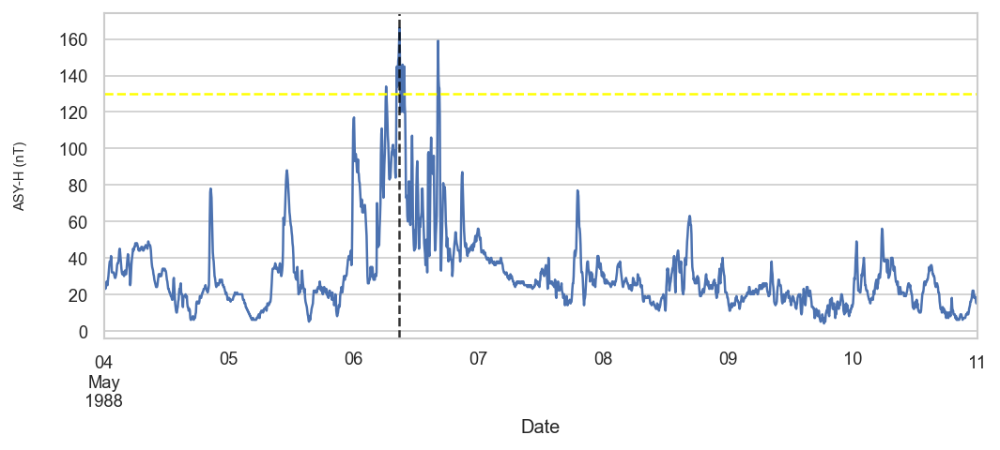

Plotting storm 52
Start date        1988-09-09 00:00:00
End date          1988-09-16 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         137
classification                    LOW
Name: 52, dtype: object
Maximum ASY-H value 137 at: 1988-09-11 11:05:00


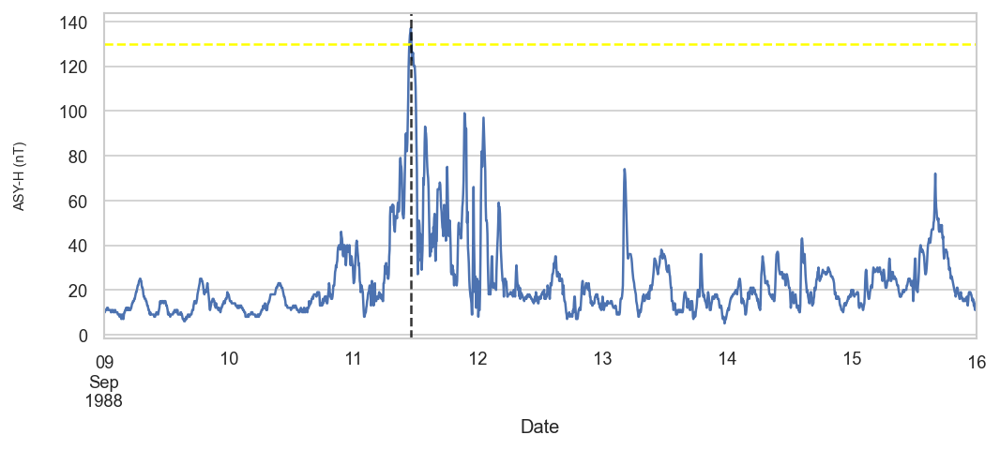

Plotting storm 55
Start date        1988-12-15 00:00:00
End date          1988-12-22 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         138
classification                    LOW
Name: 55, dtype: object
Maximum ASY-H value 138 at: 1988-12-17 20:15:00


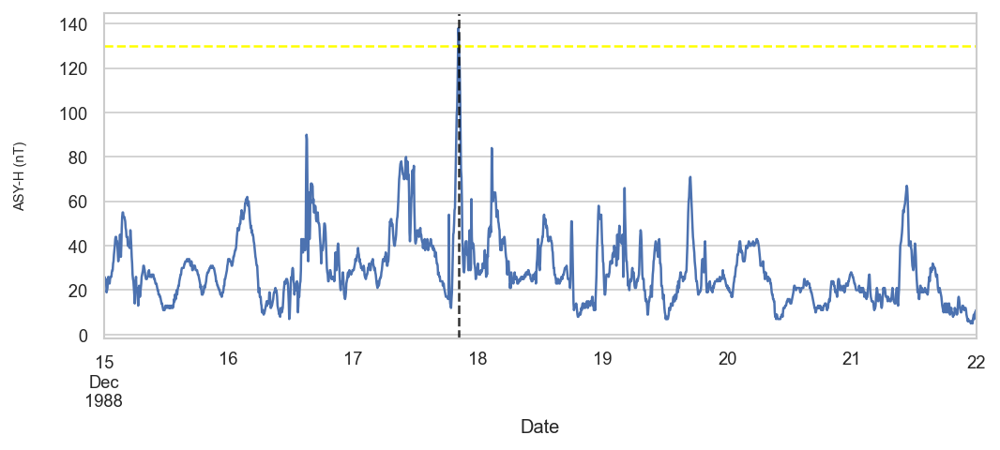

Plotting storm 56
Start date        1988-12-23 00:00:00
End date          1988-12-30 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         135
classification                    LOW
Name: 56, dtype: object
Maximum ASY-H value 135 at: 1988-12-25 12:30:00


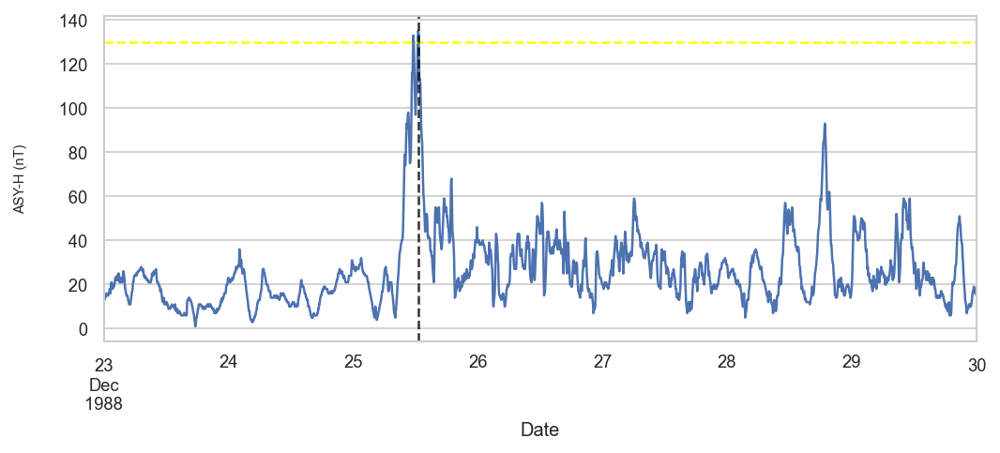

Plotting storm 69
Start date        1989-12-27 00:00:00
End date          1990-01-03 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         161
classification                    LOW
Name: 69, dtype: object
Maximum ASY-H value 161 at: 1989-12-29 21:10:00


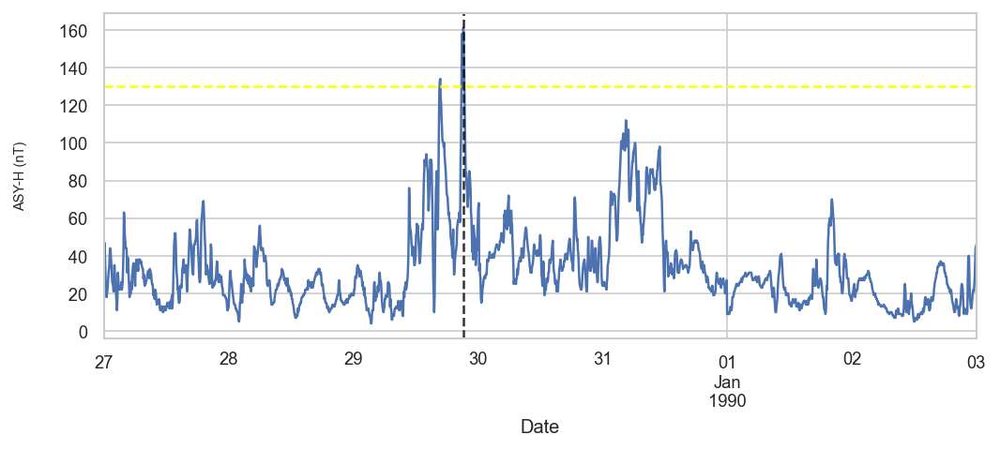

Plotting storm 70
Start date        1990-02-18 00:00:00
End date          1990-02-25 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         136
classification                    LOW
Name: 70, dtype: object
Maximum ASY-H value 136 at: 1990-02-20 19:25:00


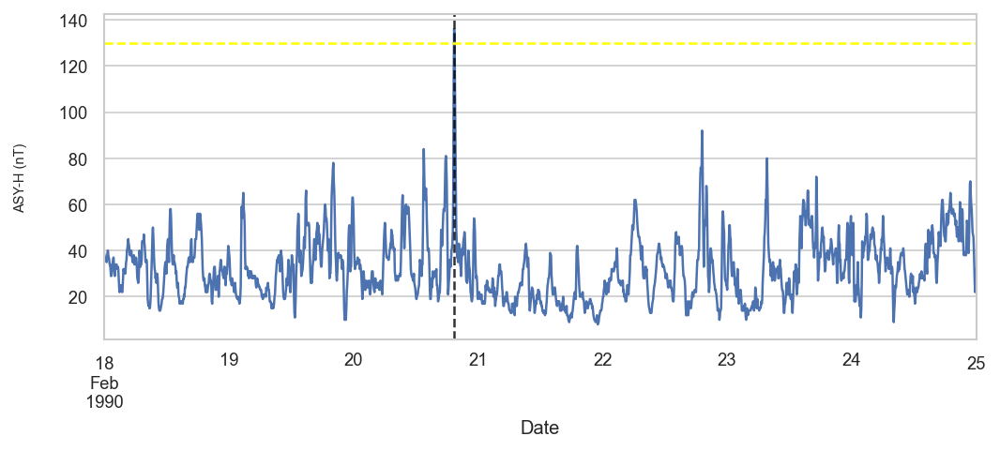

Plotting storm 71
Start date        1990-03-18 00:00:00
End date          1990-03-26 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         165
classification                    LOW
Name: 71, dtype: object
Maximum ASY-H value 165 at: 1990-03-21 00:25:00


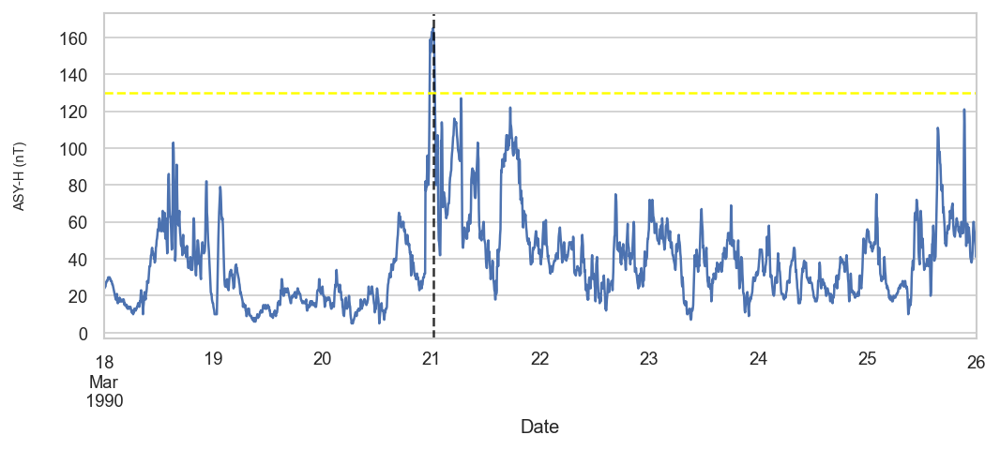

Plotting storm 77
Start date        1990-08-24 00:00:00
End date          1990-09-06 00:00:00
TD                   13 days 00:00:00
Max ASY-H                         152
classification                    LOW
Name: 77, dtype: object
Maximum ASY-H value 152 at: 1990-09-01 12:40:00


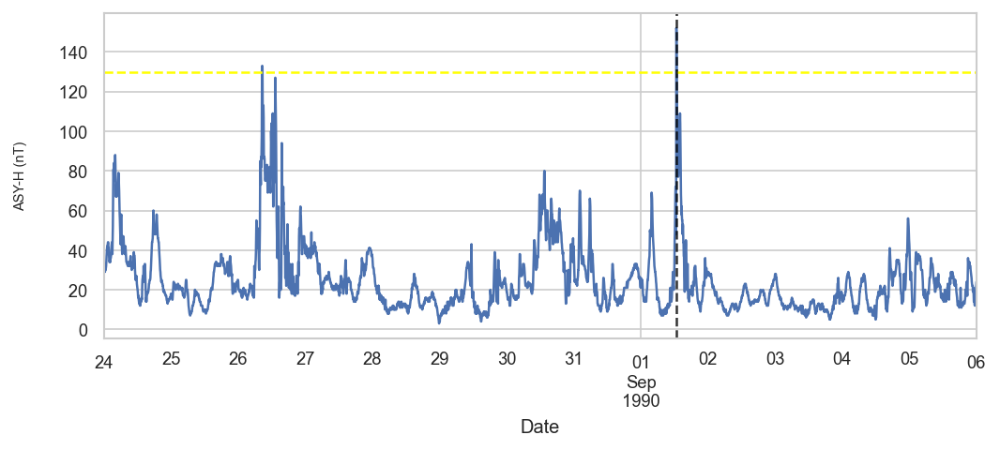

Plotting storm 79
Start date        1990-10-28 00:00:00
End date          1990-11-04 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         131
classification                    LOW
Name: 79, dtype: object
Maximum ASY-H value 131 at: 1990-10-30 02:50:00


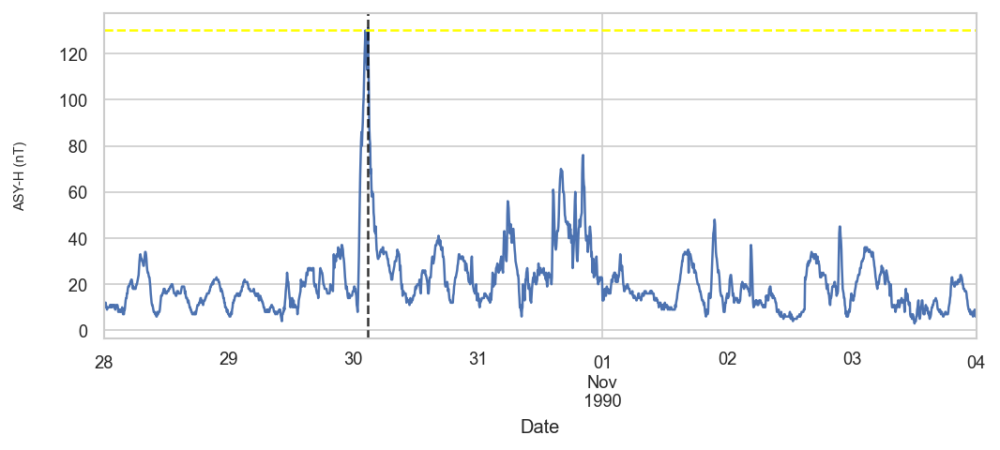

Plotting storm 84
Start date        1991-08-10 00:00:00
End date          1991-08-17 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 84, dtype: object
Maximum ASY-H value 143 at: 1991-08-12 15:20:00


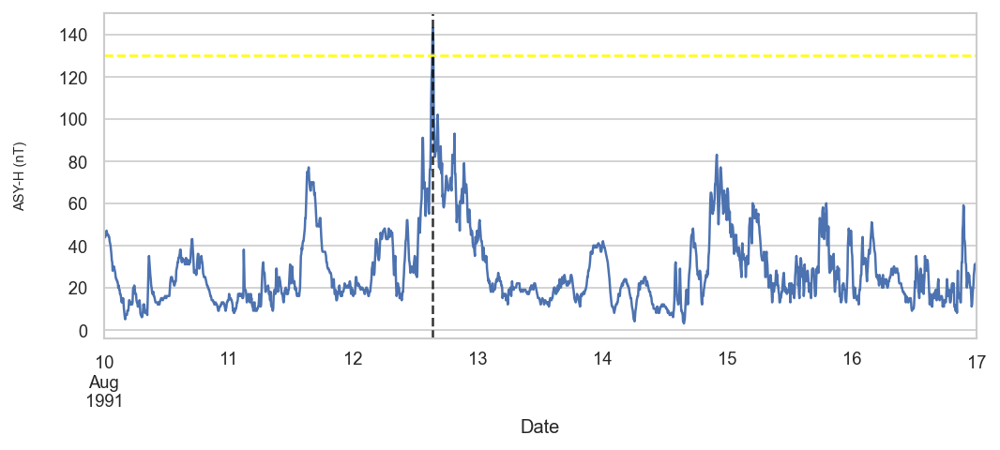

Plotting storm 89
Start date        1991-12-25 00:00:00
End date          1992-01-01 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         156
classification                    LOW
Name: 89, dtype: object
Maximum ASY-H value 156 at: 1991-12-27 22:10:00


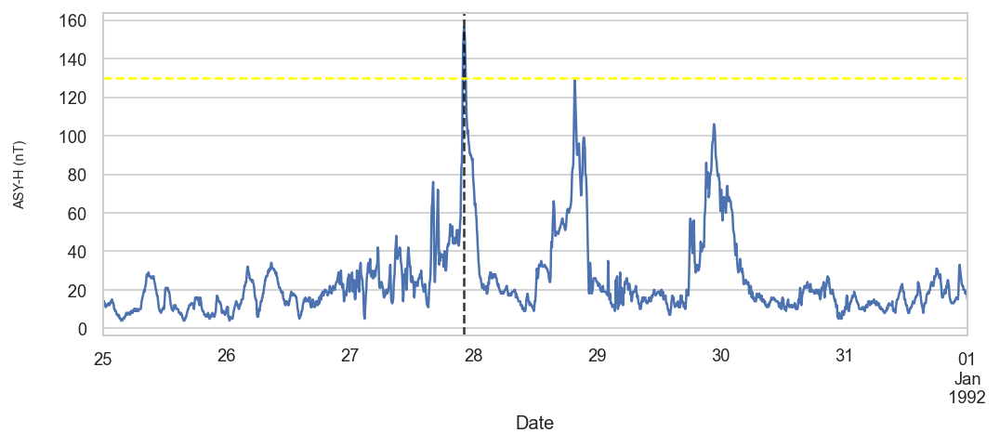

Plotting storm 94
Start date        1992-08-21 00:00:00
End date          1992-08-28 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         165
classification                    LOW
Name: 94, dtype: object
Maximum ASY-H value 165 at: 1992-08-23 04:40:00


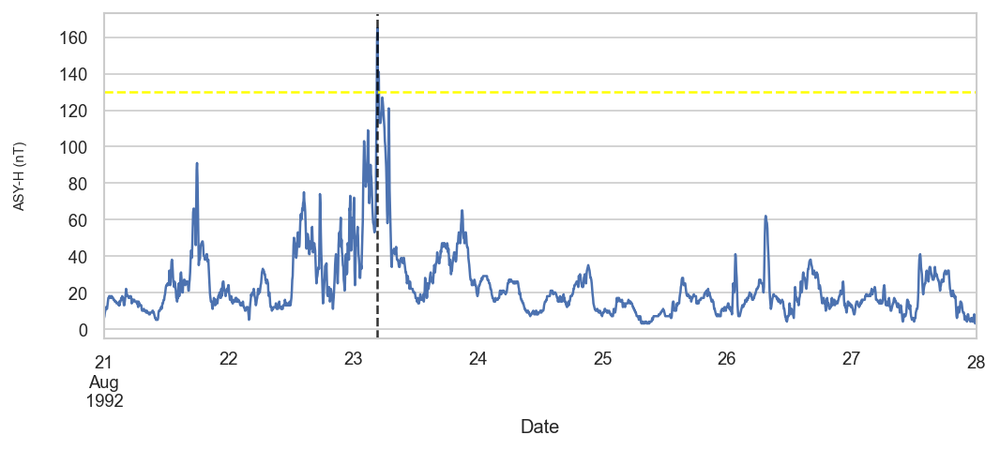

Plotting storm 97
Start date        1992-10-10 00:00:00
End date          1992-10-17 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         135
classification                    LOW
Name: 97, dtype: object
Maximum ASY-H value 135 at: 1992-10-12 10:35:00


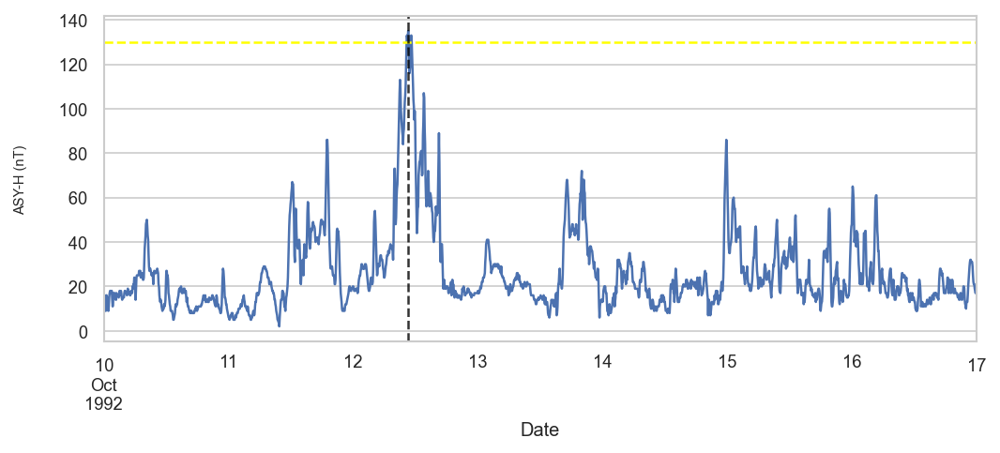

Plotting storm 98
Start date        1993-01-29 00:00:00
End date          1993-02-05 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         132
classification                    LOW
Name: 98, dtype: object
Maximum ASY-H value 132 at: 1993-01-31 09:05:00


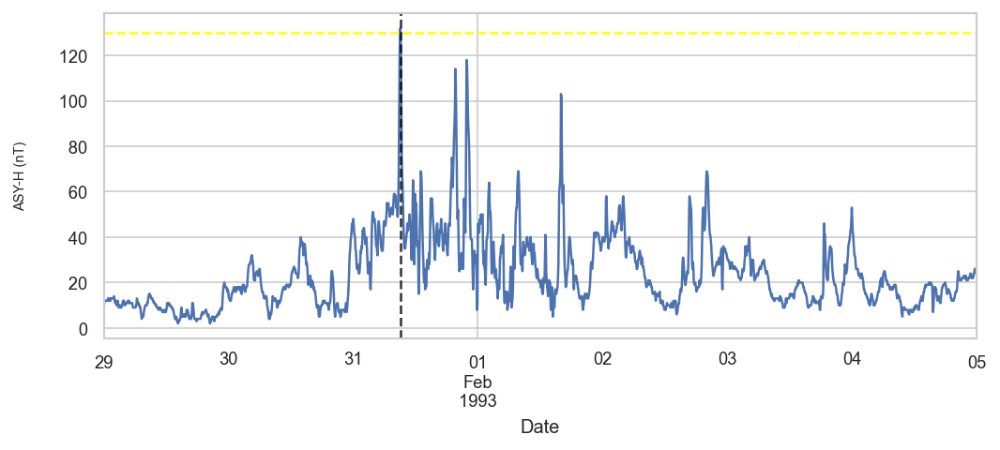

Plotting storm 99
Start date        1993-03-13 00:00:00
End date          1993-03-20 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         147
classification                    LOW
Name: 99, dtype: object
Maximum ASY-H value 147 at: 1993-03-15 11:35:00


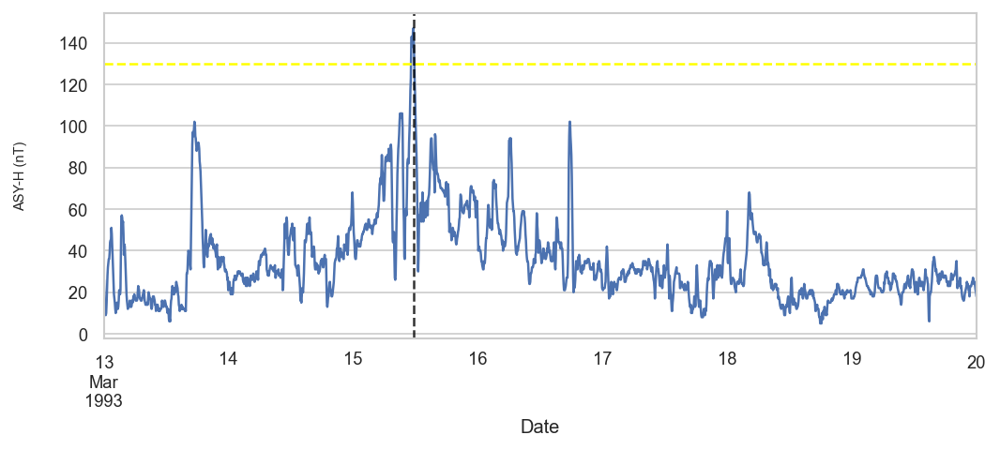

Plotting storm 100
Start date        1993-04-02 00:00:00
End date          1993-04-10 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         158
classification                    LOW
Name: 100, dtype: object
Maximum ASY-H value 158 at: 1993-04-05 10:25:00


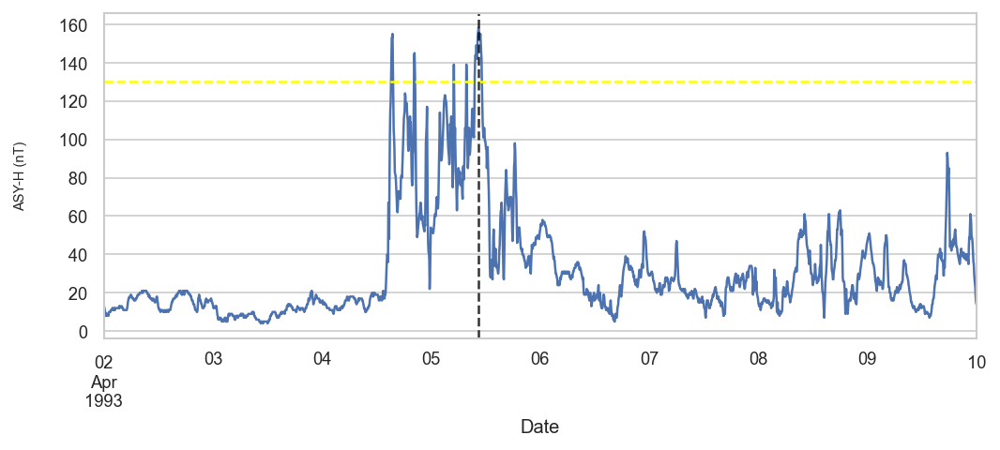

Plotting storm 101
Start date        1993-06-08 00:00:00
End date          1993-06-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         147
classification                    LOW
Name: 101, dtype: object
Maximum ASY-H value 147 at: 1993-06-10 22:20:00


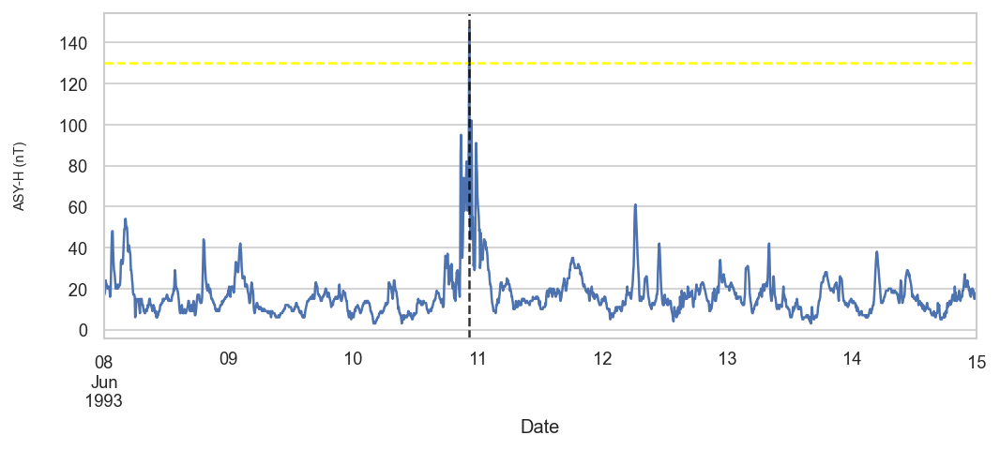

Plotting storm 102
Start date        1993-08-15 00:00:00
End date          1993-08-22 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         131
classification                    LOW
Name: 102, dtype: object
Maximum ASY-H value 131 at: 1993-08-17 00:55:00


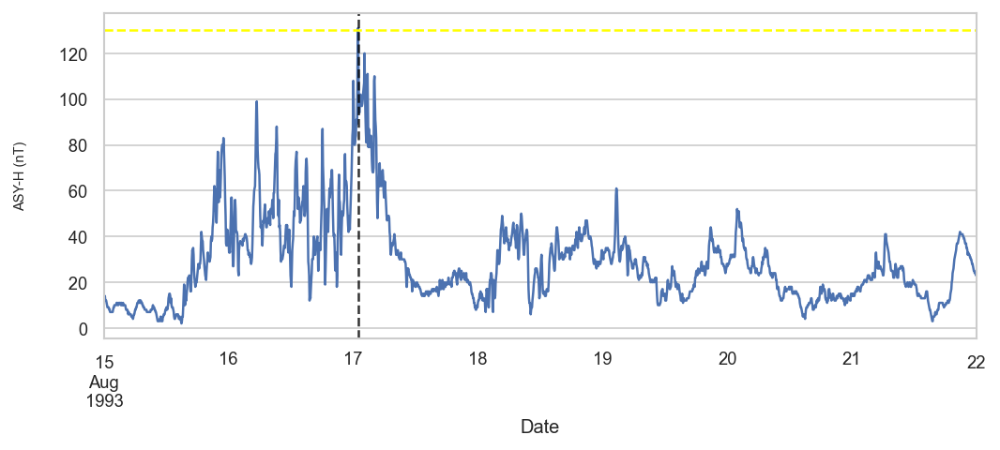

Plotting storm 103
Start date        1993-09-11 00:00:00
End date          1993-09-18 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         169
classification                    LOW
Name: 103, dtype: object
Maximum ASY-H value 169 at: 1993-09-13 06:35:00


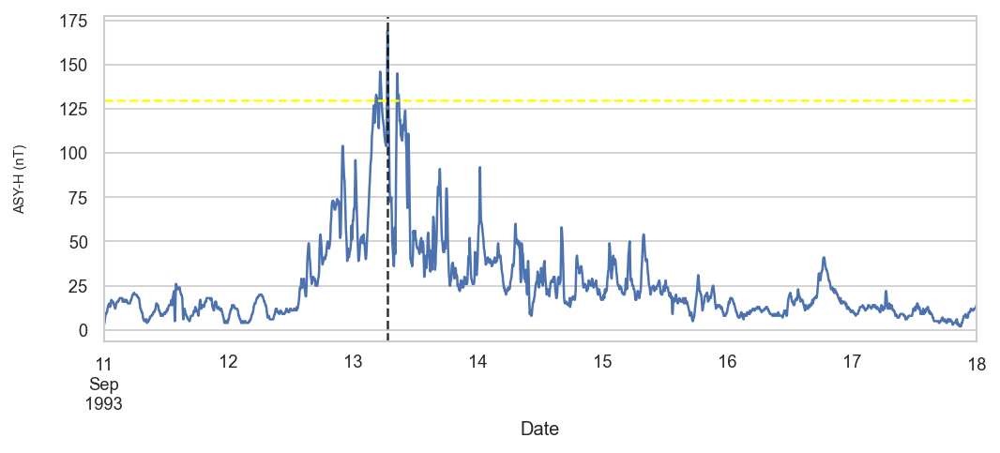

Plotting storm 104
Start date        1993-10-23 00:00:00
End date          1993-10-30 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         137
classification                    LOW
Name: 104, dtype: object
Maximum ASY-H value 137 at: 1993-10-25 14:45:00


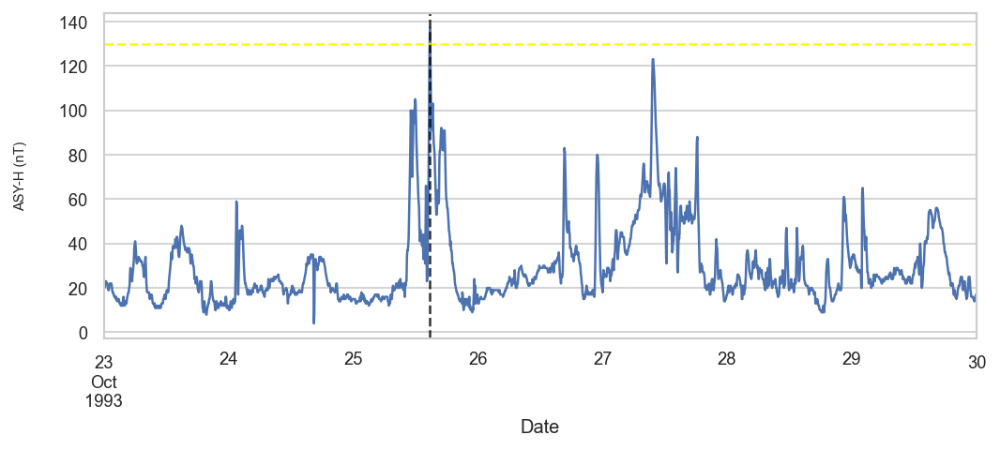

Plotting storm 105
Start date        1993-11-02 00:00:00
End date          1993-11-09 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         138
classification                    LOW
Name: 105, dtype: object
Maximum ASY-H value 138 at: 1993-11-04 00:20:00


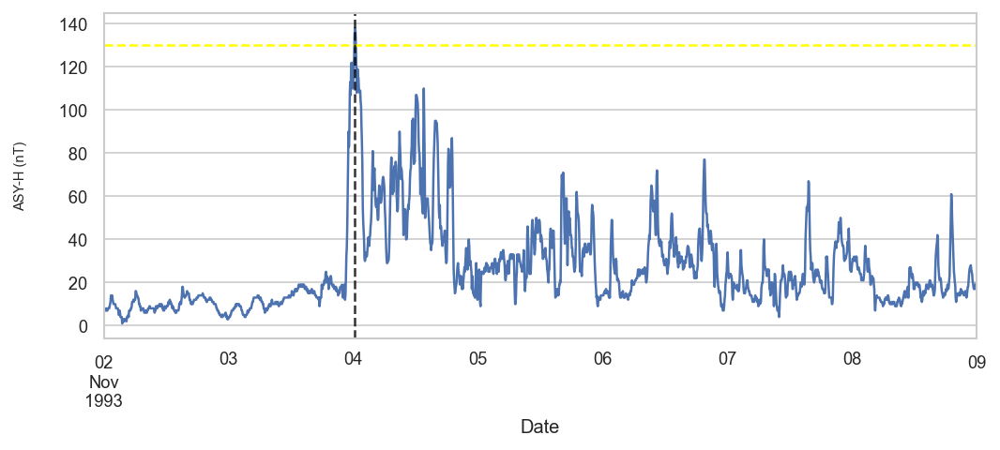

Plotting storm 109
Start date        1994-03-05 00:00:00
End date          1994-03-12 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         134
classification                    LOW
Name: 109, dtype: object
Maximum ASY-H value 134 at: 1994-03-07 16:30:00


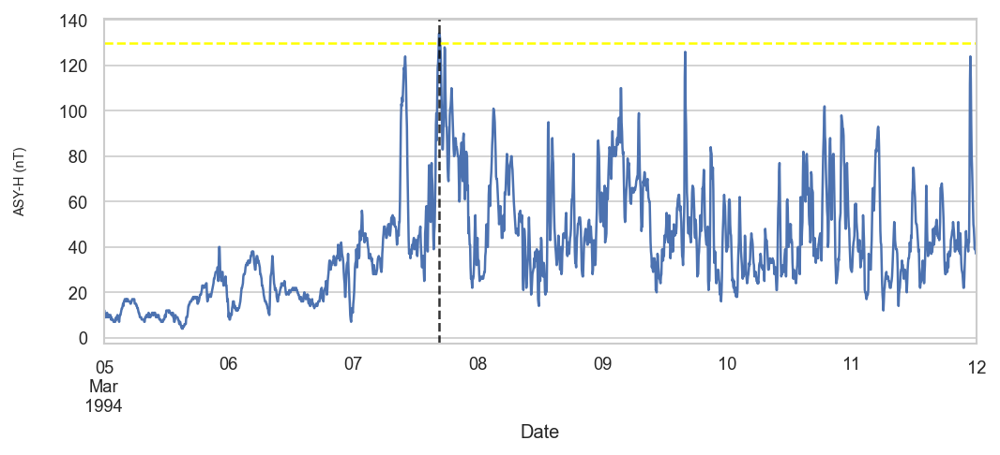

Plotting storm 110
Start date        1994-03-13 00:00:00
End date          1994-03-21 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         137
classification                    LOW
Name: 110, dtype: object
Maximum ASY-H value 137 at: 1994-03-16 17:00:00


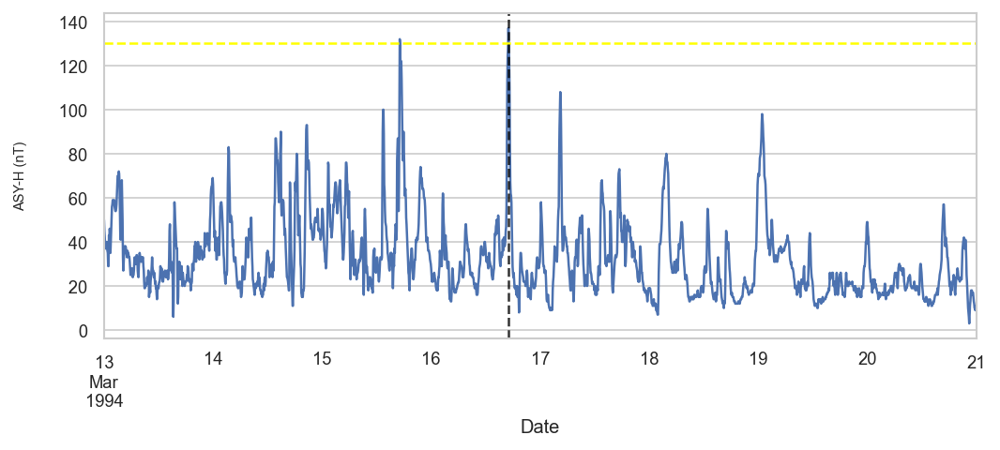

Plotting storm 112
Start date        1994-04-30 00:00:00
End date          1994-05-12 00:00:00
TD                   12 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 112, dtype: object
Maximum ASY-H value 143 at: 1994-05-02 03:35:00


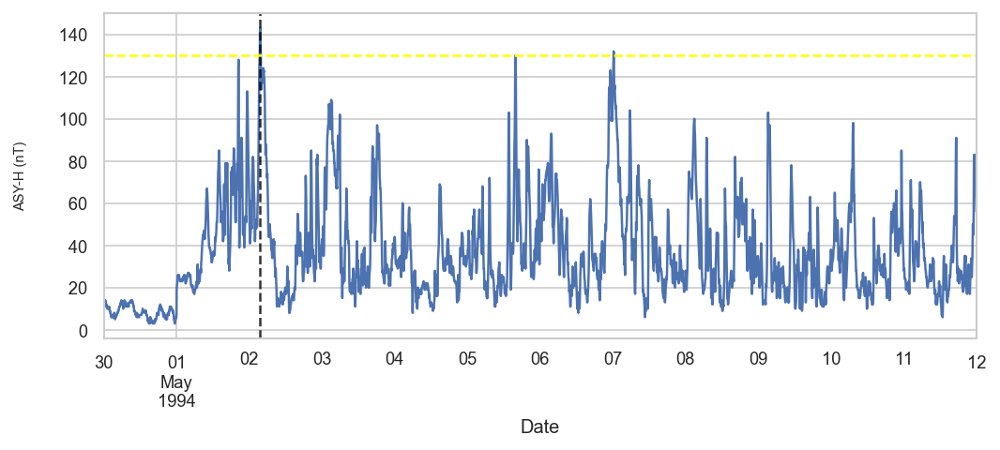

Plotting storm 113
Start date        1994-05-26 00:00:00
End date          1994-06-03 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         138
classification                    LOW
Name: 113, dtype: object
Maximum ASY-H value 138 at: 1994-05-28 19:55:00


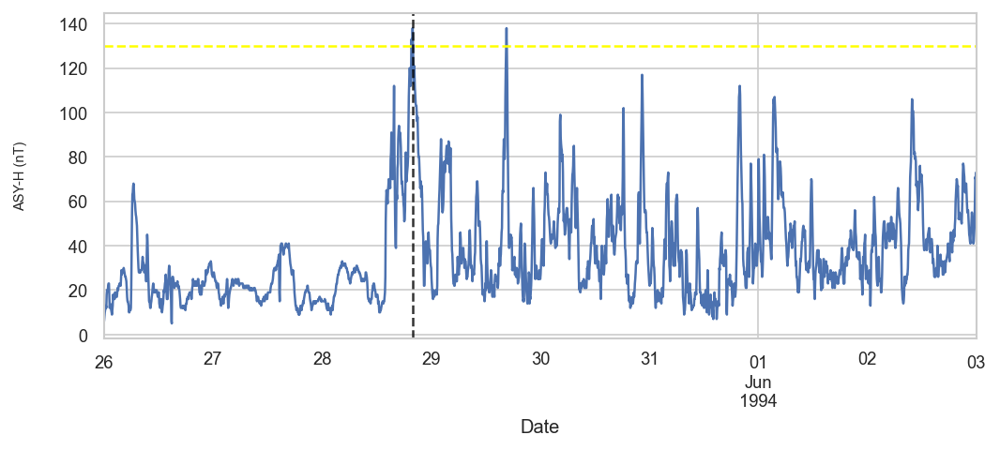

Plotting storm 114
Start date        1994-10-01 00:00:00
End date          1994-10-11 00:00:00
TD                   10 days 00:00:00
Max ASY-H                         142
classification                    LOW
Name: 114, dtype: object
Maximum ASY-H value 142 at: 1994-10-03 14:10:00


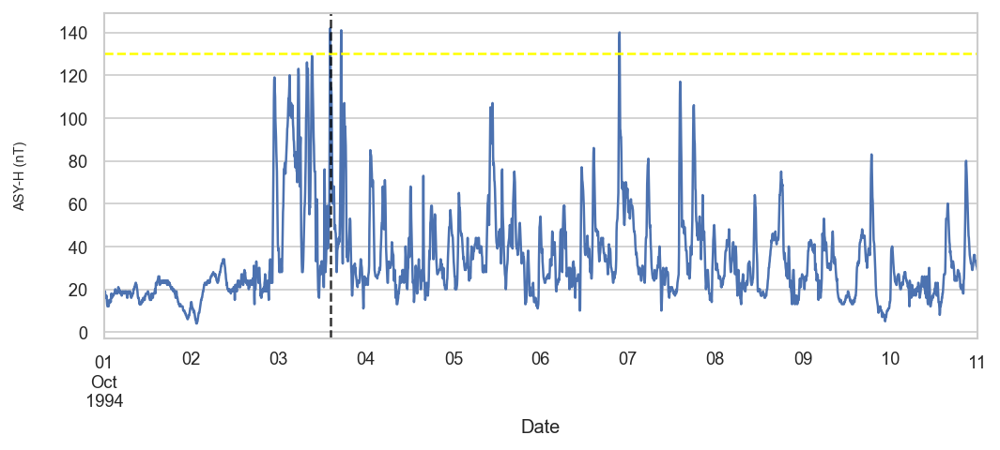

Plotting storm 117
Start date        1995-01-27 00:00:00
End date          1995-02-03 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         135
classification                    LOW
Name: 117, dtype: object
Maximum ASY-H value 135 at: 1995-01-29 21:45:00


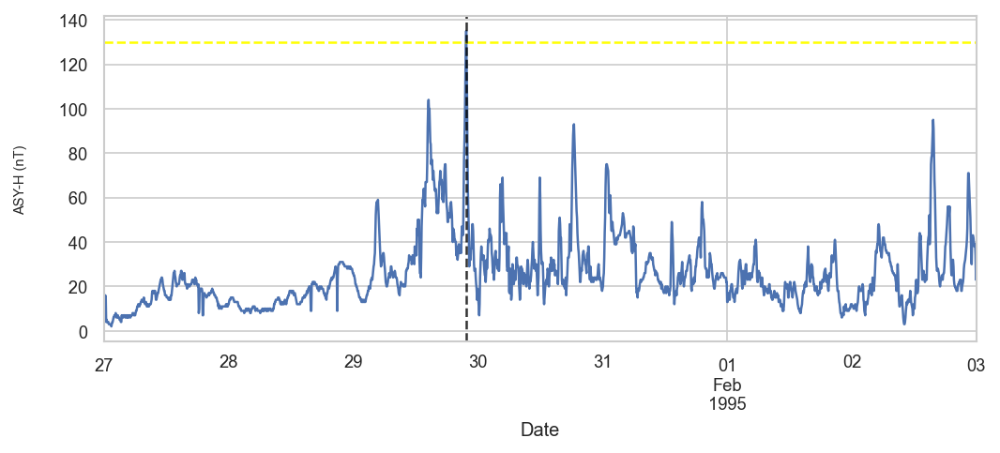

Plotting storm 118
Start date        1995-03-09 00:00:00
End date          1995-03-18 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         153
classification                    LOW
Name: 118, dtype: object
Maximum ASY-H value 153 at: 1995-03-11 22:30:00


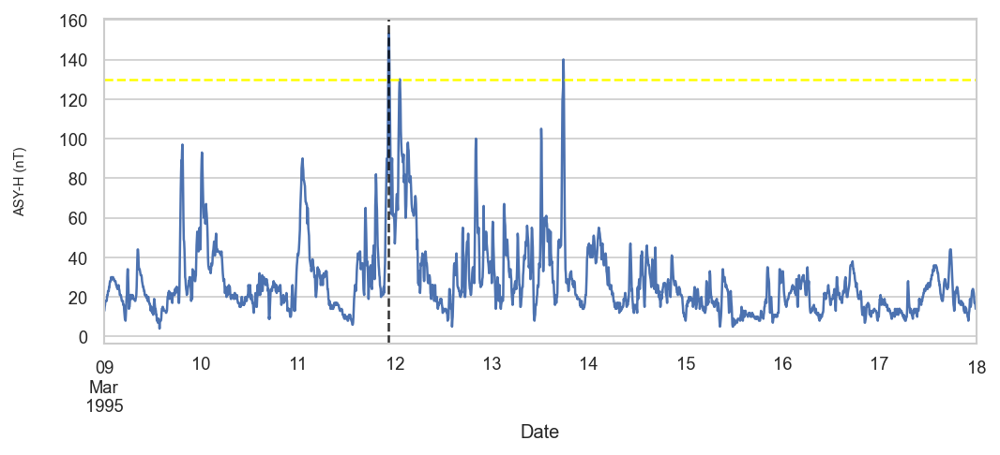

Plotting storm 119
Start date        1995-03-24 00:00:00
End date          1995-03-31 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 119, dtype: object
Maximum ASY-H value 143 at: 1995-03-26 14:25:00


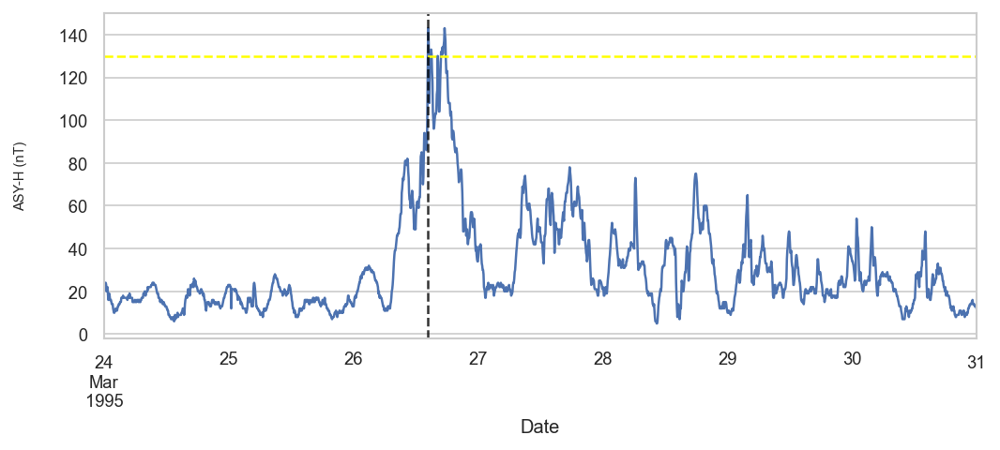

Plotting storm 121
Start date        1995-07-14 00:00:00
End date          1995-07-21 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         155
classification                    LOW
Name: 121, dtype: object
Maximum ASY-H value 155 at: 1995-07-16 15:55:00


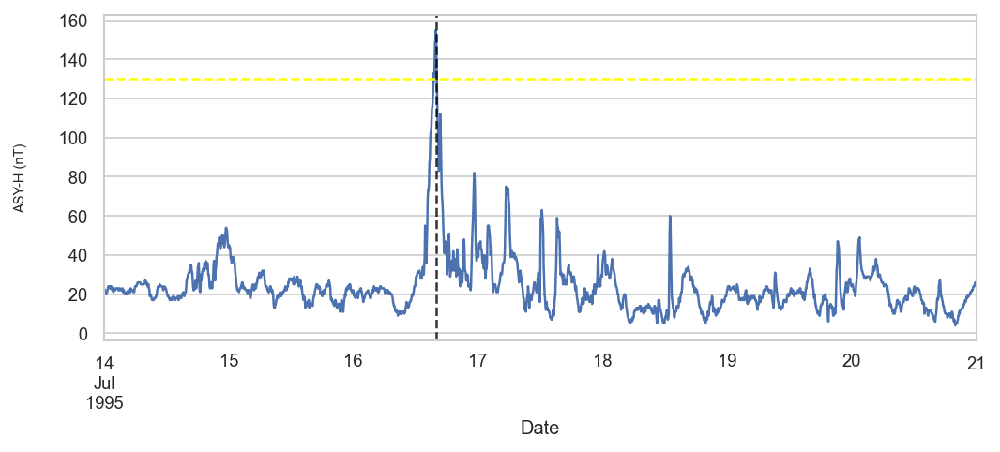

Plotting storm 123
Start date        1995-10-16 00:00:00
End date          1995-10-23 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         131
classification                    LOW
Name: 123, dtype: object
Maximum ASY-H value 131 at: 1995-10-18 22:50:00


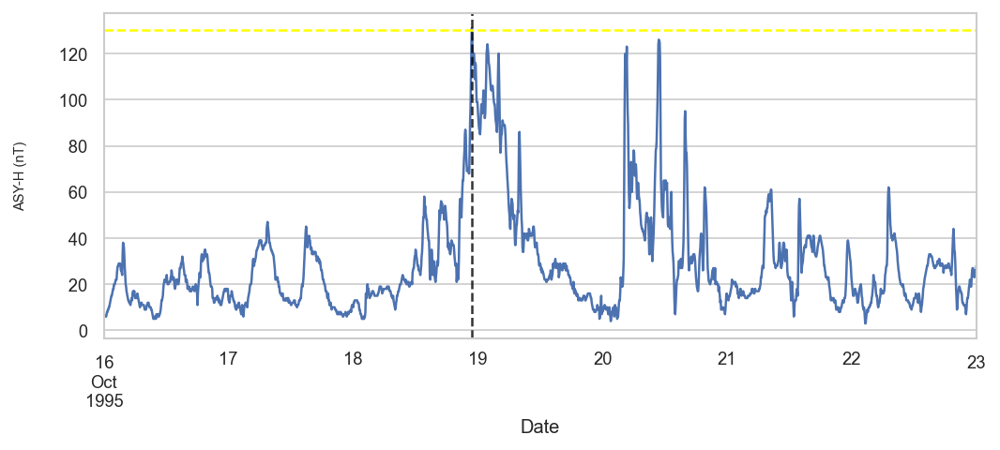

Plotting storm 124
Start date        1995-11-25 00:00:00
End date          1995-12-02 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         156
classification                    LOW
Name: 124, dtype: object
Maximum ASY-H value 156 at: 1995-11-27 11:20:00


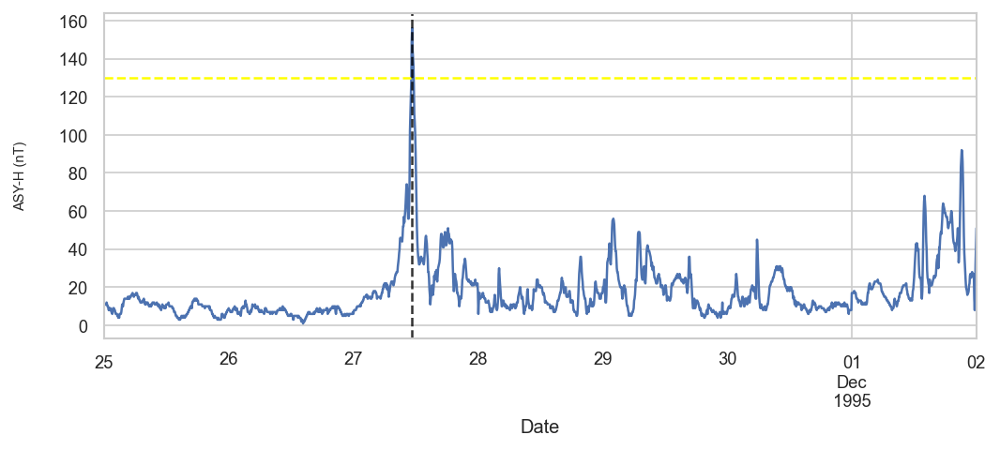

Plotting storm 125
Start date        1996-02-09 00:00:00
End date          1996-02-16 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         134
classification                    LOW
Name: 125, dtype: object
Maximum ASY-H value 134 at: 1996-02-11 03:10:00


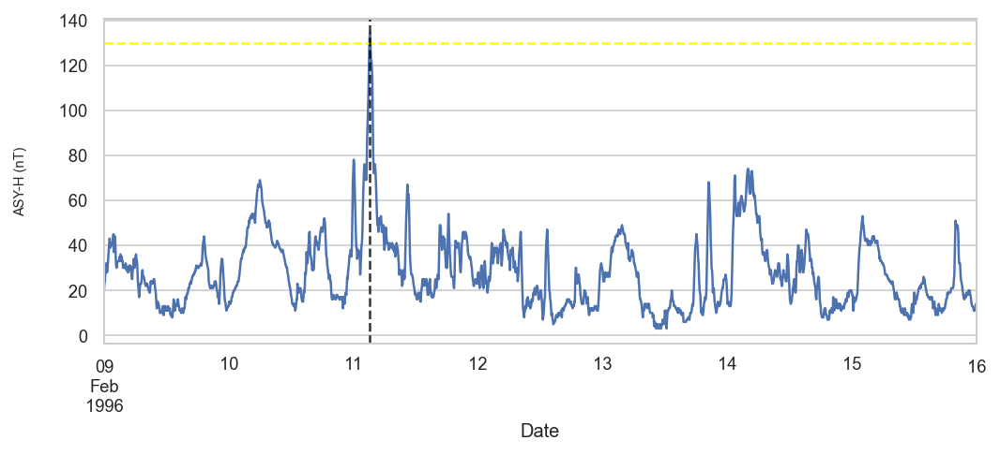

Plotting storm 126
Start date        1996-03-19 00:00:00
End date          1996-03-26 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         140
classification                    LOW
Name: 126, dtype: object
Maximum ASY-H value 140 at: 1996-03-21 21:15:00


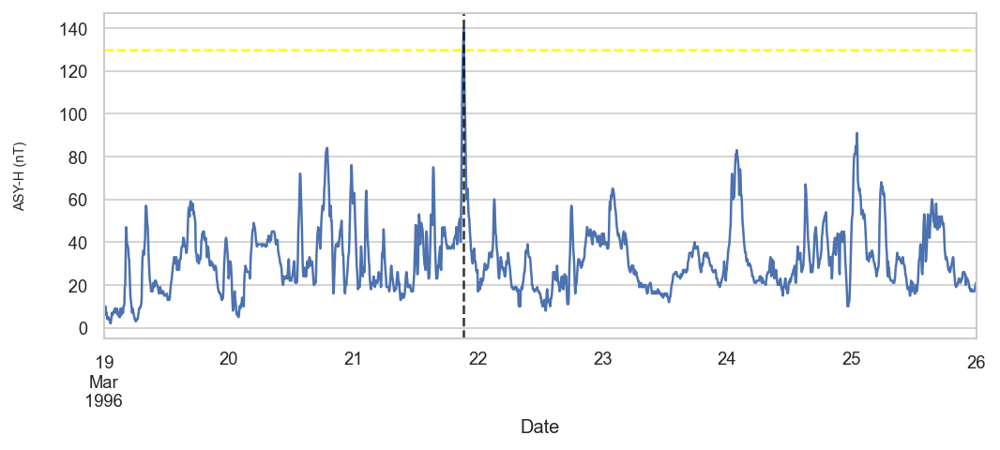

Plotting storm 128
Start date        1996-08-27 00:00:00
End date          1996-09-03 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         144
classification                    LOW
Name: 128, dtype: object
Maximum ASY-H value 144 at: 1996-08-29 07:40:00


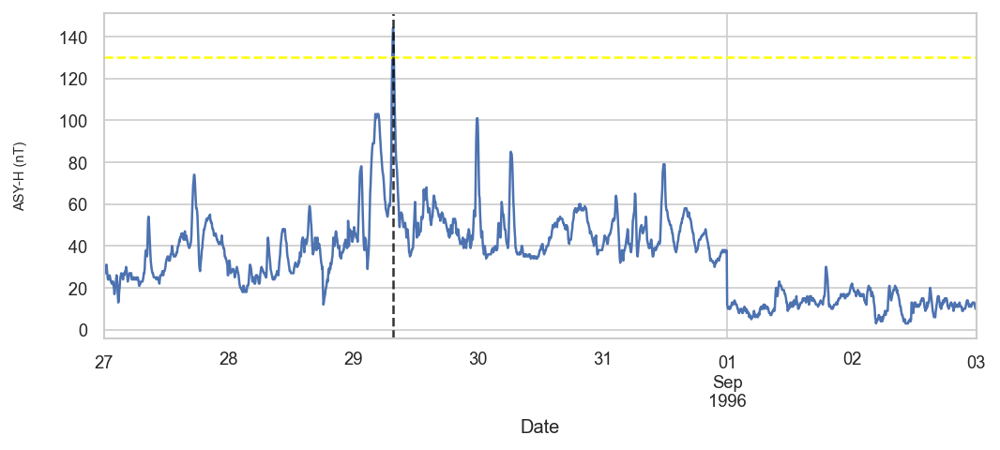

Plotting storm 130
Start date        1996-10-20 00:00:00
End date          1996-10-28 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         168
classification                    LOW
Name: 130, dtype: object
Maximum ASY-H value 168 at: 1996-10-22 22:35:00


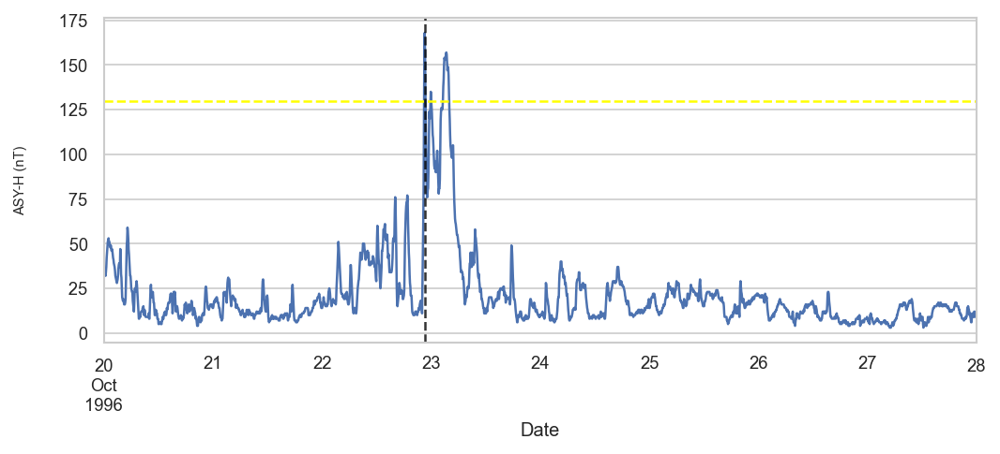

Plotting storm 131
Start date        1997-01-08 00:00:00
End date          1997-01-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         164
classification                    LOW
Name: 131, dtype: object
Maximum ASY-H value 164 at: 1997-01-10 07:40:00


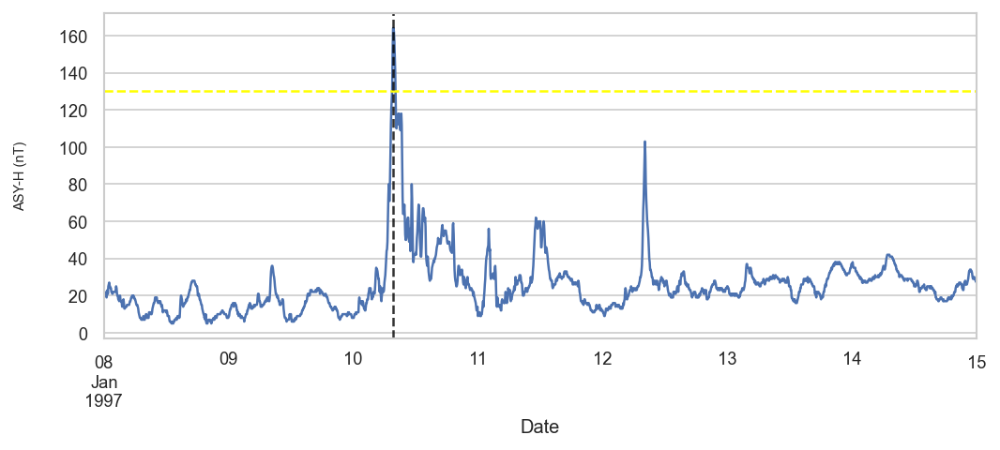

Plotting storm 132
Start date        1997-02-06 00:00:00
End date          1997-02-13 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         144
classification                    LOW
Name: 132, dtype: object
Maximum ASY-H value 144 at: 1997-02-08 14:00:00


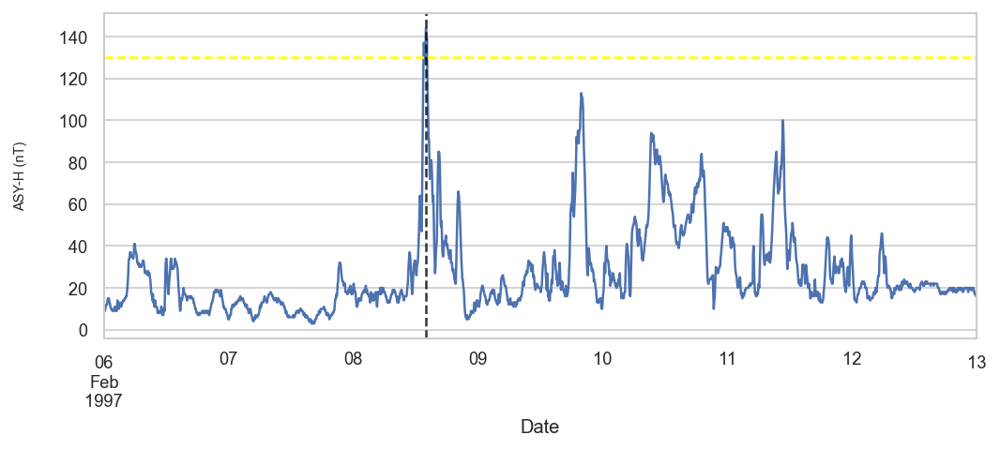

Plotting storm 133
Start date        1997-02-25 00:00:00
End date          1997-03-05 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         144
classification                    LOW
Name: 133, dtype: object
Maximum ASY-H value 144 at: 1997-02-28 05:15:00


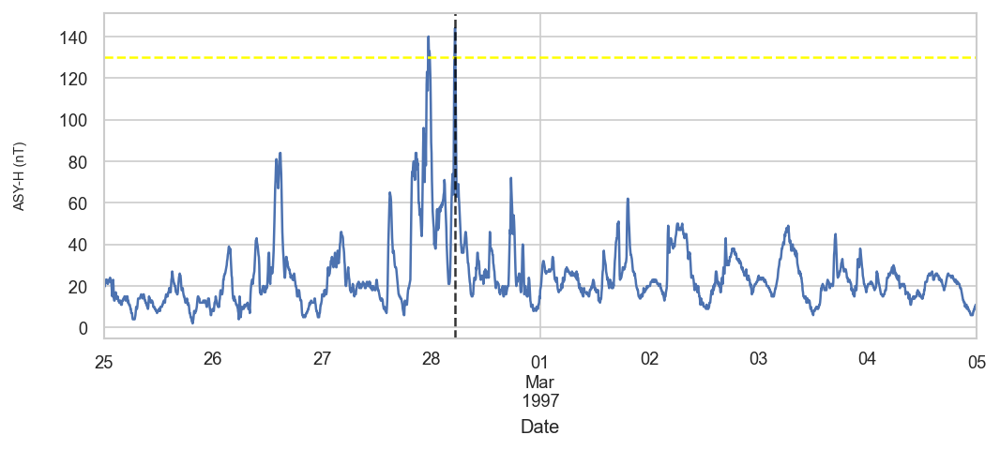

Plotting storm 134
Start date        1997-04-09 00:00:00
End date          1997-04-16 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         164
classification                    LOW
Name: 134, dtype: object
Maximum ASY-H value 164 at: 1997-04-11 03:10:00


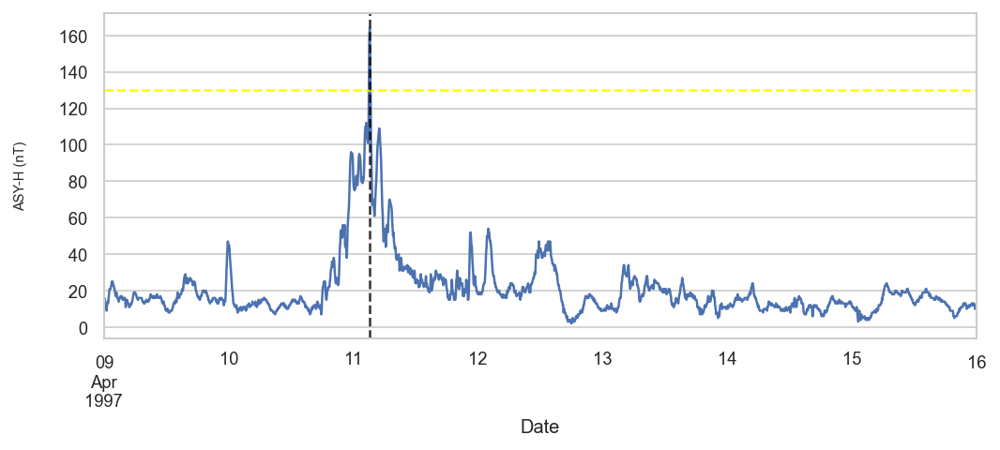

Plotting storm 135
Start date        1997-05-13 00:00:00
End date          1997-05-20 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         137
classification                    LOW
Name: 135, dtype: object
Maximum ASY-H value 137 at: 1997-05-15 08:30:00


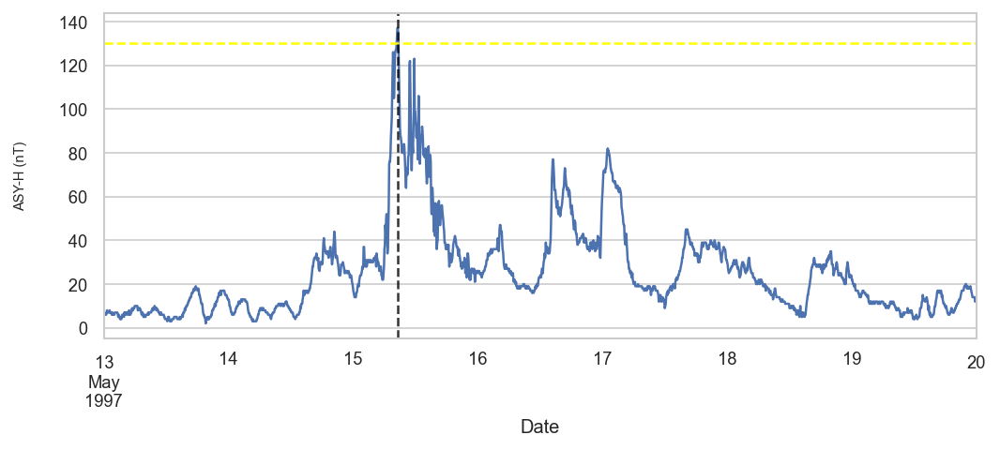

Plotting storm 136
Start date        1997-06-07 00:00:00
End date          1997-06-14 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         151
classification                    LOW
Name: 136, dtype: object
Maximum ASY-H value 151 at: 1997-06-09 04:50:00


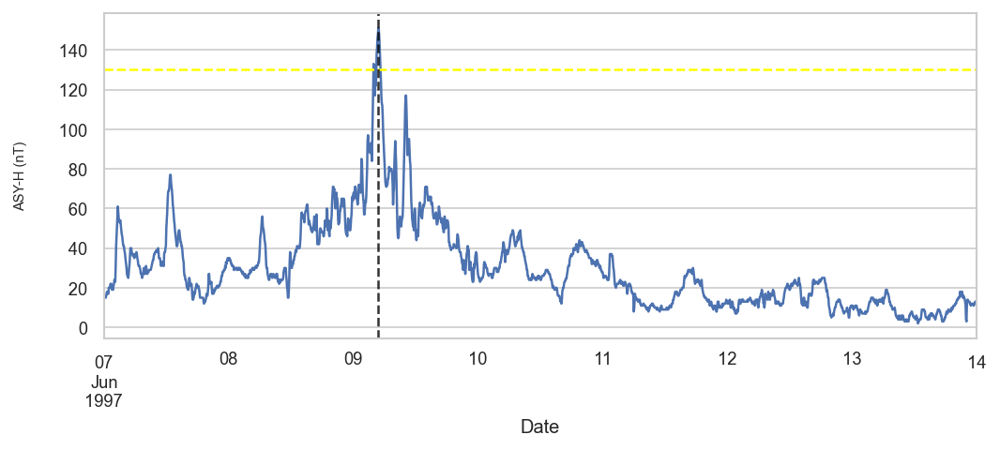

Plotting storm 137
Start date        1997-09-29 00:00:00
End date          1997-10-06 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         149
classification                    LOW
Name: 137, dtype: object
Maximum ASY-H value 149 at: 1997-10-01 16:15:00


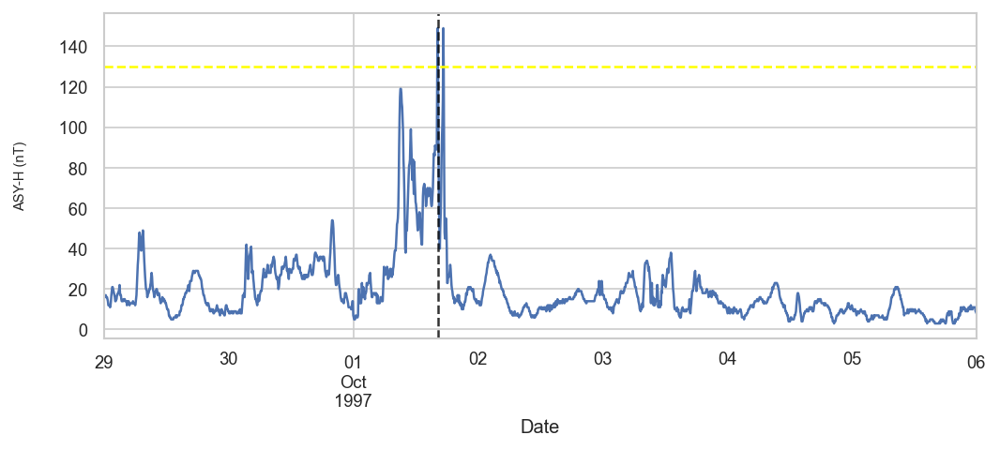

Plotting storm 138
Start date        1997-10-22 00:00:00
End date          1997-10-29 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         136
classification                    LOW
Name: 138, dtype: object
Maximum ASY-H value 136 at: 1997-10-24 13:10:00


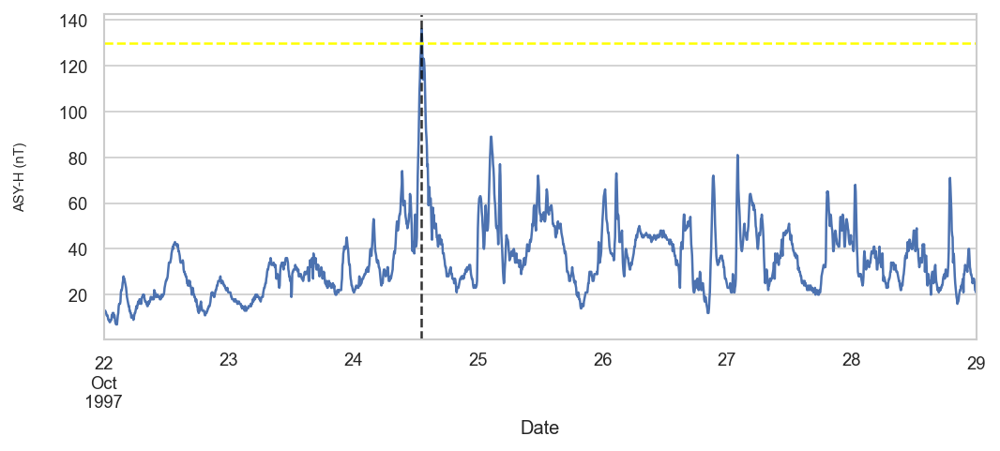

Plotting storm 139
Start date        1997-11-05 00:00:00
End date          1997-11-12 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         146
classification                    LOW
Name: 139, dtype: object
Maximum ASY-H value 146 at: 1997-11-07 05:30:00


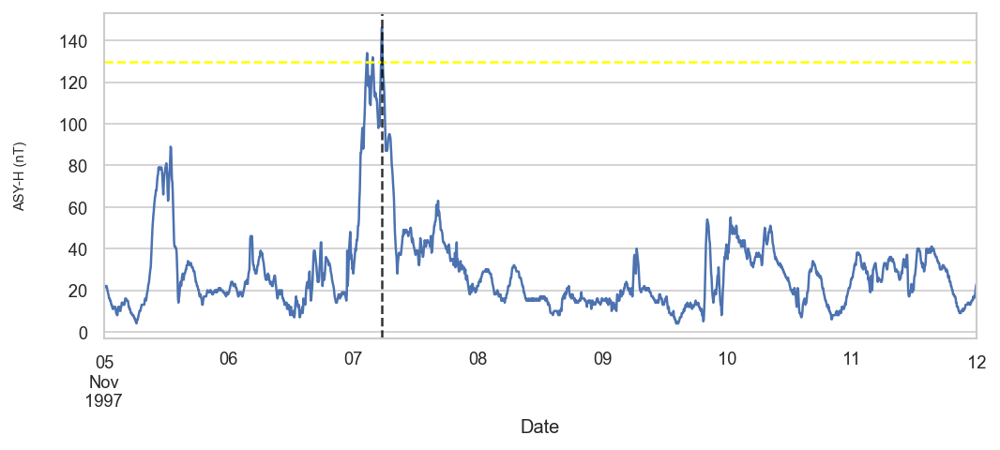

Plotting storm 140
Start date        1997-11-20 00:00:00
End date          1997-11-27 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         159
classification                    LOW
Name: 140, dtype: object
Maximum ASY-H value 159 at: 1997-11-22 12:20:00


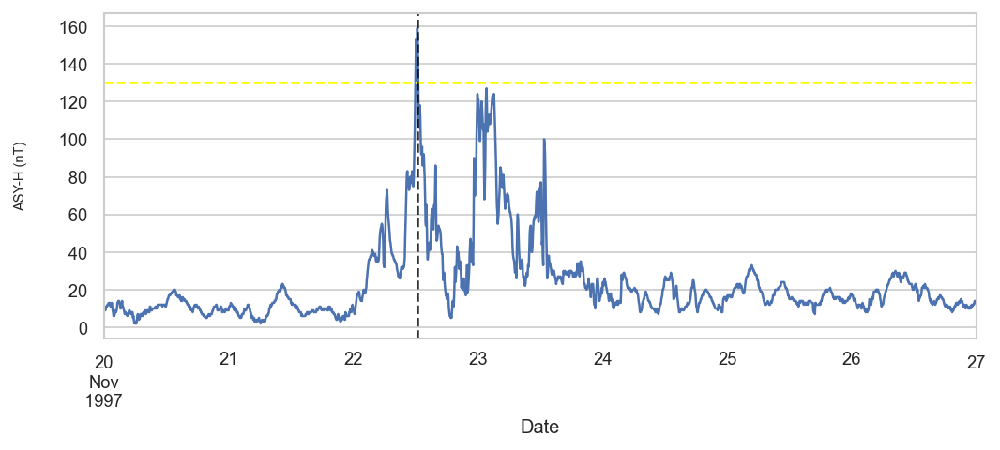

Plotting storm 143
Start date        1998-03-19 00:00:00
End date          1998-03-26 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         138
classification                    LOW
Name: 143, dtype: object
Maximum ASY-H value 138 at: 1998-03-21 16:05:00


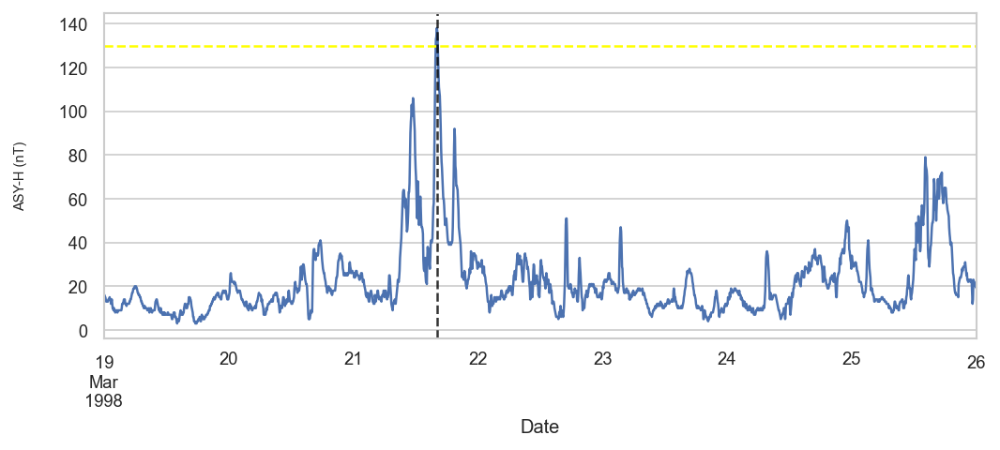

Plotting storm 145
Start date        1998-05-27 00:00:00
End date          1998-06-03 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         159
classification                    LOW
Name: 145, dtype: object
Maximum ASY-H value 159 at: 1998-05-29 16:05:00


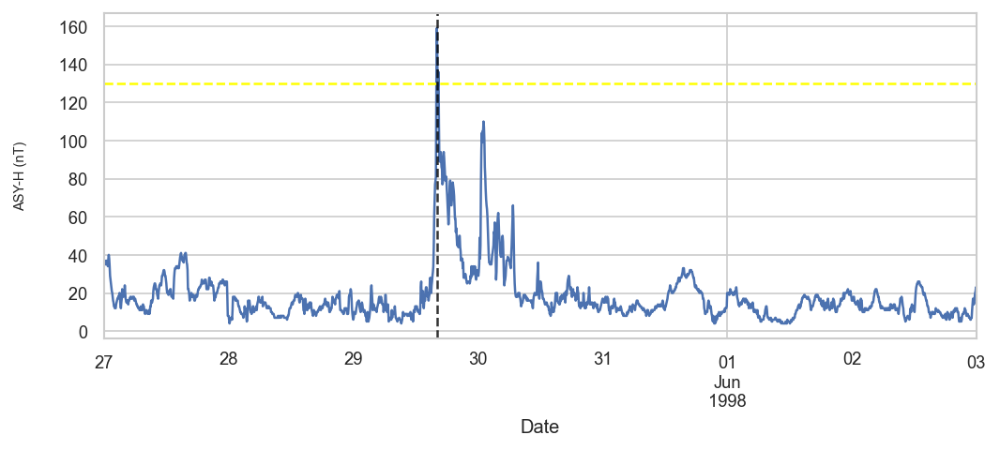

Plotting storm 146
Start date        1998-08-04 00:00:00
End date          1998-08-11 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         136
classification                    LOW
Name: 146, dtype: object
Maximum ASY-H value 136 at: 1998-08-06 08:45:00


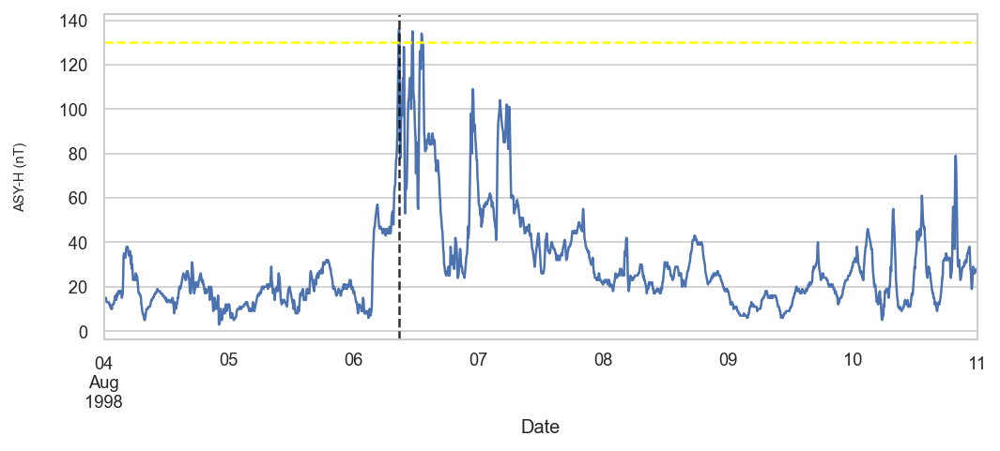

Plotting storm 149
Start date        1998-10-05 00:00:00
End date          1998-10-12 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 149, dtype: object
Maximum ASY-H value 143 at: 1998-10-07 18:10:00


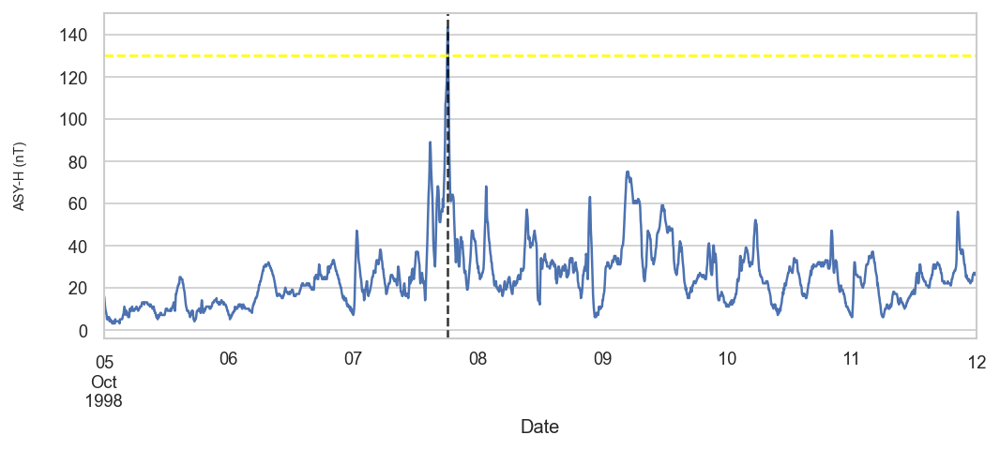

Plotting storm 150
Start date        1998-10-17 00:00:00
End date          1998-10-24 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         156
classification                    LOW
Name: 150, dtype: object
Maximum ASY-H value 156 at: 1998-10-19 03:55:00


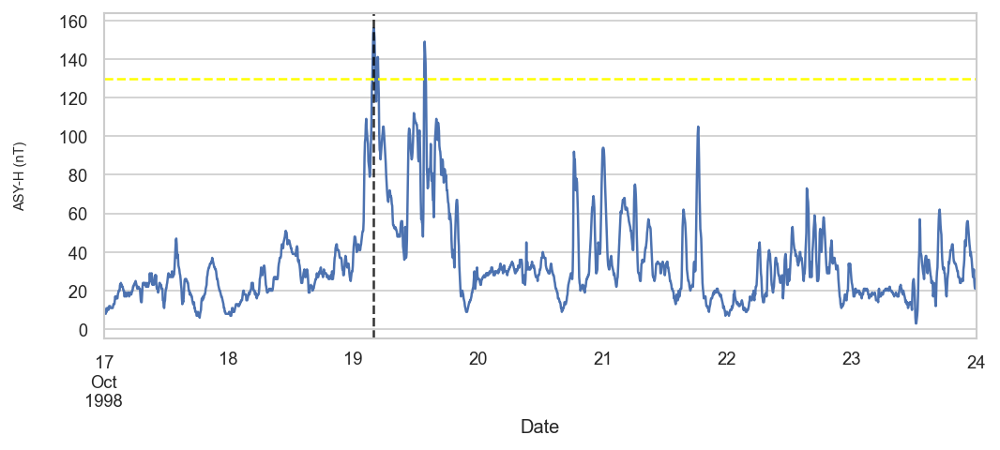

Plotting storm 152
Start date        1999-01-11 00:00:00
End date          1999-01-19 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         147
classification                    LOW
Name: 152, dtype: object
Maximum ASY-H value 147 at: 1999-01-14 09:10:00


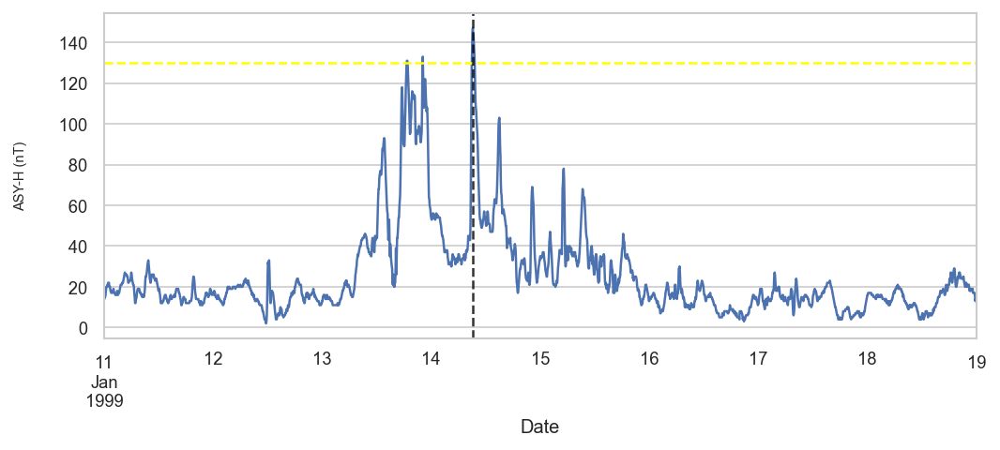

Plotting storm 154
Start date        1999-02-27 00:00:00
End date          1999-03-06 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         167
classification                    LOW
Name: 154, dtype: object
Maximum ASY-H value 167 at: 1999-03-01 18:10:00


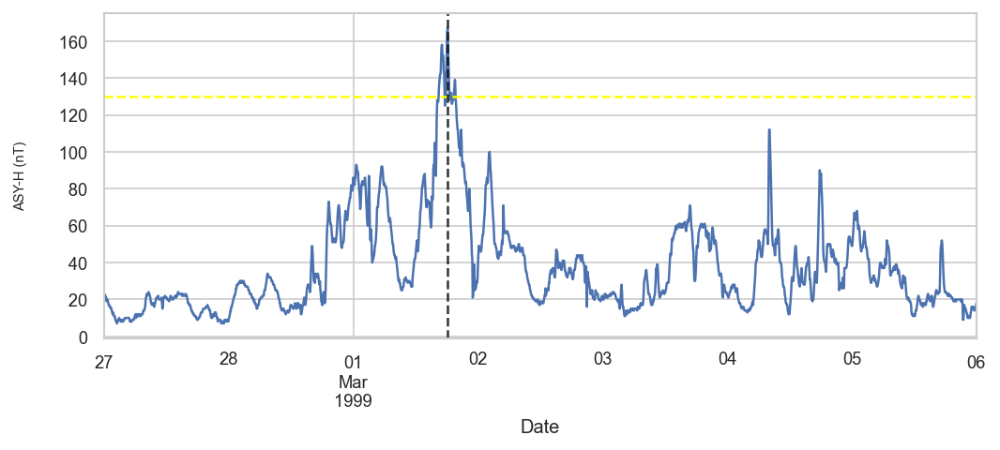

Plotting storm 155
Start date        1999-03-27 00:00:00
End date          1999-04-03 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         157
classification                    LOW
Name: 155, dtype: object
Maximum ASY-H value 157 at: 1999-03-29 14:20:00


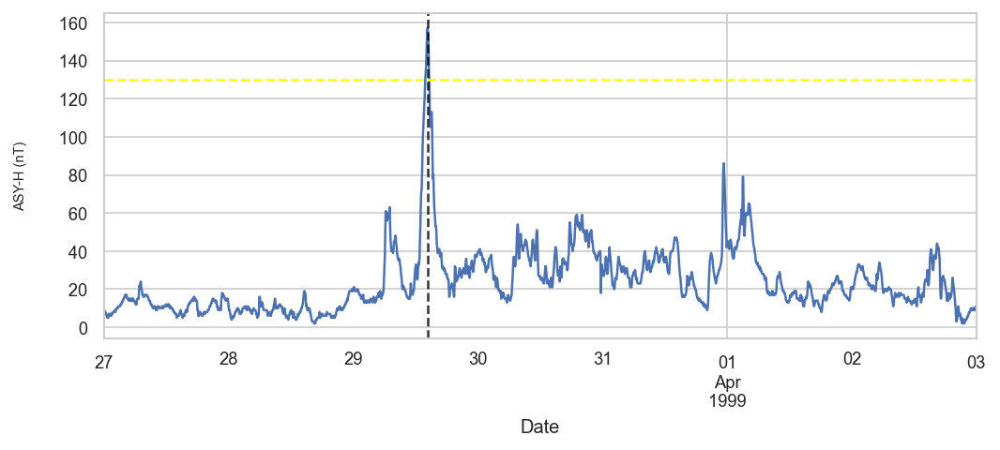

Plotting storm 156
Start date        1999-04-15 00:00:00
End date          1999-04-22 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         138
classification                    LOW
Name: 156, dtype: object
Maximum ASY-H value 138 at: 1999-04-17 04:05:00


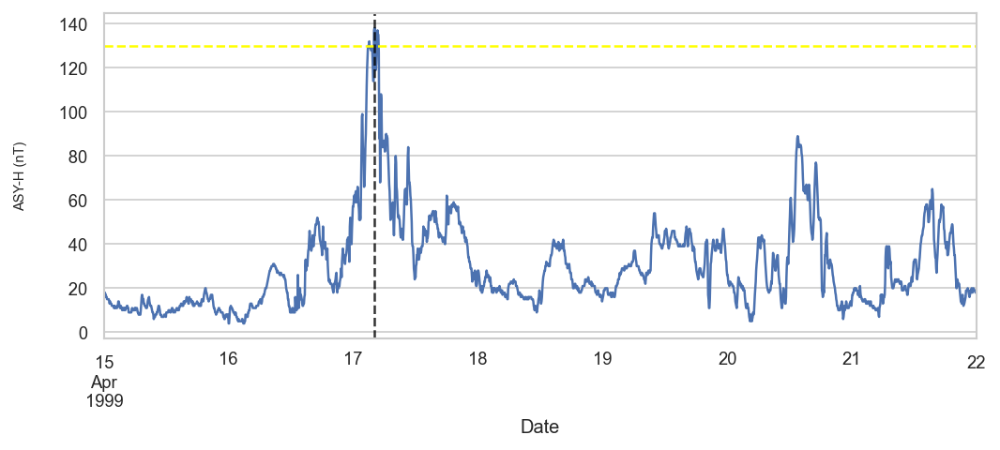

Plotting storm 157
Start date        1999-09-20 00:00:00
End date          1999-09-28 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         157
classification                    LOW
Name: 157, dtype: object
Maximum ASY-H value 157 at: 1999-09-22 22:25:00


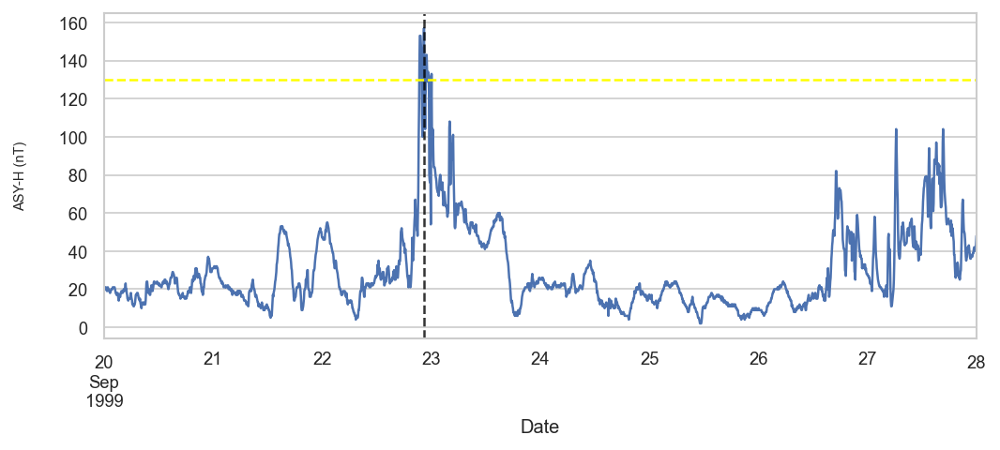

Plotting storm 158
Start date        1999-10-08 00:00:00
End date          1999-10-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         140
classification                    LOW
Name: 158, dtype: object
Maximum ASY-H value 140 at: 1999-10-10 14:25:00


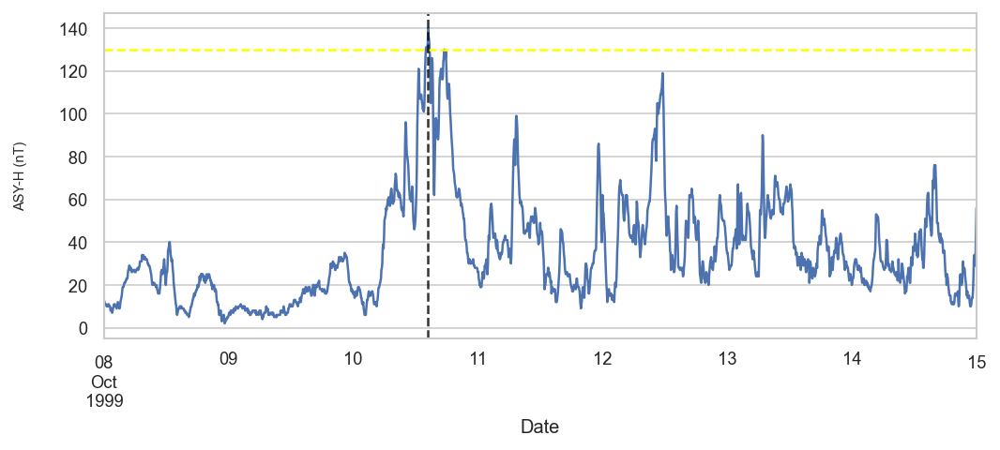

Plotting storm 160
Start date        1999-11-05 00:00:00
End date          1999-11-13 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         141
classification                    LOW
Name: 160, dtype: object
Maximum ASY-H value 141 at: 1999-11-08 13:50:00


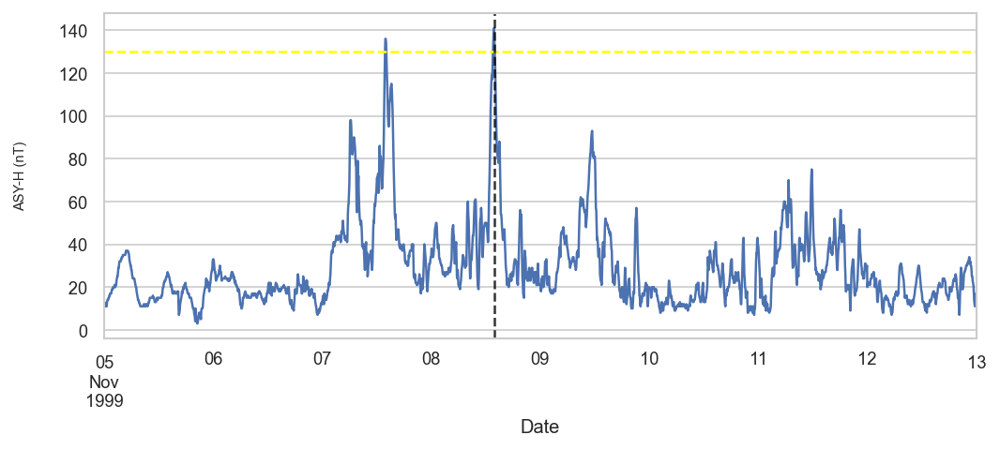

Plotting storm 164
Start date        2000-06-06 00:00:00
End date          2000-06-13 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         133
classification                    LOW
Name: 164, dtype: object
Maximum ASY-H value 133 at: 2000-06-08 15:05:00


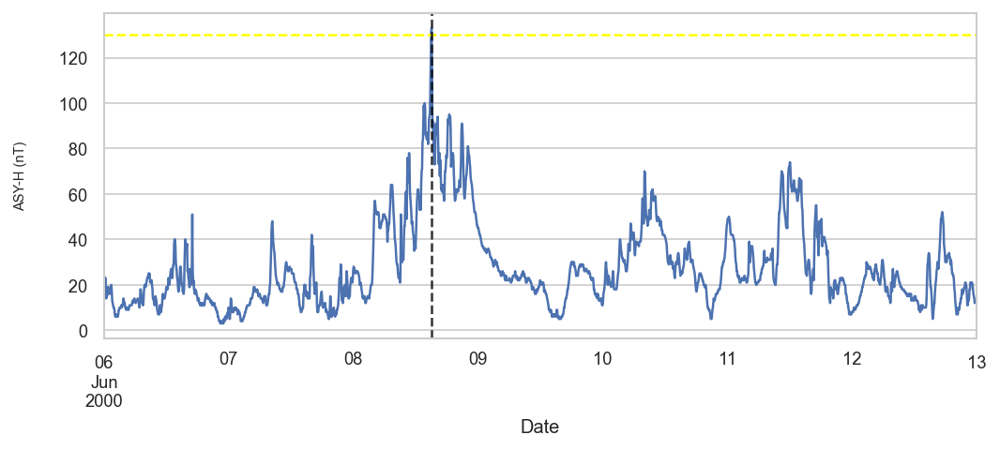

Plotting storm 169
Start date        2000-10-11 00:00:00
End date          2000-10-19 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         142
classification                    LOW
Name: 169, dtype: object
Maximum ASY-H value 142 at: 2000-10-14 15:10:00


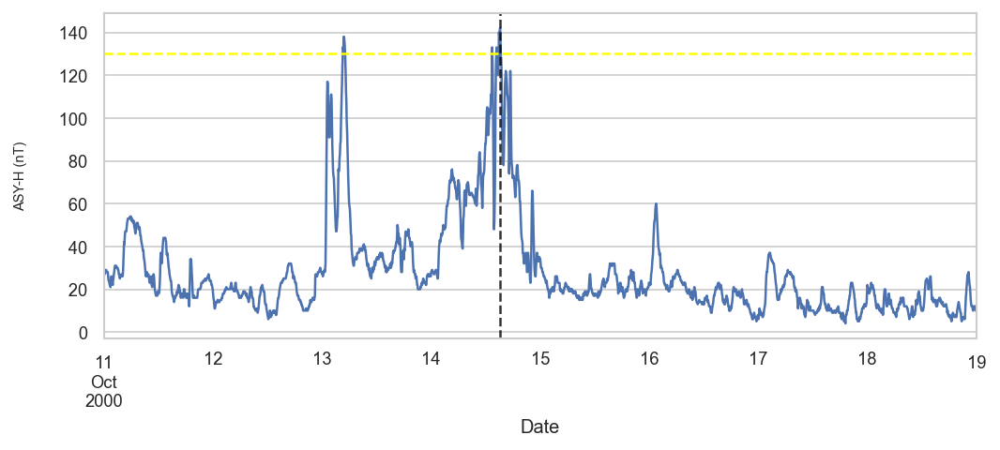

Plotting storm 171
Start date        2000-11-25 00:00:00
End date          2000-12-04 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         149
classification                    LOW
Name: 171, dtype: object
Maximum ASY-H value 149 at: 2000-11-27 01:20:00


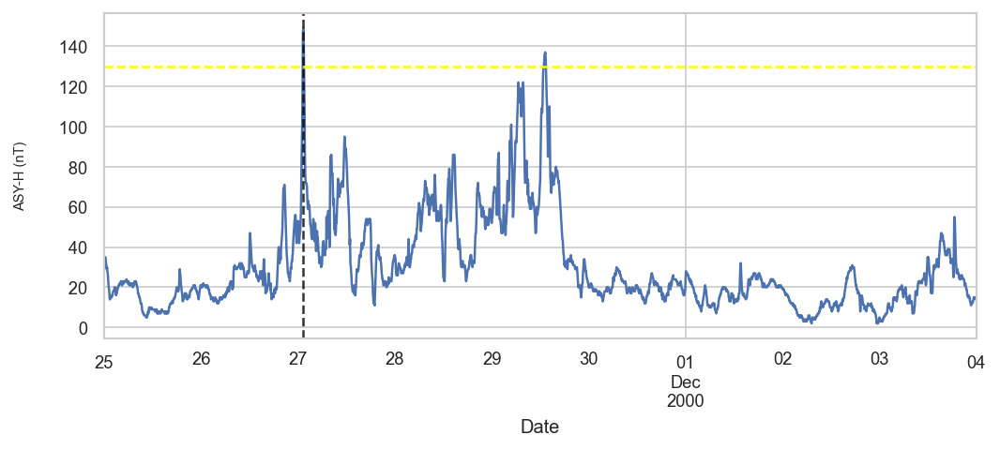

Plotting storm 175
Start date        2001-08-15 00:00:00
End date          2001-08-22 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         132
classification                    LOW
Name: 175, dtype: object
Maximum ASY-H value 132 at: 2001-08-17 19:15:00


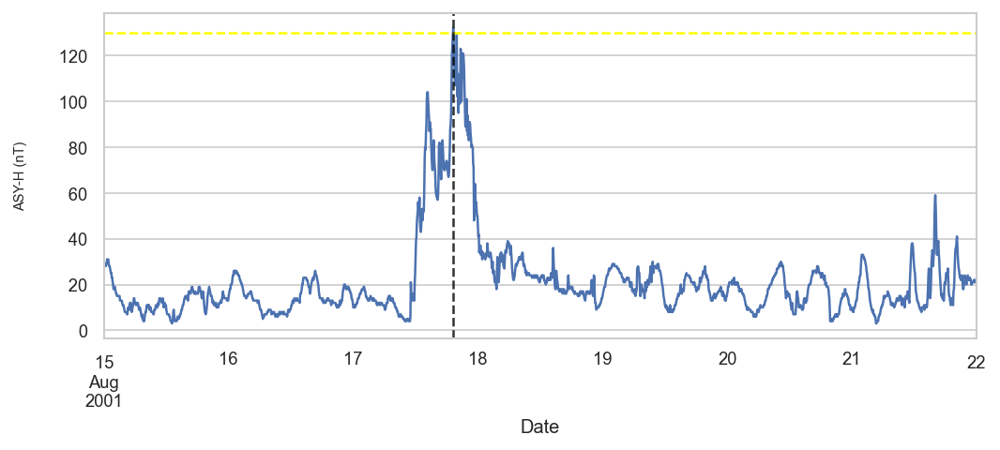

Plotting storm 177
Start date        2001-10-10 00:00:00
End date          2001-10-17 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 177, dtype: object
Maximum ASY-H value 143 at: 2001-10-12 03:00:00


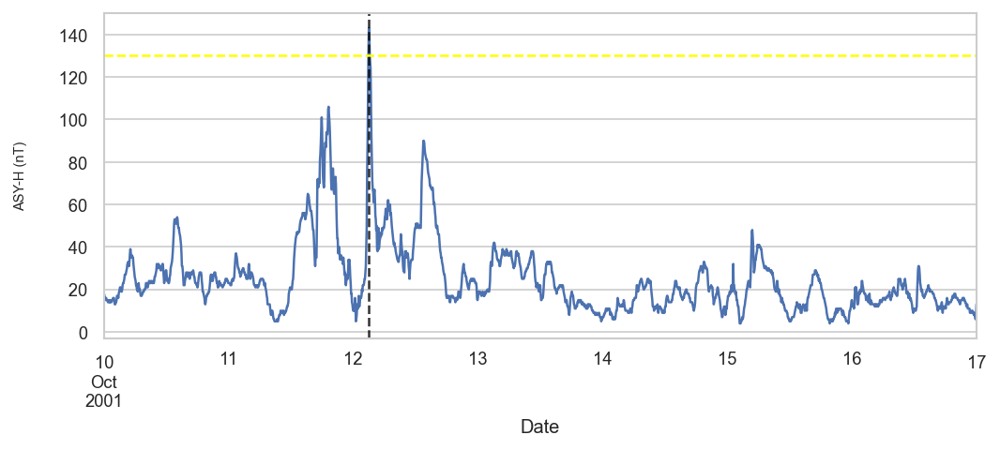

Plotting storm 182
Start date        2002-05-09 00:00:00
End date          2002-05-16 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         154
classification                    LOW
Name: 182, dtype: object
Maximum ASY-H value 154 at: 2002-05-11 12:05:00


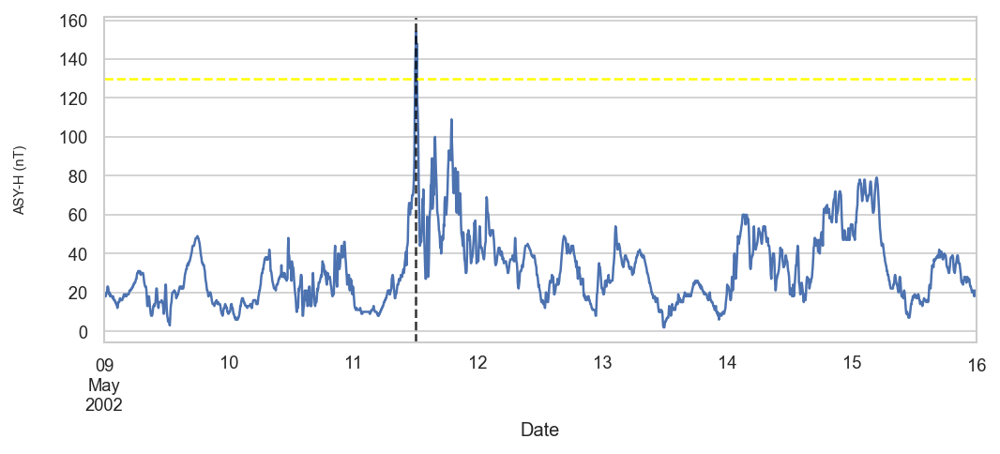

Plotting storm 184
Start date        2002-09-05 00:00:00
End date          2002-09-13 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 184, dtype: object
Maximum ASY-H value 143 at: 2002-09-07 17:20:00


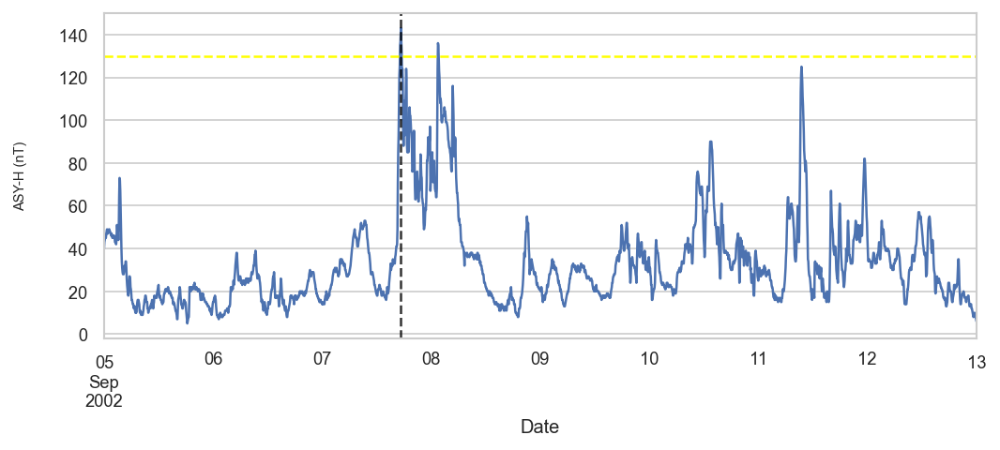

Plotting storm 186
Start date        2002-11-19 00:00:00
End date          2002-11-26 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         142
classification                    LOW
Name: 186, dtype: object
Maximum ASY-H value 142 at: 2002-11-21 06:45:00


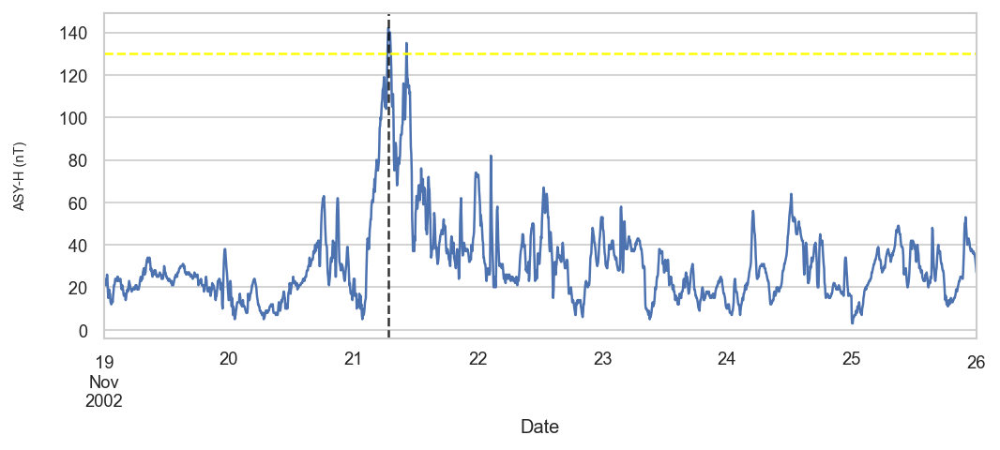

Plotting storm 187
Start date        2003-01-20 00:00:00
End date          2003-01-27 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         162
classification                    LOW
Name: 187, dtype: object
Maximum ASY-H value 162 at: 2003-01-22 23:45:00


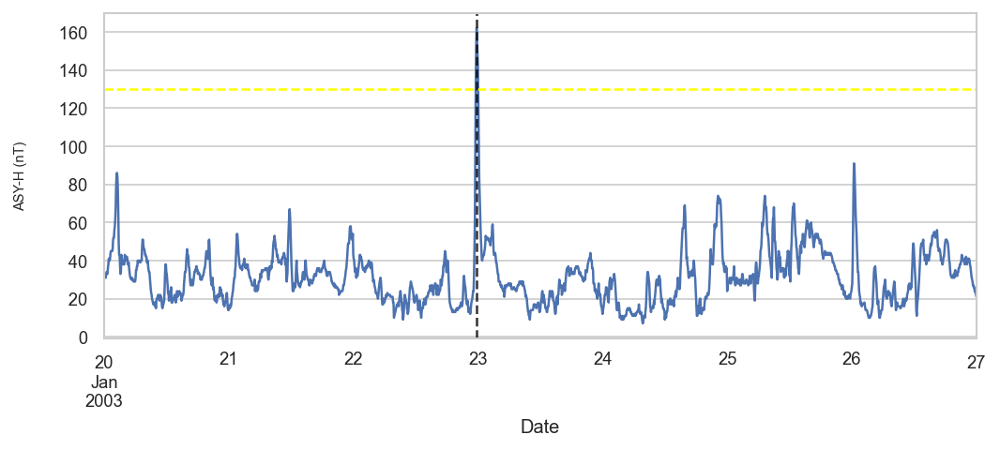

Plotting storm 189
Start date        2003-04-28 00:00:00
End date          2003-05-05 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         134
classification                    LOW
Name: 189, dtype: object
Maximum ASY-H value 134 at: 2003-04-30 03:10:00


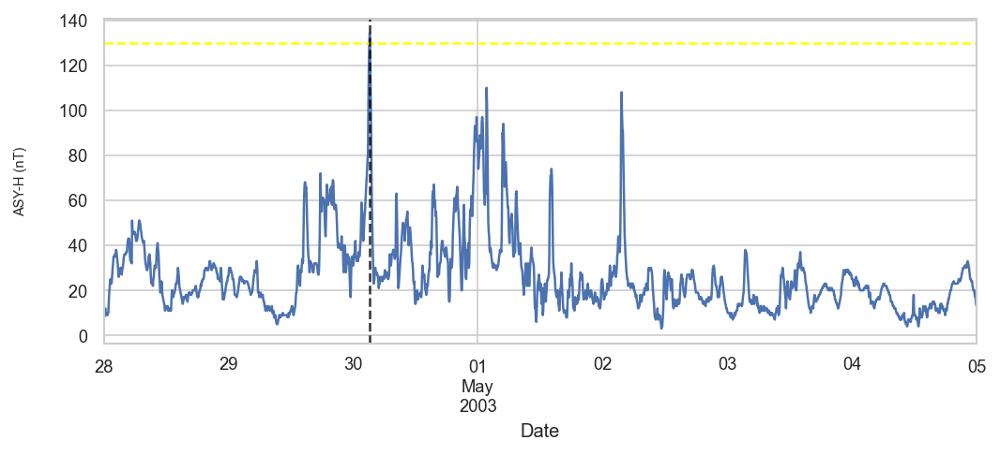

Plotting storm 190
Start date        2003-05-08 00:00:00
End date          2003-05-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         160
classification                    LOW
Name: 190, dtype: object
Maximum ASY-H value 160 at: 2003-05-10 04:15:00


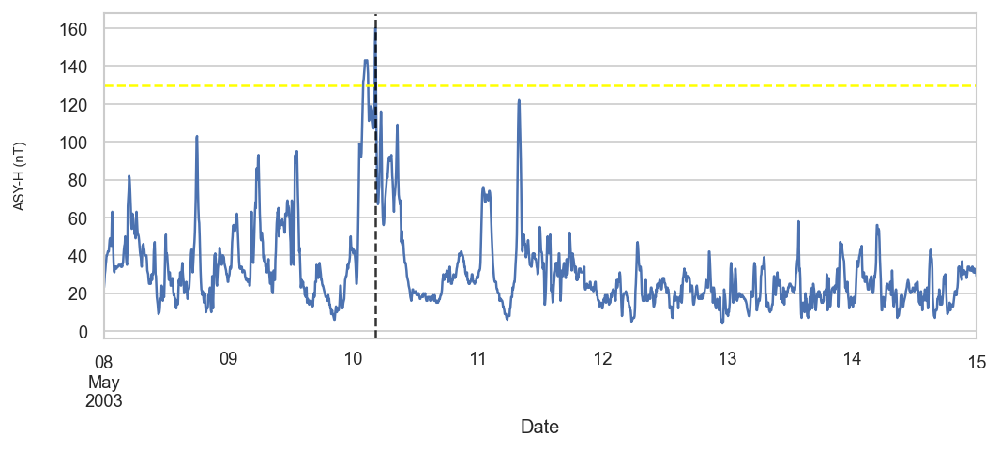

Plotting storm 195
Start date        2003-08-04 00:00:00
End date          2003-08-11 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         144
classification                    LOW
Name: 195, dtype: object
Maximum ASY-H value 144 at: 2003-08-06 07:00:00


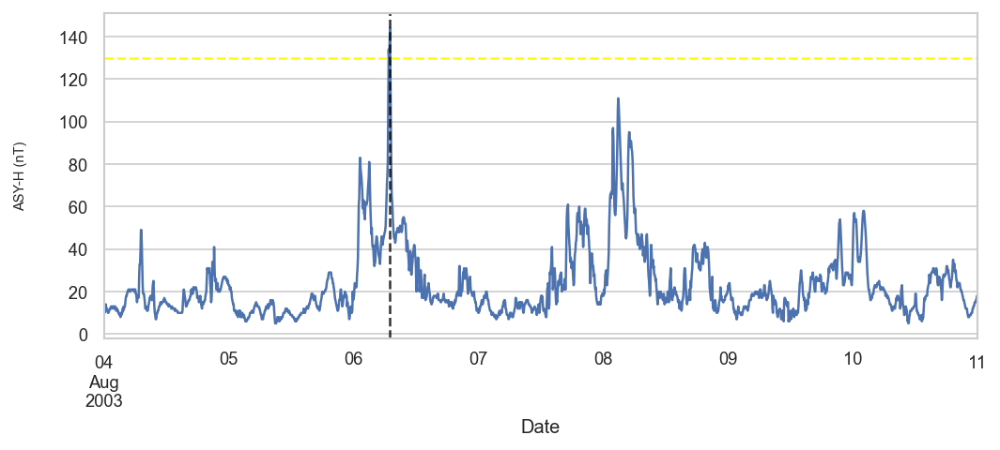

Plotting storm 196
Start date        2003-08-16 00:00:00
End date          2003-08-23 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         160
classification                    LOW
Name: 196, dtype: object
Maximum ASY-H value 160 at: 2003-08-18 07:15:00


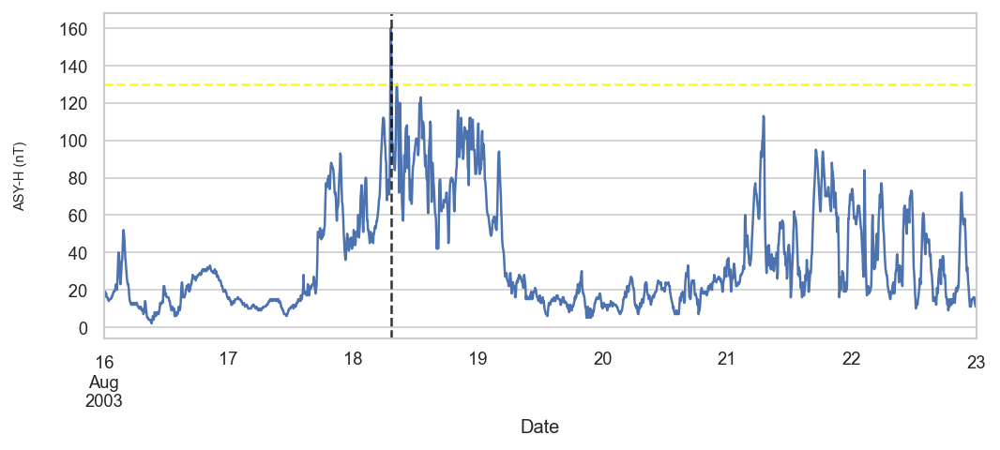

Plotting storm 198
Start date        2003-10-12 00:00:00
End date          2003-10-19 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         141
classification                    LOW
Name: 198, dtype: object
Maximum ASY-H value 141 at: 2003-10-14 21:25:00


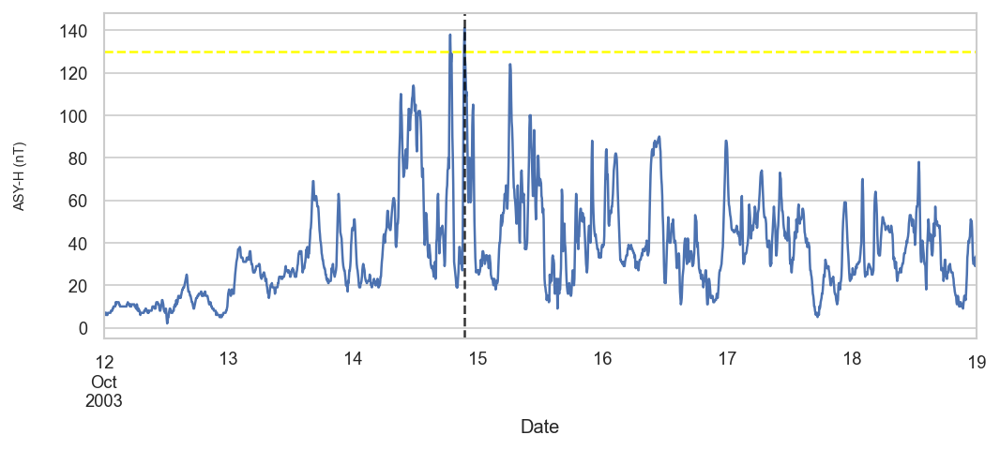

Plotting storm 200
Start date        2004-01-04 00:00:00
End date          2004-01-11 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         139
classification                    LOW
Name: 200, dtype: object
Maximum ASY-H value 139 at: 2004-01-06 22:55:00


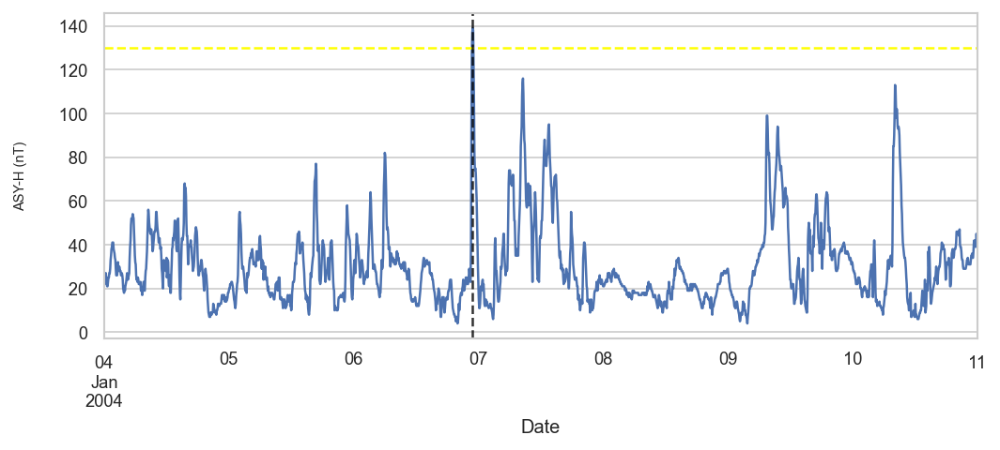

Plotting storm 201
Start date        2004-01-20 00:00:00
End date          2004-01-27 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         150
classification                    LOW
Name: 201, dtype: object
Maximum ASY-H value 150 at: 2004-01-22 13:30:00


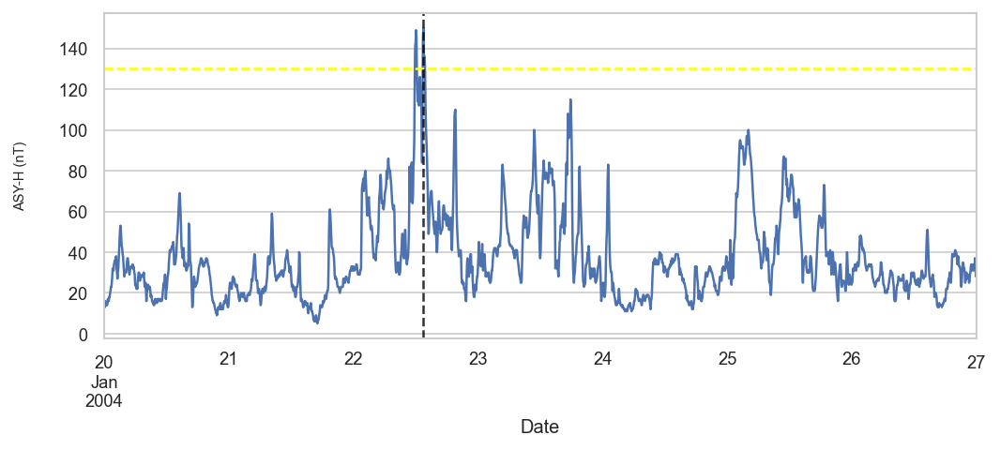

Plotting storm 202
Start date        2004-02-09 00:00:00
End date          2004-02-16 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         152
classification                    LOW
Name: 202, dtype: object
Maximum ASY-H value 152 at: 2004-02-11 17:40:00


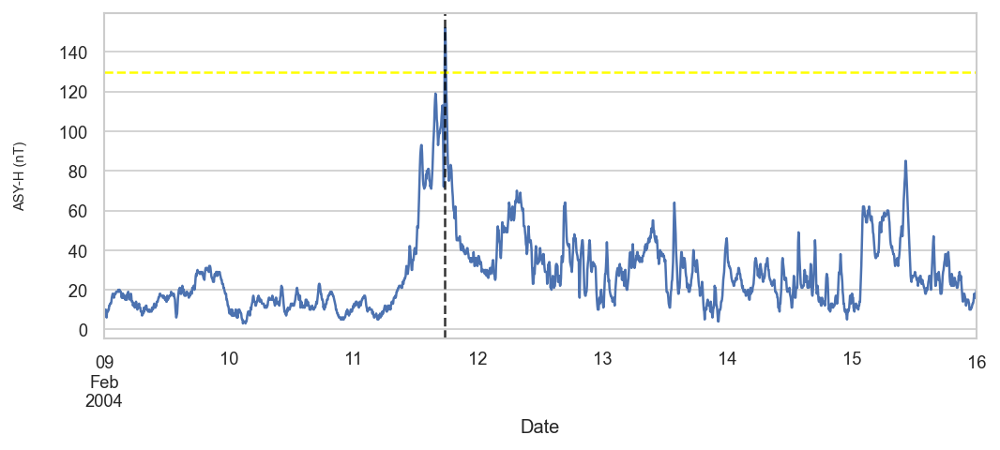

Plotting storm 203
Start date        2004-03-08 00:00:00
End date          2004-03-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 203, dtype: object
Maximum ASY-H value 143 at: 2004-03-10 08:10:00


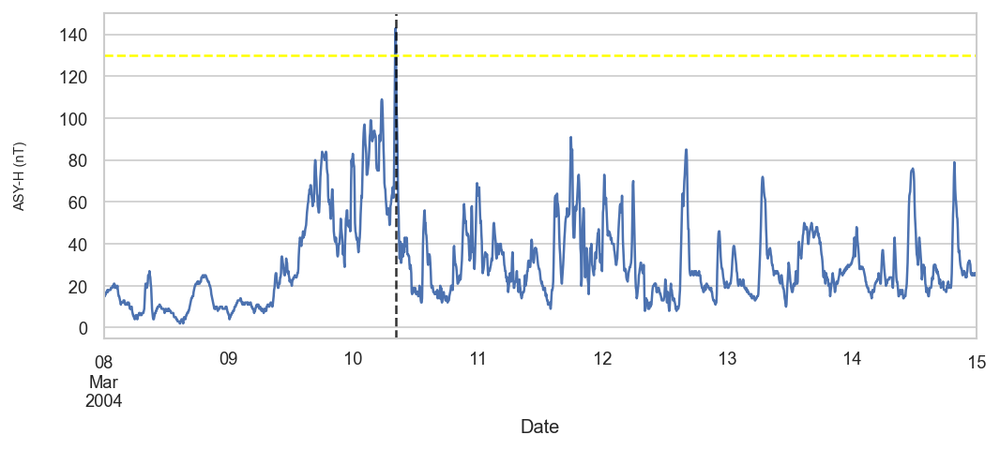

Plotting storm 204
Start date        2004-03-26 00:00:00
End date          2004-04-10 00:00:00
TD                   15 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 204, dtype: object
Maximum ASY-H value 143 at: 2004-03-28 04:05:00


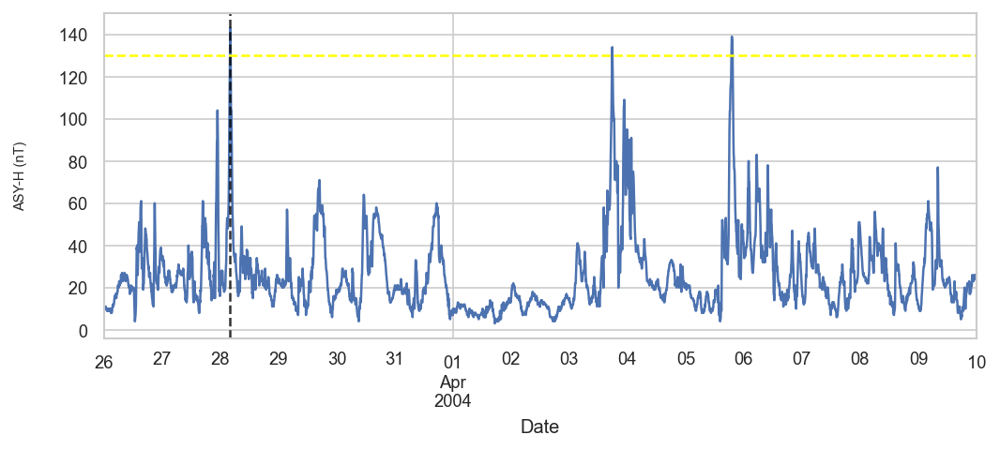

Plotting storm 209
Start date        2005-04-03 00:00:00
End date          2005-04-10 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         163
classification                    LOW
Name: 209, dtype: object
Maximum ASY-H value 163 at: 2005-04-05 03:25:00


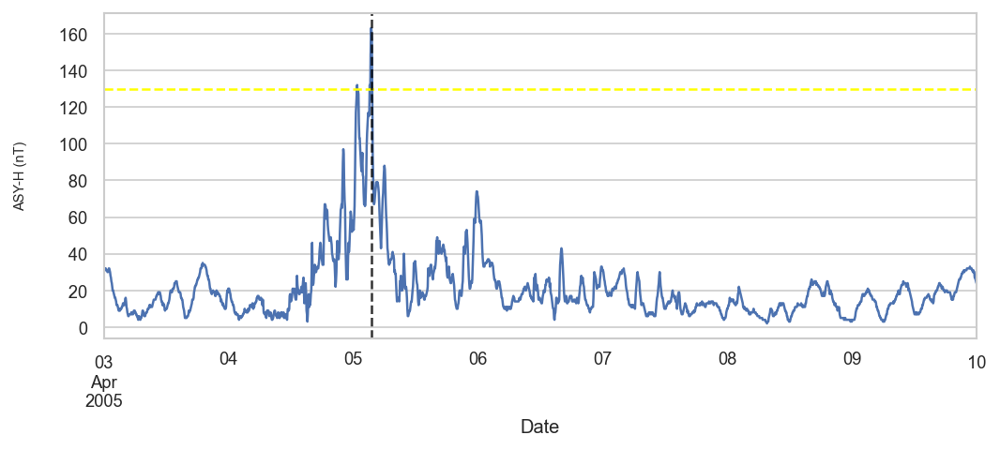

Plotting storm 212
Start date        2005-07-08 00:00:00
End date          2005-07-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         158
classification                    LOW
Name: 212, dtype: object
Maximum ASY-H value 158 at: 2005-07-10 14:05:00


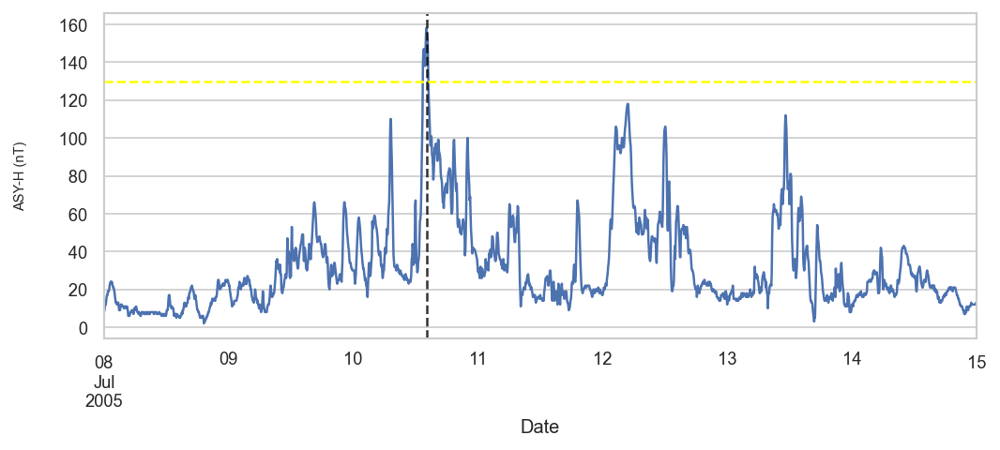

Plotting storm 213
Start date        2005-07-16 00:00:00
End date          2005-07-23 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         132
classification                    LOW
Name: 213, dtype: object
Maximum ASY-H value 132 at: 2005-07-18 04:35:00


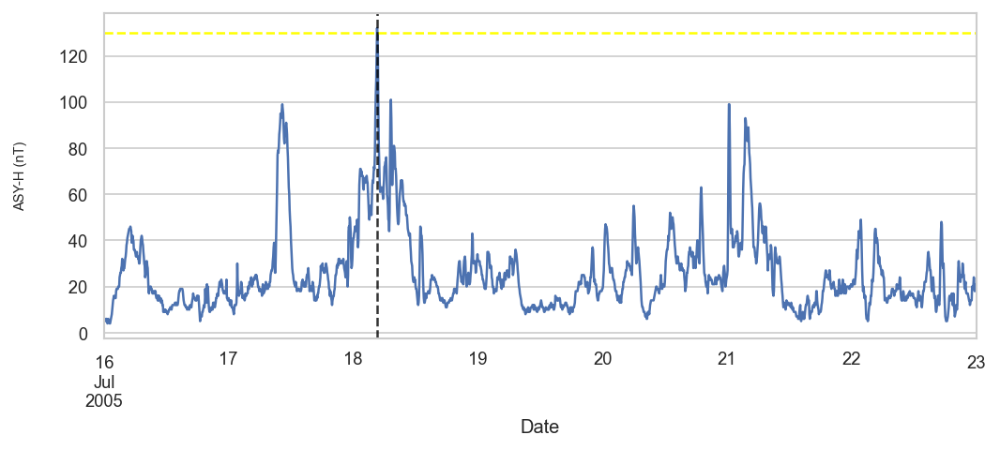

Plotting storm 216
Start date        2006-03-17 00:00:00
End date          2006-03-24 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         132
classification                    LOW
Name: 216, dtype: object
Maximum ASY-H value 132 at: 2006-03-19 00:35:00


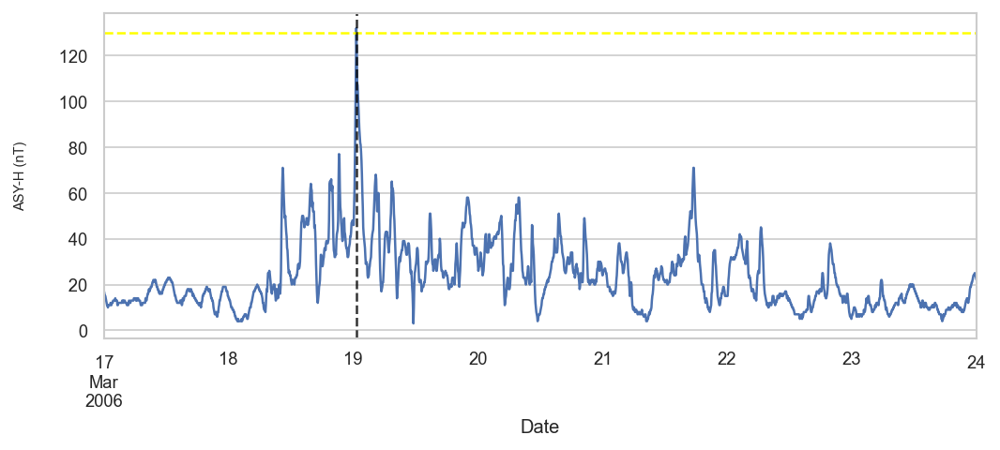

Plotting storm 217
Start date        2006-04-12 00:00:00
End date          2006-04-19 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         162
classification                    LOW
Name: 217, dtype: object
Maximum ASY-H value 162 at: 2006-04-14 09:55:00


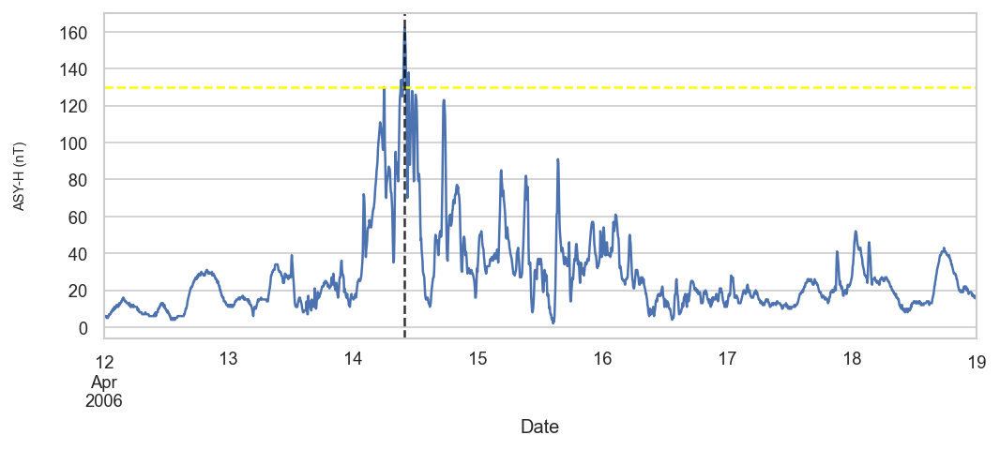

Plotting storm 219
Start date        2006-11-08 00:00:00
End date          2006-11-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         135
classification                    LOW
Name: 219, dtype: object
Maximum ASY-H value 135 at: 2006-11-10 10:25:00


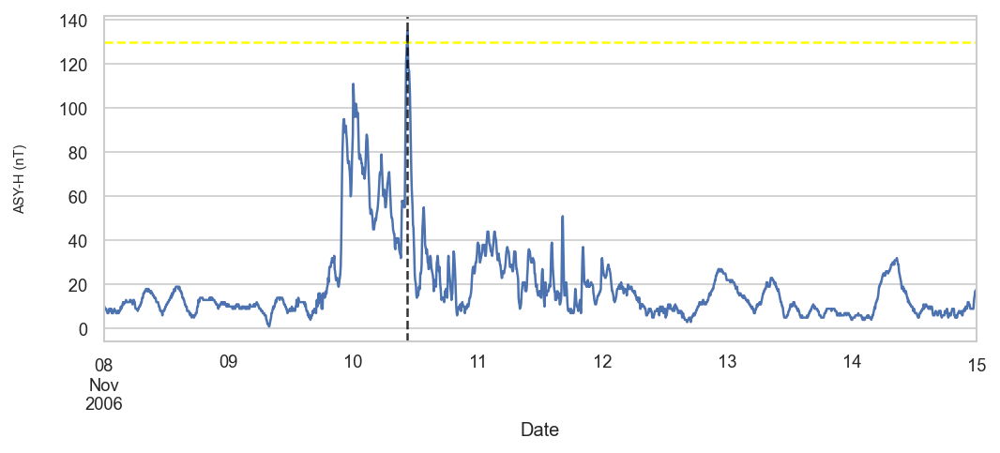

Plotting storm 220
Start date        2006-11-28 00:00:00
End date          2006-12-05 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         150
classification                    LOW
Name: 220, dtype: object
Maximum ASY-H value 150 at: 2006-11-30 10:35:00


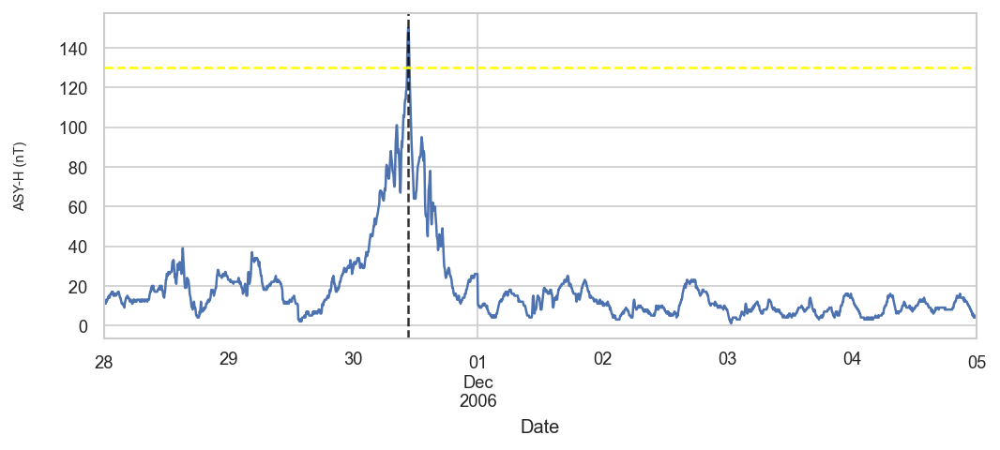

Plotting storm 222
Start date        2008-09-02 00:00:00
End date          2008-09-09 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         159
classification                    LOW
Name: 222, dtype: object
Maximum ASY-H value 159 at: 2008-09-04 02:55:00


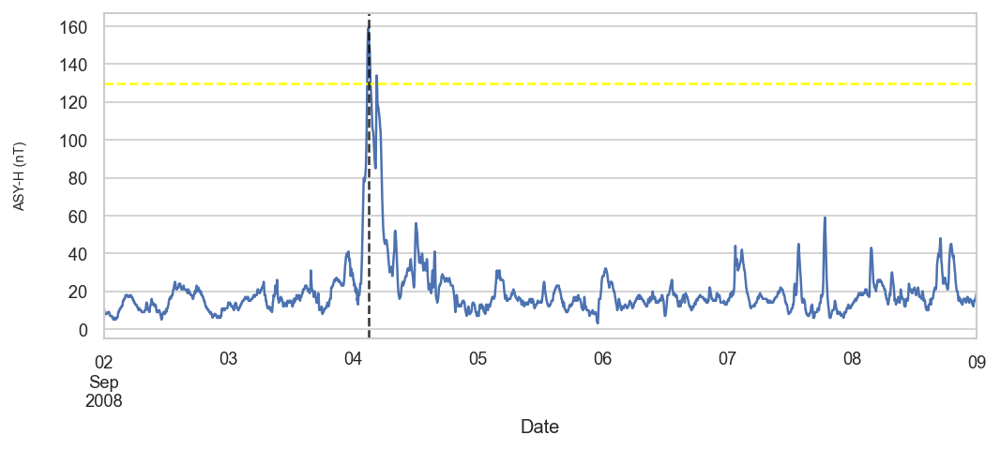

Plotting storm 223
Start date        2009-07-20 00:00:00
End date          2009-07-27 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         131
classification                    LOW
Name: 223, dtype: object
Maximum ASY-H value 131 at: 2009-07-22 04:25:00


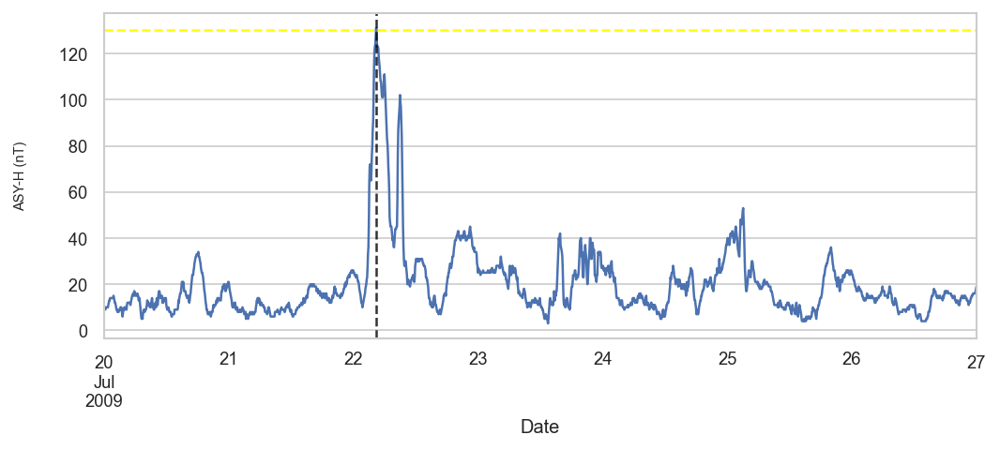

Plotting storm 224
Start date        2010-04-03 00:00:00
End date          2010-04-10 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         151
classification                    LOW
Name: 224, dtype: object
Maximum ASY-H value 151 at: 2010-04-05 09:25:00


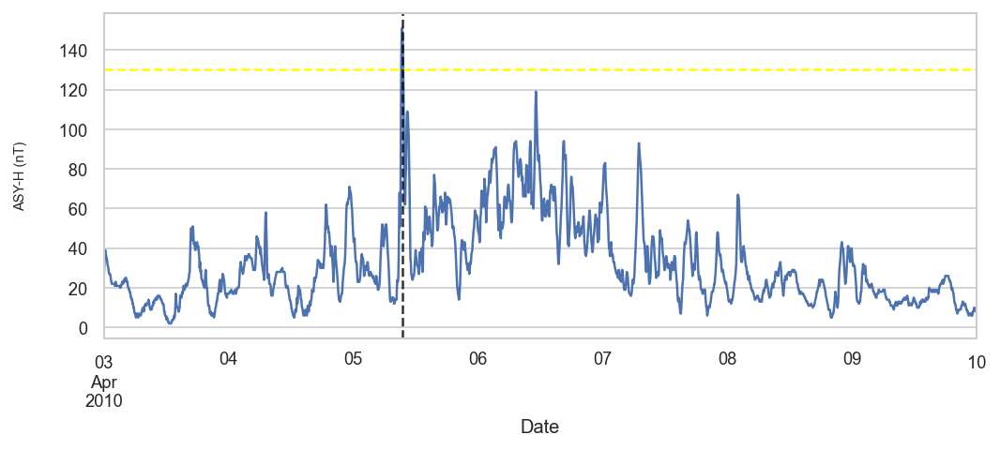

Plotting storm 226
Start date        2011-02-27 00:00:00
End date          2011-03-06 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         152
classification                    LOW
Name: 226, dtype: object
Maximum ASY-H value 152 at: 2011-03-01 14:40:00


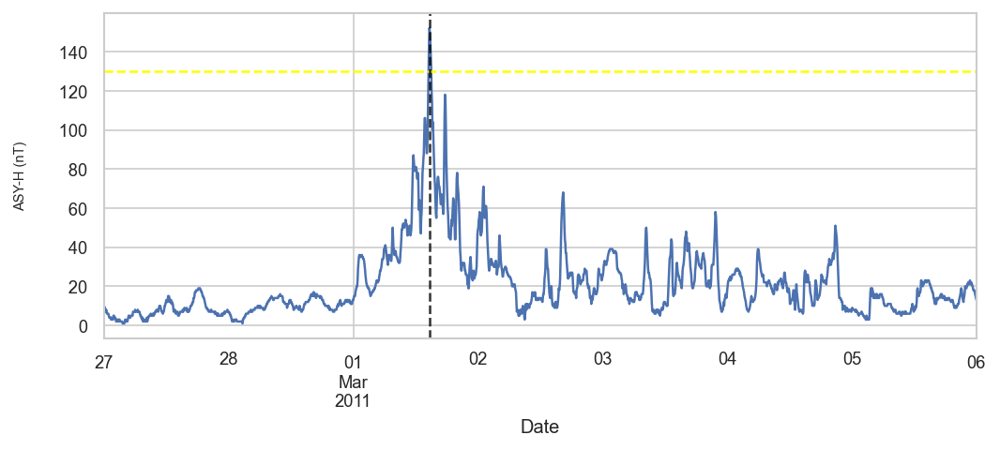

Plotting storm 228
Start date        2011-05-27 00:00:00
End date          2011-06-10 00:00:00
TD                   14 days 00:00:00
Max ASY-H                         150
classification                    LOW
Name: 228, dtype: object
Maximum ASY-H value 150 at: 2011-05-29 05:30:00


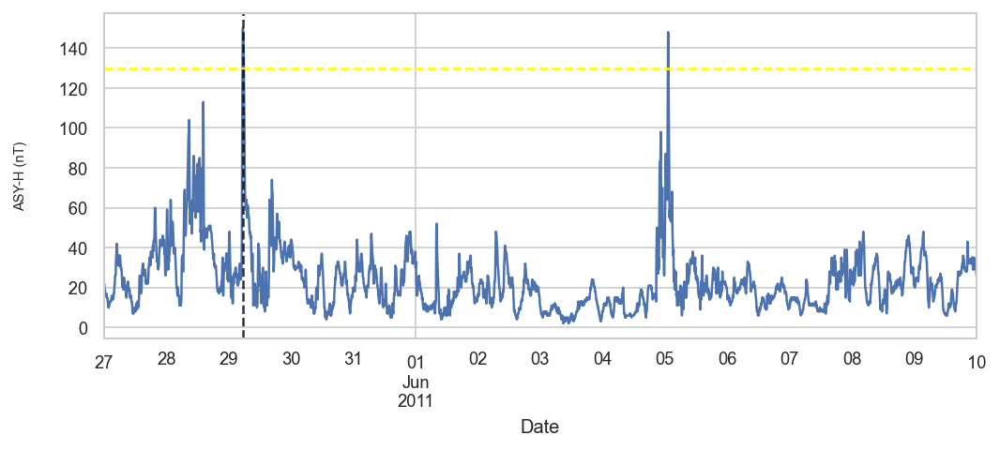

Plotting storm 230
Start date        2011-09-24 00:00:00
End date          2011-10-04 00:00:00
TD                   10 days 00:00:00
Max ASY-H                         150
classification                    LOW
Name: 230, dtype: object
Maximum ASY-H value 150 at: 2011-09-26 19:25:00


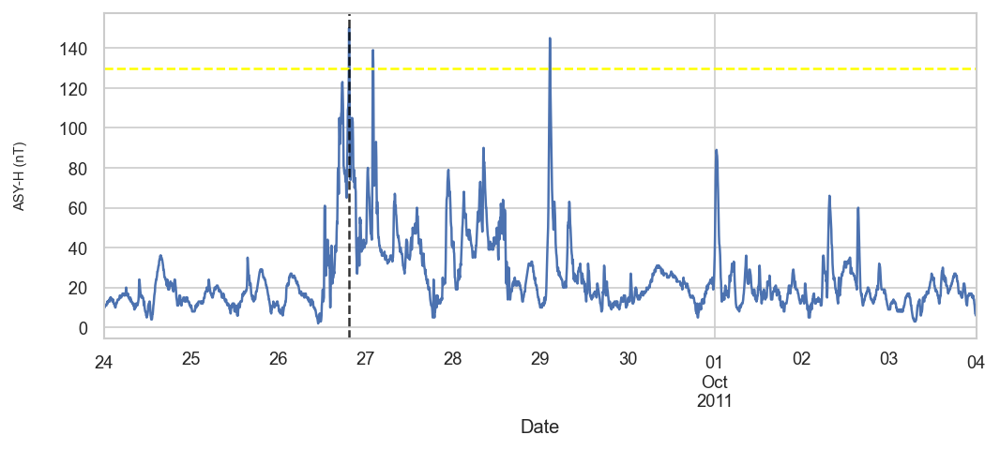

Plotting storm 231
Start date        2011-10-22 00:00:00
End date          2011-10-30 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         150
classification                    LOW
Name: 231, dtype: object
Maximum ASY-H value 150 at: 2011-10-24 23:50:00


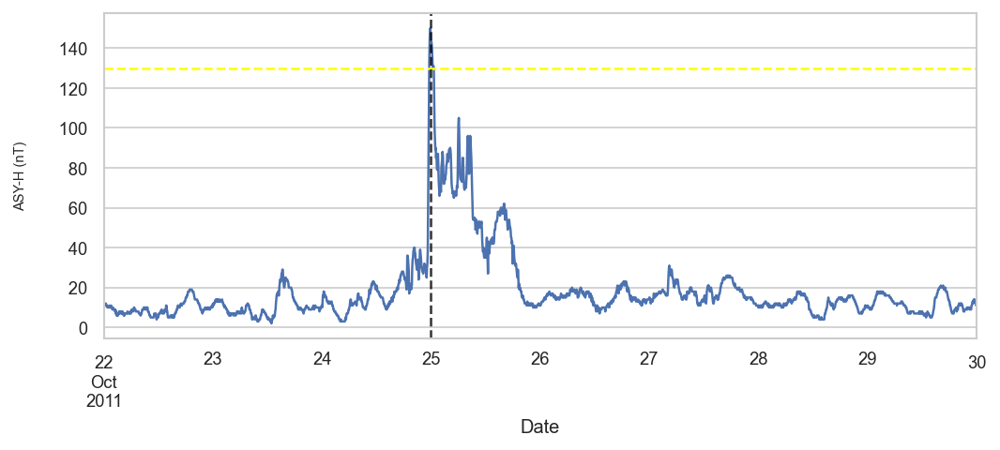

Plotting storm 232
Start date        2012-01-20 00:00:00
End date          2012-01-27 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         132
classification                    LOW
Name: 232, dtype: object
Maximum ASY-H value 132 at: 2012-01-22 12:30:00


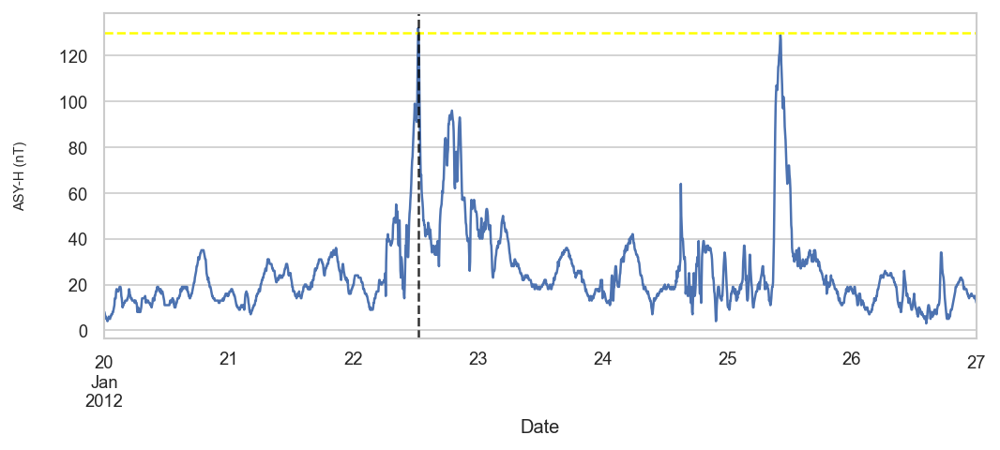

Plotting storm 234
Start date        2012-04-21 00:00:00
End date          2012-04-29 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         151
classification                    LOW
Name: 234, dtype: object
Maximum ASY-H value 151 at: 2012-04-24 00:55:00


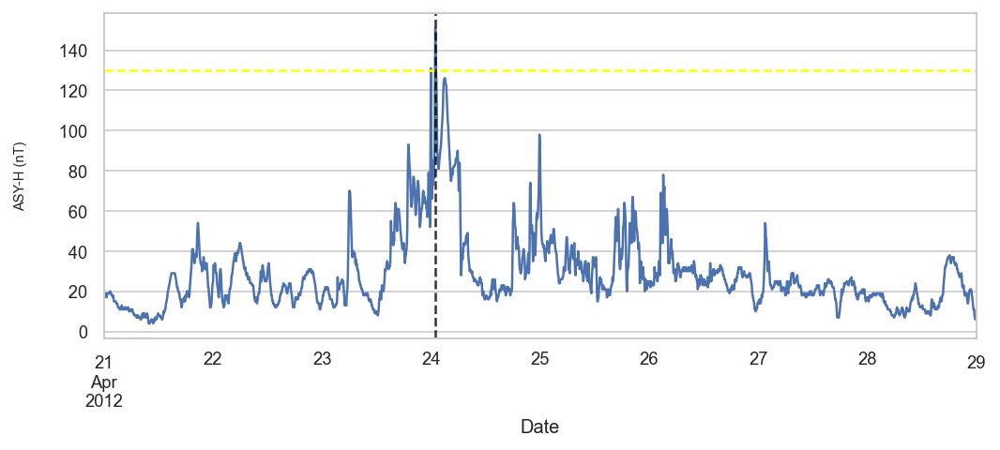

Plotting storm 236
Start date        2012-07-13 00:00:00
End date          2012-07-20 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         164
classification                    LOW
Name: 236, dtype: object
Maximum ASY-H value 164 at: 2012-07-15 09:05:00


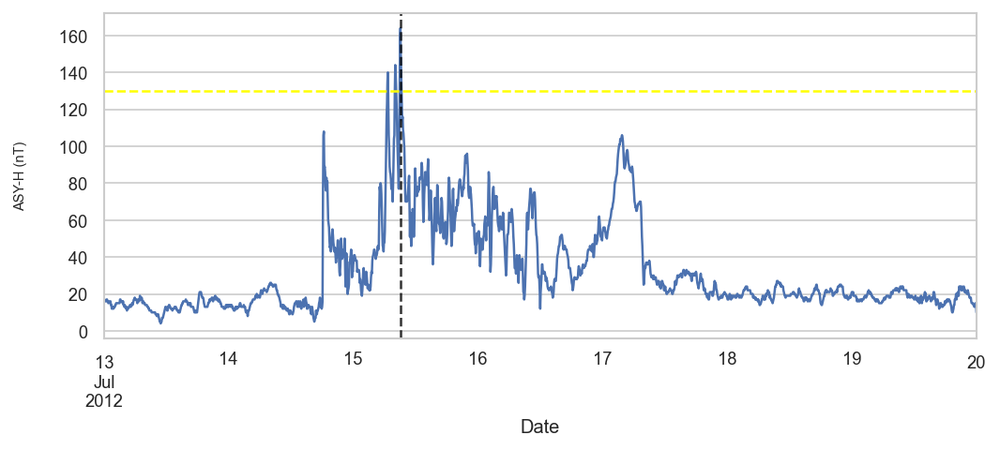

Plotting storm 237
Start date        2012-09-29 00:00:00
End date          2012-10-18 00:00:00
TD                   19 days 00:00:00
Max ASY-H                         158
classification                    LOW
Name: 237, dtype: object
Maximum ASY-H value 158 at: 2012-10-08 13:10:00


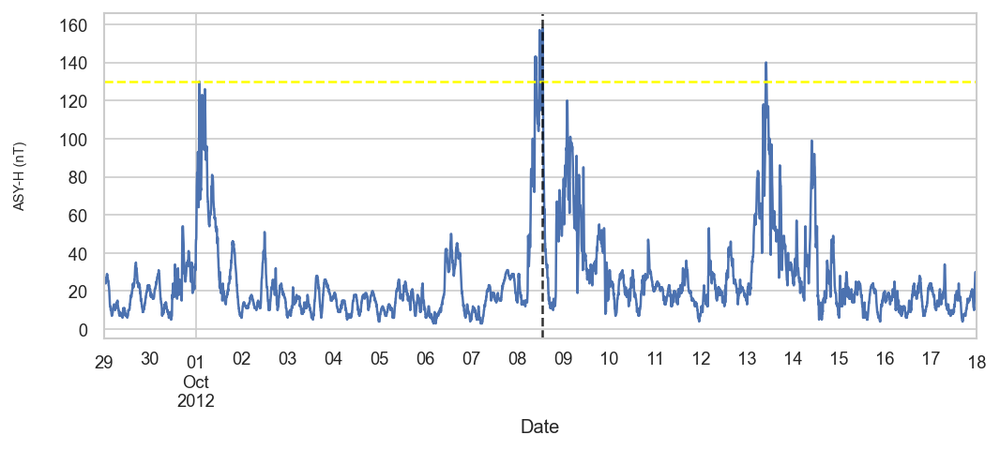

Plotting storm 238
Start date        2013-02-27 00:00:00
End date          2013-03-06 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         149
classification                    LOW
Name: 238, dtype: object
Maximum ASY-H value 149 at: 2013-03-01 10:45:00


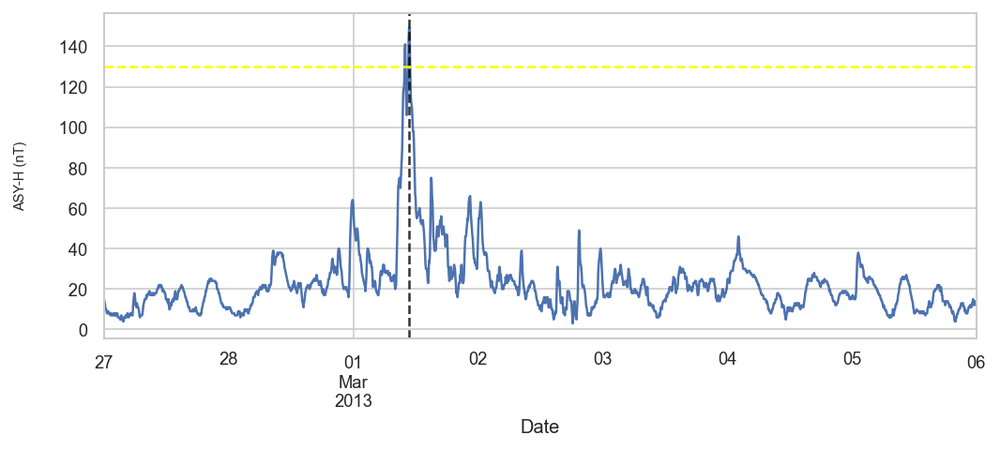

Plotting storm 240
Start date        2013-05-30 00:00:00
End date          2013-06-06 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         154
classification                    LOW
Name: 240, dtype: object
Maximum ASY-H value 154 at: 2013-06-01 06:10:00


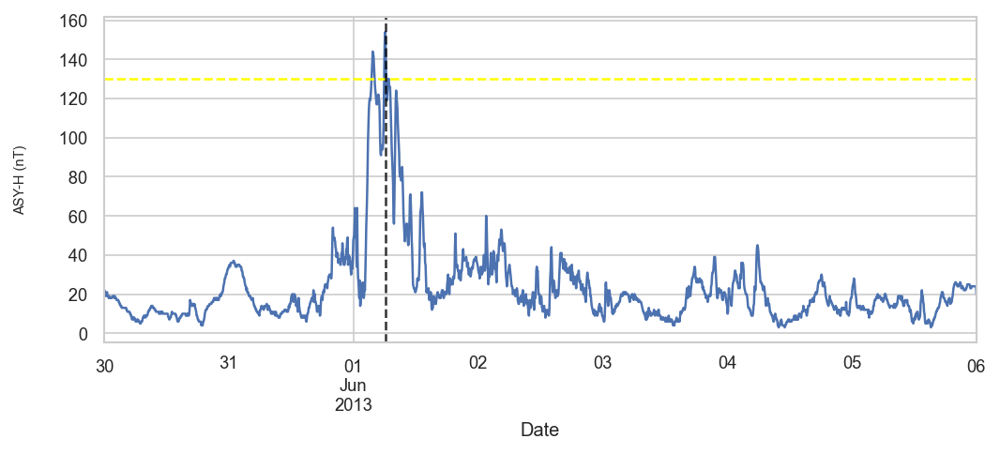

Plotting storm 241
Start date        2013-06-27 00:00:00
End date          2013-07-04 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         165
classification                    LOW
Name: 241, dtype: object
Maximum ASY-H value 165 at: 2013-06-29 02:55:00


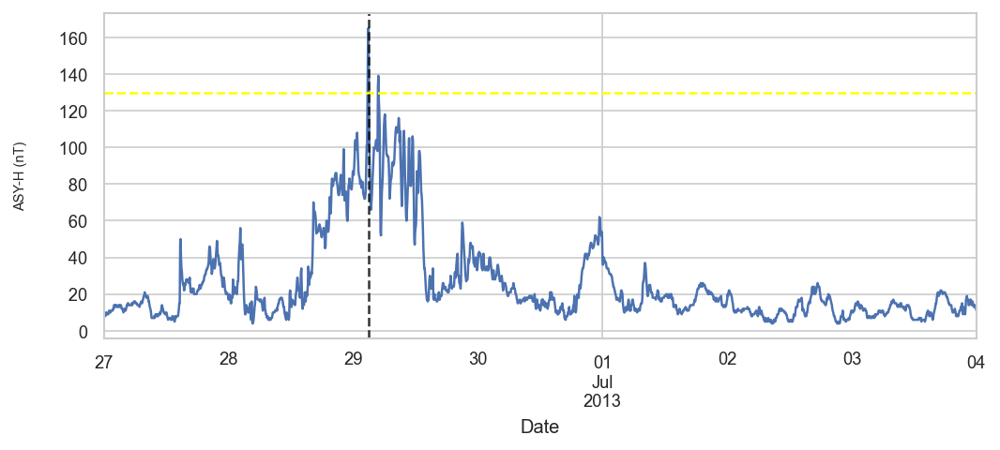

Plotting storm 243
Start date        2014-02-17 00:00:00
End date          2014-02-24 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         152
classification                    LOW
Name: 243, dtype: object
Maximum ASY-H value 152 at: 2014-02-19 06:15:00


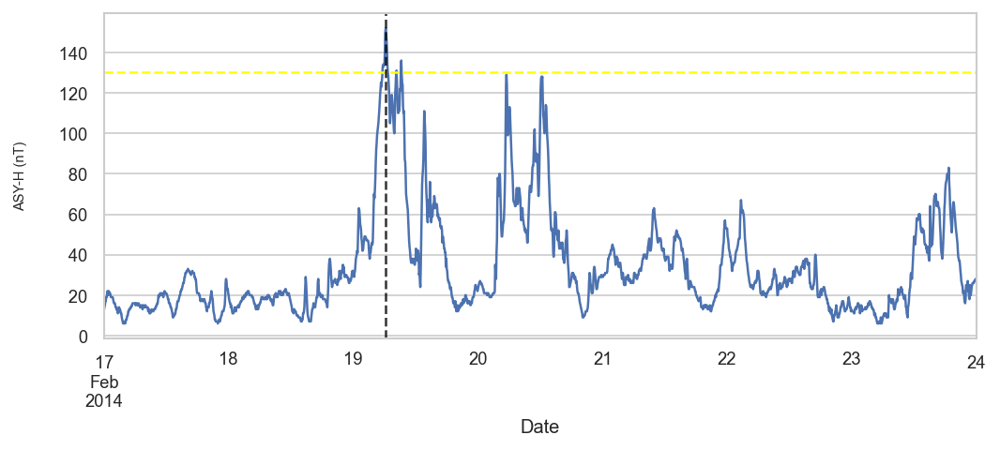

Plotting storm 248
Start date        2015-08-25 00:00:00
End date          2015-09-01 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         149
classification                    LOW
Name: 248, dtype: object
Maximum ASY-H value 149 at: 2015-08-27 04:55:00


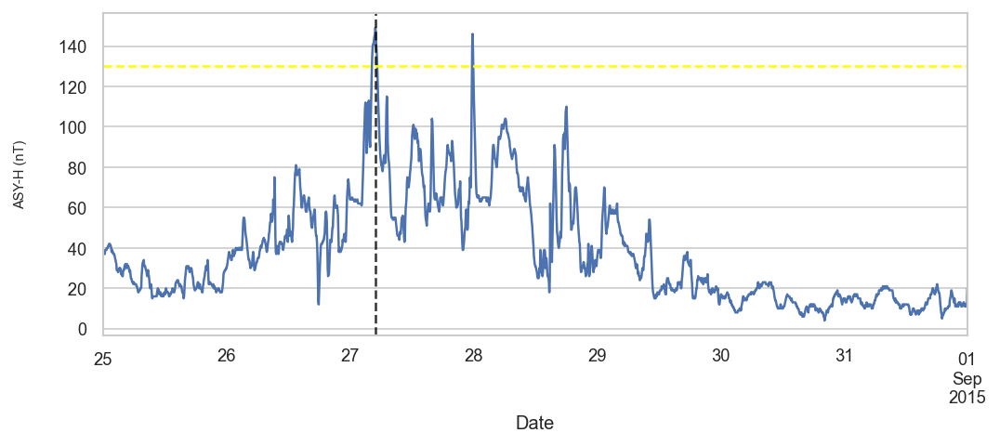

Plotting storm 250
Start date        2015-09-18 00:00:00
End date          2015-09-25 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         135
classification                    LOW
Name: 250, dtype: object
Maximum ASY-H value 135 at: 2015-09-20 08:05:00


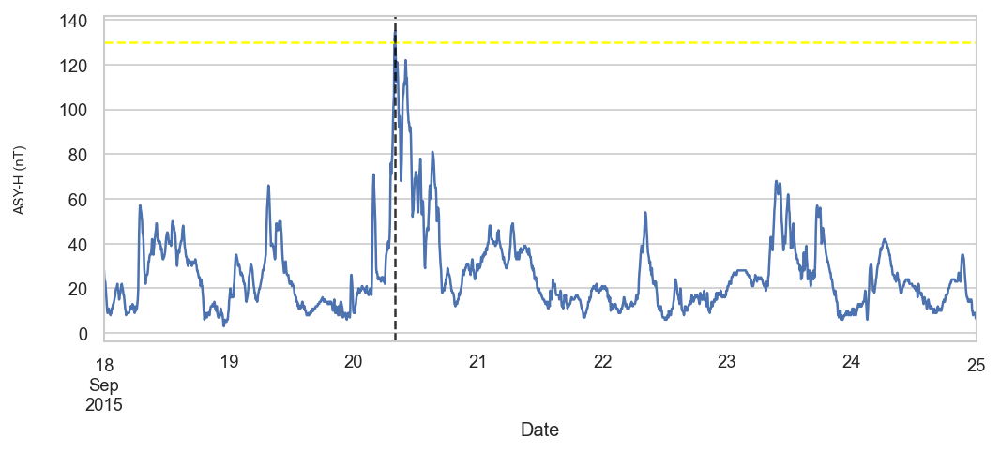

Plotting storm 252
Start date        2015-12-18 00:00:00
End date          2015-12-25 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         145
classification                    LOW
Name: 252, dtype: object
Maximum ASY-H value 145 at: 2015-12-20 16:20:00


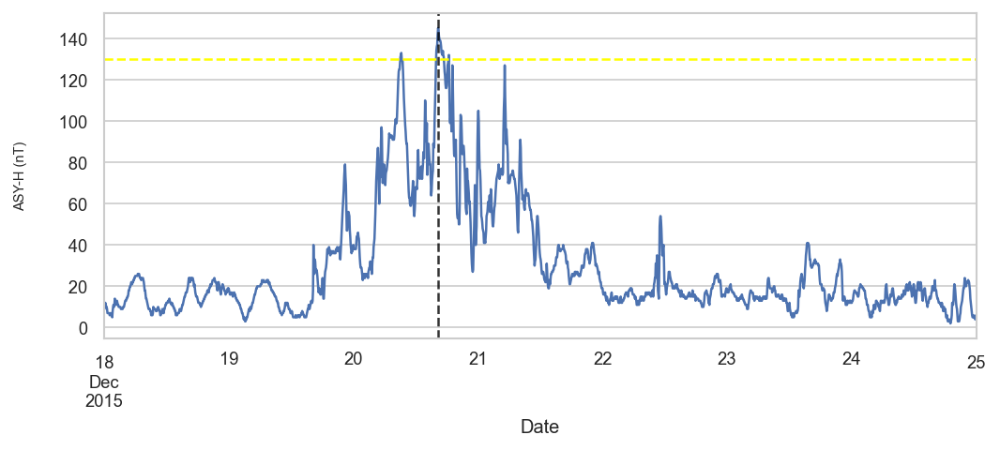

Plotting storm 253
Start date        2016-01-18 00:00:00
End date          2016-01-25 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         140
classification                    LOW
Name: 253, dtype: object
Maximum ASY-H value 140 at: 2016-01-20 15:55:00


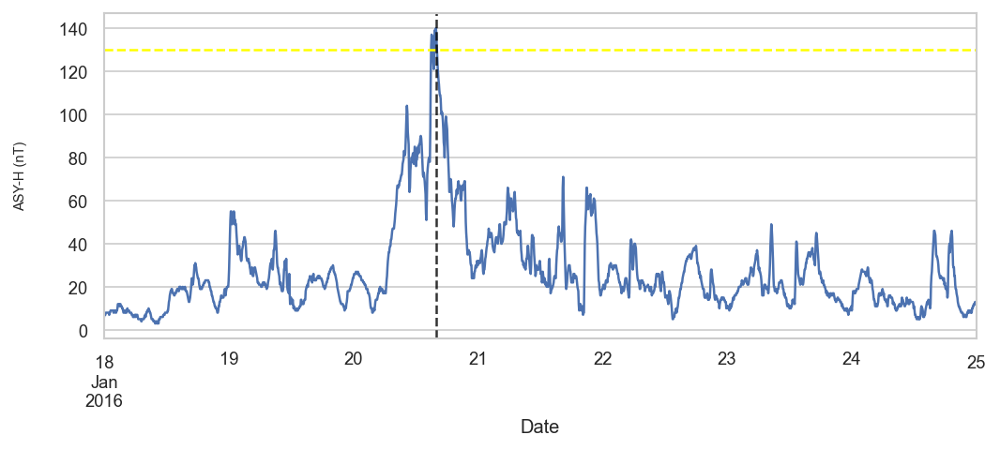

Plotting storm 254
Start date        2016-05-07 00:00:00
End date          2016-05-14 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         133
classification                    LOW
Name: 254, dtype: object
Maximum ASY-H value 133 at: 2016-05-09 00:05:00


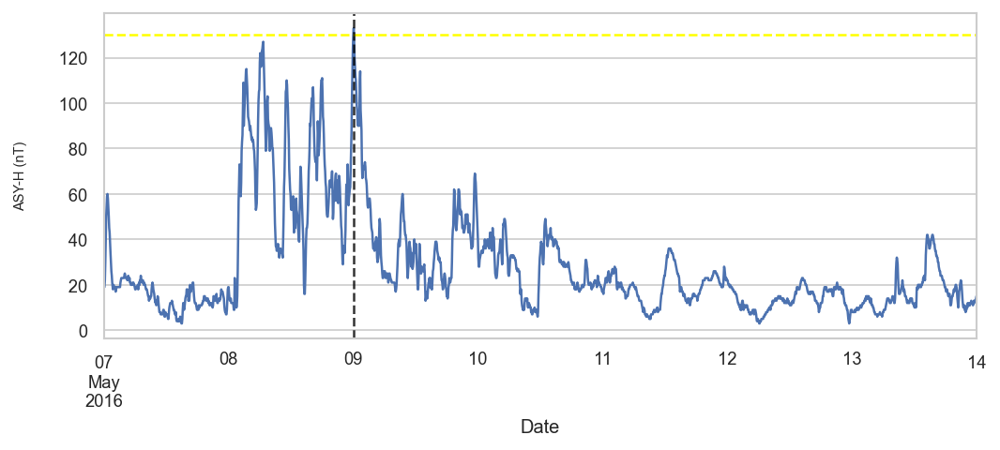

Plotting storm 255
Start date        2016-08-31 00:00:00
End date          2016-09-07 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         133
classification                    LOW
Name: 255, dtype: object
Maximum ASY-H value 133 at: 2016-09-02 05:00:00


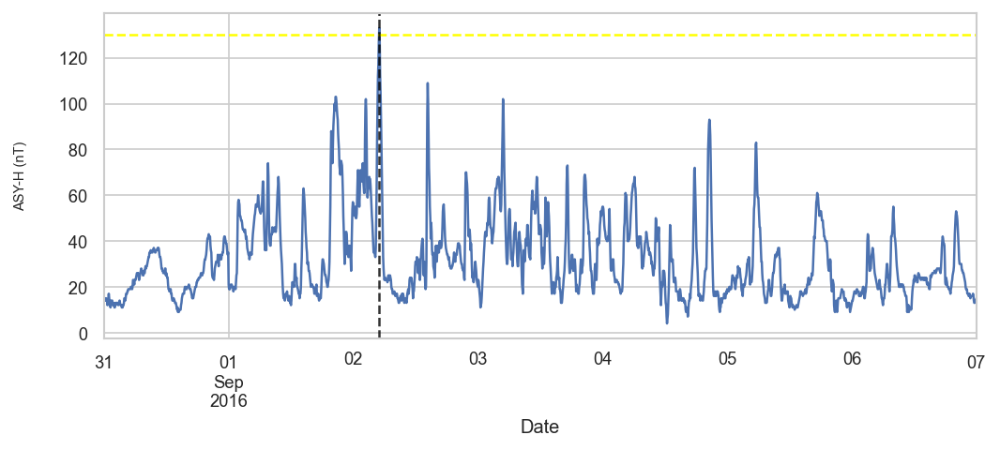

Plotting storm 256
Start date        2016-09-27 00:00:00
End date          2016-10-04 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         154
classification                    LOW
Name: 256, dtype: object
Maximum ASY-H value 154 at: 2016-09-29 09:30:00


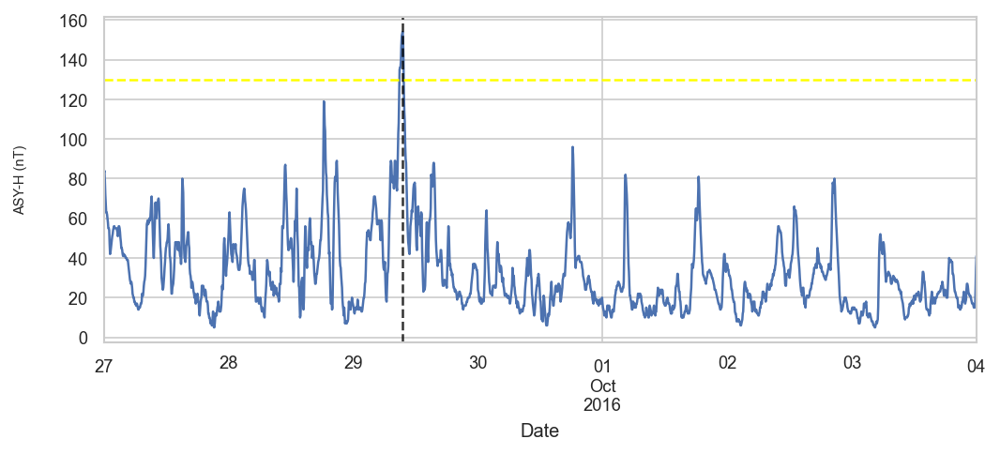

Plotting storm 257
Start date        2016-10-23 00:00:00
End date          2016-10-30 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         161
classification                    LOW
Name: 257, dtype: object
Maximum ASY-H value 161 at: 2016-10-25 17:10:00


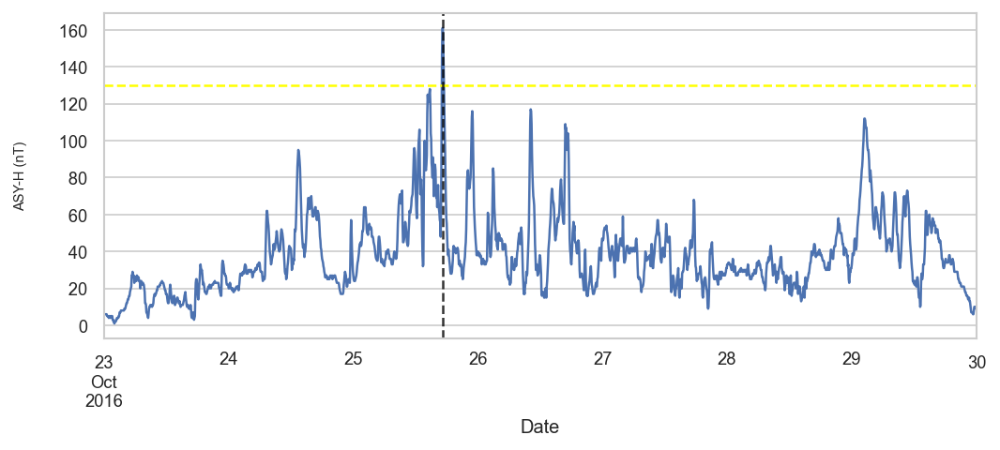

Plotting storm 258
Start date        2016-11-08 00:00:00
End date          2016-11-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         148
classification                    LOW
Name: 258, dtype: object
Maximum ASY-H value 148 at: 2016-11-10 15:55:00


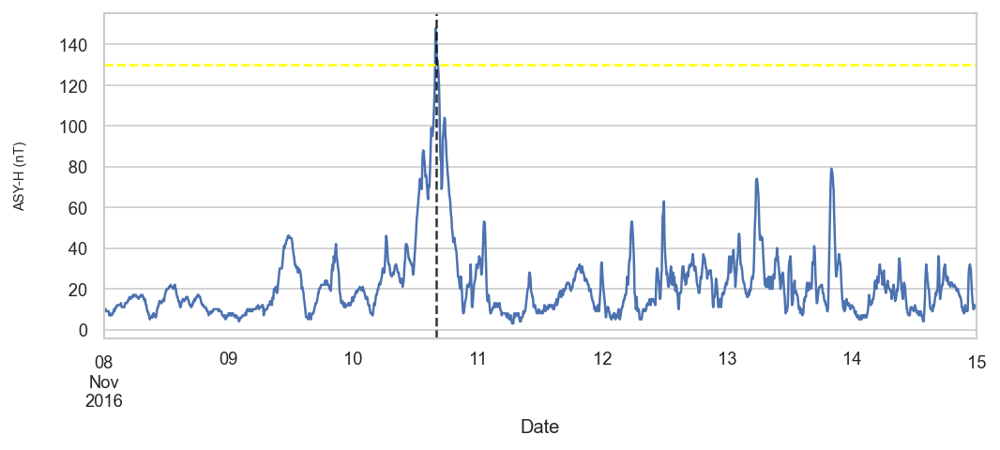

Plotting storm 259
Start date        2016-11-23 00:00:00
End date          2016-11-30 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         166
classification                    LOW
Name: 259, dtype: object
Maximum ASY-H value 166 at: 2016-11-25 05:45:00


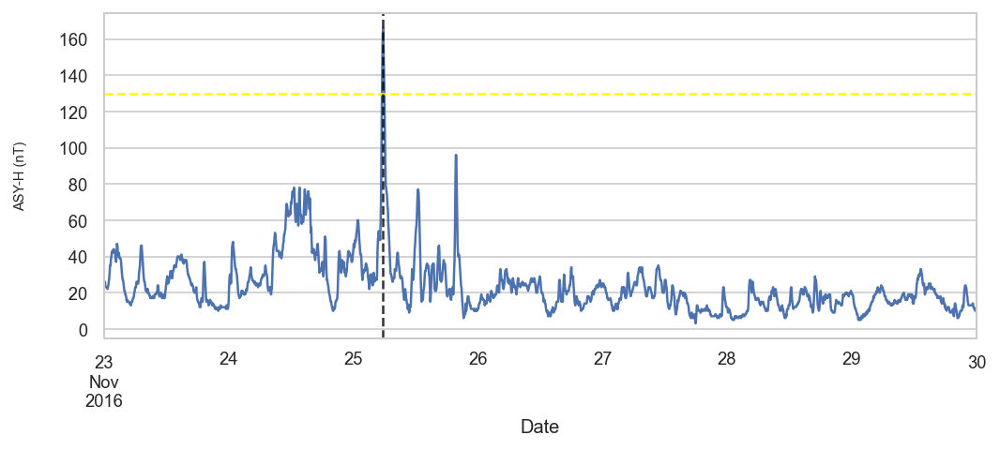

Plotting storm 261
Start date        2017-03-25 00:00:00
End date          2017-04-01 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 261, dtype: object
Maximum ASY-H value 143 at: 2017-03-27 20:05:00


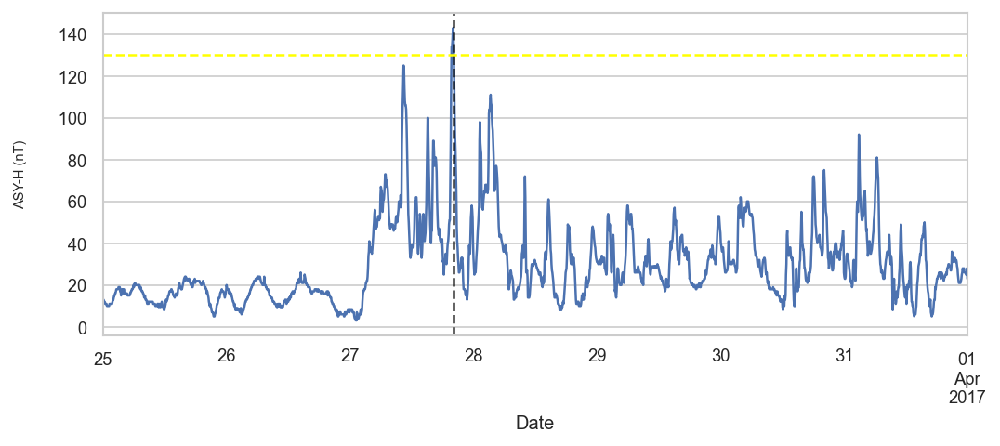

Plotting storm 262
Start date        2017-05-26 00:00:00
End date          2017-06-02 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         158
classification                    LOW
Name: 262, dtype: object
Maximum ASY-H value 158 at: 2017-05-28 03:55:00


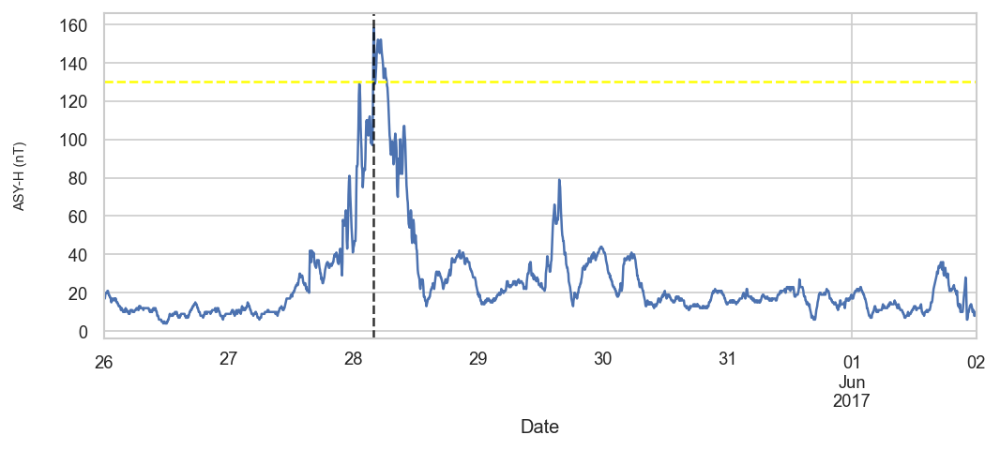

Plotting storm 265
Start date        2017-09-26 00:00:00
End date          2017-10-03 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         163
classification                    LOW
Name: 265, dtype: object
Maximum ASY-H value 163 at: 2017-09-28 08:00:00


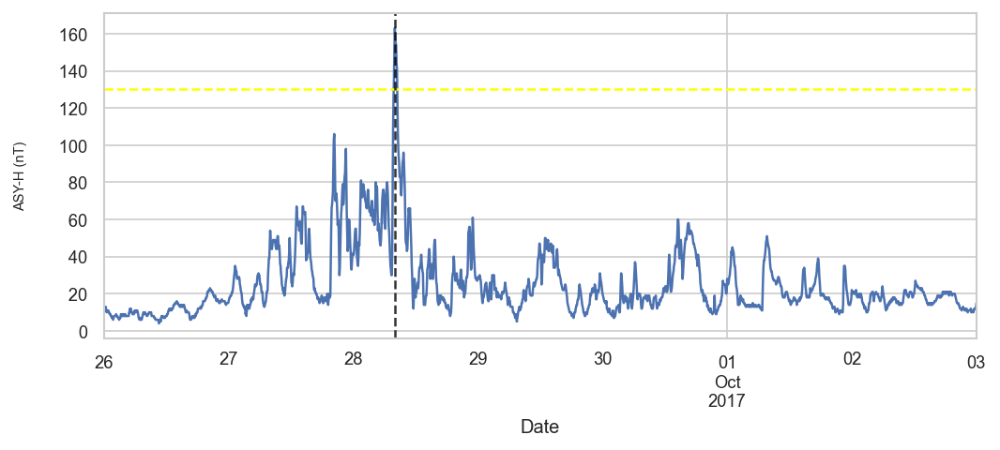

Plotting storm 266
Start date        2018-04-18 00:00:00
End date          2018-04-25 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         136
classification                    LOW
Name: 266, dtype: object
Maximum ASY-H value 136 at: 2018-04-20 09:55:00


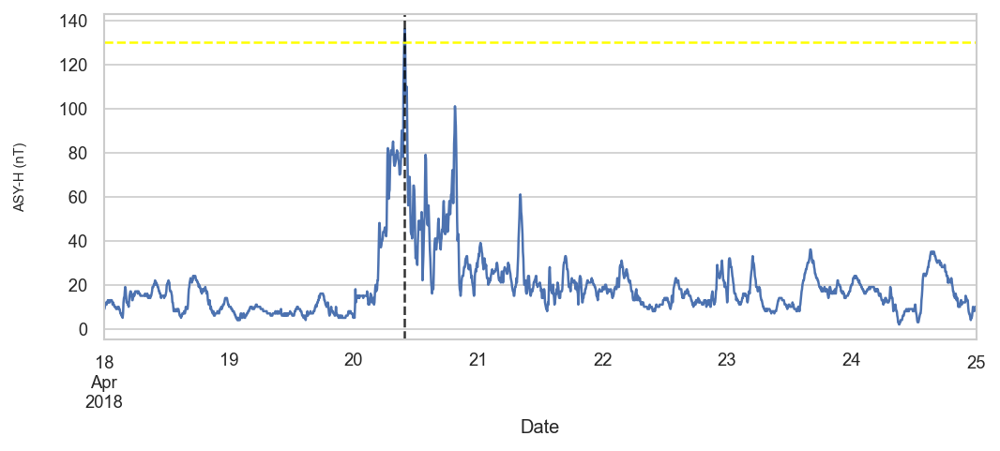

Plotting storm 268
Start date        2018-09-09 00:00:00
End date          2018-09-16 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         140
classification                    LOW
Name: 268, dtype: object
Maximum ASY-H value 140 at: 2018-09-11 09:35:00


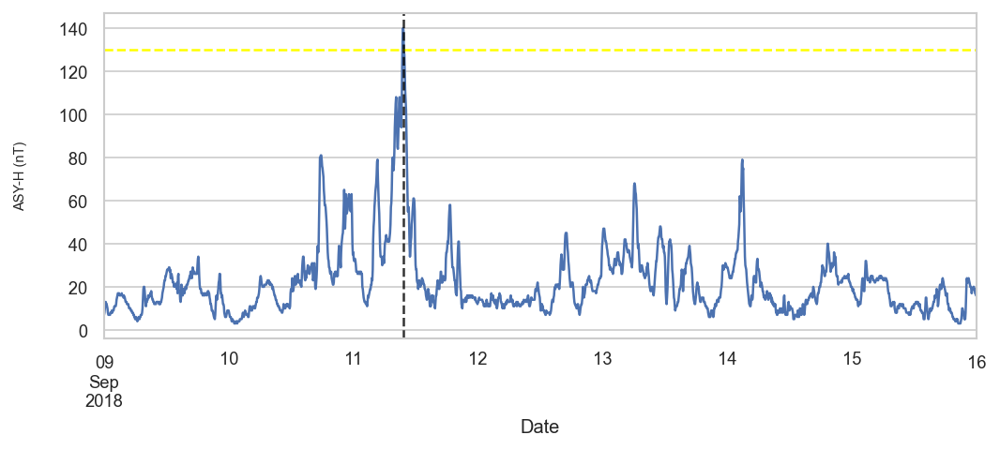

Plotting storm 269
Start date        2018-11-03 00:00:00
End date          2018-11-10 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         131
classification                    LOW
Name: 269, dtype: object
Maximum ASY-H value 131 at: 2018-11-05 05:10:00


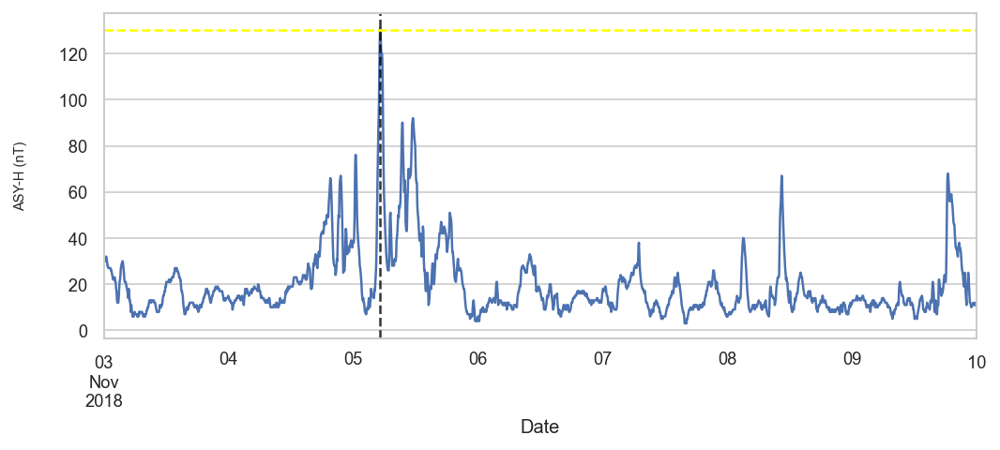

Plotting storm 270
Start date        2019-05-09 00:00:00
End date          2019-05-16 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         134
classification                    LOW
Name: 270, dtype: object
Maximum ASY-H value 134 at: 2019-05-11 12:45:00


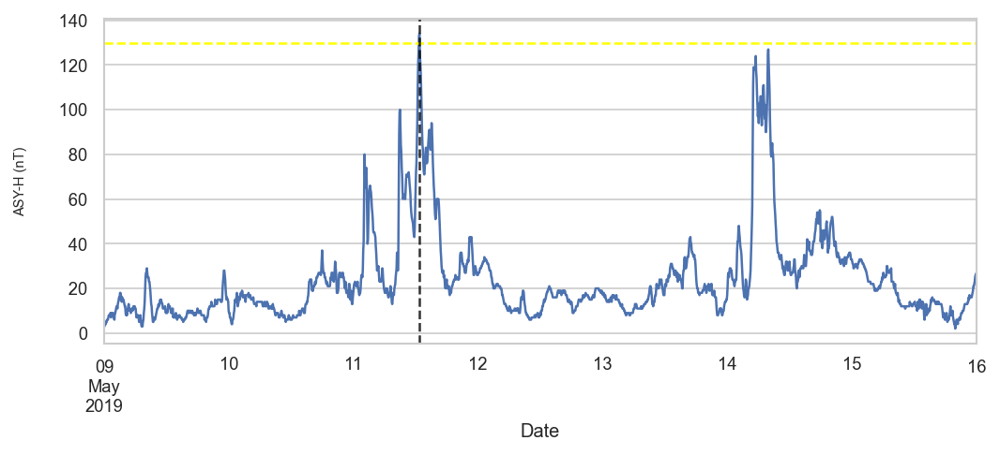

Plotting storm 271
Start date        2019-08-03 00:00:00
End date          2019-08-10 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         139
classification                    LOW
Name: 271, dtype: object
Maximum ASY-H value 139 at: 2019-08-05 12:10:00


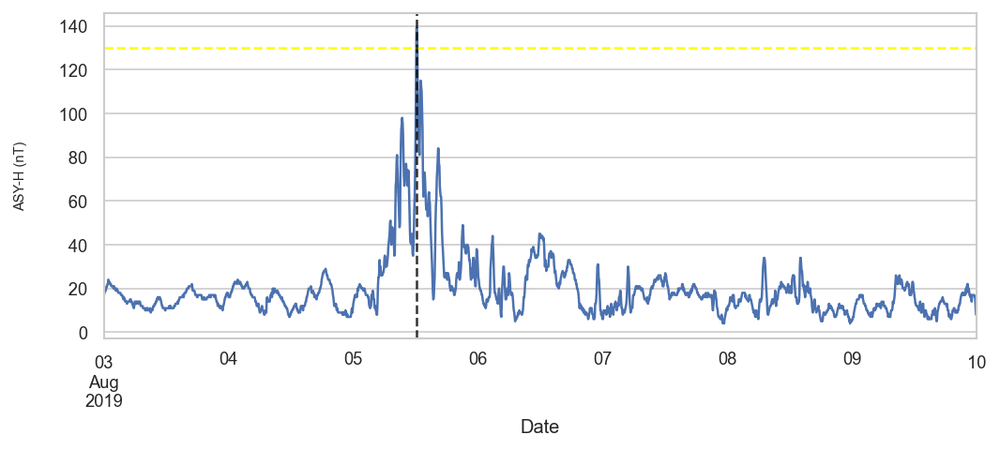

Plotting storm 272
Start date        2019-08-29 00:00:00
End date          2019-09-05 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         146
classification                    LOW
Name: 272, dtype: object
Maximum ASY-H value 146 at: 2019-08-31 12:30:00


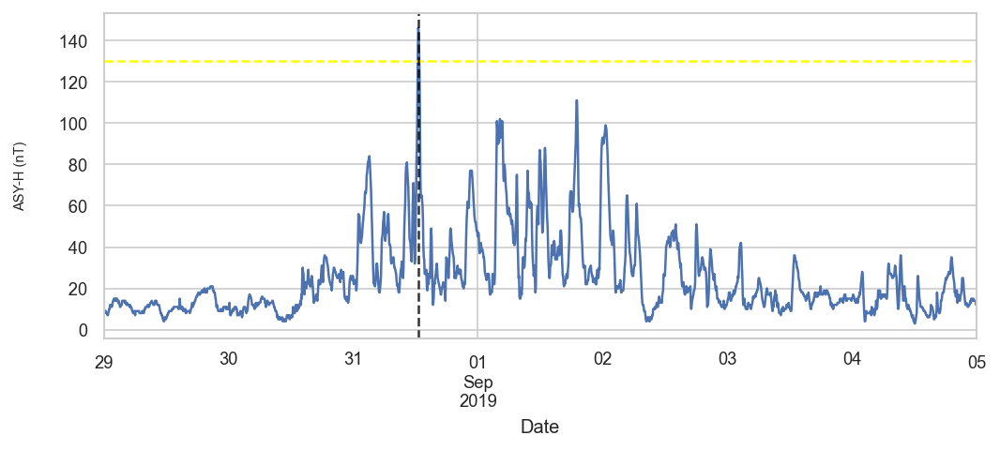

Plotting storm 273
Start date        2019-10-23 00:00:00
End date          2019-10-30 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 273, dtype: object
Maximum ASY-H value 143 at: 2019-10-25 09:00:00


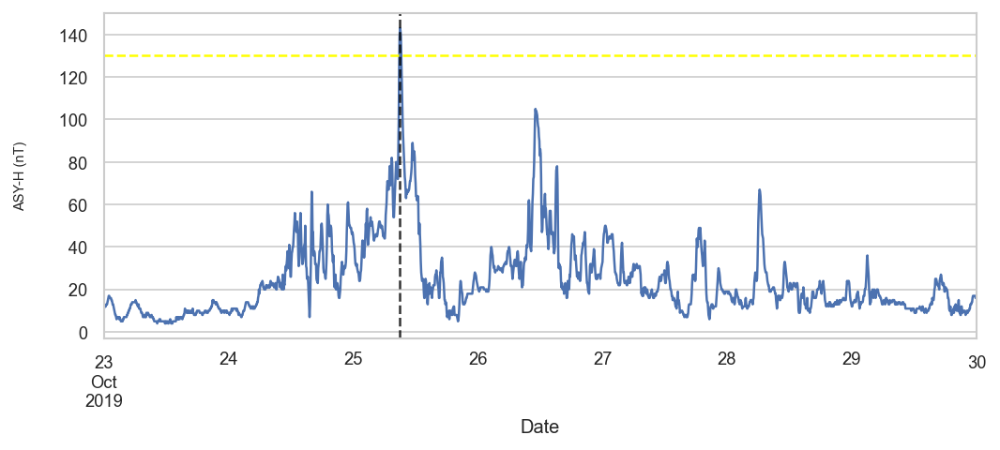

Plotting storm 274
Start date        2020-04-18 00:00:00
End date          2020-04-25 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         143
classification                    LOW
Name: 274, dtype: object
Maximum ASY-H value 143 at: 2020-04-20 13:05:00


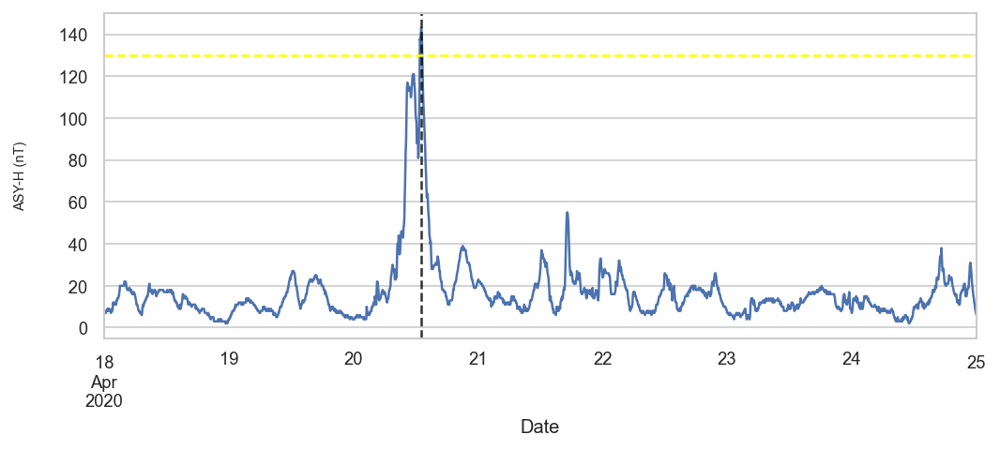

Plotting storm 275
Start date        2021-05-10 00:00:00
End date          2021-05-17 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         146
classification                    LOW
Name: 275, dtype: object
Maximum ASY-H value 146 at: 2021-05-12 12:50:00


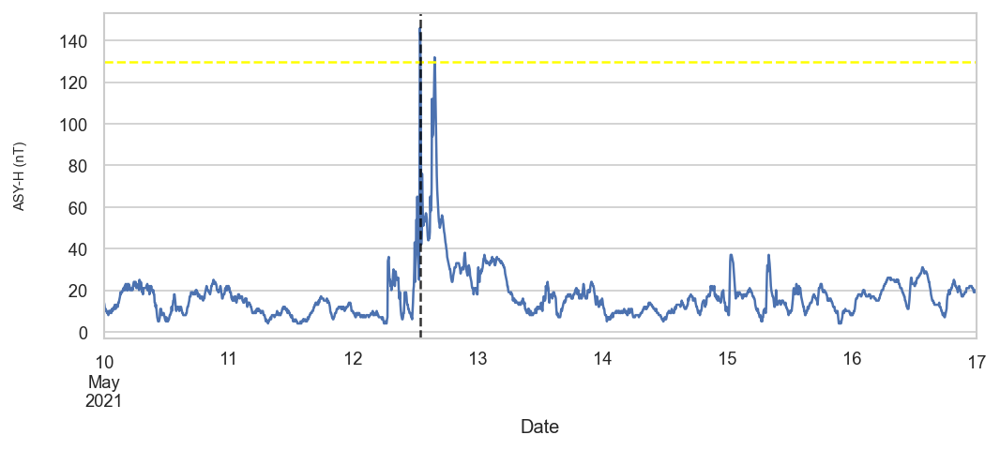

Plotting storm 276
Start date        2021-10-10 00:00:00
End date          2021-10-17 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         167
classification                    LOW
Name: 276, dtype: object
Maximum ASY-H value 167 at: 2021-10-12 15:10:00


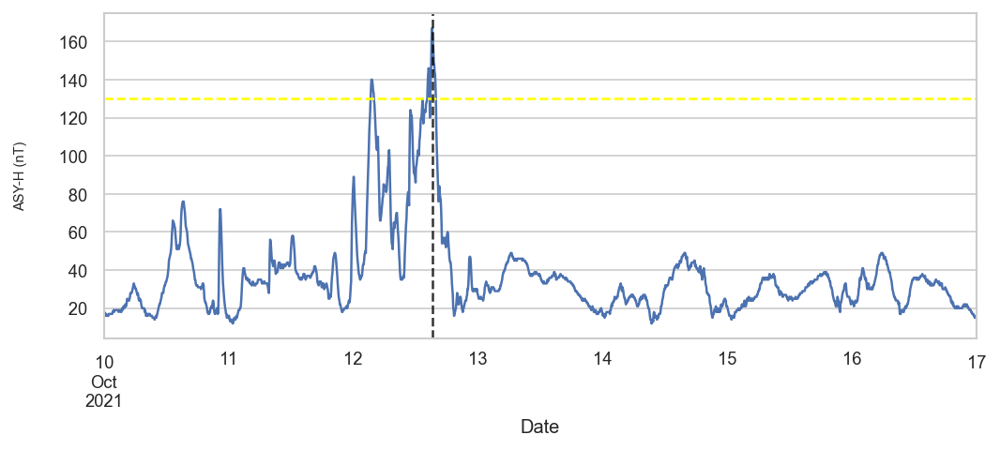

Plotting storm 278
Start date        2022-02-01 00:00:00
End date          2022-02-08 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         153
classification                    LOW
Name: 278, dtype: object
Maximum ASY-H value 153 at: 2022-02-03 09:25:00


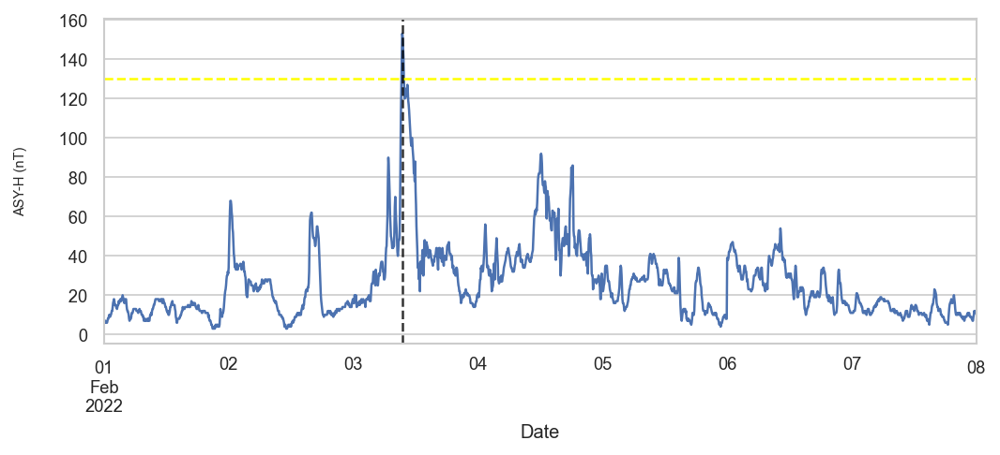

Plotting storm 279
Start date        2022-03-11 00:00:00
End date          2022-03-18 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         139
classification                    LOW
Name: 279, dtype: object
Maximum ASY-H value 139 at: 2022-03-13 17:55:00


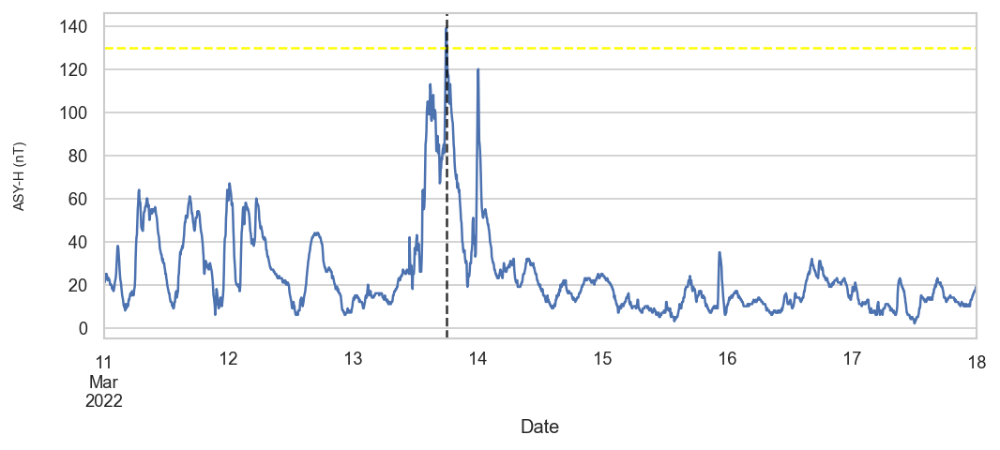

Plotting storm 280
Start date        2022-04-08 00:00:00
End date          2022-04-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         138
classification                    LOW
Name: 280, dtype: object
Maximum ASY-H value 138 at: 2022-04-10 04:50:00


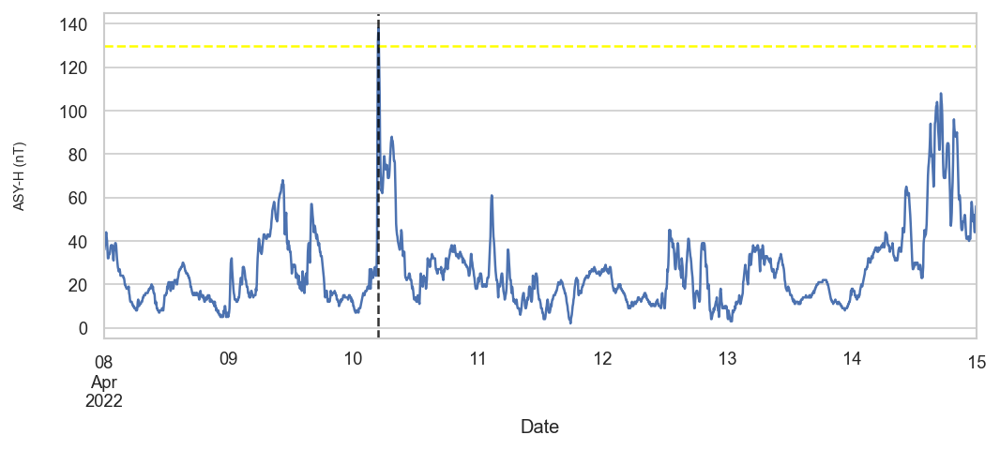

Plotting storm 281
Start date        2022-09-02 00:00:00
End date          2022-09-09 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         148
classification                    LOW
Name: 281, dtype: object
Maximum ASY-H value 148 at: 2022-09-04 09:15:00


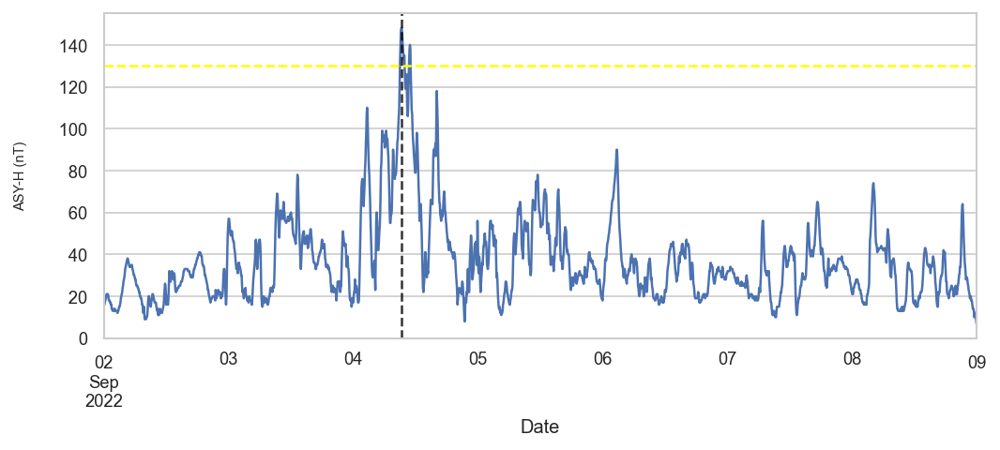

Plotting storm 282
Start date        2022-11-05 00:00:00
End date          2022-11-12 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         139
classification                    LOW
Name: 282, dtype: object
Maximum ASY-H value 139 at: 2022-11-07 16:55:00


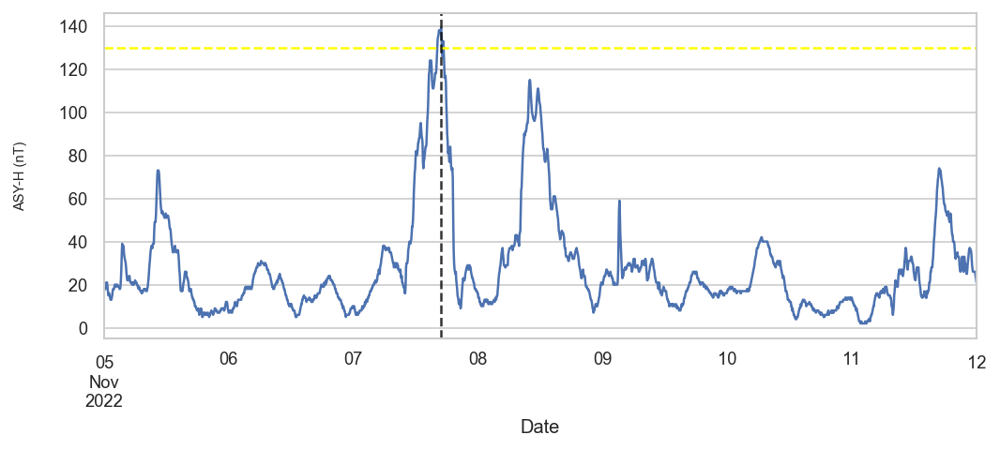

Plotting storm 283
Start date        2022-12-05 00:00:00
End date          2022-12-12 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         144
classification                    LOW
Name: 283, dtype: object
Maximum ASY-H value 144 at: 2022-12-07 16:35:00


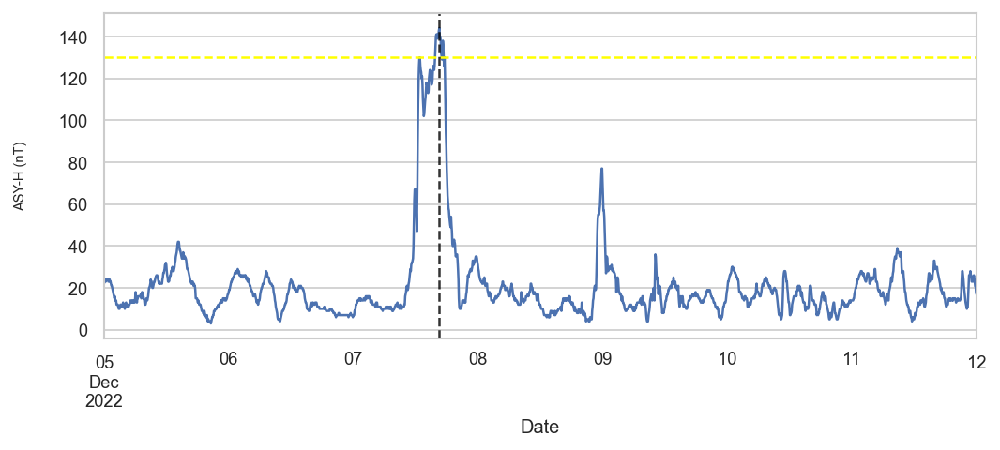

In [9]:
# Plot the storms of low intensity
# the yellow horizontal line corresponds to the low intensity threshold
print(f'{len(low_indices)} storms of low intensity')
for ix, ind in enumerate(low_indices):    
    ax = utils.plot_storm_asy(dfx, summary_df_asy, ind)
    strm = utils.get_storm(dfx, summary_df_asy, ind)
    ax.axvline(strm['ASY_H'].idxmax(), linestyle = '--', color = 'black', alpha = 0.8)
    print(f'Maximum ASY-H value {strm["ASY_H"].max()} at: {strm["ASY_H"].idxmax()}')
    plt.show();

### Moderate intensity storms <a class="anchor" id="section_2_2"></a>

89 moderate storms
Plotting storm 1
Start date        1981-04-11 00:00:00
End date          1981-04-18 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         267
classification               MODERATE
Name: 1, dtype: object
Maximum ASY-H value 267 at: 1981-04-13 03:55:00


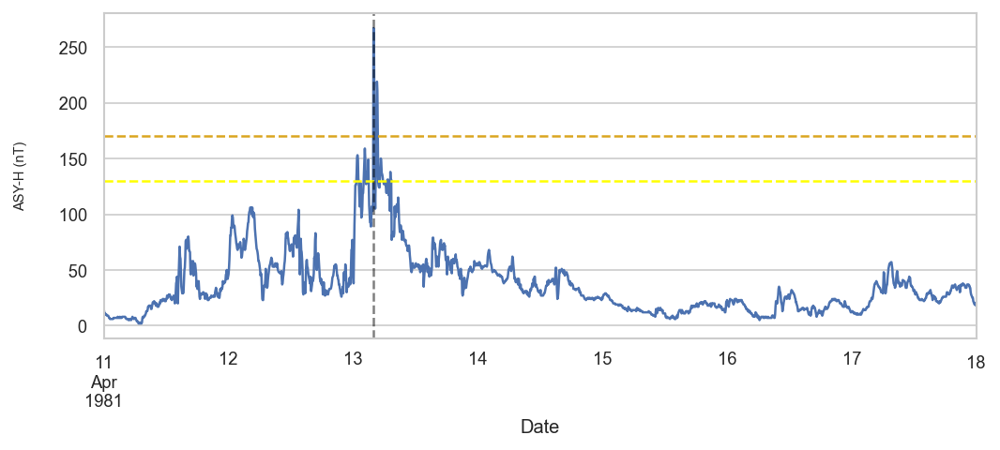

Plotting storm 2
Start date        1981-05-08 00:00:00
End date          1981-05-23 00:00:00
TD                   15 days 00:00:00
Max ASY-H                         173
classification               MODERATE
Name: 2, dtype: object
Maximum ASY-H value 173 at: 1981-05-15 06:25:00


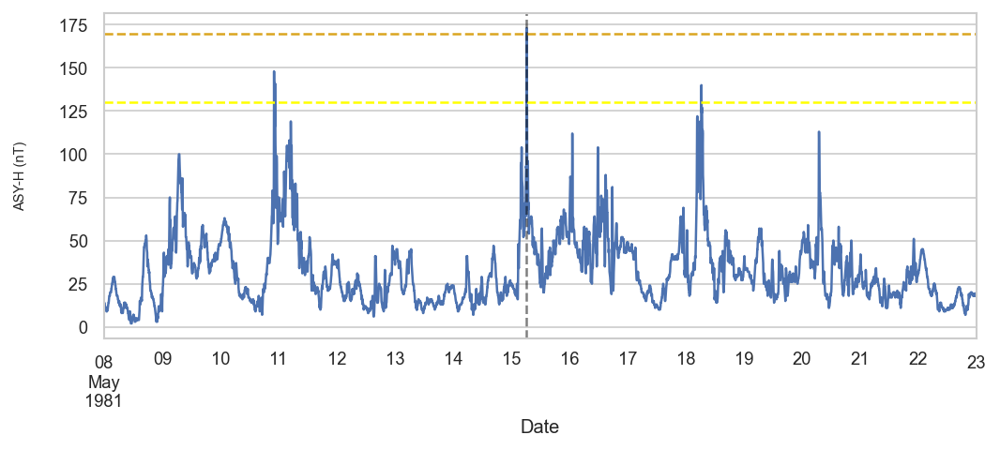

Plotting storm 3
Start date        1981-07-23 00:00:00
End date          1981-07-31 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         287
classification               MODERATE
Name: 3, dtype: object
Maximum ASY-H value 287 at: 1981-07-25 14:15:00


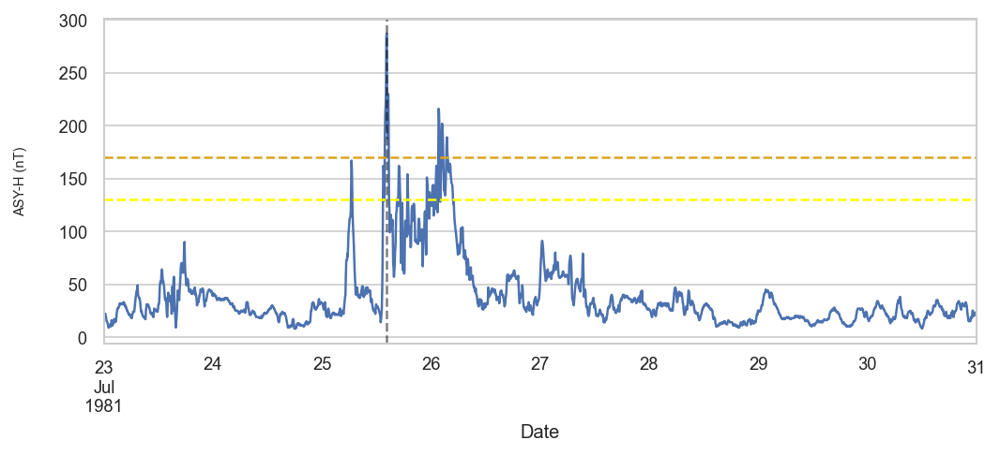

Plotting storm 4
Start date        1981-10-12 00:00:00
End date          1981-10-19 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         245
classification               MODERATE
Name: 4, dtype: object
Maximum ASY-H value 245 at: 1981-10-14 02:20:00


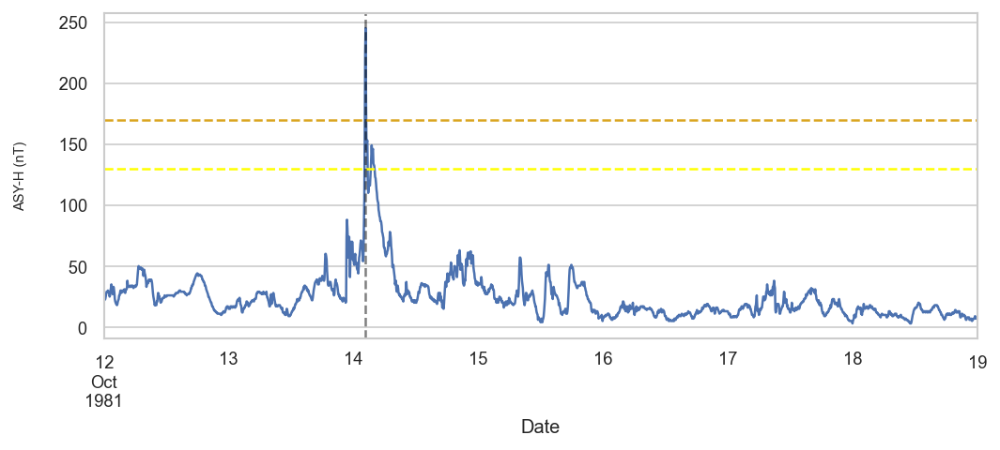

Plotting storm 6
Start date        1982-02-27 00:00:00
End date          1982-03-07 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         193
classification               MODERATE
Name: 6, dtype: object
Maximum ASY-H value 193 at: 1982-03-02 10:15:00


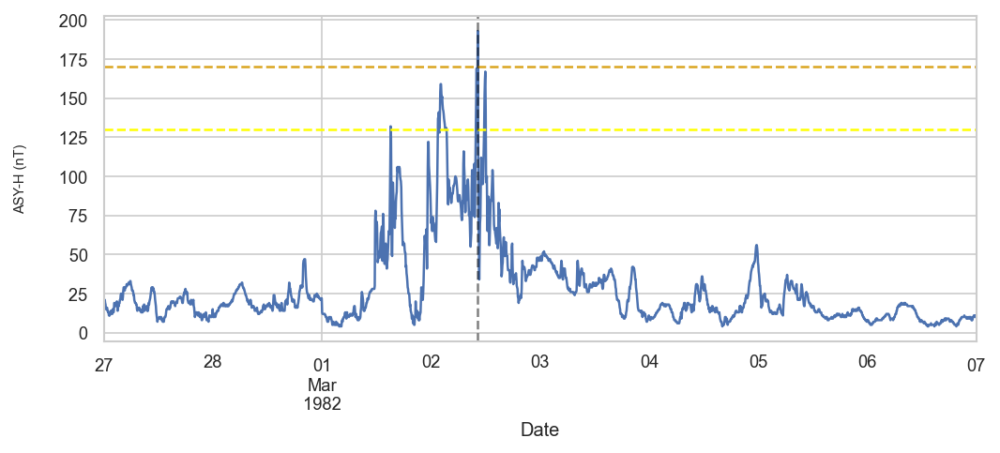

Plotting storm 10
Start date        1982-09-19 00:00:00
End date          1982-10-01 00:00:00
TD                   12 days 00:00:00
Max ASY-H                         254
classification               MODERATE
Name: 10, dtype: object
Maximum ASY-H value 254 at: 1982-09-22 06:35:00


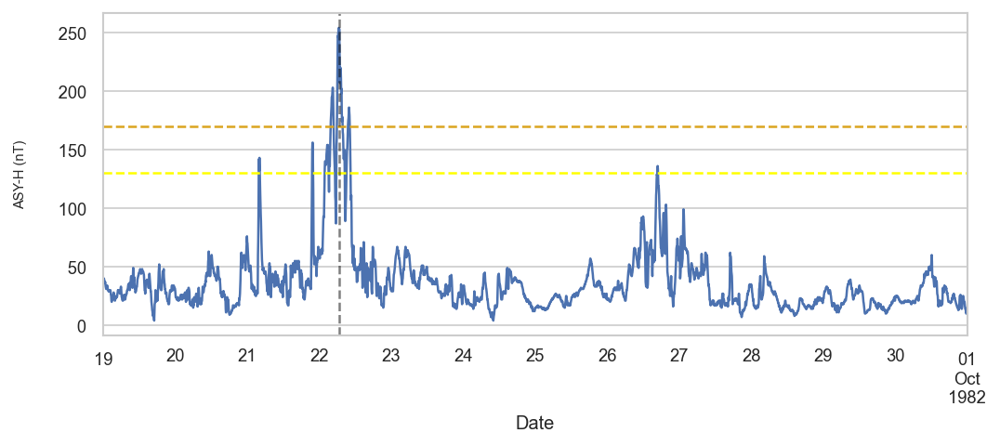

Plotting storm 14
Start date        1983-01-08 00:00:00
End date          1983-01-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         184
classification               MODERATE
Name: 14, dtype: object
Maximum ASY-H value 184 at: 1983-01-10 05:55:00


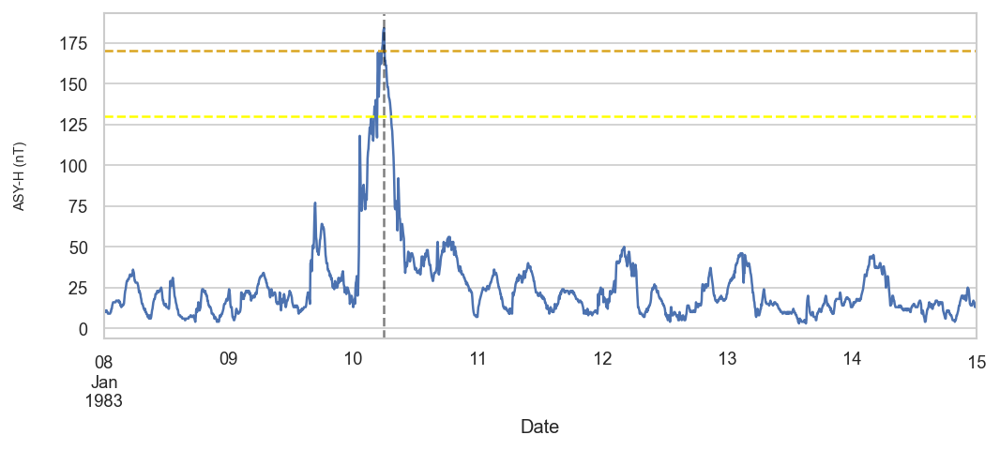

Plotting storm 17
Start date        1983-05-22 00:00:00
End date          1983-05-29 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         224
classification               MODERATE
Name: 17, dtype: object
Maximum ASY-H value 224 at: 1983-05-24 18:15:00


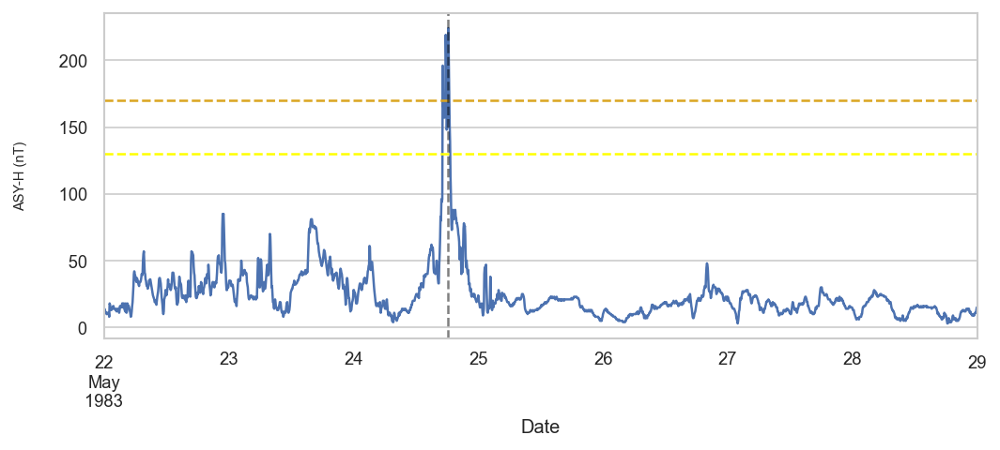

Plotting storm 22
Start date        1984-04-02 00:00:00
End date          1984-04-09 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         189
classification               MODERATE
Name: 22, dtype: object
Maximum ASY-H value 189 at: 1984-04-04 17:45:00


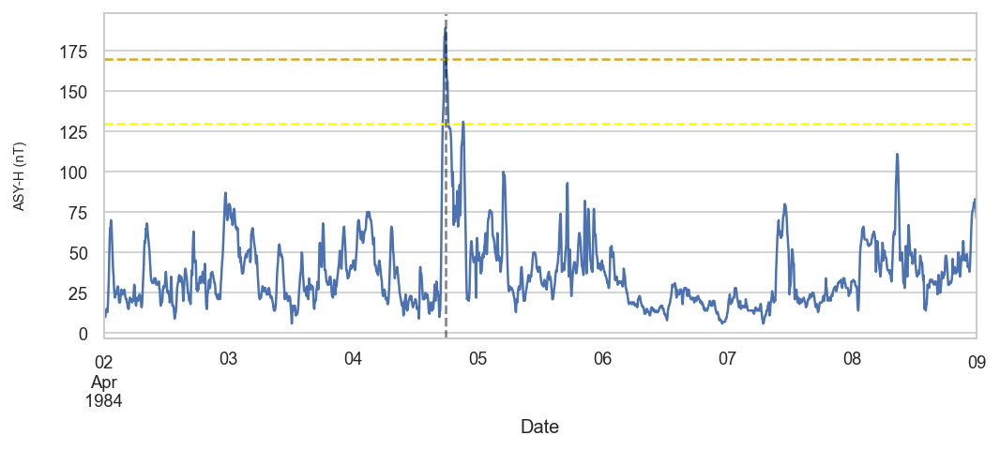

Plotting storm 30
Start date        1985-04-18 00:00:00
End date          1985-05-05 00:00:00
TD                   17 days 00:00:00
Max ASY-H                         211
classification               MODERATE
Name: 30, dtype: object
Maximum ASY-H value 211 at: 1985-04-21 02:45:00


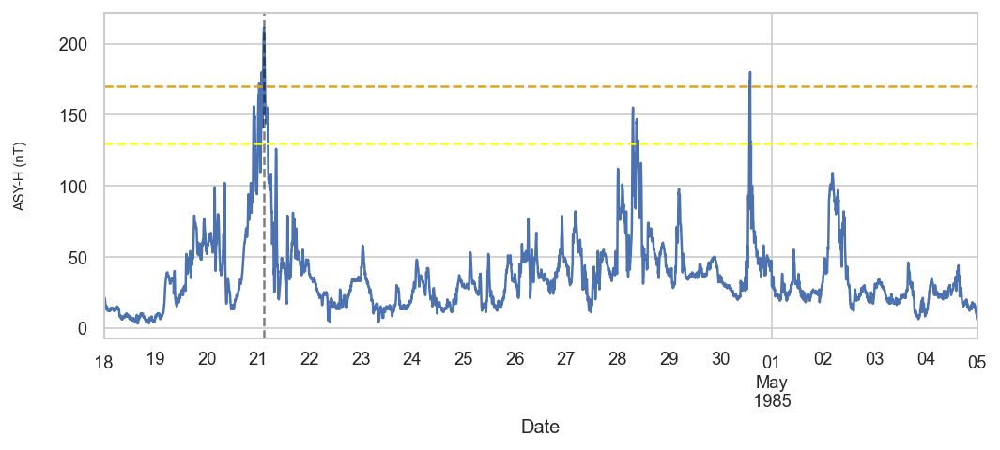

Plotting storm 37
Start date        1986-09-10 00:00:00
End date          1986-09-17 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         216
classification               MODERATE
Name: 37, dtype: object
Maximum ASY-H value 216 at: 1986-09-12 04:40:00


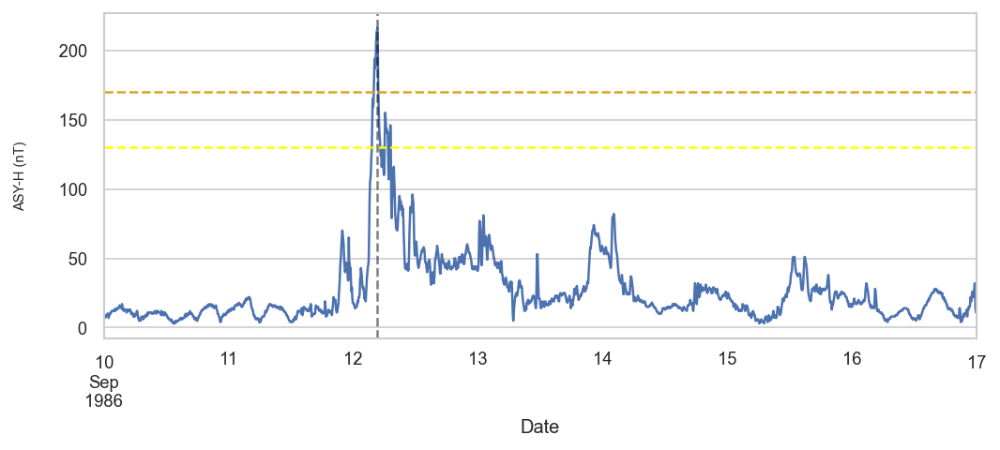

Plotting storm 41
Start date        1987-08-23 00:00:00
End date          1987-09-05 00:00:00
TD                   13 days 00:00:00
Max ASY-H                         188
classification               MODERATE
Name: 41, dtype: object
Maximum ASY-H value 188 at: 1987-08-25 14:05:00


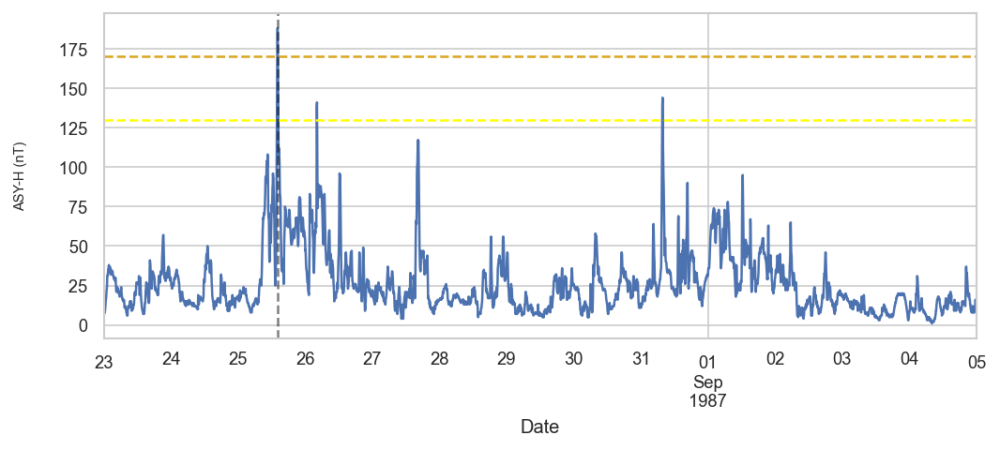

Plotting storm 48
Start date        1988-02-13 00:00:00
End date          1988-02-27 00:00:00
TD                   14 days 00:00:00
Max ASY-H                         204
classification               MODERATE
Name: 48, dtype: object
Maximum ASY-H value 204 at: 1988-02-22 07:40:00


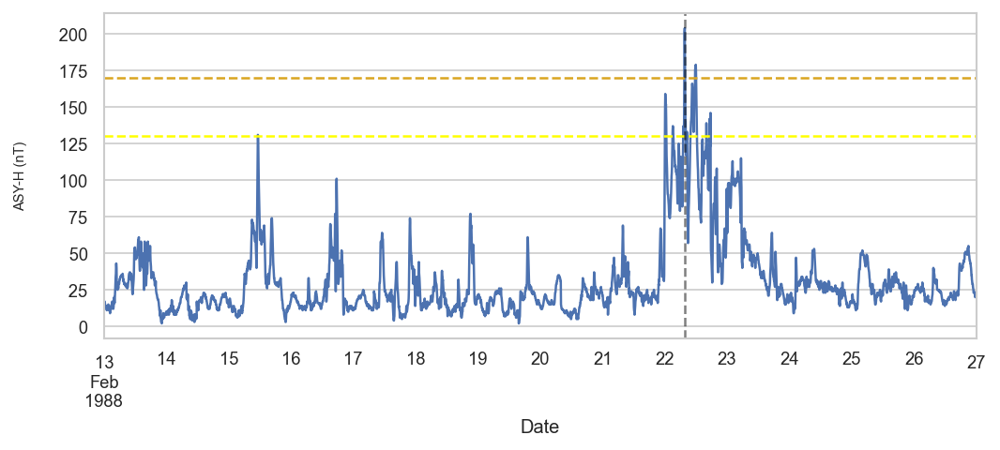

Plotting storm 53
Start date        1988-10-08 00:00:00
End date          1988-10-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         201
classification               MODERATE
Name: 53, dtype: object
Maximum ASY-H value 201 at: 1988-10-10 12:15:00


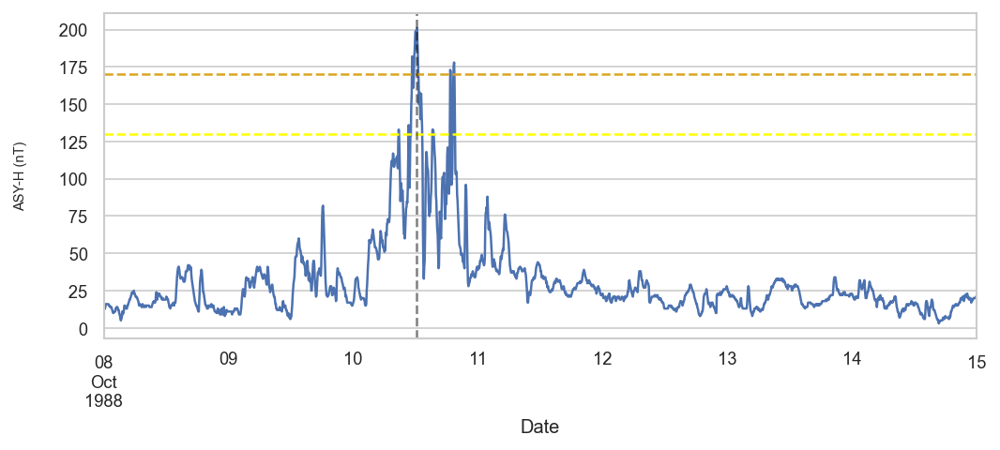

Plotting storm 54
Start date        1988-11-28 00:00:00
End date          1988-12-05 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         183
classification               MODERATE
Name: 54, dtype: object
Maximum ASY-H value 183 at: 1988-11-30 10:15:00


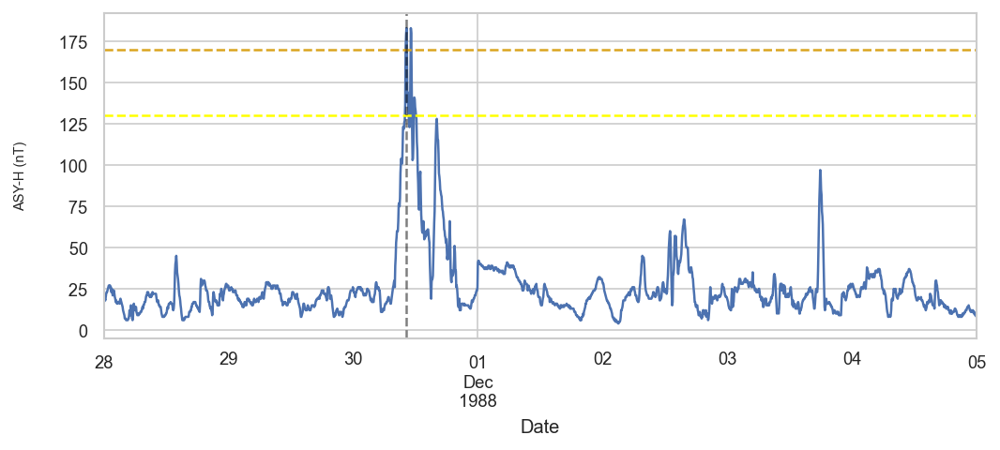

Plotting storm 57
Start date        1989-01-18 00:00:00
End date          1989-01-25 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         180
classification               MODERATE
Name: 57, dtype: object
Maximum ASY-H value 180 at: 1989-01-20 16:10:00


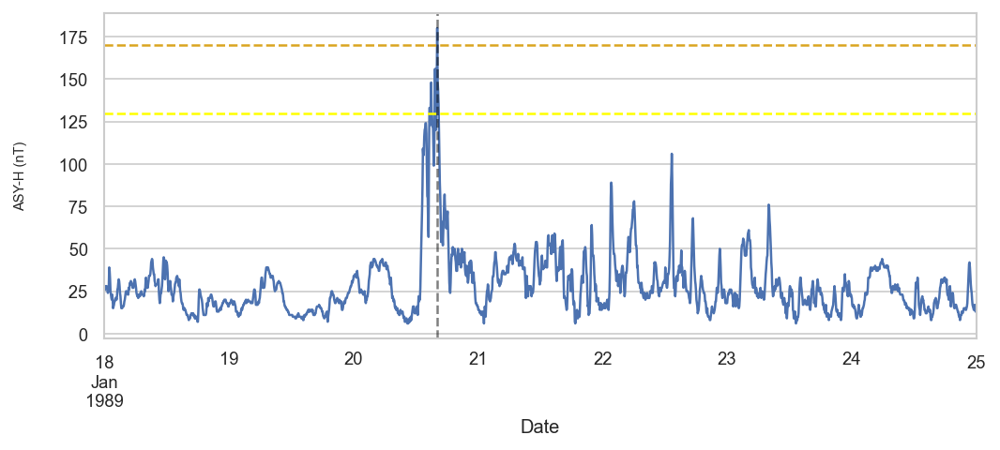

Plotting storm 59
Start date        1989-04-24 00:00:00
End date          1989-05-02 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         174
classification               MODERATE
Name: 59, dtype: object
Maximum ASY-H value 174 at: 1989-04-26 05:35:00


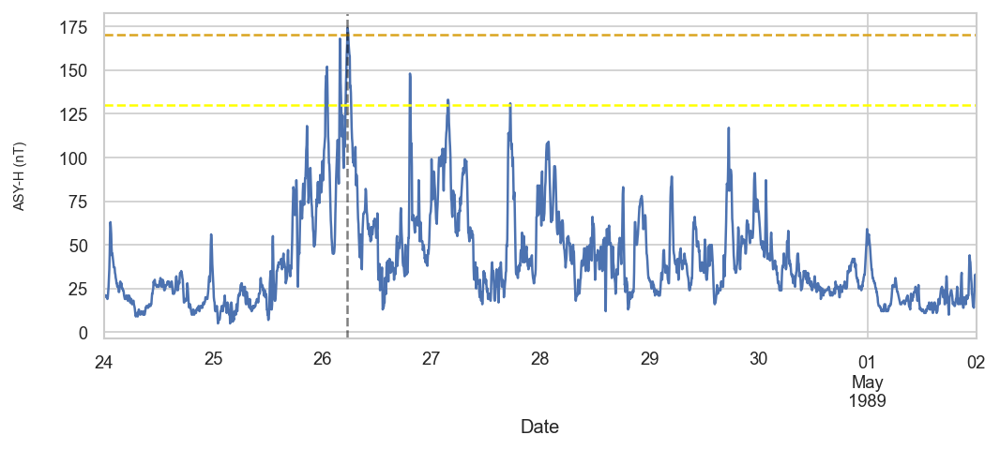

Plotting storm 60
Start date        1989-05-03 00:00:00
End date          1989-05-10 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         176
classification               MODERATE
Name: 60, dtype: object
Maximum ASY-H value 176 at: 1989-05-05 01:10:00


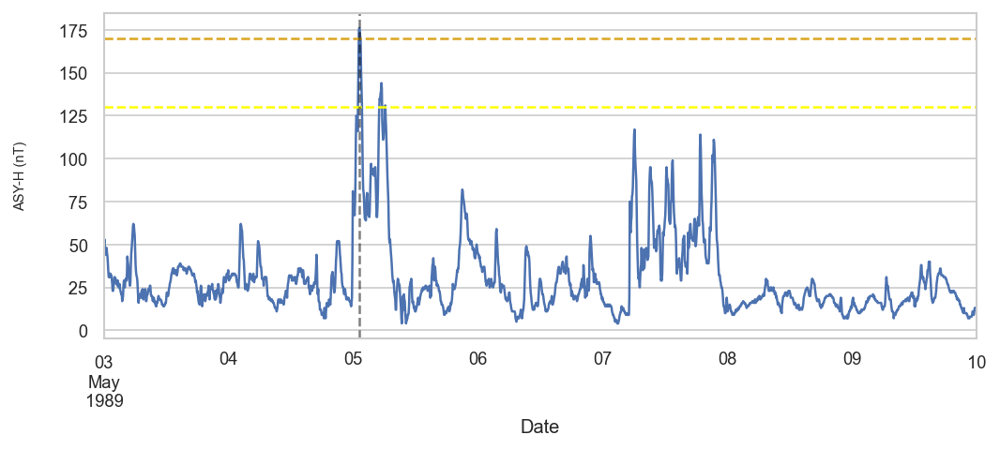

Plotting storm 61
Start date        1989-05-21 00:00:00
End date          1989-05-29 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         210
classification               MODERATE
Name: 61, dtype: object
Maximum ASY-H value 210 at: 1989-05-23 15:30:00


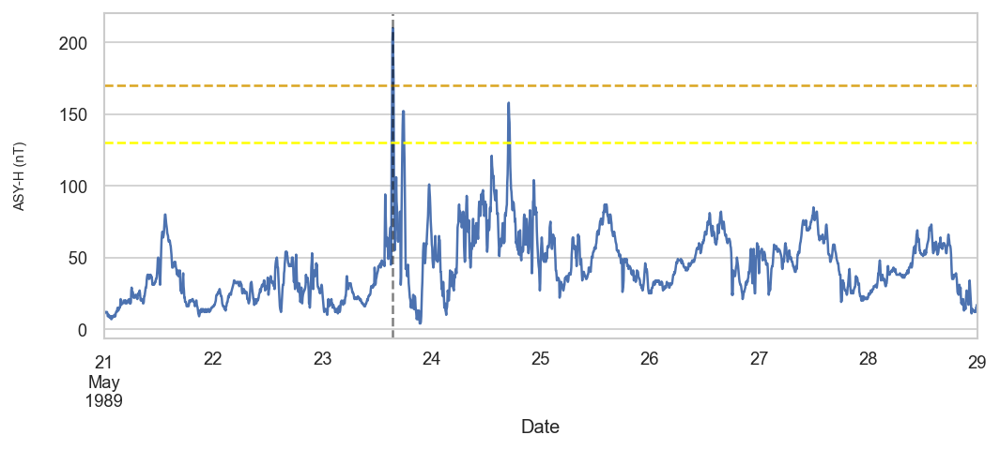

Plotting storm 62
Start date        1989-06-08 00:00:00
End date          1989-06-19 00:00:00
TD                   11 days 00:00:00
Max ASY-H                         235
classification               MODERATE
Name: 62, dtype: object
Maximum ASY-H value 235 at: 1989-06-10 16:40:00


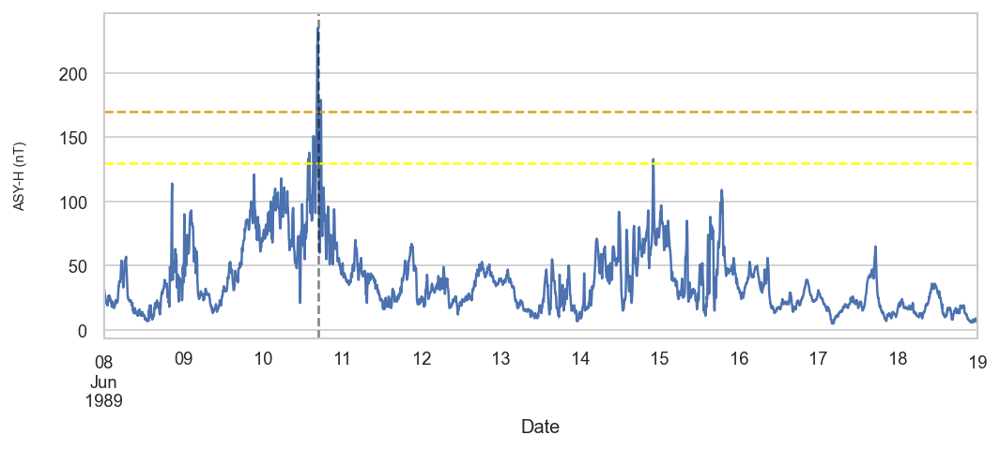

Plotting storm 63
Start date        1989-08-13 00:00:00
End date          1989-08-22 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         215
classification               MODERATE
Name: 63, dtype: object
Maximum ASY-H value 215 at: 1989-08-15 12:30:00


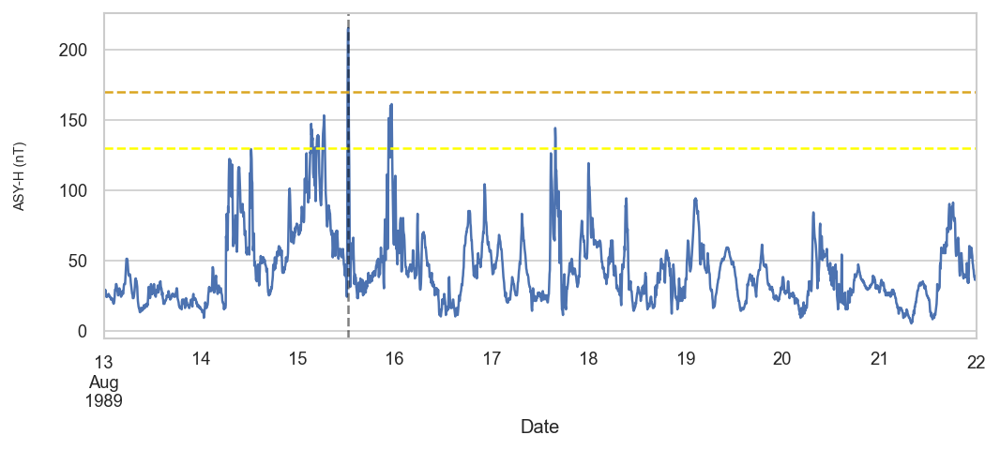

Plotting storm 64
Start date        1989-08-27 00:00:00
End date          1989-09-03 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         254
classification               MODERATE
Name: 64, dtype: object
Maximum ASY-H value 254 at: 1989-08-29 05:05:00


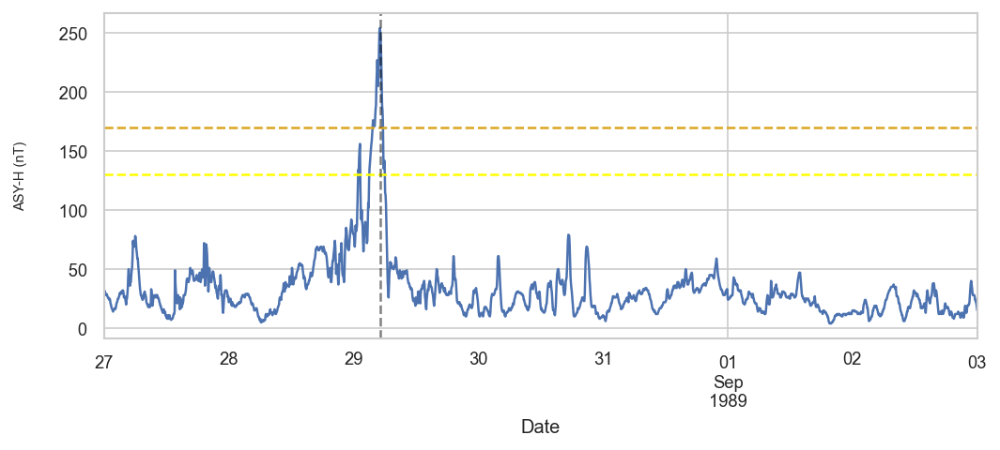

Plotting storm 67
Start date        1989-11-15 00:00:00
End date          1989-11-23 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         273
classification               MODERATE
Name: 67, dtype: object
Maximum ASY-H value 273 at: 1989-11-17 17:50:00


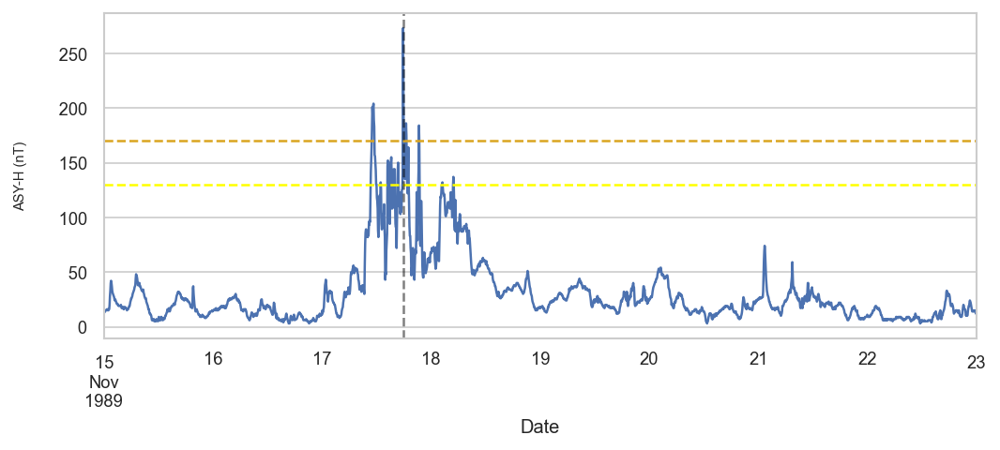

Plotting storm 68
Start date        1989-11-29 00:00:00
End date          1989-12-06 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         199
classification               MODERATE
Name: 68, dtype: object
Maximum ASY-H value 199 at: 1989-12-01 18:10:00


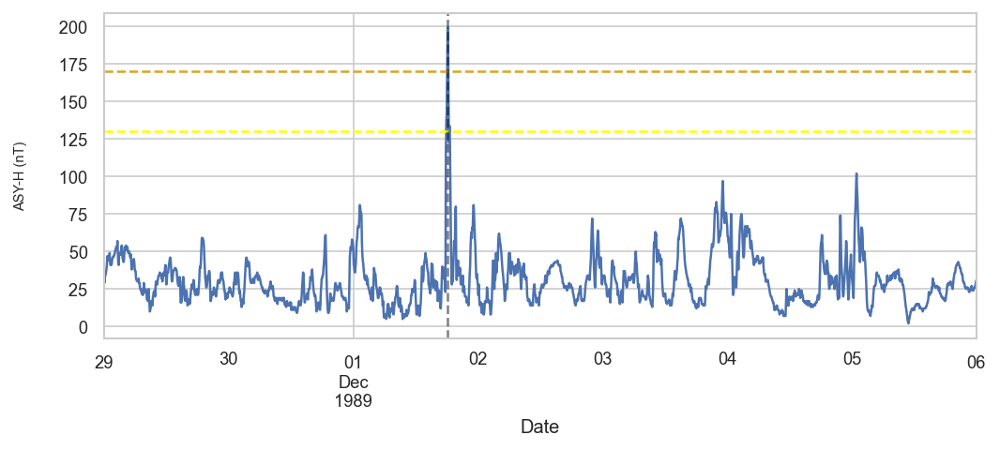

Plotting storm 72
Start date        1990-03-28 00:00:00
End date          1990-04-04 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         205
classification               MODERATE
Name: 72, dtype: object
Maximum ASY-H value 205 at: 1990-03-30 10:20:00


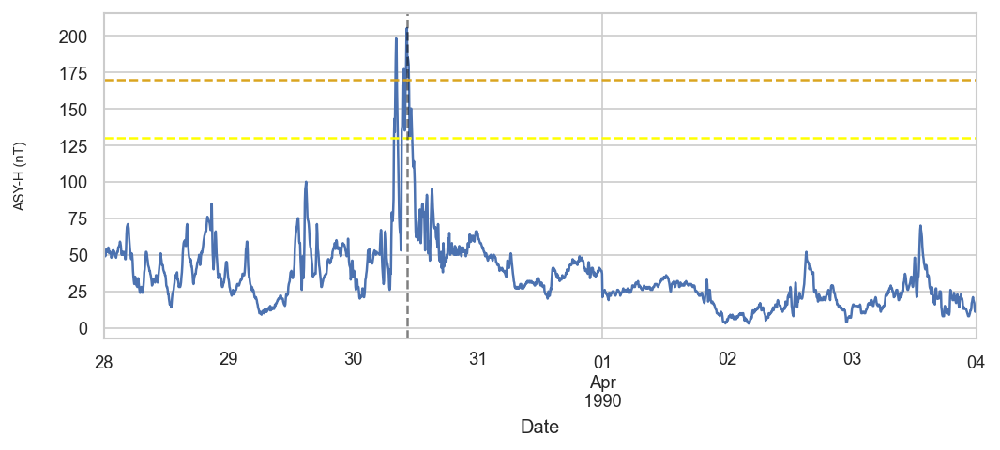

Plotting storm 73
Start date        1990-04-08 00:00:00
End date          1990-04-22 00:00:00
TD                   14 days 00:00:00
Max ASY-H                         286
classification               MODERATE
Name: 73, dtype: object
Maximum ASY-H value 286 at: 1990-04-10 14:00:00


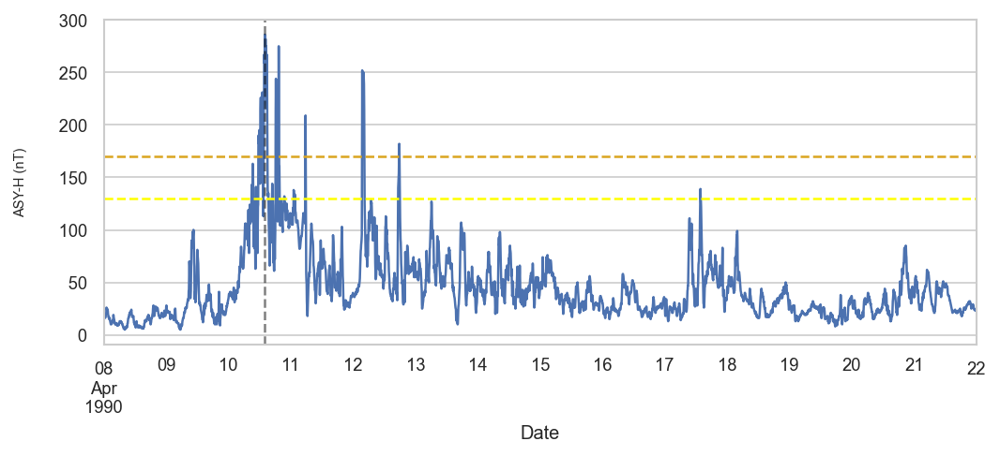

Plotting storm 74
Start date        1990-05-24 00:00:00
End date          1990-06-01 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         223
classification               MODERATE
Name: 74, dtype: object
Maximum ASY-H value 223 at: 1990-05-26 22:05:00


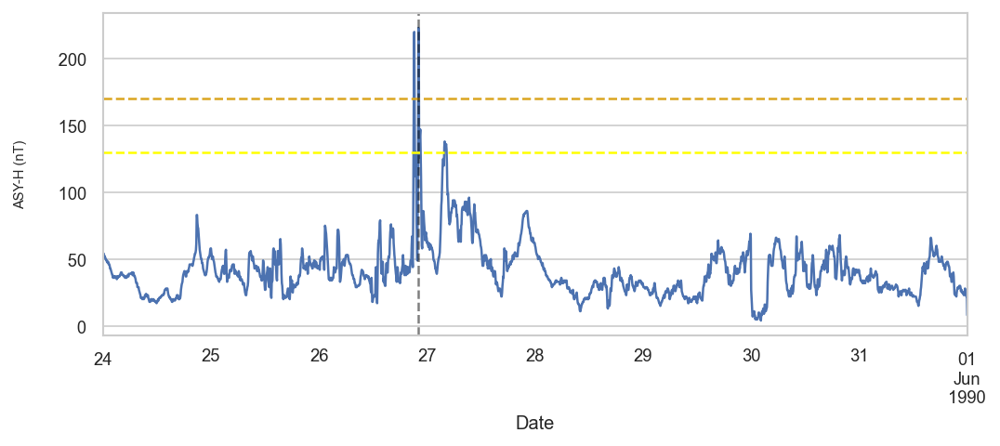

Plotting storm 75
Start date        1990-06-10 00:00:00
End date          1990-06-19 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         289
classification               MODERATE
Name: 75, dtype: object
Maximum ASY-H value 289 at: 1990-06-12 21:35:00


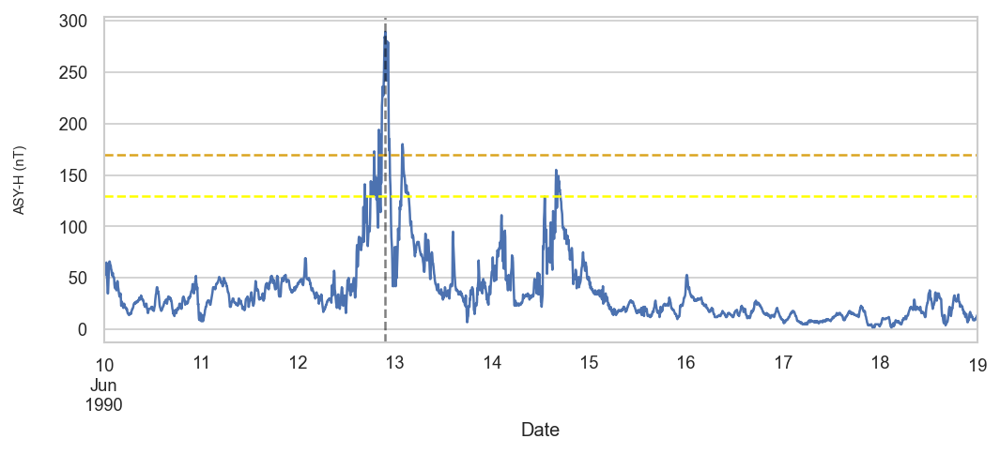

Plotting storm 76
Start date        1990-07-26 00:00:00
End date          1990-08-03 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         195
classification               MODERATE
Name: 76, dtype: object
Maximum ASY-H value 195 at: 1990-07-28 23:10:00


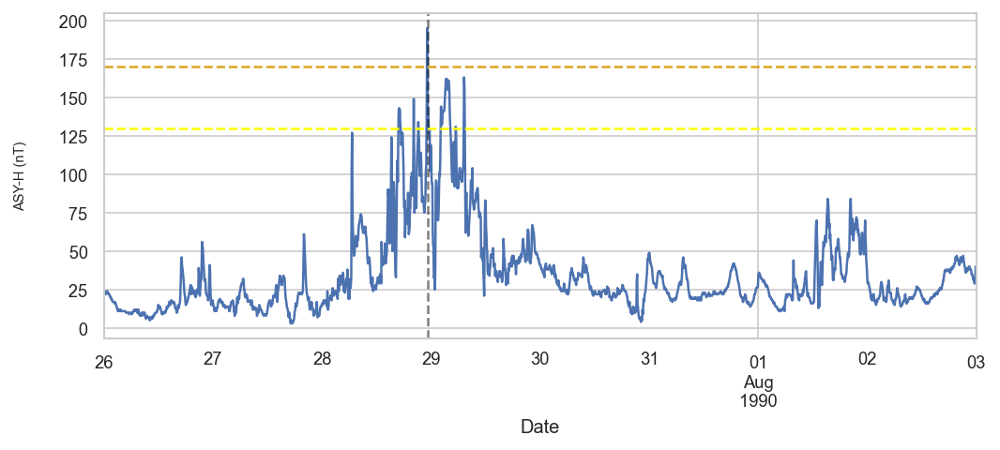

Plotting storm 78
Start date        1990-10-08 00:00:00
End date          1990-10-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         171
classification               MODERATE
Name: 78, dtype: object
Maximum ASY-H value 171 at: 1990-10-10 09:40:00


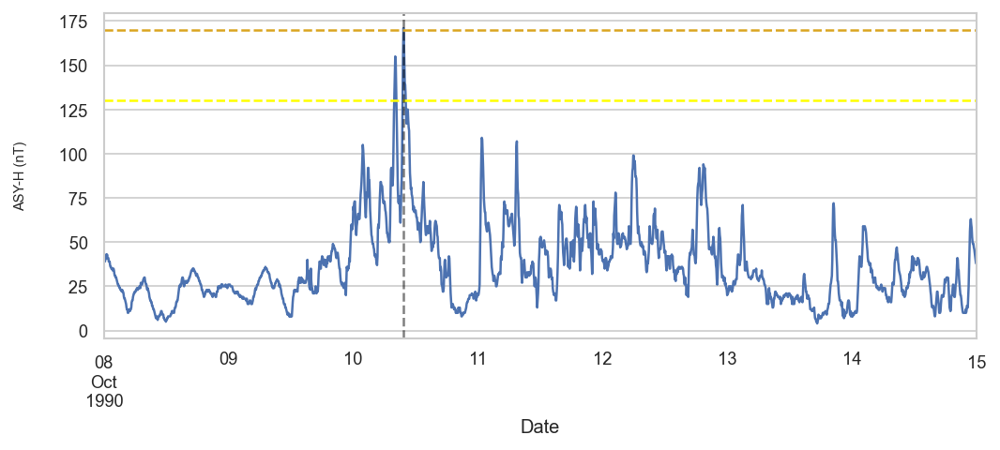

Plotting storm 80
Start date        1990-11-25 00:00:00
End date          1990-12-02 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         176
classification               MODERATE
Name: 80, dtype: object
Maximum ASY-H value 176 at: 1990-11-27 17:10:00


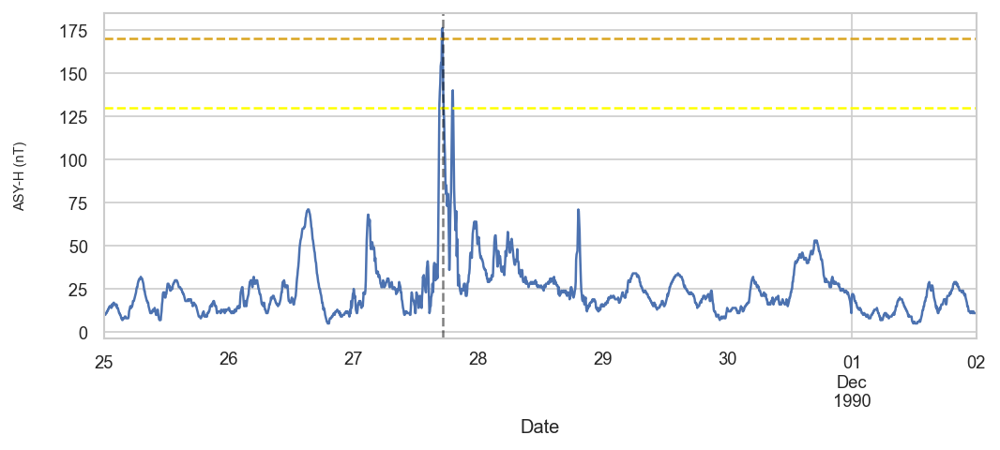

Plotting storm 85
Start date        1991-08-28 00:00:00
End date          1991-09-06 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         179
classification               MODERATE
Name: 85, dtype: object
Maximum ASY-H value 179 at: 1991-08-30 13:05:00


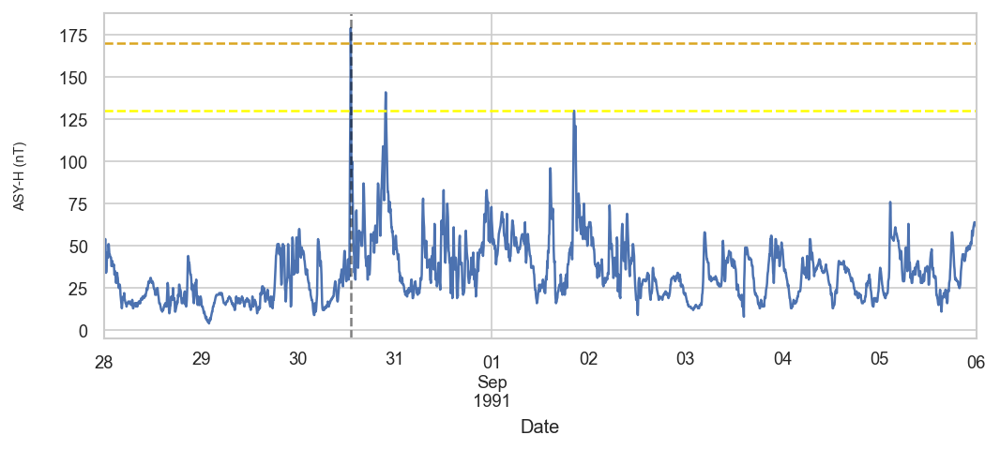

Plotting storm 86
Start date        1991-09-29 00:00:00
End date          1991-10-07 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         189
classification               MODERATE
Name: 86, dtype: object
Maximum ASY-H value 189 at: 1991-10-01 21:45:00


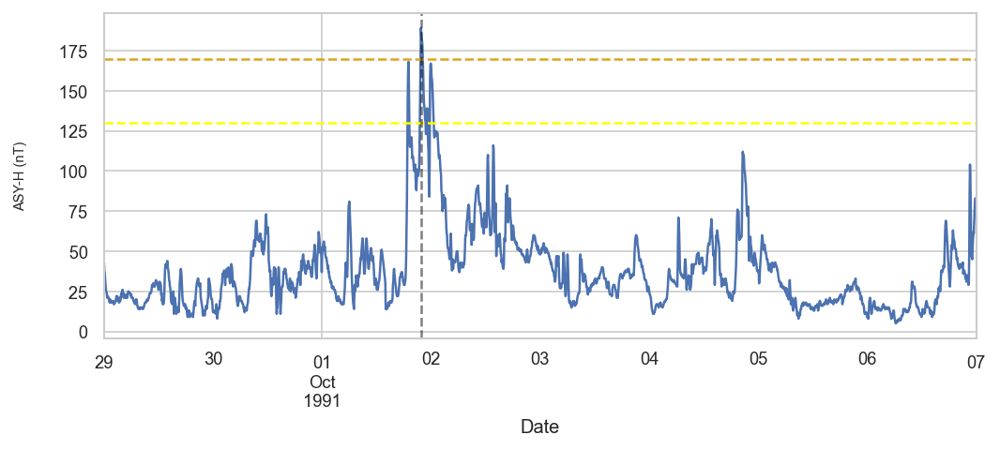

Plotting storm 88
Start date        1991-11-17 00:00:00
End date          1991-11-26 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         207
classification               MODERATE
Name: 88, dtype: object
Maximum ASY-H value 207 at: 1991-11-21 17:10:00


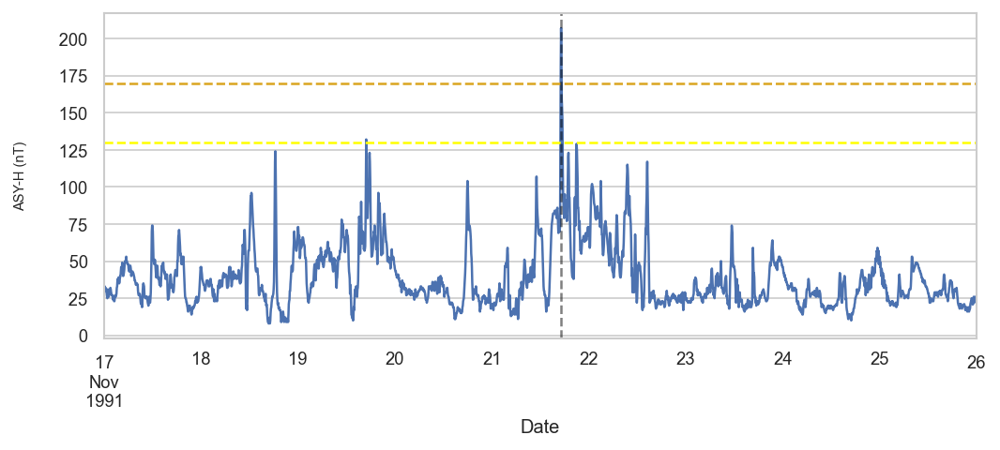

Plotting storm 90
Start date        1992-02-01 00:00:00
End date          1992-02-13 00:00:00
TD                   12 days 00:00:00
Max ASY-H                         287
classification               MODERATE
Name: 90, dtype: object
Maximum ASY-H value 287 at: 1992-02-08 15:00:00


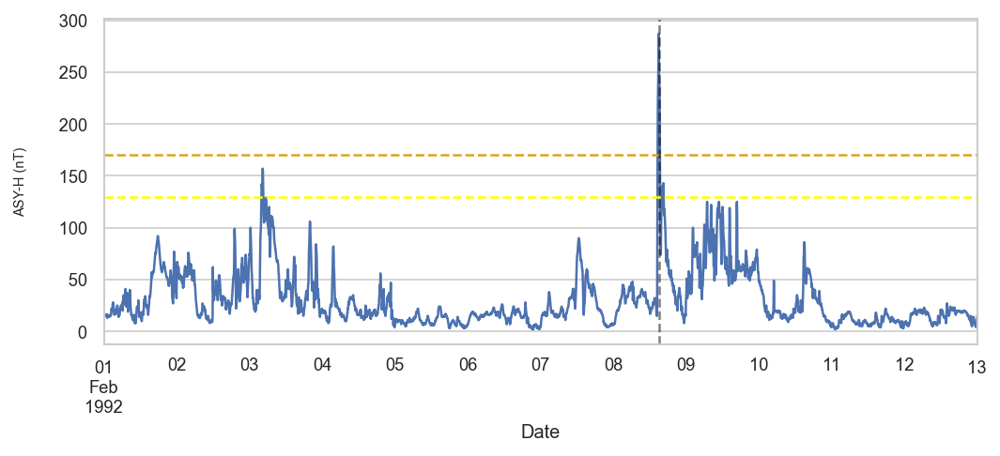

Plotting storm 91
Start date        1992-02-18 00:00:00
End date          1992-03-03 00:00:00
TD                   14 days 00:00:00
Max ASY-H                         238
classification               MODERATE
Name: 91, dtype: object
Maximum ASY-H value 238 at: 1992-02-26 17:30:00


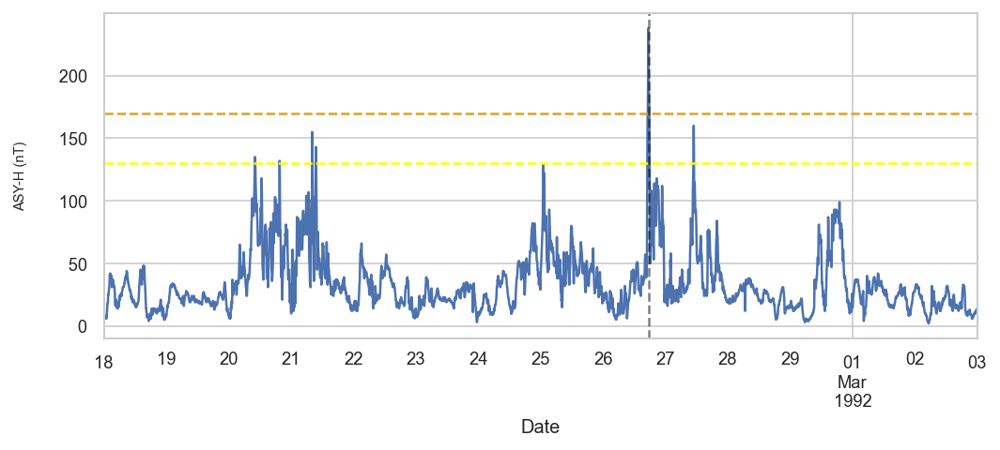

Plotting storm 93
Start date        1992-06-10 00:00:00
End date          1992-06-17 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         172
classification               MODERATE
Name: 93, dtype: object
Maximum ASY-H value 172 at: 1992-06-12 13:45:00


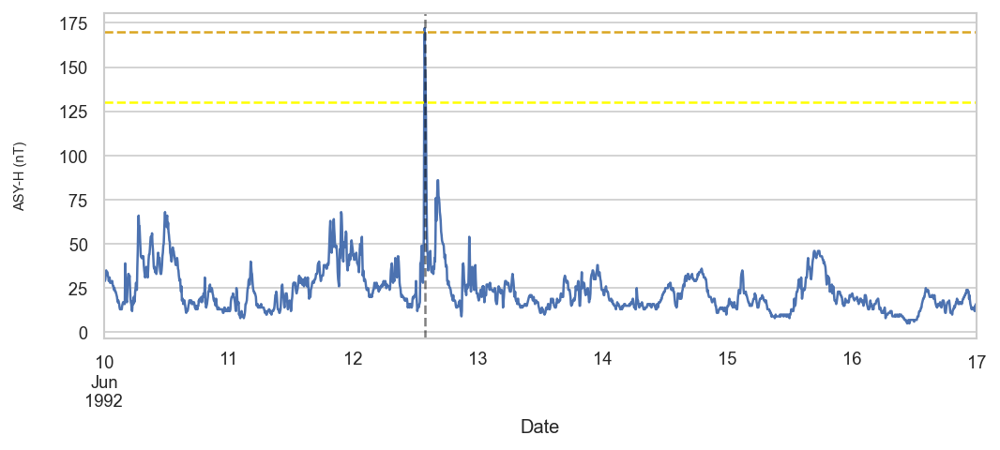

Plotting storm 95
Start date        1992-09-07 00:00:00
End date          1992-09-22 00:00:00
TD                   15 days 00:00:00
Max ASY-H                         198
classification               MODERATE
Name: 95, dtype: object
Maximum ASY-H value 198 at: 1992-09-09 12:40:00


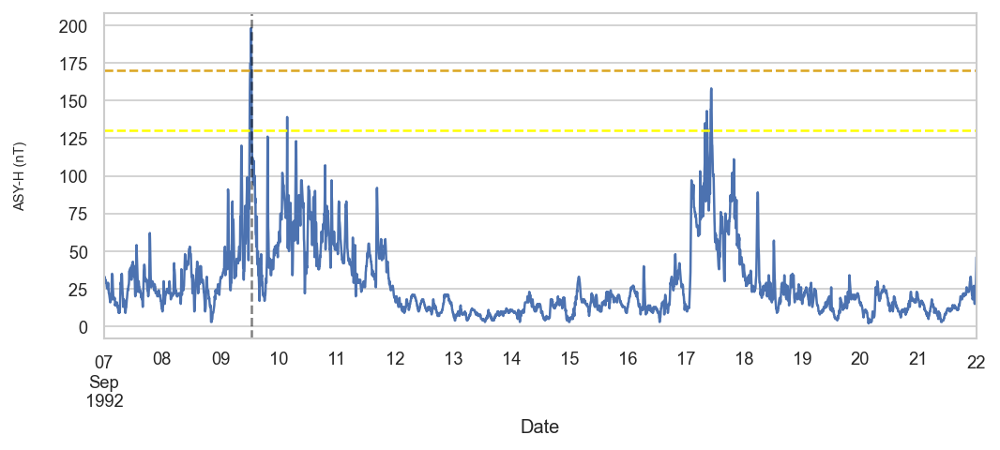

Plotting storm 96
Start date        1992-09-27 00:00:00
End date          1992-10-04 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         173
classification               MODERATE
Name: 96, dtype: object
Maximum ASY-H value 173 at: 1992-09-29 09:30:00


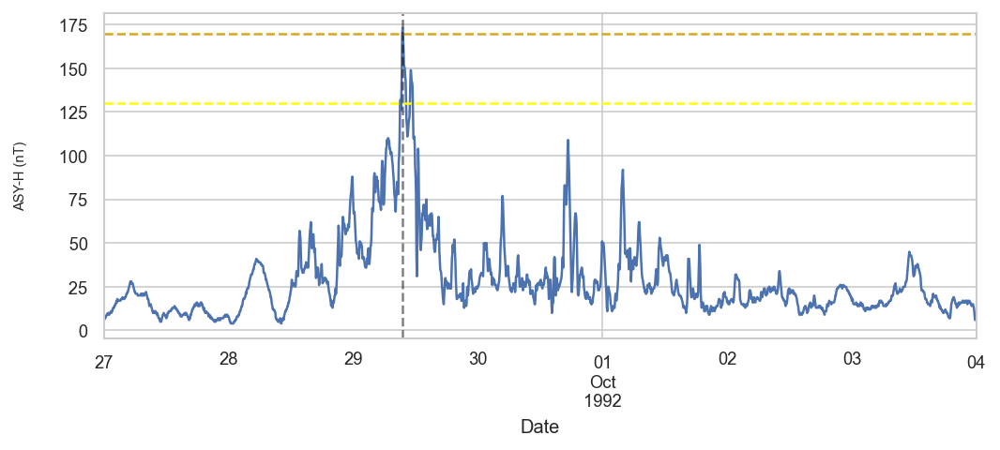

Plotting storm 106
Start date        1993-11-29 00:00:00
End date          1993-12-13 00:00:00
TD                   14 days 00:00:00
Max ASY-H                         173
classification               MODERATE
Name: 106, dtype: object
Maximum ASY-H value 173 at: 1993-12-08 01:05:00


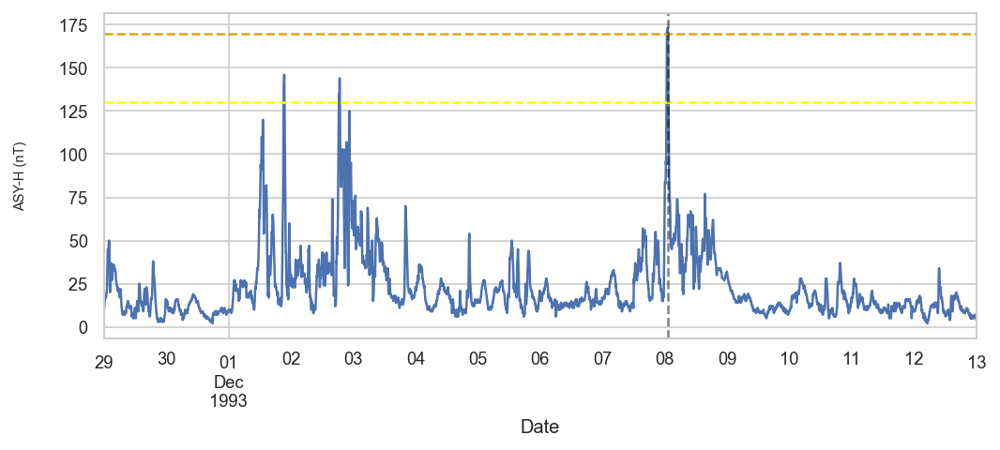

Plotting storm 107
Start date        1994-02-04 00:00:00
End date          1994-02-18 00:00:00
TD                   14 days 00:00:00
Max ASY-H                         221
classification               MODERATE
Name: 107, dtype: object
Maximum ASY-H value 221 at: 1994-02-06 21:15:00


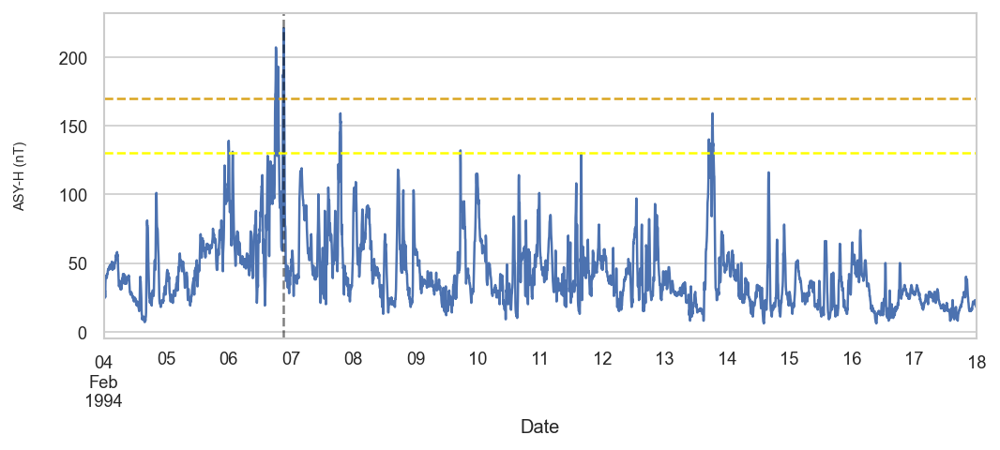

Plotting storm 108
Start date        1994-02-19 00:00:00
End date          1994-02-27 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         225
classification               MODERATE
Name: 108, dtype: object
Maximum ASY-H value 225 at: 1994-02-22 00:55:00


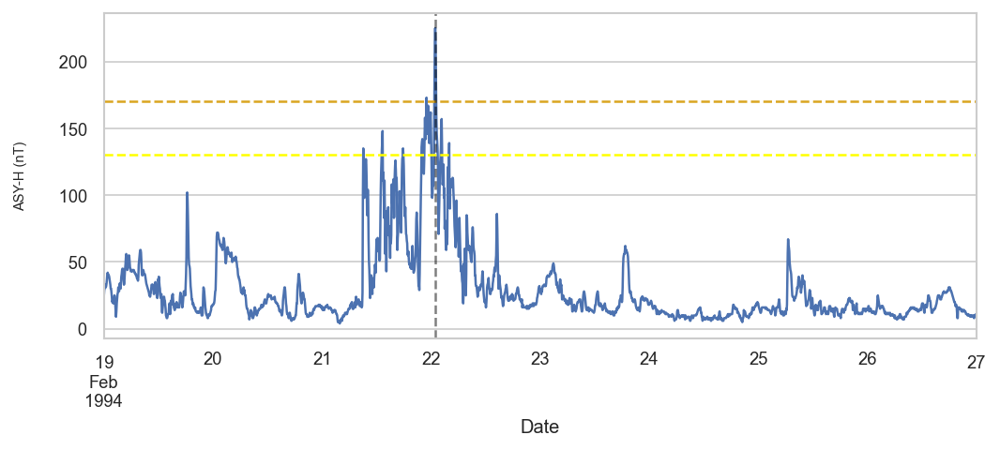

Plotting storm 111
Start date        1994-04-01 00:00:00
End date          1994-04-22 00:00:00
TD                   21 days 00:00:00
Max ASY-H                         272
classification               MODERATE
Name: 111, dtype: object
Maximum ASY-H value 272 at: 1994-04-17 08:40:00


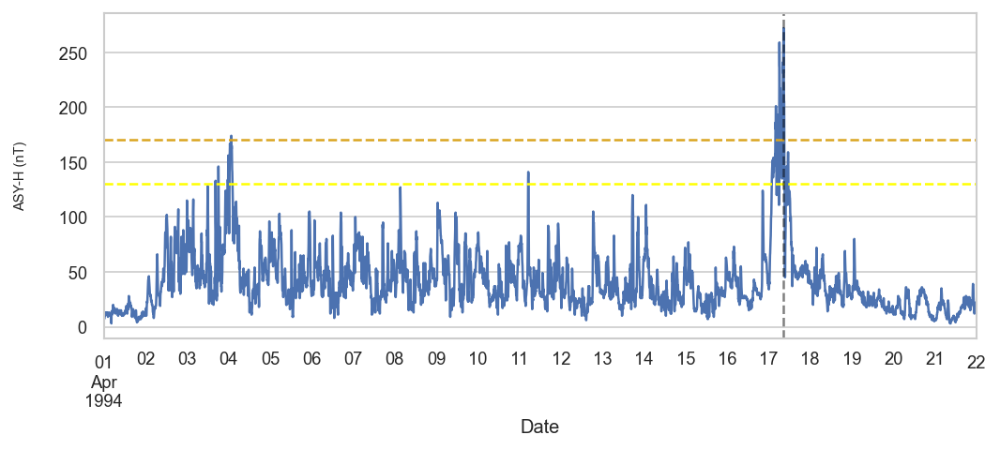

Plotting storm 115
Start date        1994-10-27 00:00:00
End date          1994-11-04 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         180
classification               MODERATE
Name: 115, dtype: object
Maximum ASY-H value 180 at: 1994-10-29 11:45:00


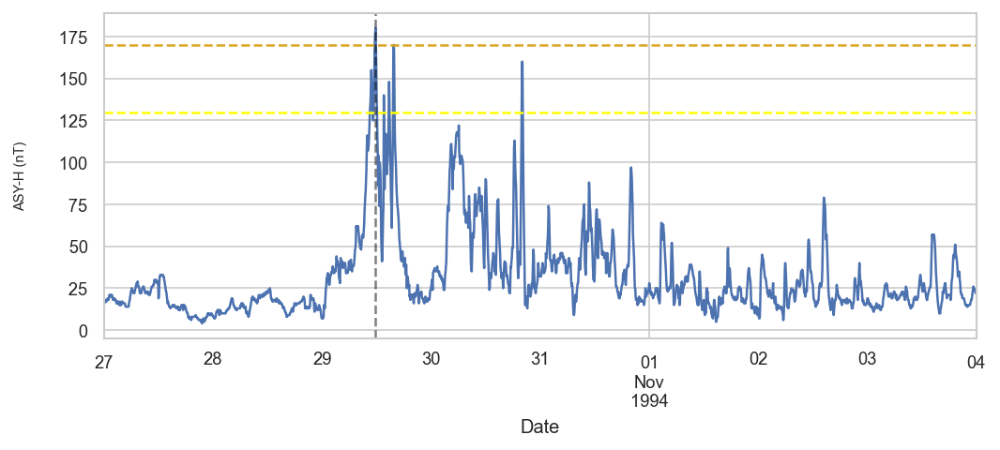

Plotting storm 116
Start date        1994-11-24 00:00:00
End date          1994-12-01 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         190
classification               MODERATE
Name: 116, dtype: object
Maximum ASY-H value 190 at: 1994-11-26 10:20:00


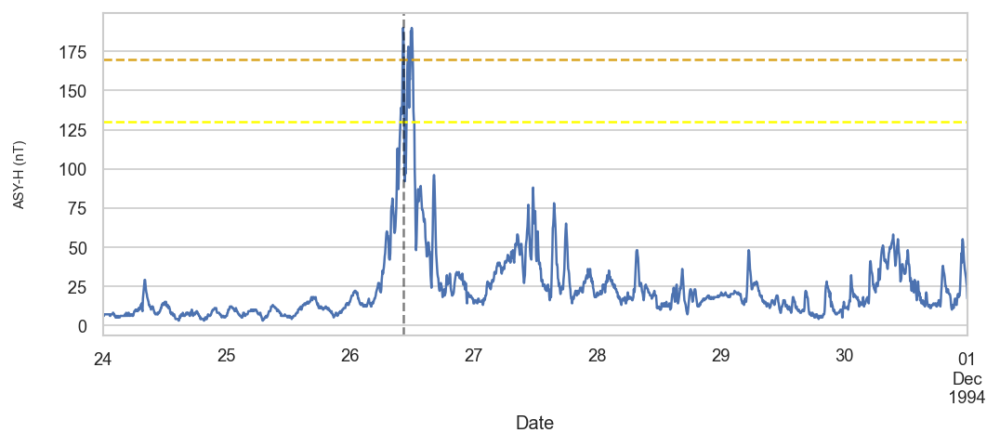

Plotting storm 120
Start date        1995-04-05 00:00:00
End date          1995-04-12 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         254
classification               MODERATE
Name: 120, dtype: object
Maximum ASY-H value 254 at: 1995-04-07 19:00:00


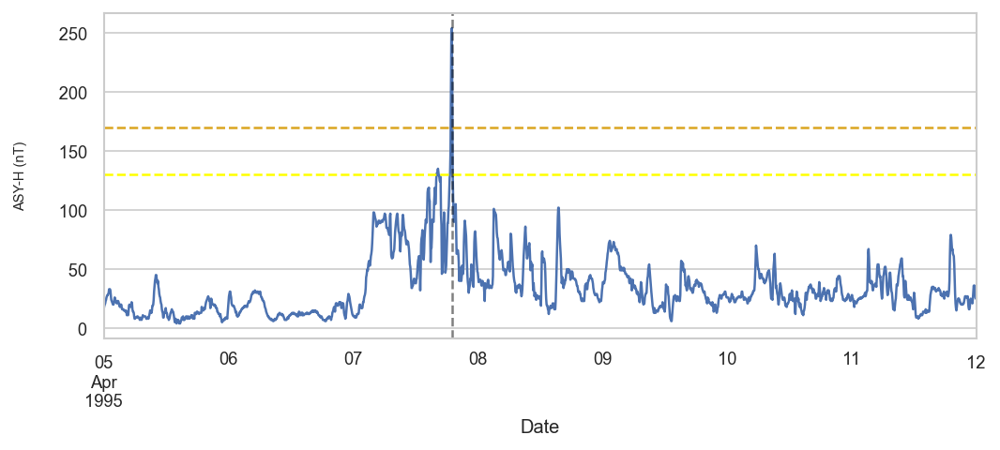

Plotting storm 127
Start date        1996-04-12 00:00:00
End date          1996-04-19 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         183
classification               MODERATE
Name: 127, dtype: object
Maximum ASY-H value 183 at: 1996-04-14 22:30:00


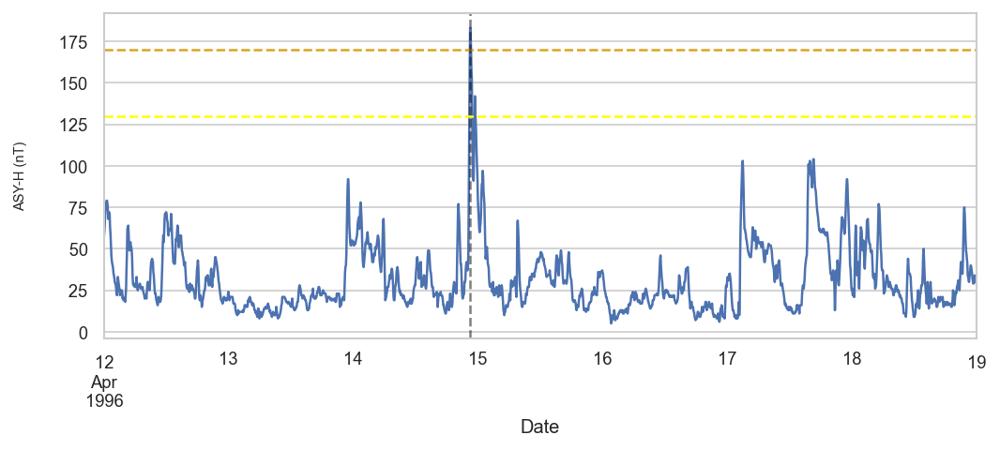

Plotting storm 129
Start date        1996-09-24 00:00:00
End date          1996-10-01 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         172
classification               MODERATE
Name: 129, dtype: object
Maximum ASY-H value 172 at: 1996-09-26 19:40:00


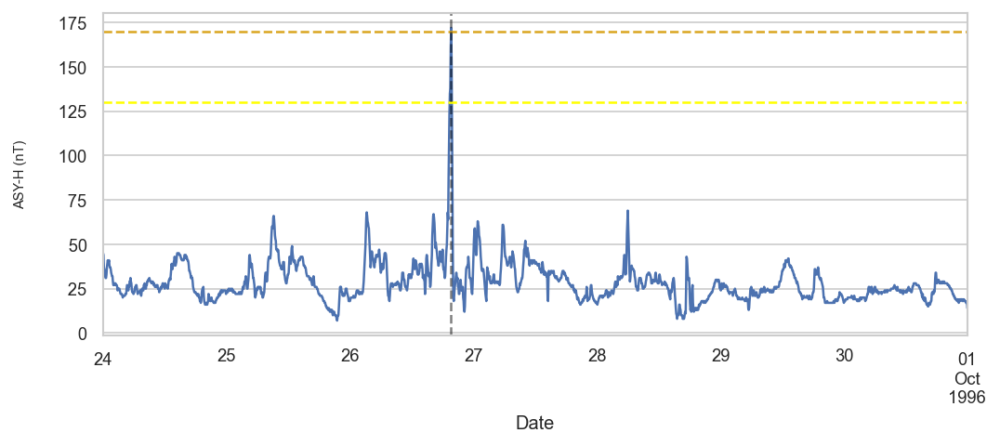

Plotting storm 141
Start date        1998-02-15 00:00:00
End date          1998-02-23 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         188
classification               MODERATE
Name: 141, dtype: object
Maximum ASY-H value 188 at: 1998-02-18 00:50:00


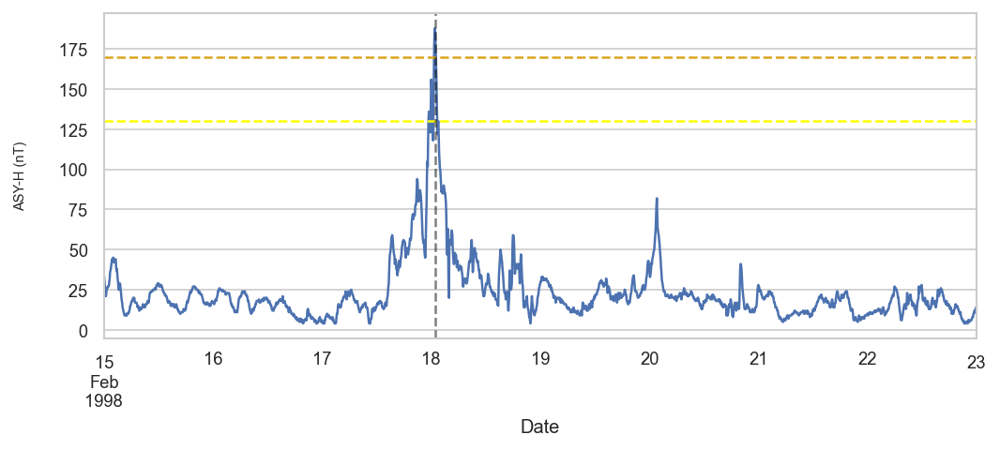

Plotting storm 142
Start date        1998-03-08 00:00:00
End date          1998-03-15 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         255
classification               MODERATE
Name: 142, dtype: object
Maximum ASY-H value 255 at: 1998-03-10 18:15:00


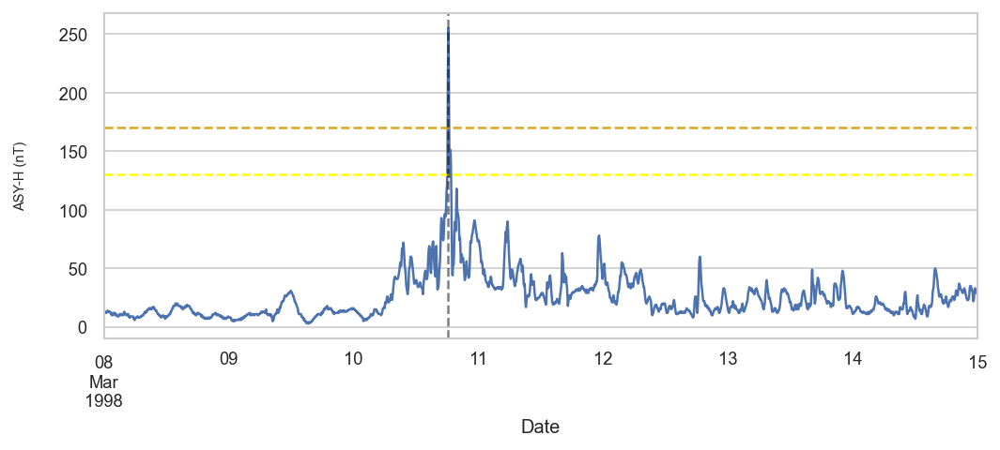

Plotting storm 147
Start date        1998-08-25 00:00:00
End date          1998-09-01 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         202
classification               MODERATE
Name: 147, dtype: object
Maximum ASY-H value 202 at: 1998-08-27 08:25:00


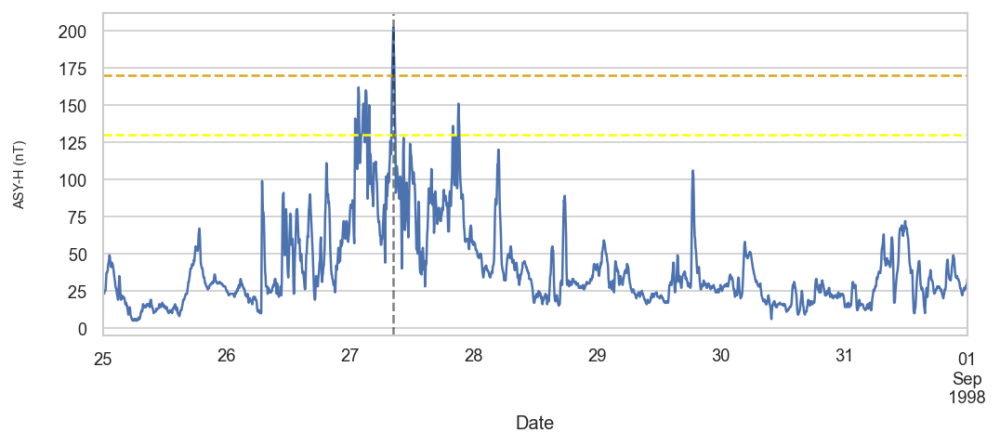

Plotting storm 151
Start date        1998-11-06 00:00:00
End date          1998-11-19 00:00:00
TD                   13 days 00:00:00
Max ASY-H                         196
classification               MODERATE
Name: 151, dtype: object
Maximum ASY-H value 196 at: 1998-11-08 06:00:00


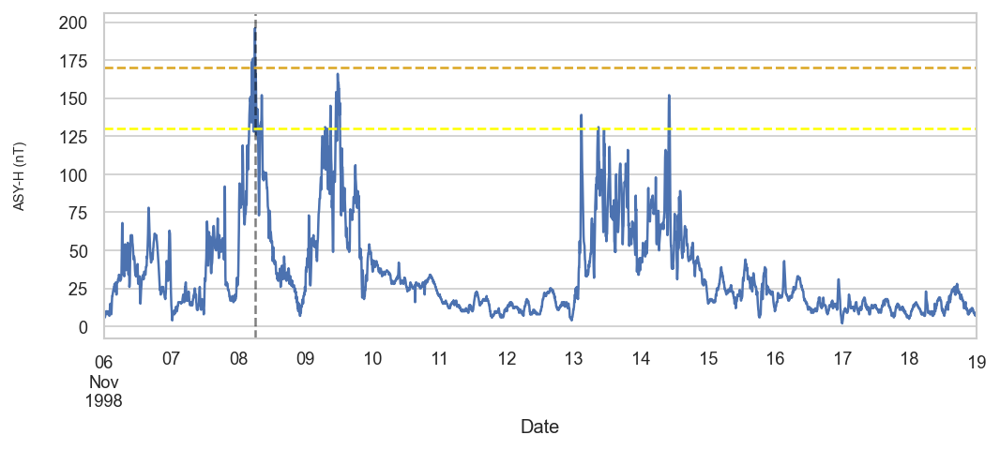

Plotting storm 153
Start date        1999-02-16 00:00:00
End date          1999-02-24 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         246
classification               MODERATE
Name: 153, dtype: object
Maximum ASY-H value 246 at: 1999-02-18 10:40:00


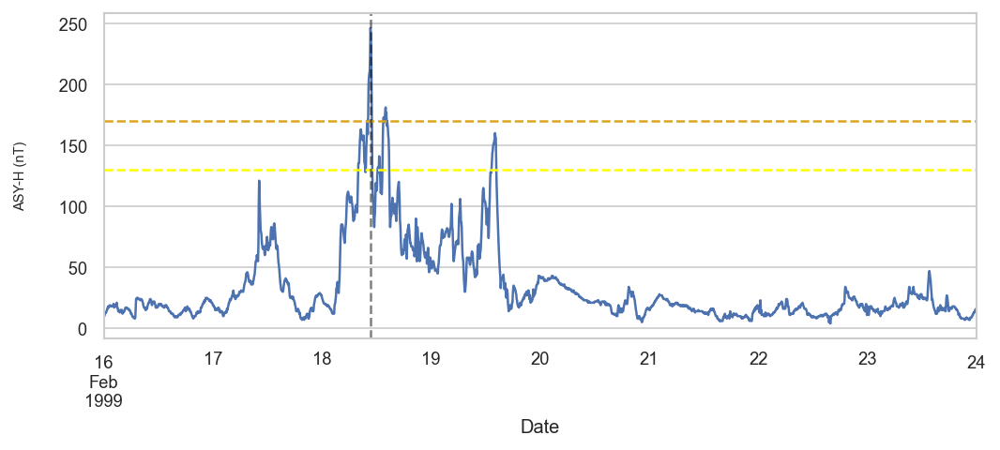

Plotting storm 159
Start date        1999-10-20 00:00:00
End date          1999-10-27 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         214
classification               MODERATE
Name: 159, dtype: object
Maximum ASY-H value 214 at: 1999-10-22 07:25:00


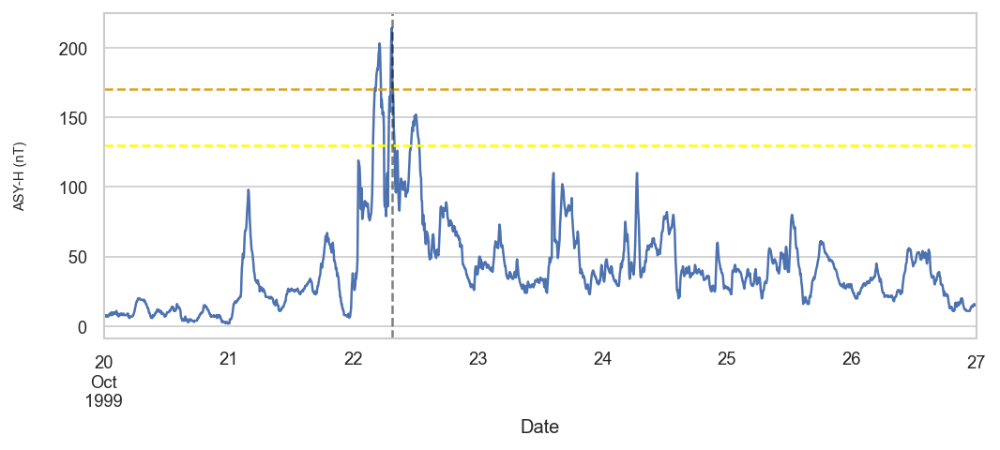

Plotting storm 161
Start date        2000-02-10 00:00:00
End date          2000-02-19 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         176
classification               MODERATE
Name: 161, dtype: object
Maximum ASY-H value 176 at: 2000-02-12 12:05:00


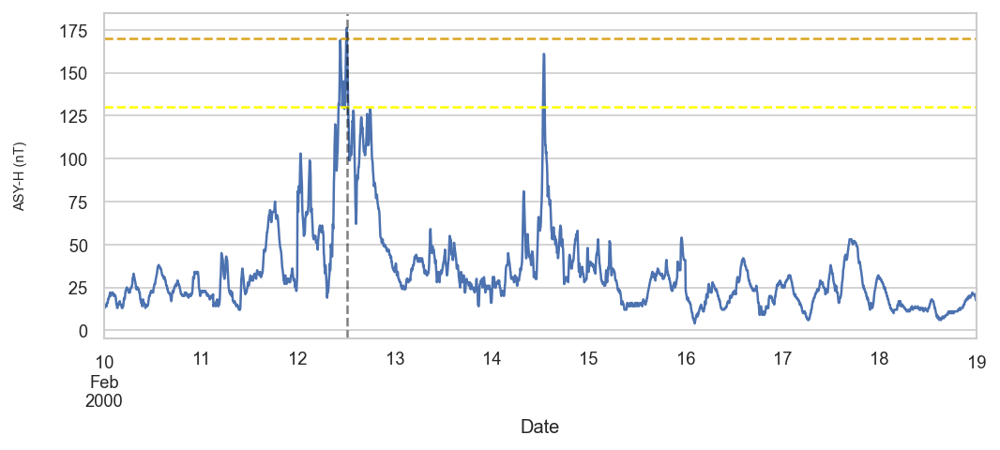

Plotting storm 163
Start date        2000-05-22 00:00:00
End date          2000-05-29 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         225
classification               MODERATE
Name: 163, dtype: object
Maximum ASY-H value 225 at: 2000-05-24 03:30:00


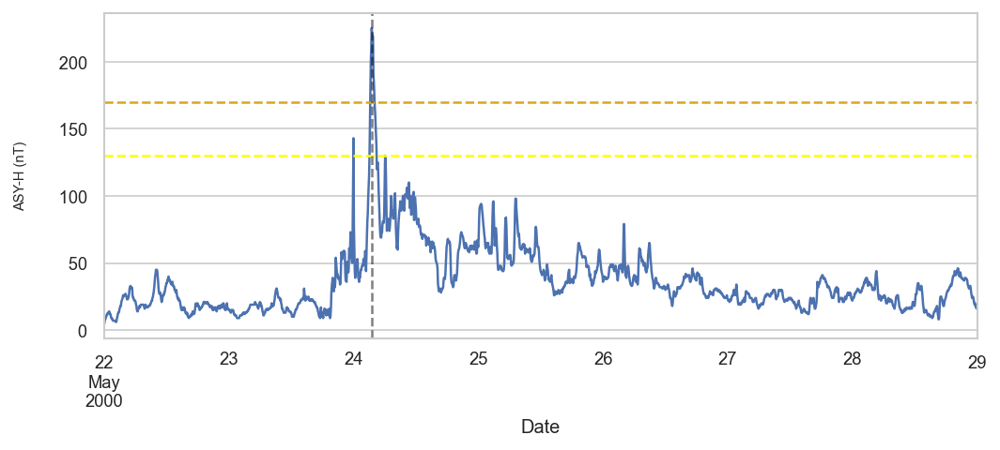

Plotting storm 166
Start date        2000-08-10 00:00:00
End date          2000-08-17 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         206
classification               MODERATE
Name: 166, dtype: object
Maximum ASY-H value 206 at: 2000-08-12 03:40:00


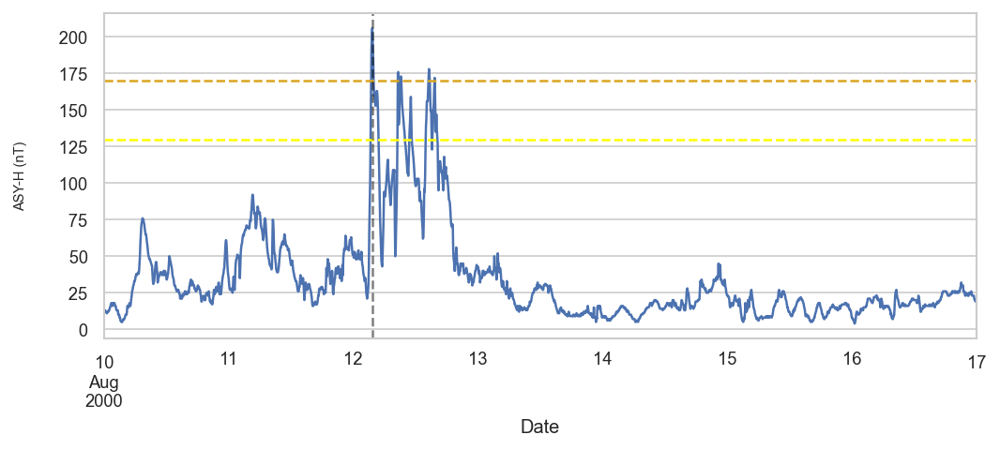

Plotting storm 167
Start date        2000-09-15 00:00:00
End date          2000-09-23 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         219
classification               MODERATE
Name: 167, dtype: object
Maximum ASY-H value 219 at: 2000-09-17 22:30:00


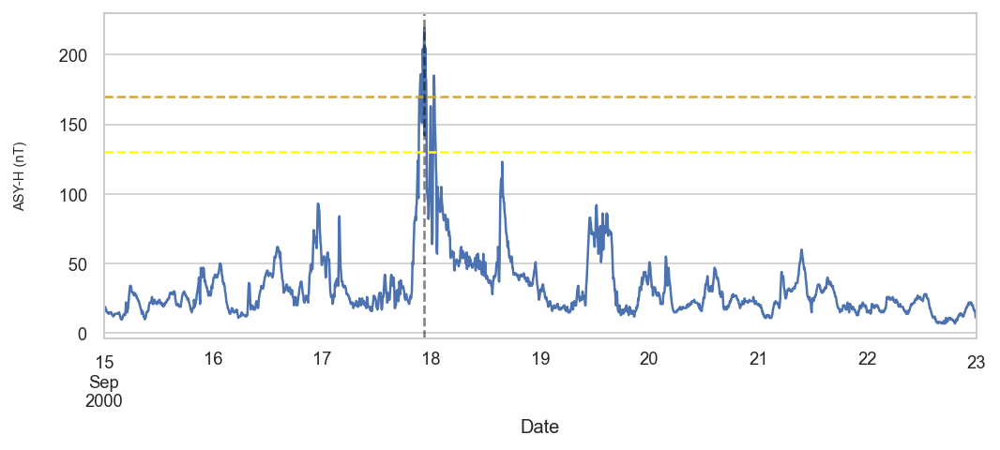

Plotting storm 168
Start date        2000-10-03 00:00:00
End date          2000-10-10 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         258
classification               MODERATE
Name: 168, dtype: object
Maximum ASY-H value 258 at: 2000-10-05 12:15:00


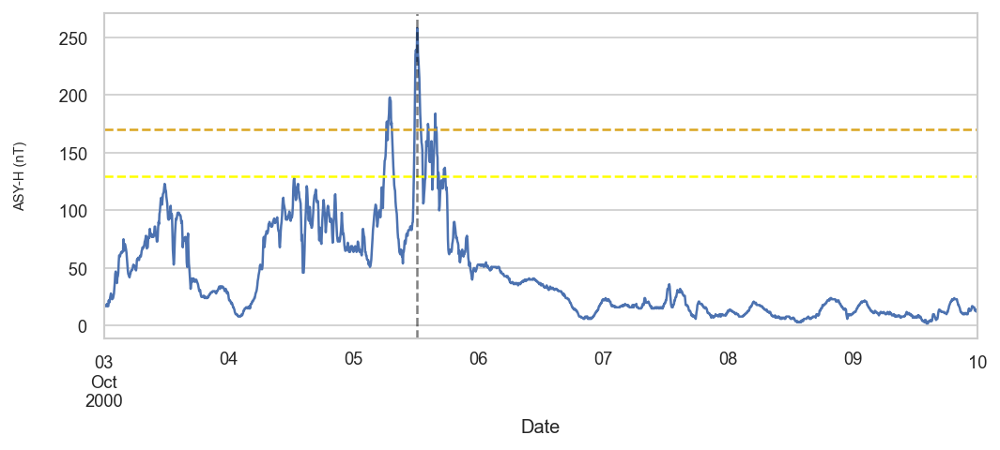

Plotting storm 172
Start date        2001-03-18 00:00:00
End date          2001-03-25 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         225
classification               MODERATE
Name: 172, dtype: object
Maximum ASY-H value 225 at: 2001-03-20 14:15:00


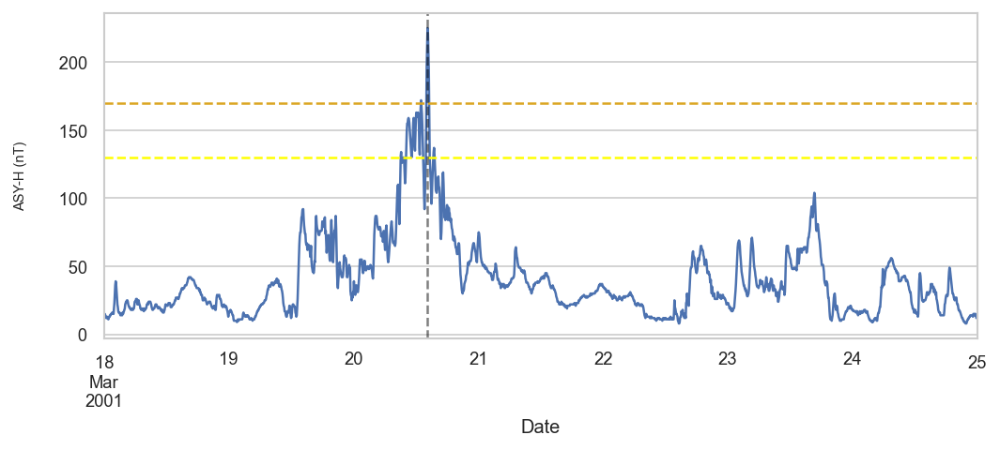

Plotting storm 176
Start date        2001-09-23 00:00:00
End date          2001-10-08 00:00:00
TD                   15 days 00:00:00
Max ASY-H                         184
classification               MODERATE
Name: 176, dtype: object
Maximum ASY-H value 184 at: 2001-10-03 11:05:00


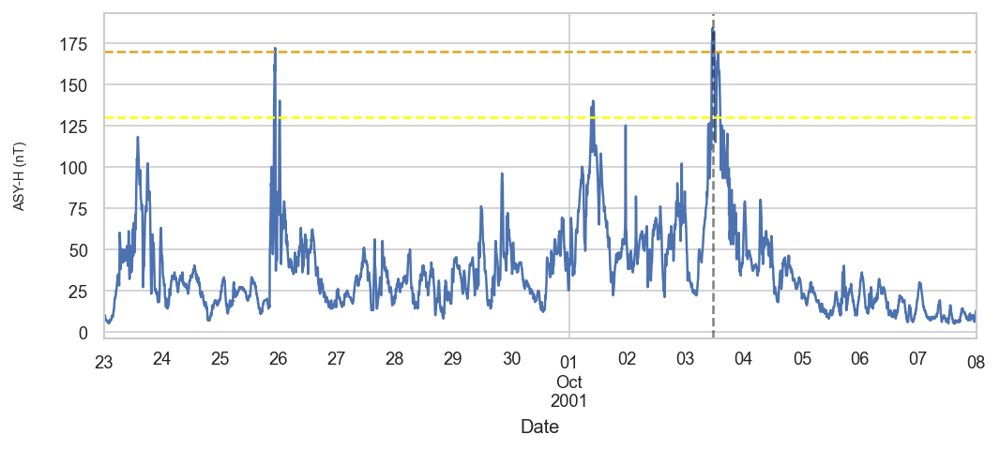

Plotting storm 178
Start date        2001-10-19 00:00:00
End date          2001-11-02 00:00:00
TD                   14 days 00:00:00
Max ASY-H                         189
classification               MODERATE
Name: 178, dtype: object
Maximum ASY-H value 189 at: 2001-10-28 10:40:00


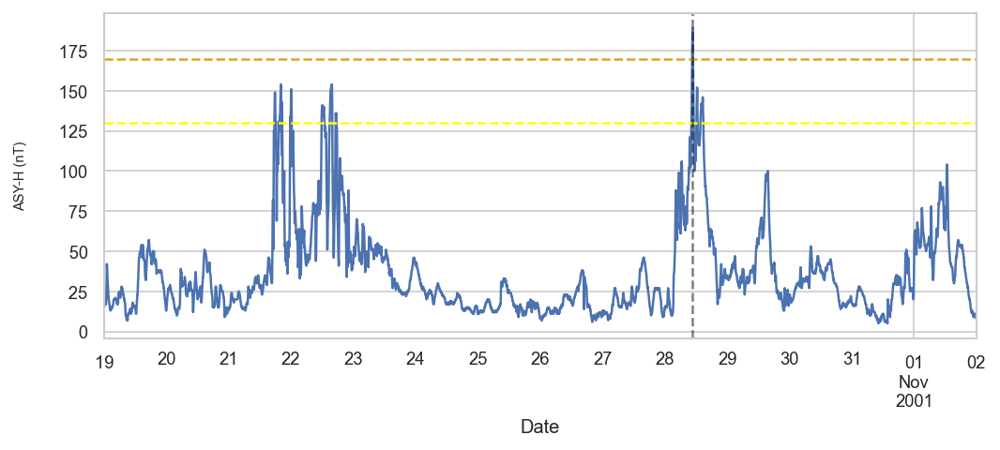

Plotting storm 181
Start date        2002-04-15 00:00:00
End date          2002-04-25 00:00:00
TD                   10 days 00:00:00
Max ASY-H                         189
classification               MODERATE
Name: 181, dtype: object
Maximum ASY-H value 189 at: 2002-04-19 13:30:00


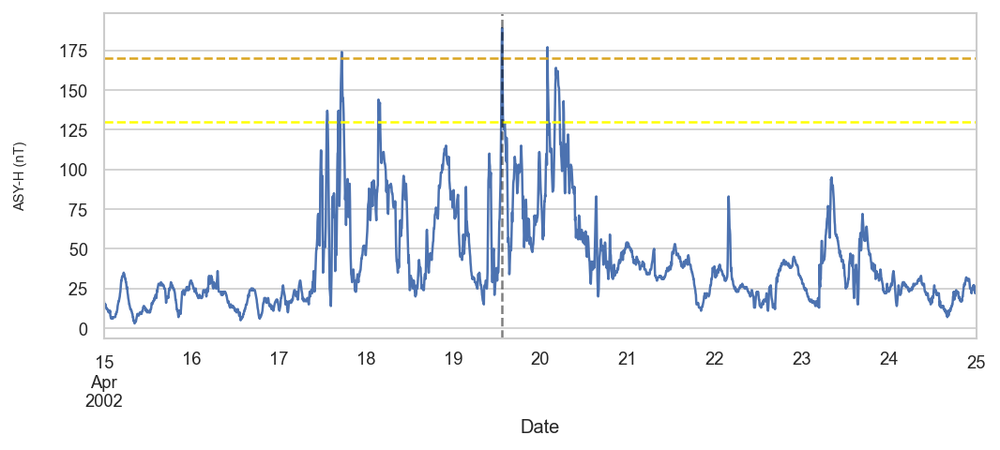

Plotting storm 183
Start date        2002-05-21 00:00:00
End date          2002-05-28 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         204
classification               MODERATE
Name: 183, dtype: object
Maximum ASY-H value 204 at: 2002-05-23 12:20:00


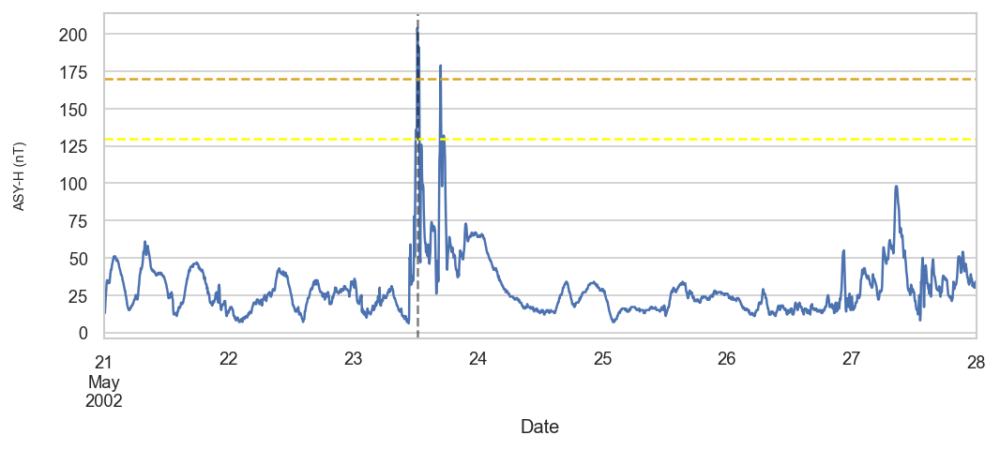

Plotting storm 185
Start date        2002-09-28 00:00:00
End date          2002-10-09 00:00:00
TD                   11 days 00:00:00
Max ASY-H                         199
classification               MODERATE
Name: 185, dtype: object
Maximum ASY-H value 199 at: 2002-10-01 11:20:00


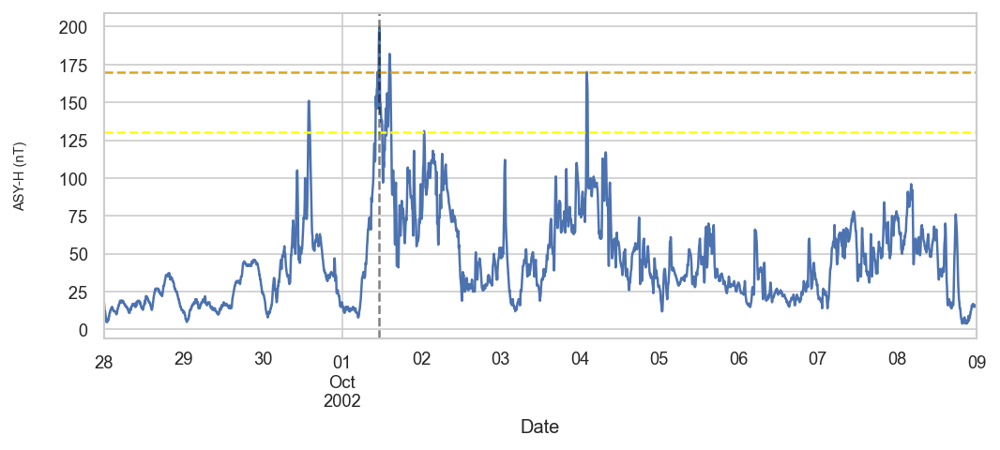

Plotting storm 192
Start date        2003-06-07 00:00:00
End date          2003-06-21 00:00:00
TD                   14 days 00:00:00
Max ASY-H                         198
classification               MODERATE
Name: 192, dtype: object
Maximum ASY-H value 198 at: 2003-06-09 21:40:00


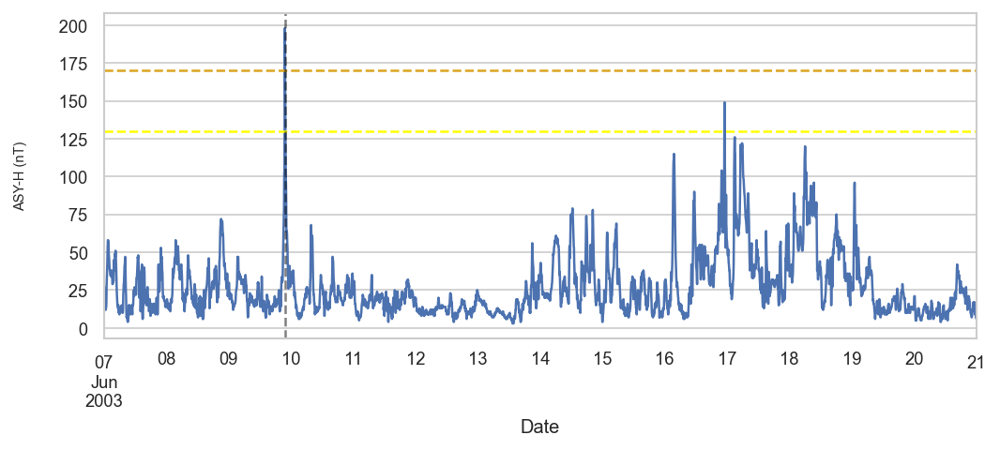

Plotting storm 194
Start date        2003-07-10 00:00:00
End date          2003-07-17 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         172
classification               MODERATE
Name: 194, dtype: object
Maximum ASY-H value 172 at: 2003-07-12 05:40:00


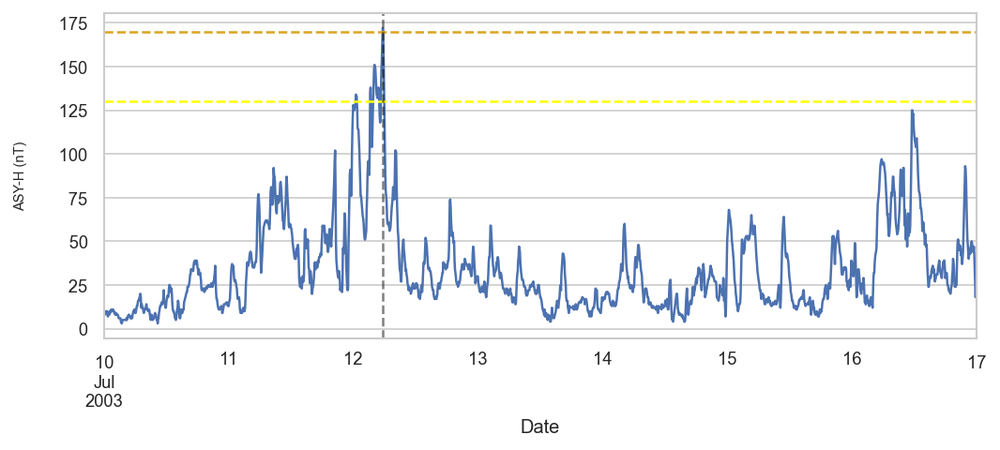

Plotting storm 197
Start date        2003-09-15 00:00:00
End date          2003-09-22 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         171
classification               MODERATE
Name: 197, dtype: object
Maximum ASY-H value 171 at: 2003-09-17 13:35:00


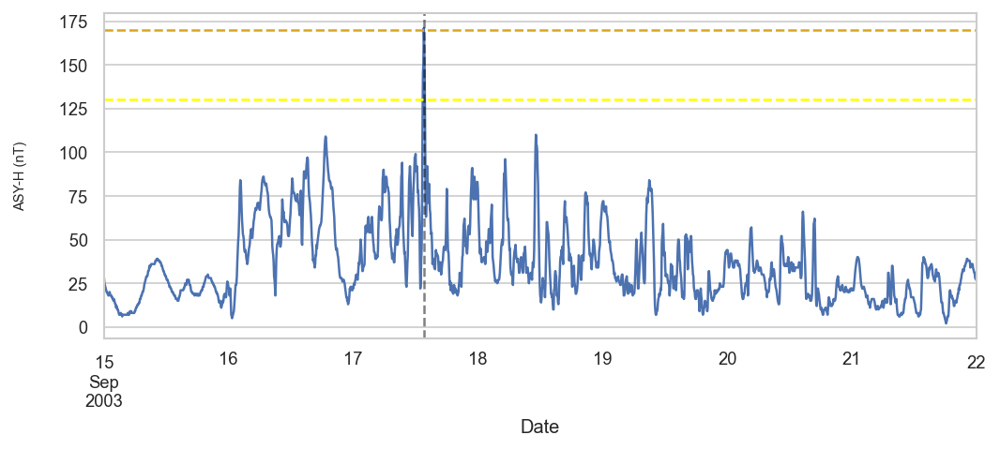

Plotting storm 207
Start date        2004-12-31 00:00:00
End date          2005-01-13 00:00:00
TD                   13 days 00:00:00
Max ASY-H                         279
classification               MODERATE
Name: 207, dtype: object
Maximum ASY-H value 279 at: 2005-01-07 23:00:00


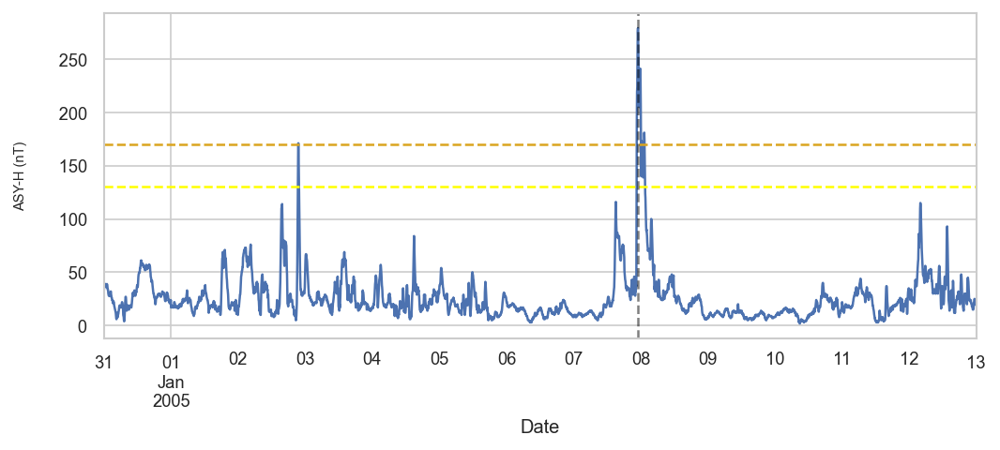

Plotting storm 210
Start date        2005-05-06 00:00:00
End date          2005-05-20 00:00:00
TD                   14 days 00:00:00
Max ASY-H                         250
classification               MODERATE
Name: 210, dtype: object
Maximum ASY-H value 250 at: 2005-05-15 08:45:00


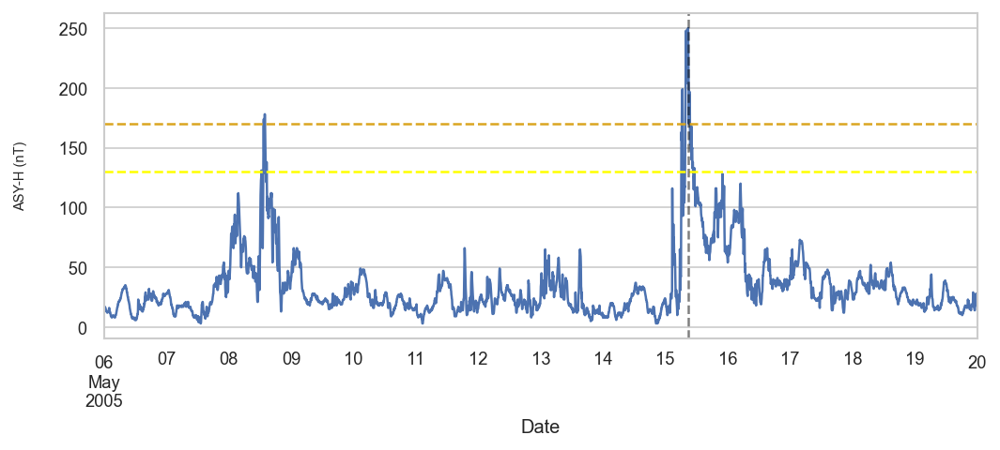

Plotting storm 211
Start date        2005-05-28 00:00:00
End date          2005-06-04 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         177
classification               MODERATE
Name: 211, dtype: object
Maximum ASY-H value 177 at: 2005-05-30 15:05:00


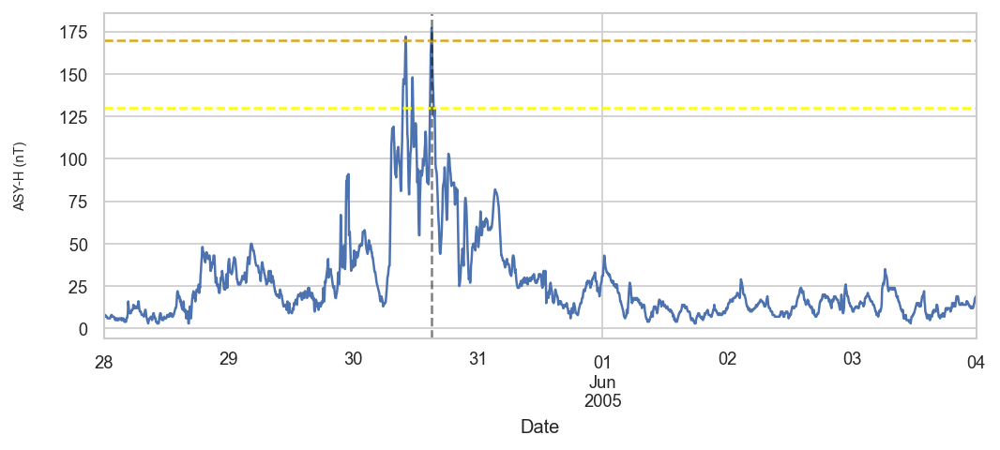

Plotting storm 214
Start date        2005-08-22 00:00:00
End date          2005-09-05 00:00:00
TD                   14 days 00:00:00
Max ASY-H                         234
classification               MODERATE
Name: 214, dtype: object
Maximum ASY-H value 234 at: 2005-08-24 10:35:00


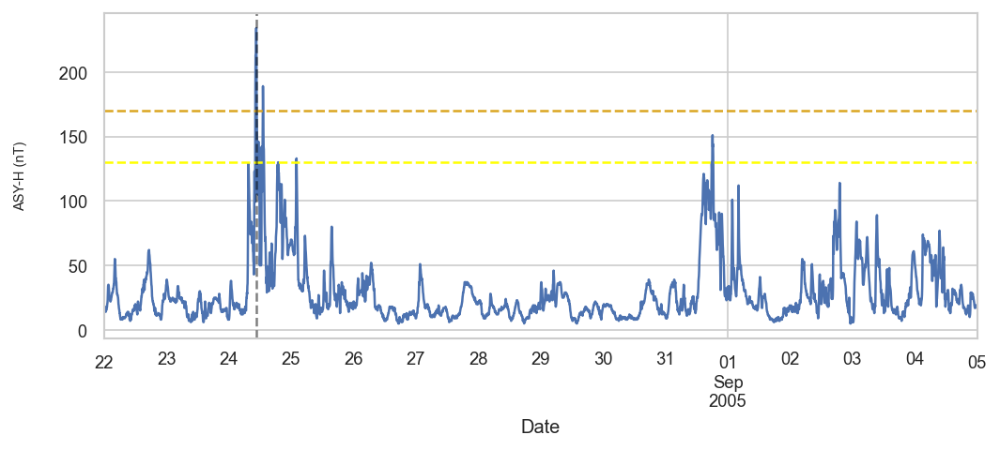

Plotting storm 215
Start date        2005-09-09 00:00:00
End date          2005-09-17 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         266
classification               MODERATE
Name: 215, dtype: object
Maximum ASY-H value 266 at: 2005-09-11 06:35:00


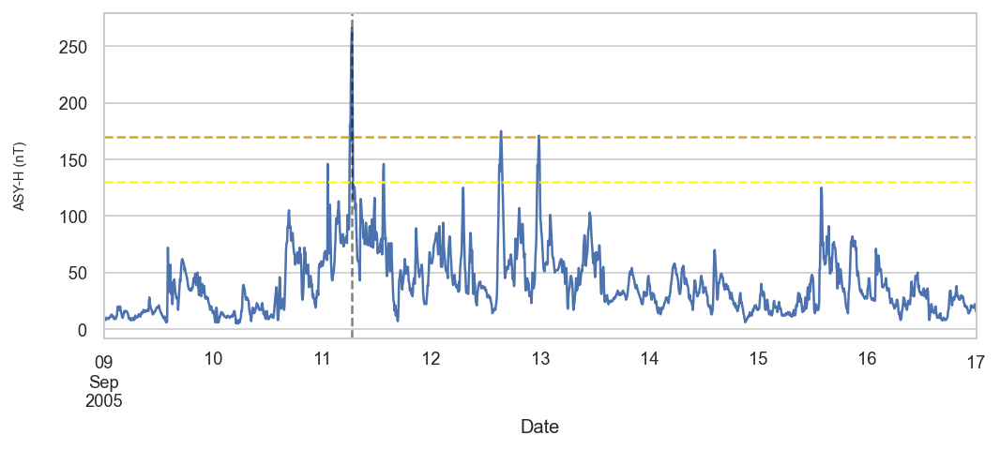

Plotting storm 221
Start date        2006-12-12 00:00:00
End date          2006-12-20 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         267
classification               MODERATE
Name: 221, dtype: object
Maximum ASY-H value 267 at: 2006-12-15 00:05:00


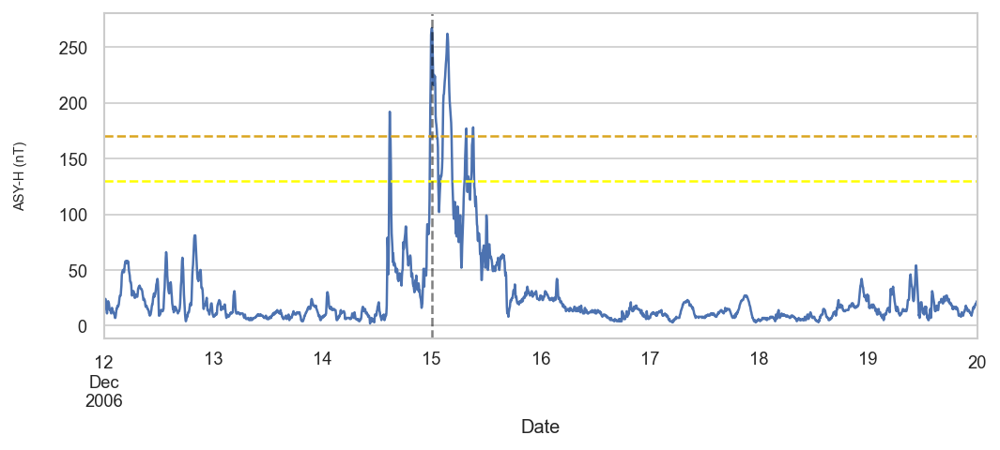

Plotting storm 229
Start date        2011-08-03 00:00:00
End date          2011-08-10 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         183
classification               MODERATE
Name: 229, dtype: object
Maximum ASY-H value 183 at: 2011-08-05 21:50:00


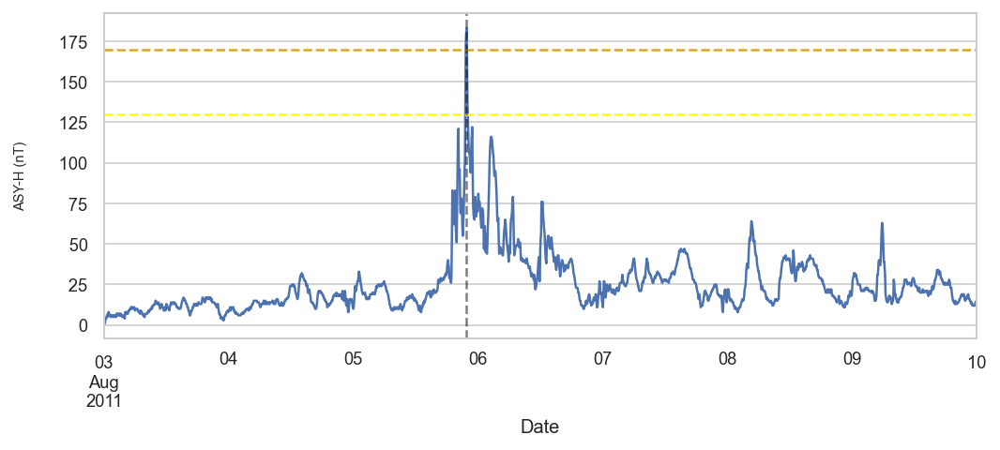

Plotting storm 233
Start date        2012-03-05 00:00:00
End date          2012-03-17 00:00:00
TD                   12 days 00:00:00
Max ASY-H                         229
classification               MODERATE
Name: 233, dtype: object
Maximum ASY-H value 229 at: 2012-03-09 09:55:00


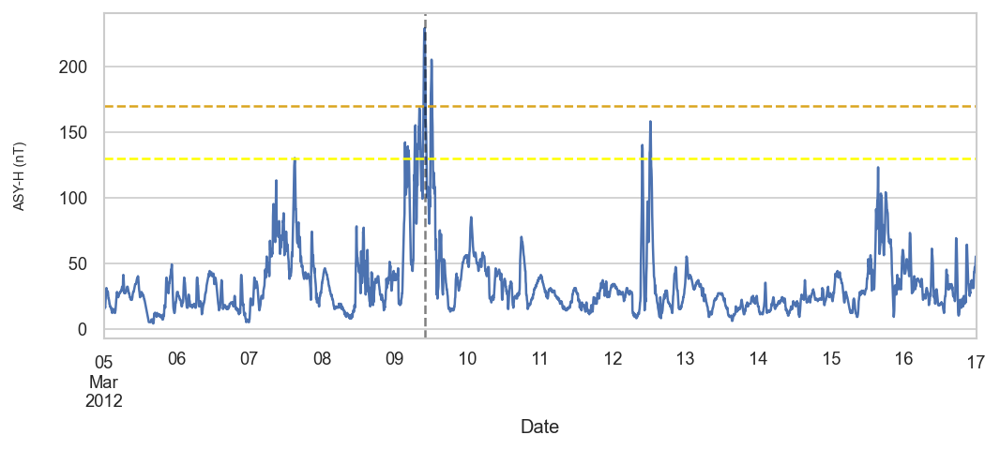

Plotting storm 235
Start date        2012-06-15 00:00:00
End date          2012-06-22 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         184
classification               MODERATE
Name: 235, dtype: object
Maximum ASY-H value 184 at: 2012-06-17 13:10:00


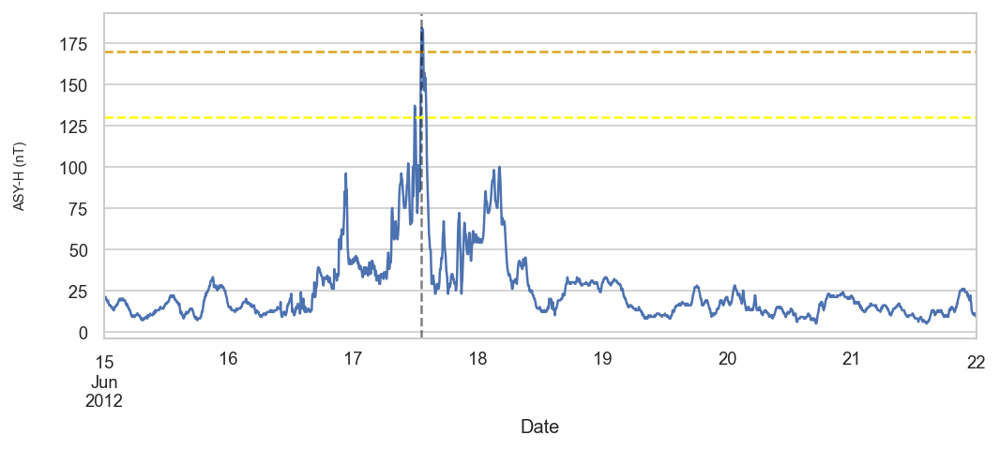

Plotting storm 239
Start date        2013-03-15 00:00:00
End date          2013-03-22 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         171
classification               MODERATE
Name: 239, dtype: object
Maximum ASY-H value 171 at: 2013-03-17 12:20:00


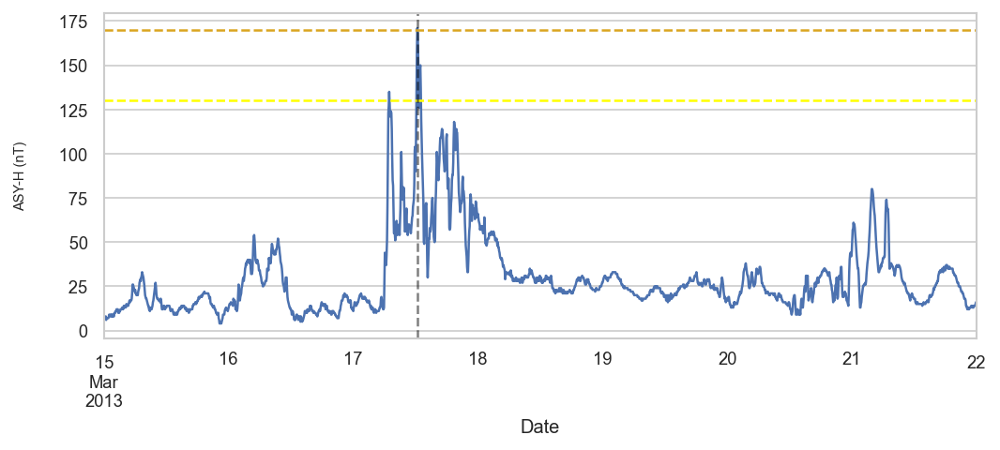

Plotting storm 242
Start date        2013-09-30 00:00:00
End date          2013-10-07 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         171
classification               MODERATE
Name: 242, dtype: object
Maximum ASY-H value 171 at: 2013-10-02 05:50:00


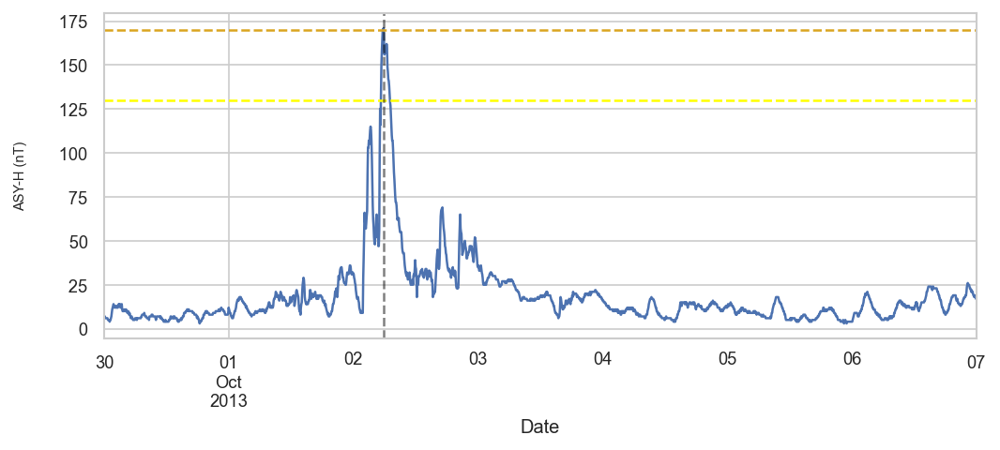

Plotting storm 244
Start date        2015-01-05 00:00:00
End date          2015-01-12 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         212
classification               MODERATE
Name: 244, dtype: object
Maximum ASY-H value 212 at: 2015-01-07 10:40:00


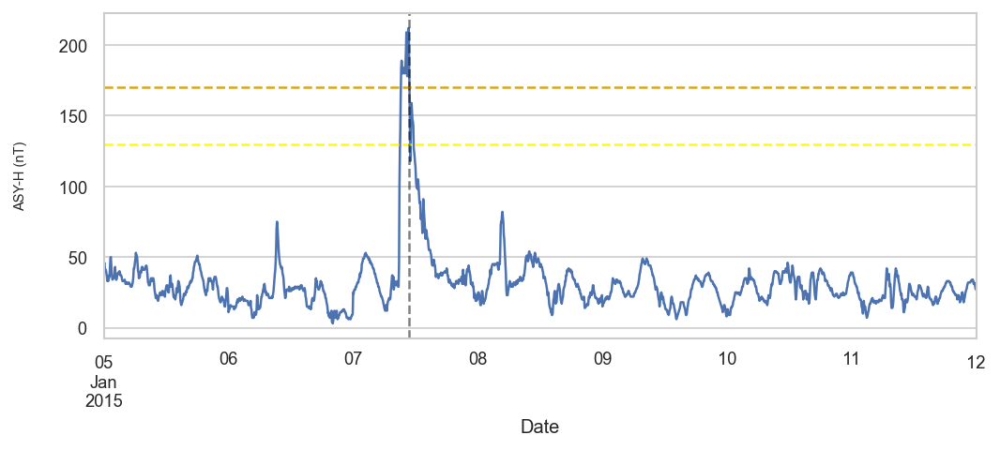

Plotting storm 245
Start date        2015-03-15 00:00:00
End date          2015-03-24 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         250
classification               MODERATE
Name: 245, dtype: object
Maximum ASY-H value 250 at: 2015-03-17 13:55:00


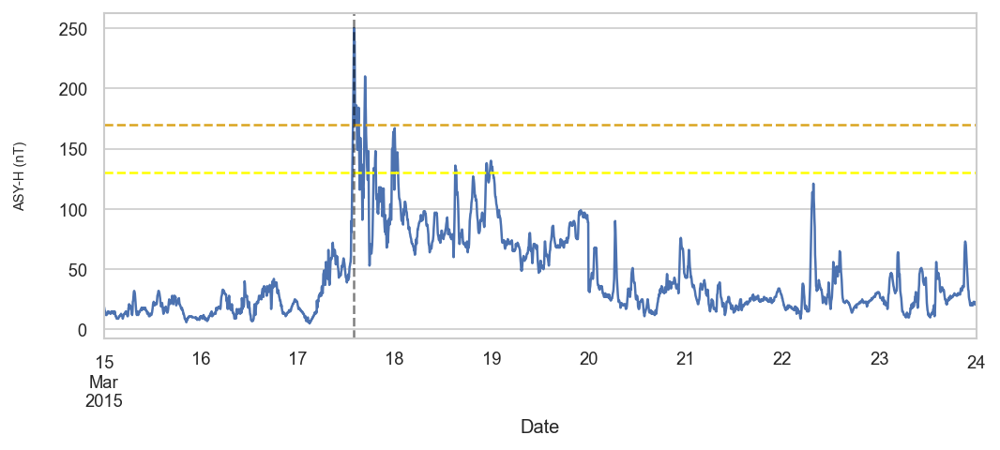

Plotting storm 247
Start date        2015-08-13 00:00:00
End date          2015-08-21 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         204
classification               MODERATE
Name: 247, dtype: object
Maximum ASY-H value 204 at: 2015-08-15 12:00:00


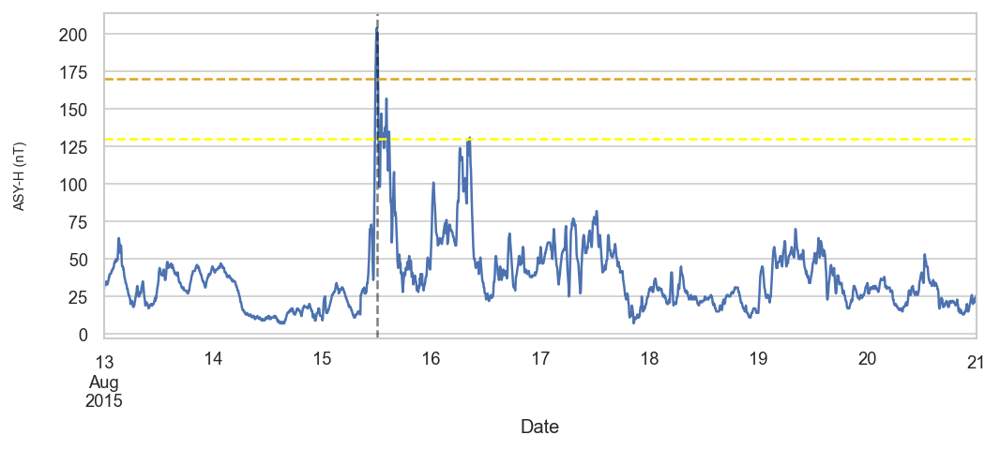

Plotting storm 249
Start date        2015-09-07 00:00:00
End date          2015-09-16 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         189
classification               MODERATE
Name: 249, dtype: object
Maximum ASY-H value 189 at: 2015-09-09 09:30:00


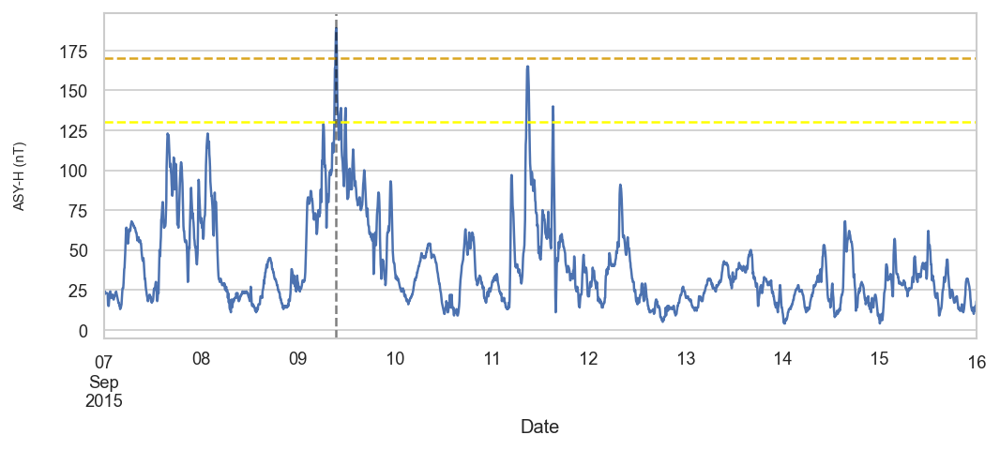

Plotting storm 251
Start date        2015-10-05 00:00:00
End date          2015-10-13 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         216
classification               MODERATE
Name: 251, dtype: object
Maximum ASY-H value 216 at: 2015-10-07 19:00:00


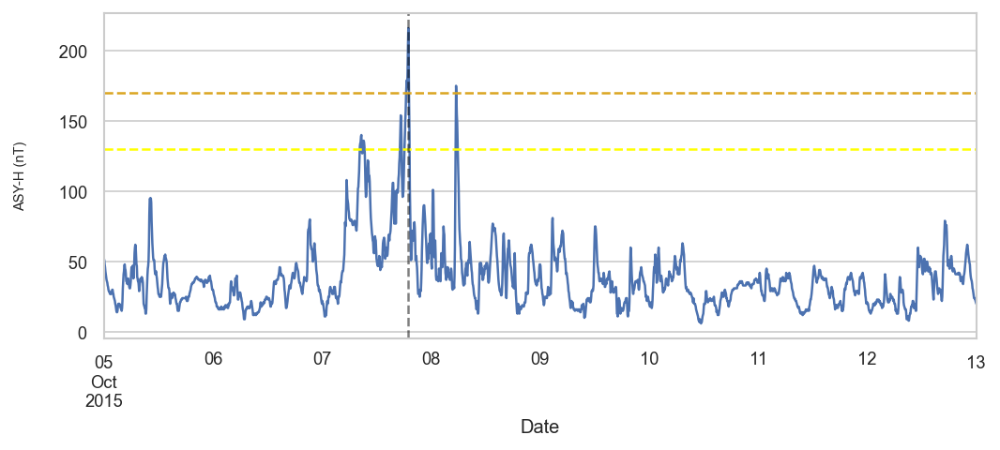

Plotting storm 260
Start date        2016-12-19 00:00:00
End date          2016-12-26 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         171
classification               MODERATE
Name: 260, dtype: object
Maximum ASY-H value 171 at: 2016-12-21 16:15:00


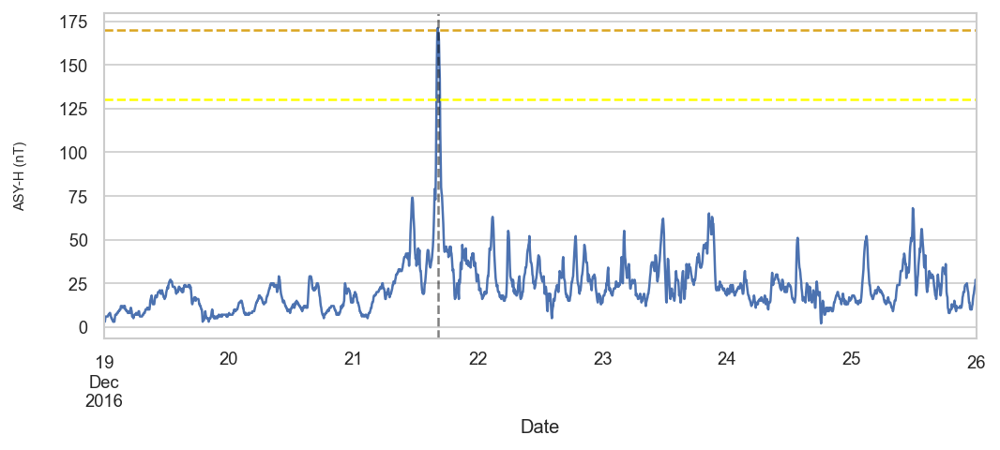

Plotting storm 263
Start date        2017-07-14 00:00:00
End date          2017-07-21 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         175
classification               MODERATE
Name: 263, dtype: object
Maximum ASY-H value 175 at: 2017-07-16 13:25:00


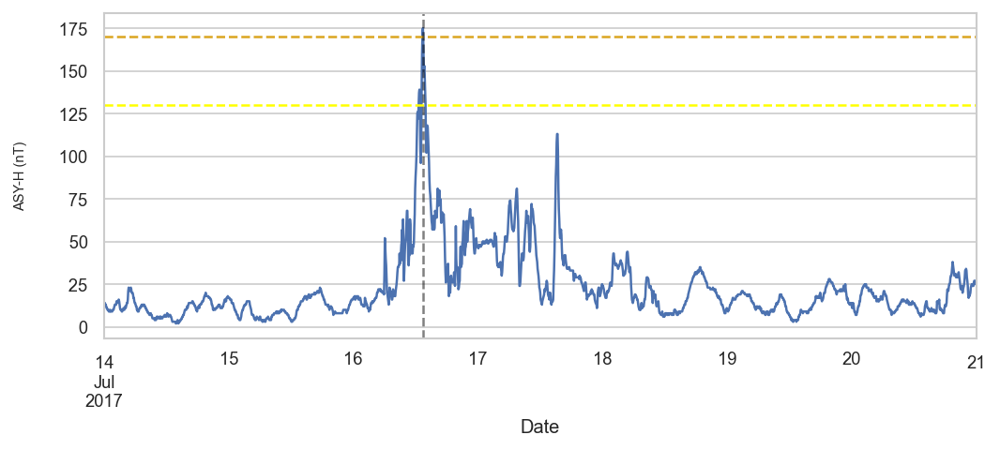

Plotting storm 264
Start date        2017-09-05 00:00:00
End date          2017-09-13 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         230
classification               MODERATE
Name: 264, dtype: object
Maximum ASY-H value 230 at: 2017-09-08 00:35:00


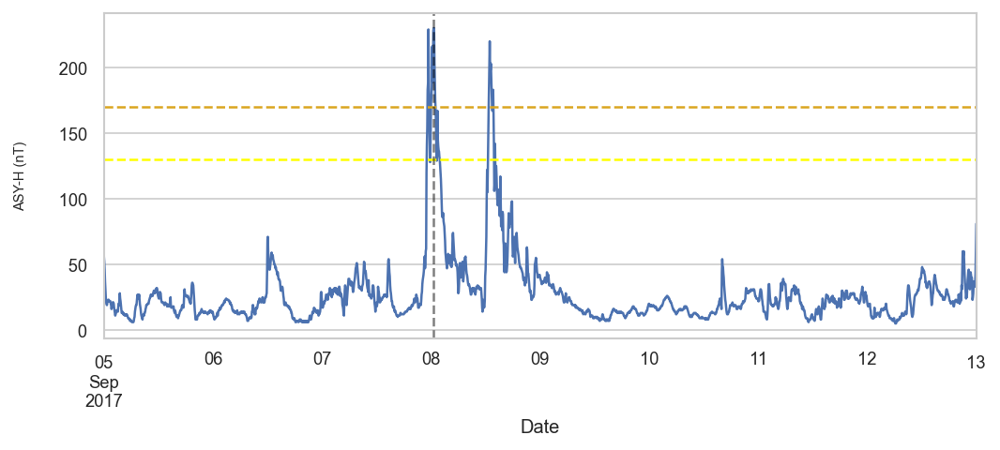

Plotting storm 267
Start date        2018-08-24 00:00:00
End date          2018-08-31 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         197
classification               MODERATE
Name: 267, dtype: object
Maximum ASY-H value 197 at: 2018-08-26 04:55:00


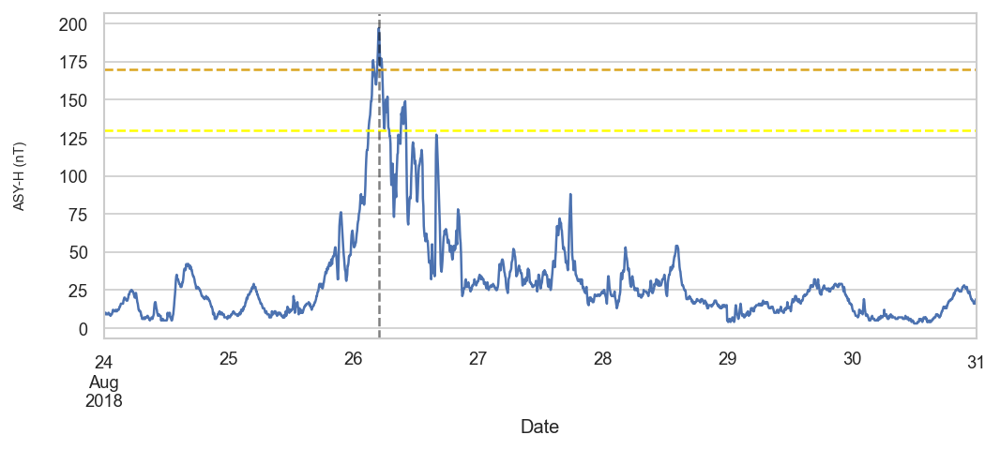

Plotting storm 277
Start date        2021-11-01 00:00:00
End date          2021-11-09 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         216
classification               MODERATE
Name: 277, dtype: object
Maximum ASY-H value 216 at: 2021-11-04 09:10:00


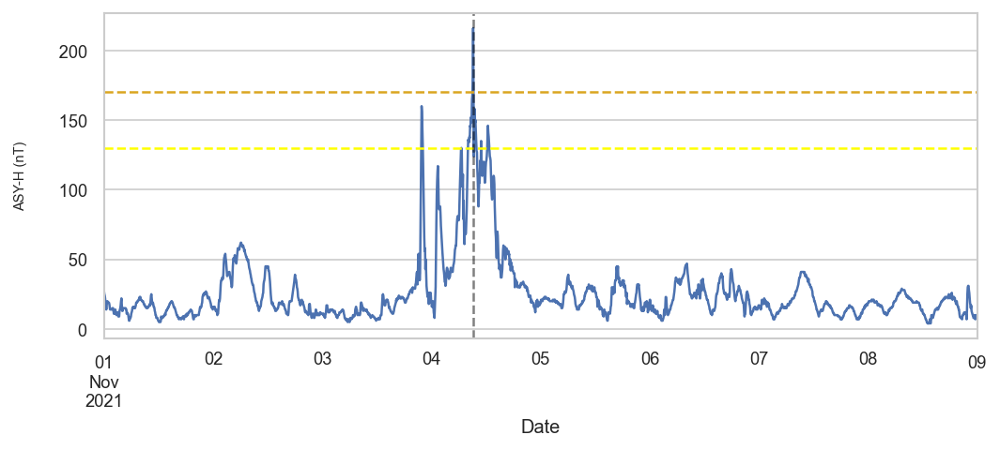

In [10]:
# Plot the storms of moderate intensity
# the yellow horizontal line corresponds to the low intensity threshold
# the orange horizontal line corresponds to the moderate intensity threshold
print(f'{len(moderate_indices)} moderate storms')
for ix, ind in enumerate(moderate_indices):
    ax = utils.plot_storm_asy(dfx, summary_df_asy, ind)
    strm = utils.get_storm(dfx, summary_df_asy, ind)
    ax.axvline(strm['ASY_H'].idxmax(), linestyle = '--', color = 'black', alpha = 0.5)
    print(f'Maximum ASY-H value {strm["ASY_H"].max()} at: {strm["ASY_H"].idxmax()}')
    plt.show();

### Intese storms <a class="anchor" id="section_2_3"></a>

23 intense storms
Plotting storm 9
Start date        1982-09-04 00:00:00
End date          1982-09-12 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         376
classification                INTENSE
Name: 9, dtype: object
Maximum ASY-H value 376 at: 1982-09-06 12:10:00


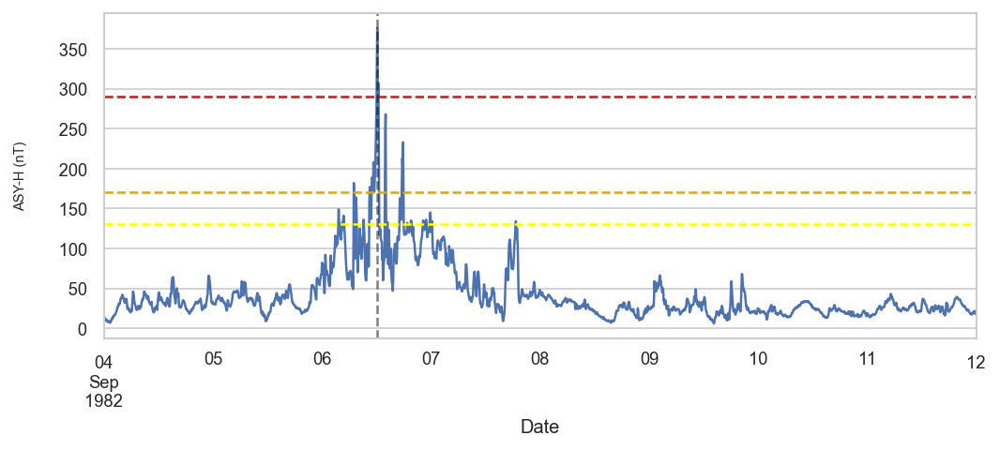

Plotting storm 12
Start date        1982-11-22 00:00:00
End date          1982-11-29 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         294
classification                INTENSE
Name: 12, dtype: object
Maximum ASY-H value 294 at: 1982-11-24 18:10:00


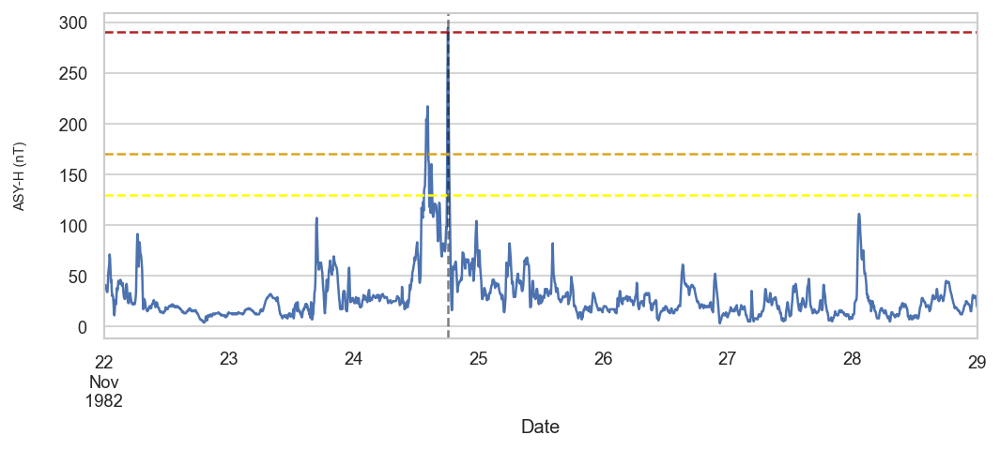

Plotting storm 15
Start date        1983-02-02 00:00:00
End date          1983-02-10 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         306
classification                INTENSE
Name: 15, dtype: object
Maximum ASY-H value 306 at: 1983-02-04 17:10:00


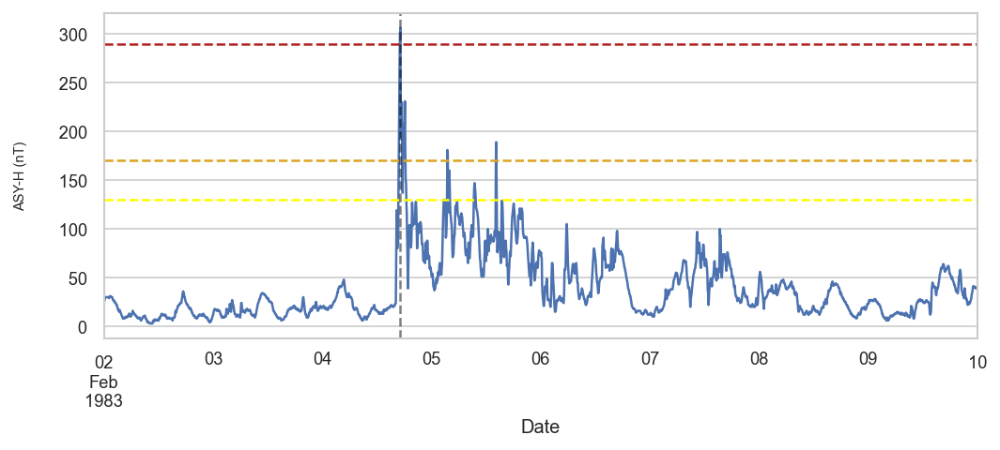

Plotting storm 36
Start date        1986-02-05 00:00:00
End date          1986-02-14 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         498
classification                INTENSE
Name: 36, dtype: object
Maximum ASY-H value 498 at: 1986-02-08 20:50:00


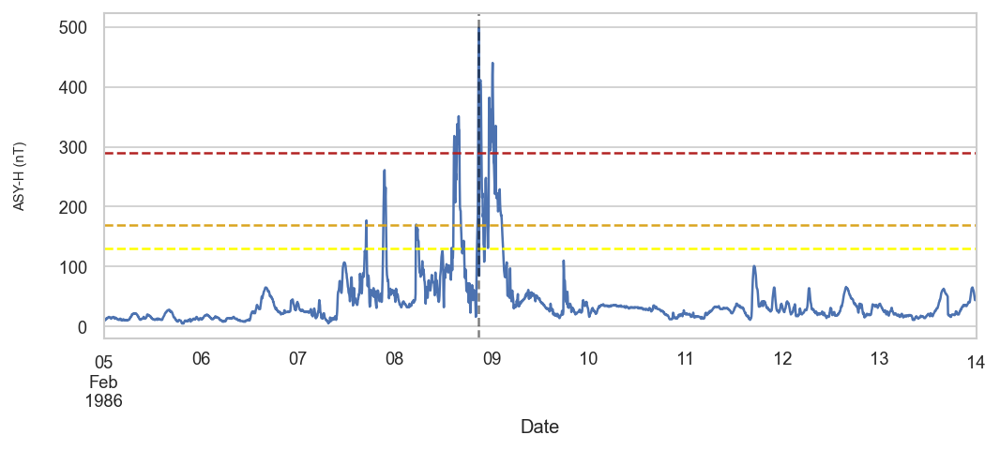

Plotting storm 50
Start date        1988-04-01 00:00:00
End date          1988-04-11 00:00:00
TD                   10 days 00:00:00
Max ASY-H                         414
classification                INTENSE
Name: 50, dtype: object
Maximum ASY-H value 414 at: 1988-04-03 19:30:00


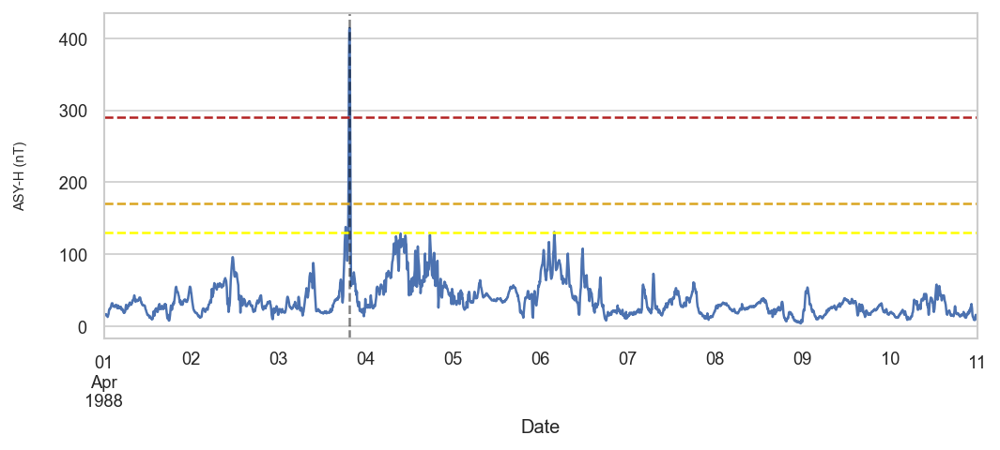

Plotting storm 65
Start date        1989-09-13 00:00:00
End date          1989-10-01 00:00:00
TD                   18 days 00:00:00
Max ASY-H                         335
classification                INTENSE
Name: 65, dtype: object
Maximum ASY-H value 335 at: 1989-09-19 03:50:00


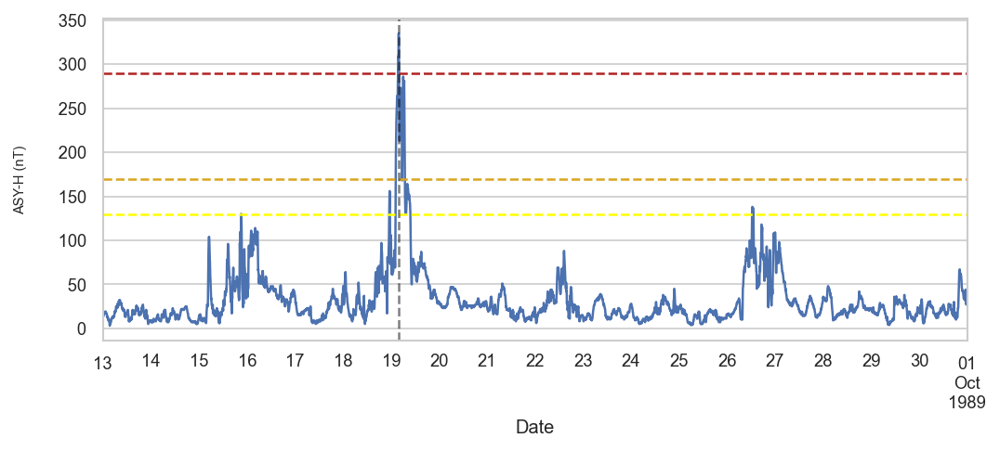

Plotting storm 66
Start date        1989-10-18 00:00:00
End date          1989-10-27 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         511
classification                INTENSE
Name: 66, dtype: object
Maximum ASY-H value 511 at: 1989-10-21 12:15:00


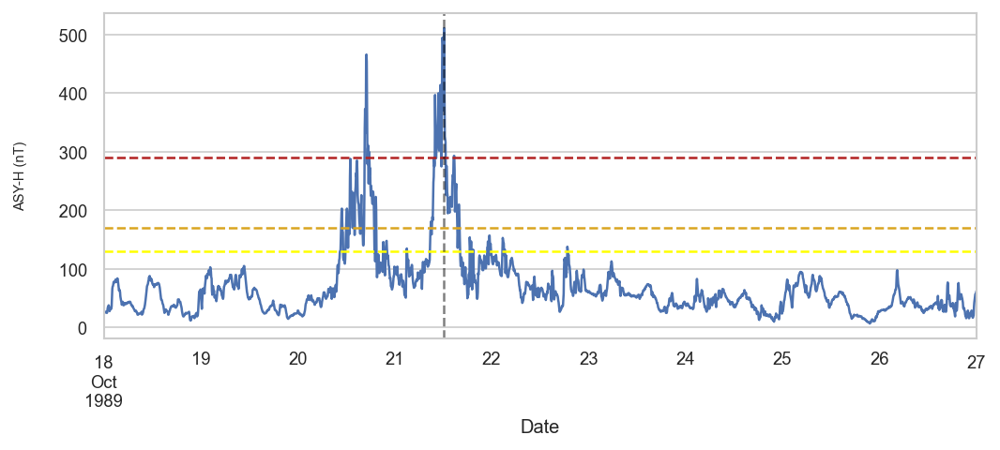

Plotting storm 82
Start date        1991-06-02 00:00:00
End date          1991-06-22 00:00:00
TD                   20 days 00:00:00
Max ASY-H                         516
classification                INTENSE
Name: 82, dtype: object
Maximum ASY-H value 516 at: 1991-06-05 17:00:00


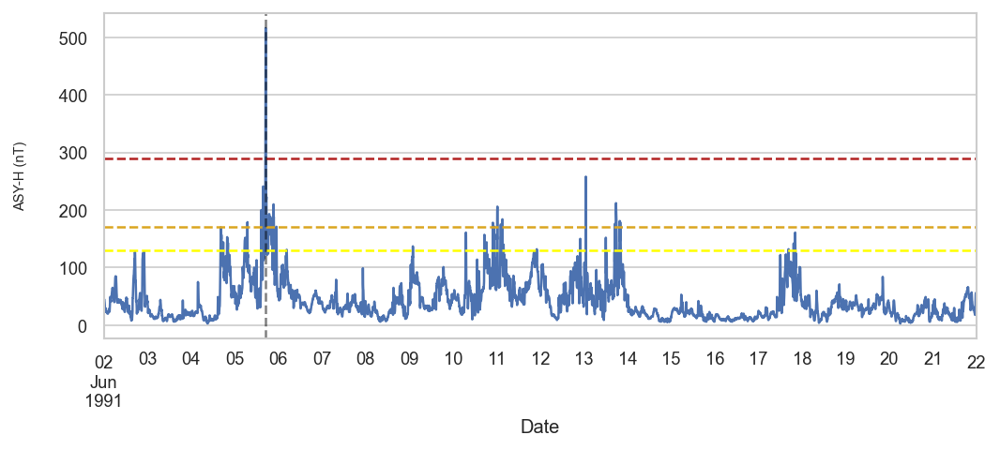

Plotting storm 83
Start date        1991-07-06 00:00:00
End date          1991-07-19 00:00:00
TD                   13 days 00:00:00
Max ASY-H                         297
classification                INTENSE
Name: 83, dtype: object
Maximum ASY-H value 297 at: 1991-07-13 16:20:00


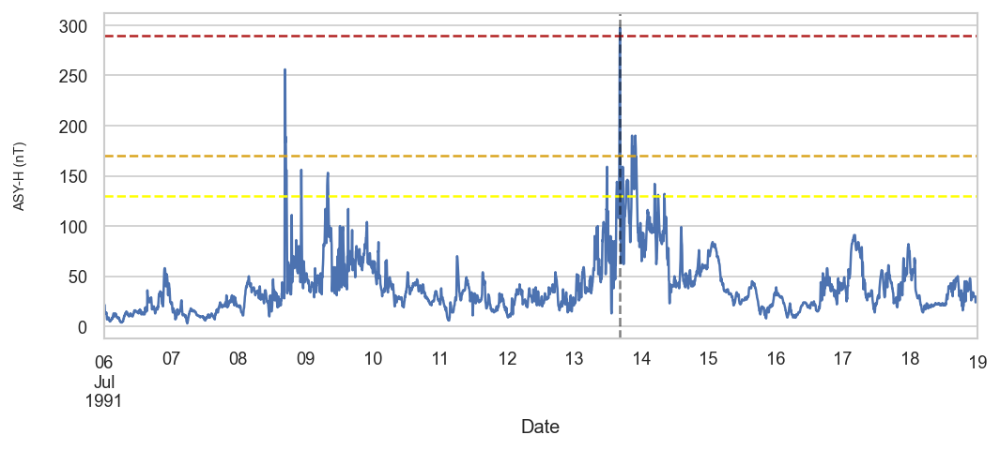

Plotting storm 92
Start date        1992-05-08 00:00:00
End date          1992-05-16 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         366
classification                INTENSE
Name: 92, dtype: object
Maximum ASY-H value 366 at: 1992-05-10 10:10:00


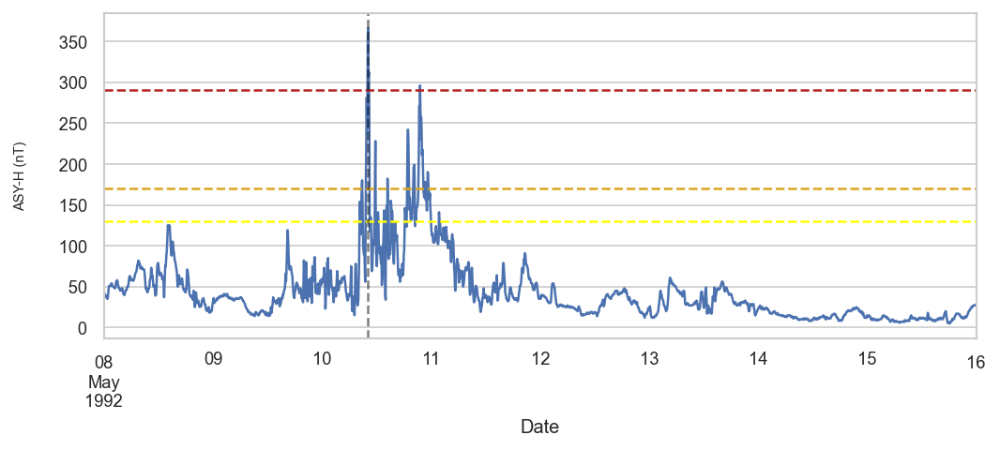

Plotting storm 144
Start date        1998-04-30 00:00:00
End date          1998-05-10 00:00:00
TD                   10 days 00:00:00
Max ASY-H                         415
classification                INTENSE
Name: 144, dtype: object
Maximum ASY-H value 415 at: 1998-05-04 05:45:00


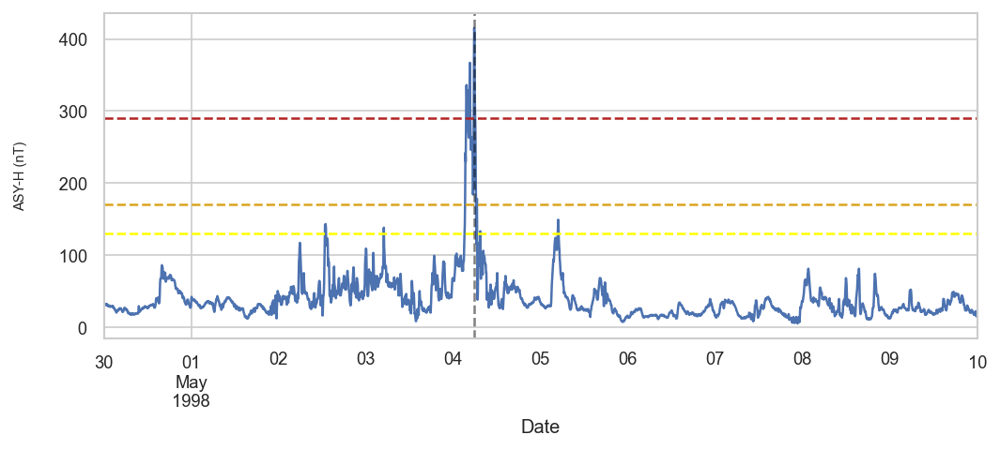

Plotting storm 148
Start date        1998-09-23 00:00:00
End date          1998-09-30 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         395
classification                INTENSE
Name: 148, dtype: object
Maximum ASY-H value 395 at: 1998-09-25 06:30:00


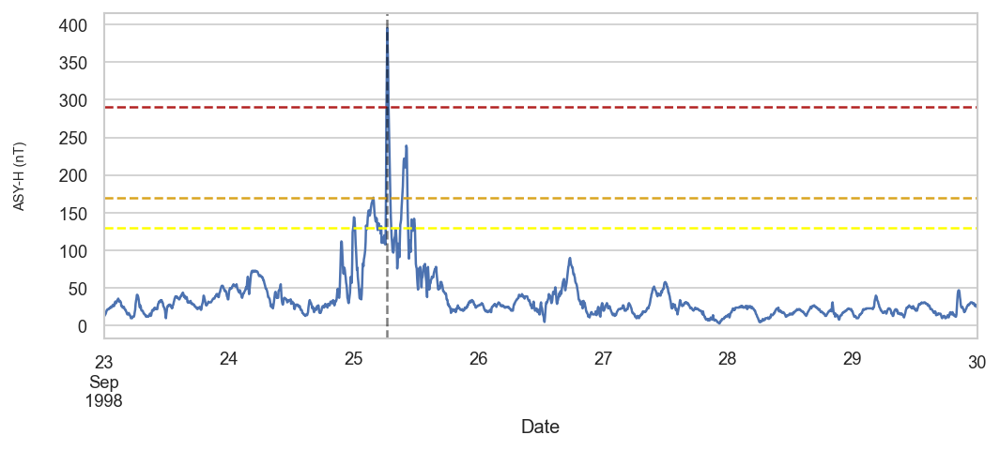

Plotting storm 165
Start date        2000-07-12 00:00:00
End date          2000-07-21 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         380
classification                INTENSE
Name: 165, dtype: object
Maximum ASY-H value 380 at: 2000-07-15 21:15:00


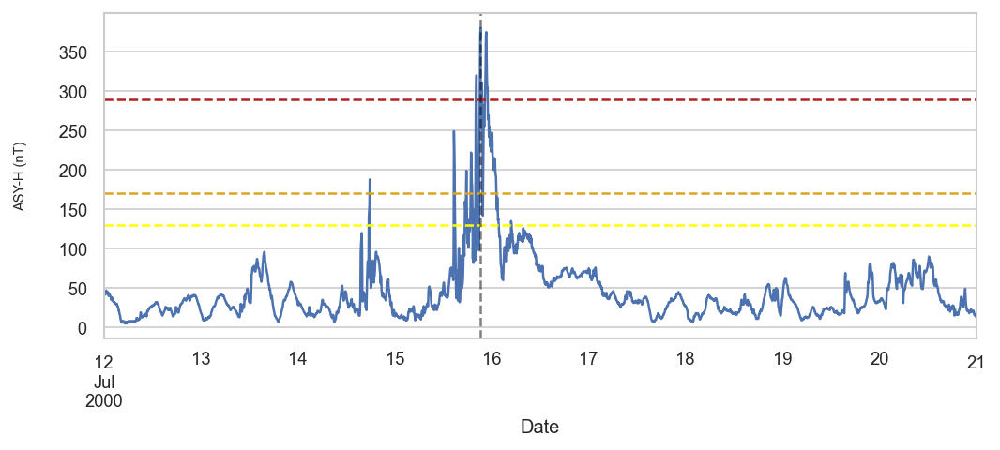

Plotting storm 173
Start date        2001-03-29 00:00:00
End date          2001-04-05 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         352
classification                INTENSE
Name: 173, dtype: object
Maximum ASY-H value 352 at: 2001-03-31 06:45:00


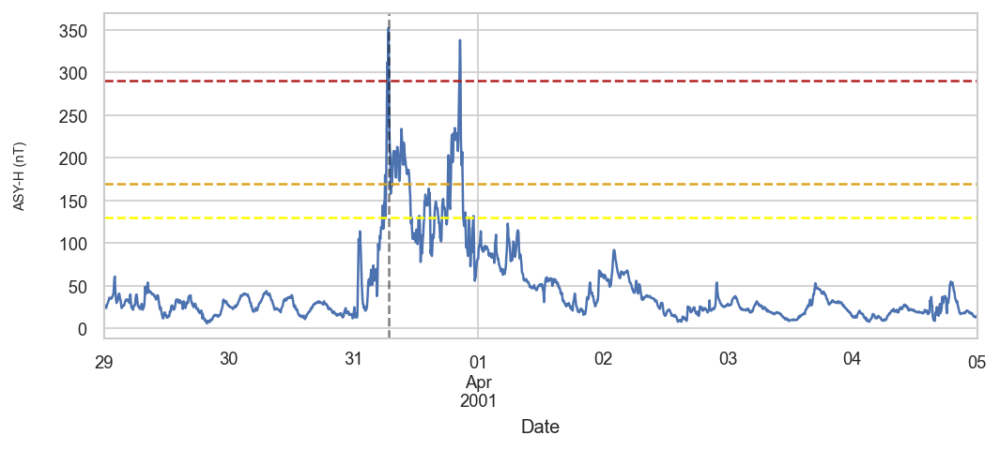

Plotting storm 174
Start date        2001-04-06 00:00:00
End date          2001-04-23 00:00:00
TD                   17 days 00:00:00
Max ASY-H                         422
classification                INTENSE
Name: 174, dtype: object
Maximum ASY-H value 422 at: 2001-04-11 16:10:00


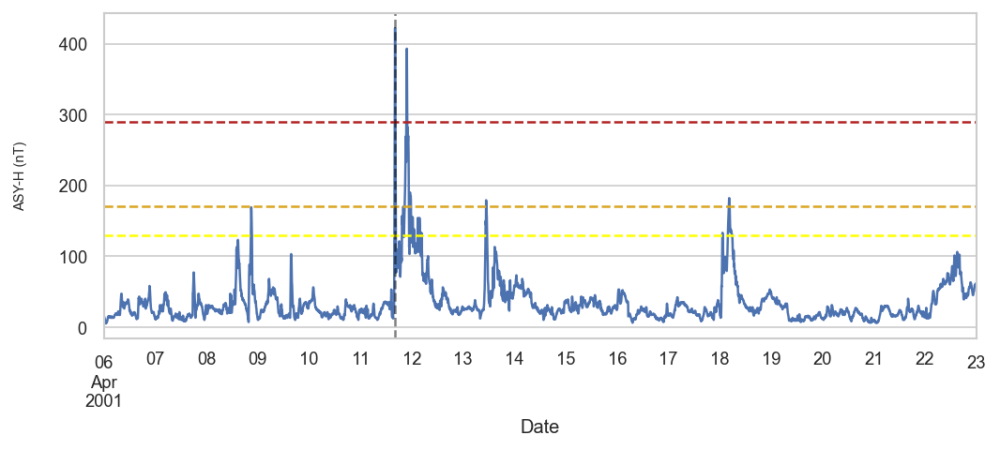

Plotting storm 179
Start date        2001-11-04 00:00:00
End date          2001-11-11 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         329
classification                INTENSE
Name: 179, dtype: object
Maximum ASY-H value 329 at: 2001-11-06 02:45:00


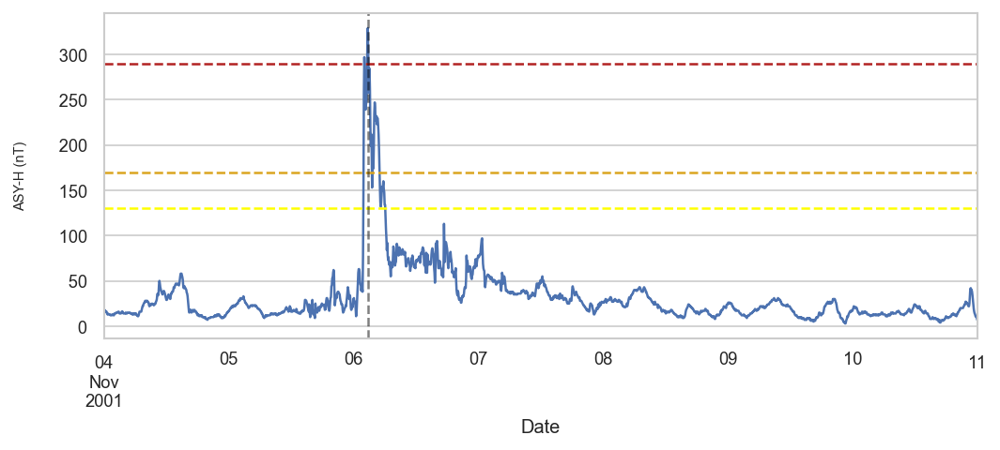

Plotting storm 180
Start date        2001-11-22 00:00:00
End date          2001-11-29 00:00:00
TD                    7 days 00:00:00
Max ASY-H                         330
classification                INTENSE
Name: 180, dtype: object
Maximum ASY-H value 330 at: 2001-11-24 07:10:00


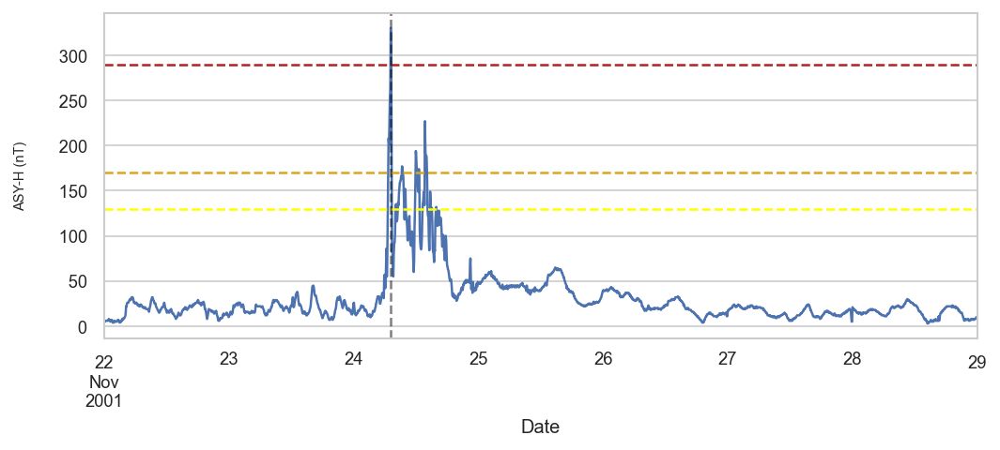

Plotting storm 191
Start date        2003-05-27 00:00:00
End date          2003-06-05 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         377
classification                INTENSE
Name: 191, dtype: object
Maximum ASY-H value 377 at: 2003-05-29 22:25:00


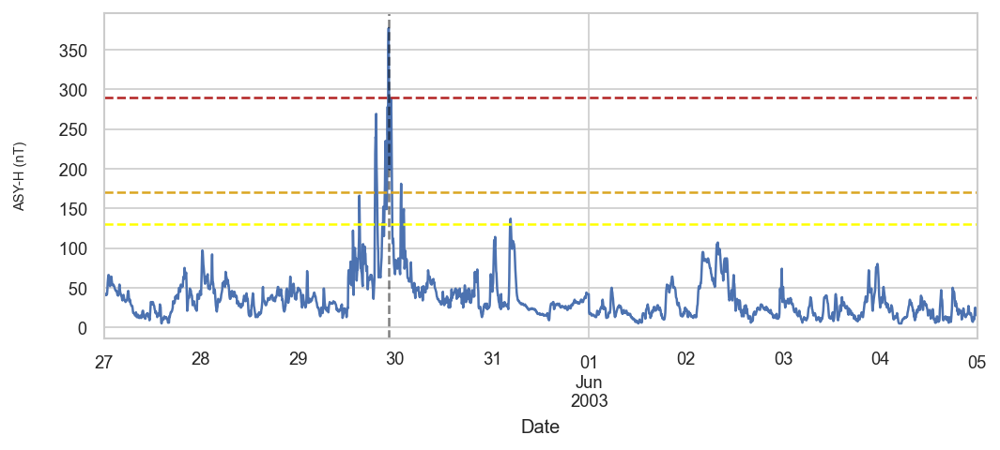

Plotting storm 193
Start date        2003-06-25 00:00:00
End date          2003-07-03 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         451
classification                INTENSE
Name: 193, dtype: object
Maximum ASY-H value 451 at: 2003-06-27 23:50:00


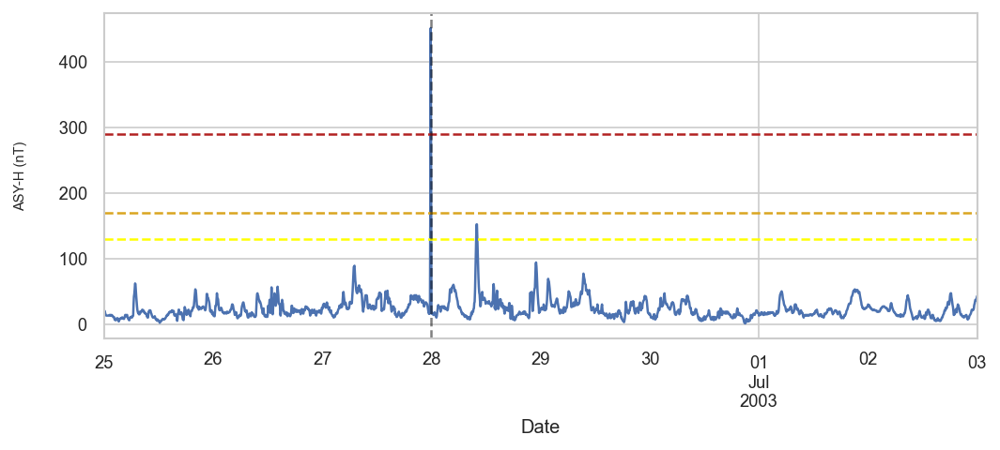

Plotting storm 205
Start date        2004-07-20 00:00:00
End date          2004-08-01 00:00:00
TD                   12 days 00:00:00
Max ASY-H                         294
classification                INTENSE
Name: 205, dtype: object
Maximum ASY-H value 294 at: 2004-07-26 23:20:00


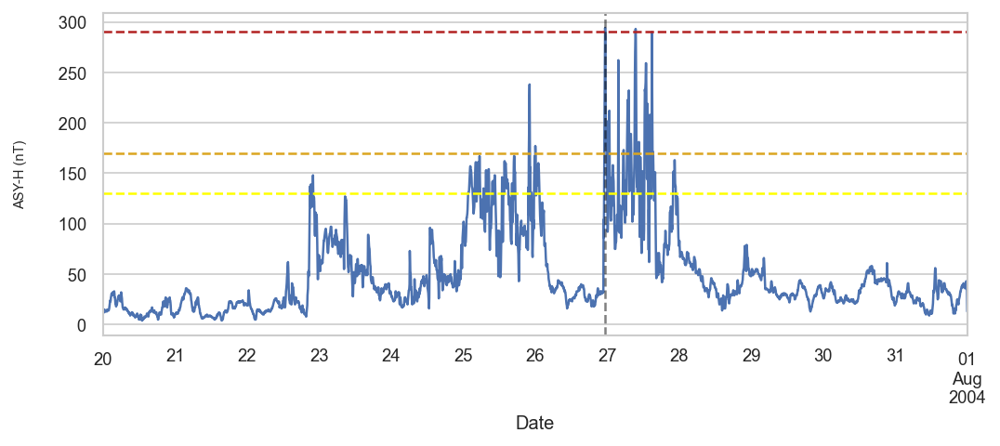

Plotting storm 206
Start date        2004-11-05 00:00:00
End date          2004-11-15 00:00:00
TD                   10 days 00:00:00
Max ASY-H                         339
classification                INTENSE
Name: 206, dtype: object
Maximum ASY-H value 339 at: 2004-11-08 04:05:00


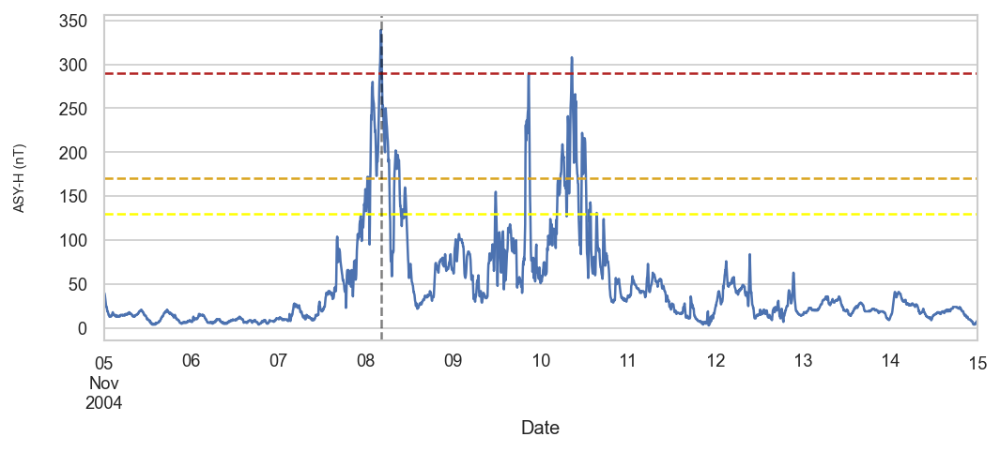

Plotting storm 208
Start date        2005-01-15 00:00:00
End date          2005-01-26 00:00:00
TD                   11 days 00:00:00
Max ASY-H                         392
classification                INTENSE
Name: 208, dtype: object
Maximum ASY-H value 392 at: 2005-01-21 17:40:00


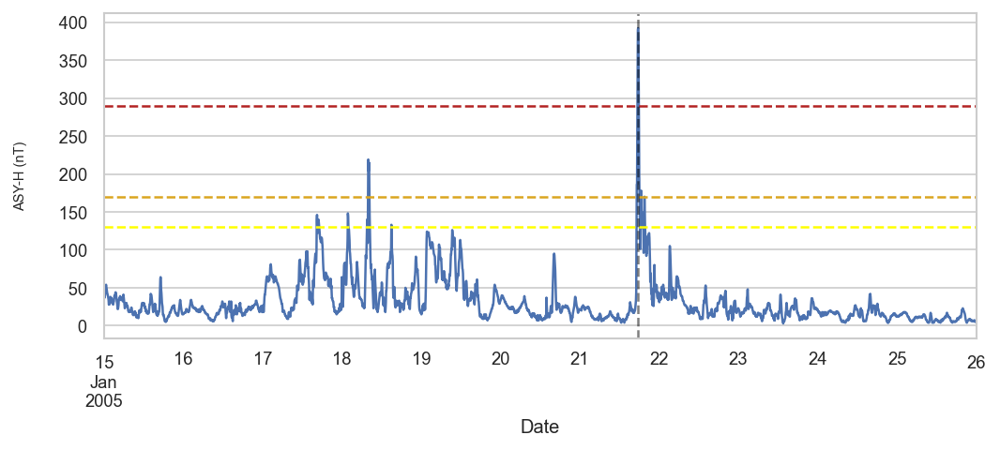

Plotting storm 246
Start date        2015-06-20 00:00:00
End date          2015-06-28 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         348
classification                INTENSE
Name: 246, dtype: object
Maximum ASY-H value 348 at: 2015-06-22 19:45:00


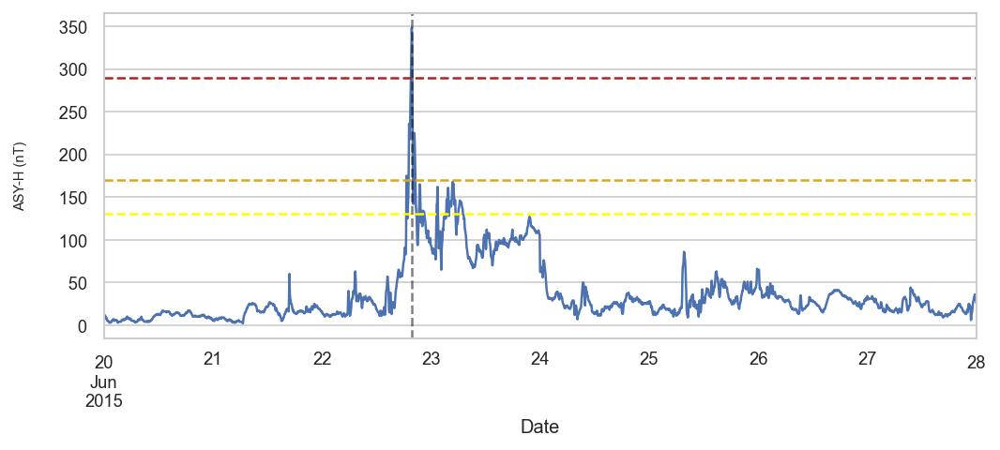

In [11]:
# Plot the intense storms
# the yellow horizontal line corresponds to the low intensity threshold
# the orange horizontal line corresponds to the moderate intensity threshold
# the red horizontal line corresponds to the intense threshold
print(f'{len(intense_indices)} intense storms')
for ix, ind in enumerate(intense_indices):
    ax = utils.plot_storm_asy(dfx, summary_df_asy, ind)
    strm = utils.get_storm(dfx, summary_df_asy, ind)
    ax.axvline(strm['ASY_H'].idxmax(), linestyle = '--', color = 'black', alpha = 0.5)
    print(f'Maximum ASY-H value {strm["ASY_H"].max()} at: {strm["ASY_H"].idxmax()}')
    plt.show();

### Super-intense storms <a class="anchor" id="section_2_4"></a>

6 superintense storms
Plotting storm 7
Start date        1982-07-11 00:00:00
End date          1982-07-19 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         604
classification           SUPERINTENSE
Name: 7, dtype: object
Maximum ASY-H value 604 at: 1982-07-14 00:00:00


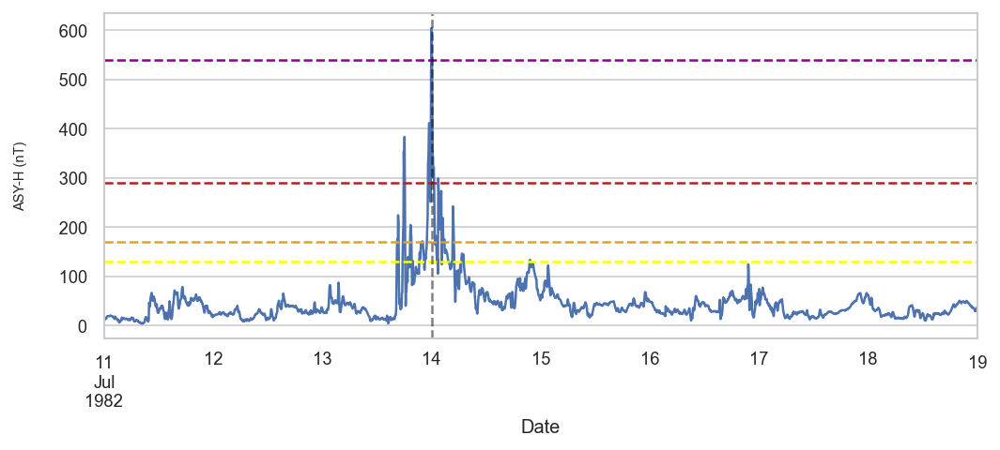

Plotting storm 58
Start date        1989-03-11 00:00:00
End date          1989-04-10 00:00:00
TD                   30 days 00:00:00
Max ASY-H                         721
classification           SUPERINTENSE
Name: 58, dtype: object
Maximum ASY-H value 721 at: 1989-03-13 22:05:00


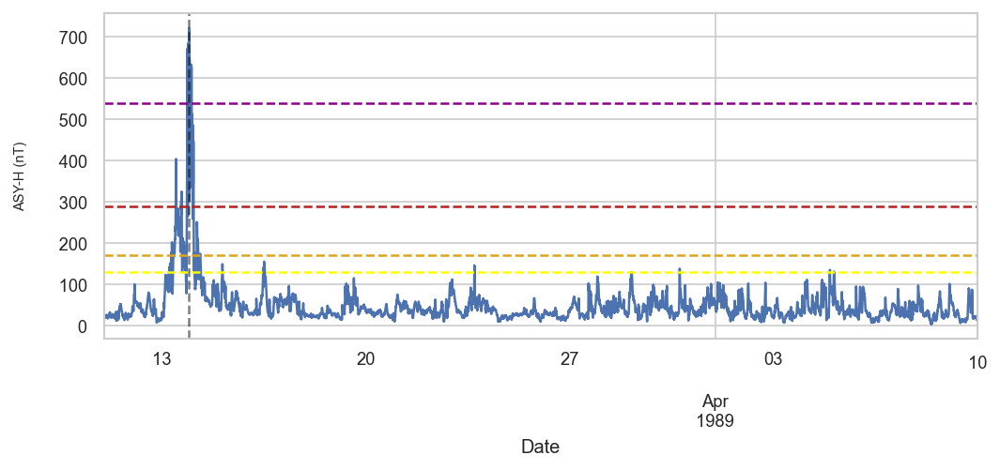

Plotting storm 81
Start date        1991-03-22 00:00:00
End date          1991-03-31 00:00:00
TD                    9 days 00:00:00
Max ASY-H                         682
classification           SUPERINTENSE
Name: 81, dtype: object
Maximum ASY-H value 682 at: 1991-03-24 04:30:00


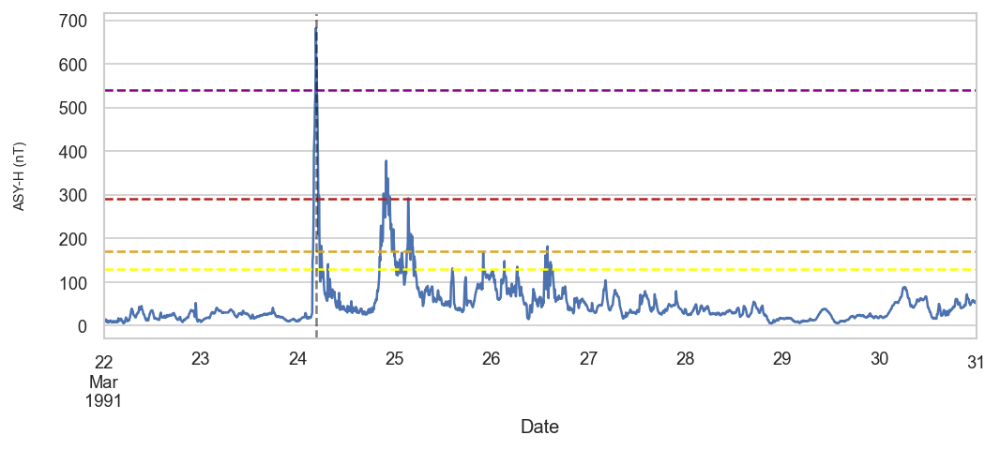

Plotting storm 87
Start date        1991-10-26 00:00:00
End date          1991-11-14 00:00:00
TD                   19 days 00:00:00
Max ASY-H                         578
classification           SUPERINTENSE
Name: 87, dtype: object
Maximum ASY-H value 578 at: 1991-11-09 00:15:00


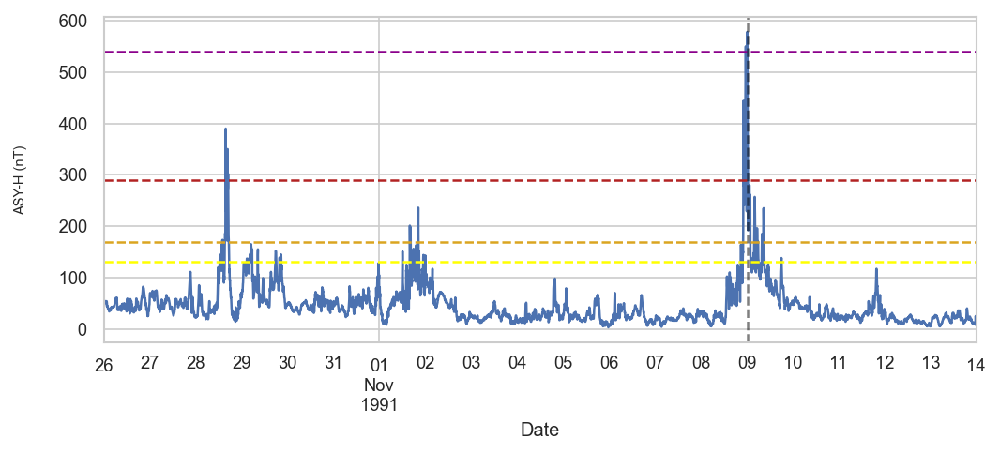

Plotting storm 162
Start date        2000-04-04 00:00:00
End date          2000-04-12 00:00:00
TD                    8 days 00:00:00
Max ASY-H                         612
classification           SUPERINTENSE
Name: 162, dtype: object
Maximum ASY-H value 612 at: 2000-04-07 00:25:00


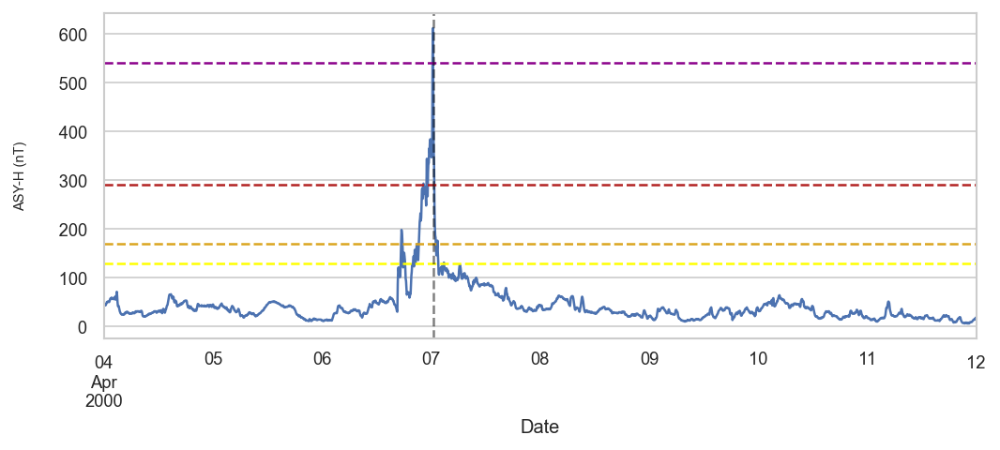

Plotting storm 199
Start date        2003-10-22 00:00:00
End date          2003-11-29 00:00:00
TD                   38 days 00:00:00
Max ASY-H                         828
classification           SUPERINTENSE
Name: 199, dtype: object
Maximum ASY-H value 828 at: 2003-10-29 20:05:00


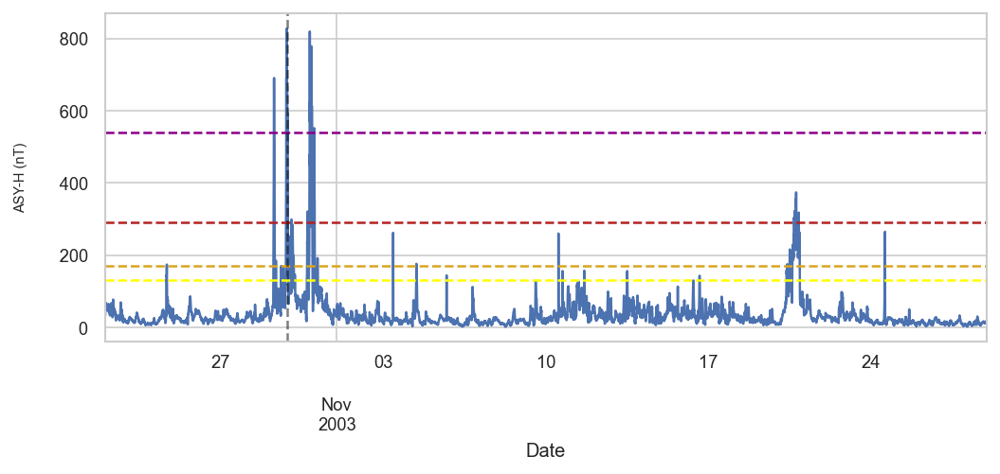

In [12]:
# Plot the super-intense storms
# the yellow horizontal line corresponds to the low intensity threshold
# the orange horizontal line corresponds to the moderate intensity threshold
# the red horizontal line corresponds to the intense threshold
# the magenta horizontal line corresponds to the super-intense threshold
print(f'{len(superintense_indices)} superintense storms')
for ix, ind in enumerate(superintense_indices):
    ax = utils.plot_storm_asy(dfx, summary_df_asy, ind)
    strm = utils.get_storm(dfx, summary_df_asy, ind)
    ax.axvline(strm['ASY_H'].idxmax(), linestyle = '--', color = 'black', alpha = 0.5)
    print(f'Maximum ASY-H value {strm["ASY_H"].max()} at: {strm["ASY_H"].idxmax()}')
    plt.show();

In [13]:
# Save the identified storms to a csv file in the format
# Start Date, End Date, Storm duration, Maximum ASY-H, Classification
summary_df_asy.to_csv('./data/storms_asy.csv', index = False)